# Kaggle credit card fraud dataset
https://www.kaggle.com/mlg-ulb/creditcardfraud


This notebook did not run on Kaggle, but a local system.
We are running on e2eml version 2.10.1

# Introduction

Hi,

I am Thomas, creator of the automl library e2eml. In this notebook I give you a little walkthrough and example run using a feature called Timewalk.

I created this library for personal development, but also to give something back to the data science community. You can install the library using !pip install e2eml.


# What does e2eml offer?
e2eeml has two major goals: You can either speed up your prototyping and exploration (with Timewalk) or create a full pipeline with just a few lines of code. e2eml will take care of:
- data preprocessing
- model training
- model fine-tuning
- model evaluation
- logging file

It can handle datetime, categorical and numerical data and allows you to build classification & regression models. For NLP tasks you can even let it create a full BERT model for you.

# Why e2eml and not any other automl framework?
This decision is fully up to you. They all have their ins & outs. Chose what suits your needs best. e2eml is just an option for you.


# What is the spirit of e2eml?
This library tries to maximize the model performance. It shall help to see how far you can get given your data.
As a characteristic it creates huge notebooks, but we really wanted to print out a lot for. We want you to be able to actually see what is happening under the hood. That comes at a cost here. If you prefer very elegant and silent implementations, check out the fantastic Pycaret library.
Additionally being able to fine-tune BERT models for you can be a life saver. We also provide some GPU acceleration with RAPIDS. Currently this is implemented in a few spots only however.

# Importing libraries

In [1]:
# import libraries and custom Postgres connector
import sys
sys.path.append(r'/home/thomas/IdeaProjects/e2e_ml')
from e2eml.full_processing import postprocessing
from e2eml.classification import classification_blueprints as cb
from e2eml.timetravel import timetravel

import pandas as pd
from sklearn import model_selection
from sklearn.metrics import matthews_corrcoef
from sklearn.metrics import classification_report
import re
import numpy as np
pd.set_option('display.max_colwidth', None)


import pickle
import gc

# custom Postgres connector
import sys
sys.path.append(r'/home/thomas/Schreibtisch/Data Science')
from connector import connection_creator, master_connection_creator

[nltk_data] Downloading package punkt to /home/thomas/nltk_data...
[nltk_data]   Package punkt is already up-to-date!
[nltk_data] Downloading package averaged_perceptron_tagger to
[nltk_data]     /home/thomas/nltk_data...
[nltk_data]   Package averaged_perceptron_tagger is already up-to-
[nltk_data]       date!
[nltk_data] Downloading package stopwords to /home/thomas/nltk_data...
[nltk_data]   Package stopwords is already up-to-date!
[nltk_data] Downloading package wordnet to /home/thomas/nltk_data...
[nltk_data]   Package wordnet is already up-to-date!


# Import needed data

In [2]:
target = 'Class'

In [3]:
creditcard = pd.read_csv('creditcard.csv')
creditcard

,Time,V1,V2,V3,V4,V5,V6,V7,V8,V9,...,V21,V22,V23,V24,V25,V26,V27,V28,Amount,Class
0,0.0,-1.359807,-0.072781,2.536347,1.378155,-0.338321,0.462388,0.239599,0.098698,0.363787,...,-0.018307,0.277838,-0.110474,0.066928,0.128539,-0.189115,0.133558,-0.021053,149.62,0
1,0.0,1.191857,0.266151,0.166480,0.448154,0.060018,-0.082361,-0.078803,0.085102,-0.255425,...,-0.225775,-0.638672,0.101288,-0.339846,0.167170,0.125895,-0.008983,0.014724,2.69,0
2,1.0,-1.358354,-1.340163,1.773209,0.379780,-0.503198,1.800499,0.791461,0.247676,-1.514654,...,0.247998,0.771679,0.909412,-0.689281,-0.327642,-0.139097,-0.055353,-0.059752,378.66,0
3,1.0,-0.966272,-0.185226,1.792993,-0.863291,-0.010309,1.247203,0.237609,0.377436,-1.387024,...,-0.108300,0.005274,-0.190321,-1.175575,0.647376,-0.221929,0.062723,0.061458,123.50,0
4,2.0,-1.158233,0.877737,1.548718,0.403034,-0.407193,0.095921,0.592941,-0.270533,0.817739,...,-0.009431,0.798278,-0.137458,0.141267,-0.206010,0.502292,0.219422,0.215153,69.99,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
284802,172786.0,-11.881118,10.071785,-9.834783,-2.066656,-5.364473,-2.606837,-4.918215,7.305334,1.914428,...,0.213454,0.111864,1.014480,-0.509348,1.436807,0.250034,0.943651,0.823731,0.77,0
284803,172787.0,-0.732789,-0.055080,2.035030,-0.738589,0.868229,1.058415,0.024330,0.294869,0.584800,...,0.214205,0.924384,0.012463,-1.016226,-0.606624,-0.395255,0.068472,-0.053527,24.79,0
284804,172788.0,1.919565,-0.301254,-3.249640,-0.557828,2.630515,3.031260,-0.296827,0.708417,0.432454,...,0.232045,0.578229,-0.037501,0.640134,0.265745,-0.087371,0.004455,-0.026561,67.88,0
284805,172788.0,-0.240440,0.530483,0.702510,0.689799,-0.377961,0.623708,-0.686180,0.679145,0.392087,...,0.265245,0.800049,-0.163298,0.123205,-0.569159,0.546668,0.108821,0.104533,10.00,0


In [4]:
creditcard[target].value_counts()

0    284315
1       492
Name: Class, dtype: int64

In [5]:
creditcard[target].isna().sum()

0

In [6]:
len(creditcard.index)

284807

# Test train split

First we sort the dataset by timestamp and then hold back the newest data points as unseen holdout data for validation.
This has two reasons:
- Without any unseen data we cannot see overfitting
- Fraud does not consist of static behaviour. In real world applications fraudsters change their behaviour to adapt for anti-fraud mechanisms. For model prototyping (not final training!) it makes sense to keep newest data as holdout, so we can see, if our model can adapt to changing patterns (given they even change in our training data)

In [7]:
creditcard = creditcard.sort_values(by=["Time"], ascending=[True])

In [8]:
train_df = creditcard.head(230000)

Here we go crazy actually. Timewalk should be used with smaller samples, but we want to illustrate what might happen, if the sample is very big.

In [9]:
train_df = train_df.sample(100000, random_state=1000)
train_df_target = train_df[target]

In [10]:
train_df_target.value_counts()

0    99812
1      188
Name: Class, dtype: int64

In [11]:
# actual holdout
holdout_df = creditcard.tail(50000)
hold_df_target = holdout_df[target]
del holdout_df[target]

In [12]:
hold_df_target.value_counts()

0    49935
1       65
Name: Class, dtype: int64

In [13]:
del creditcard
_ = gc.collect()

# Automl using e2eml

We use e2eml. There are plenty of fantastic frameworks. Chose whatever you like.

Using e2eml we first instantiate a class, here a ClassificationBluePrint.

In [14]:
automl_pipeline = cb.ClassificationBluePrint(datasource=train_df,
                                       target_variable=target,
                                       preferred_training_mode='cpu',
                                       tune_mode='accurate',
                                       ml_task='binary',
                                       rapids_acceleration=False
                                        )

Ml task is binary

            CPU mode has been chosen. Installing e2eml into an environment where LGBM and Xgboost have been installed with GPU acceleration
            is recommended to be able to use preferred_training_mode='gpu'. This will speed up model training and feature importance
            via SHAP.
            


From here we have two general options. We can:
- run a certain blueprint straight away (this is great to create a ready-to-use pipeline for prediction)
- run Timewalk to fully explore many algorithms and preprocessing combinations

Here we assume that we don't know much about what works for this dataset. So we chose Timewalk. Timewalk takes a long time to run (this can be controlled by manually chosing algorithms and preprocessing steps to use). As we have plenty of data Timewalk will automatically switch off some algorithms. I.e. Xgboost will not run here (this has been designed due to problems of releasing the memory again and also due to high consumption of system resources).

As our data is imbalanced, we add this flag as a parameter. This will add an additional step for imbalanced data only.

+++++++++++++++++++++++++++++++++++++++++++++++++++++++++++
Start iteration for checkpoint default at 1642423005.2633429.
Started Execute test train split at 13:36:45.
Started Started column type detection and casting at 13:36:45.
Started Checking for duplicate columns at 13:36:45.
Started Reset dataframe index. at 13:36:46.
Started Select best features at 13:36:46.
Features before selection are...V12
Features before selection are...V21
Features before selection are...V24
Features before selection are...V10
Features before selection are...V11
Features before selection are...V19
Features before selection are...V25
Features before selection are...V7
Features before selection are...V9
Features before selection are...V15
Features before selection are...V23
Features before selection are...V26
Features before selection are...V6
Features before selection are...V20
Features before selection are...V3
Features before selection are...V5
Features before selection are...V22
Features before selectio

  0%|          | 0/50 [00:00<?, ?it/s]

Started Scale data at 14:03:32.
Started Select best features at 14:03:33.
Features before selection are...Time
Features before selection are...V1
Features before selection are...V2
Features before selection are...V3
Features before selection are...V4
Features before selection are...V5
Features before selection are...V6
Features before selection are...V7
Features before selection are...V8
Features before selection are...V9
Features before selection are...V10
Features before selection are...V11
Features before selection are...V12
Features before selection are...V13
Features before selection are...V14
Features before selection are...V15
Features before selection are...V16
Features before selection are...V17
Features before selection are...V18
Features before selection are...V19
Features before selection are...V20
Features before selection are...V21
Features before selection are...V22
Features before selection are...V23
Features before selection are...V24
Features before selection are...V2

[I 2022-01-17 14:03:57,325] A new study created in memory with name: ridge


All algorithms to be tested are: ['ridge', 'lgbm', 'lgbm_focal', 'tabnet', 'vowpal_wabbit', 'logistic_regression', 'sgd', 'quadratic_discriminant_analysis', 'svm'].
Start iteration for algorithm ridge at 1642424637.3010316.
Successfully loaded checkpoint last checkpoint.
Started Train Ridge classifier model at 14:03:57.


  0%|          | 0/10 [00:00<?, ?it/s]

[I 2022-01-17 14:03:57,624] Trial 0 finished with value: 0.43734383792273057 and parameters: {'solver': 'svd', 'alpha': 157.41890047456639, 'max_iter': 6015, 'tol': 0.006796578090758156, 'normalize': False}. Best is trial 0 with value: 0.43734383792273057.
[I 2022-01-17 14:03:57,983] Trial 1 finished with value: 0.43734383792273057 and parameters: {'solver': 'auto', 'alpha': 0.055895242052179224, 'max_iter': 6123, 'tol': 3.613894271216525e-05, 'normalize': False}. Best is trial 0 with value: 0.43734383792273057.
[I 2022-01-17 14:03:58,500] Trial 2 finished with value: 0.43734383792273057 and parameters: {'solver': 'svd', 'alpha': 0.010547383621352036, 'max_iter': 659, 'tol': 0.06245139574743072, 'normalize': True}. Best is trial 0 with value: 0.43734383792273057.
[I 2022-01-17 14:03:58,770] Trial 3 finished with value: 0.43734383792273057 and parameters: {'solver': 'cholesky', 'alpha': 285.7080075040722, 'max_iter': 2595, 'tol': 0.004467752817973905, 'normalize': False}. Best is trial 

Started Predict with Ridge classifier at 14:07:44.
14:07:44


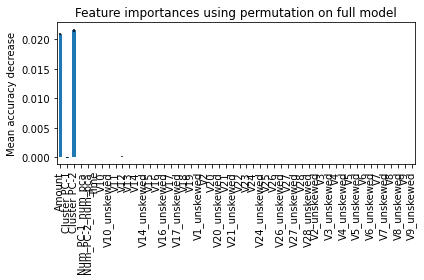

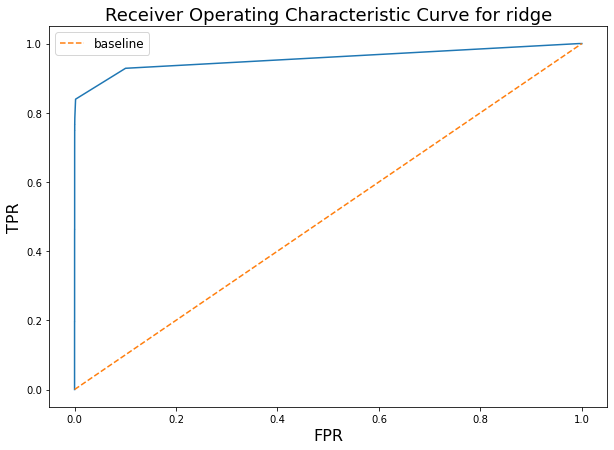

The ROC_AUC score is 0.9691412064425022


The Matthew correlation is 0.8014401446737648
-------------------
The accuracy is 0.9993
The recall is 0.9993
The macro F1 score is 0.899824693213123
The micro F1 score is 0.9993
The weighted F1 score is 0.9992767075715836
              precision    recall  f1-score   support

         0.0       1.00      1.00      1.00     29944
         1.0       0.86      0.75      0.80        56

    accuracy                           1.00     30000
   macro avg       0.93      0.87      0.90     30000
weighted avg       1.00      1.00      1.00     30000



Started Execute test train split at 14:07:55.
Started Started column type detection and casting at 14:07:55.
Started Checking for duplicate columns at 14:07:55.
Started Reset dataframe index. at 14:07:55.
Started Select best features at 14:07:55.
Started Delete columns with high share of NULLs at 14:07:55.
Started Apply datetime transformation at 14:07:55.
Started Start TFIDF to PCA loop at 14:07:55.
Started Handle rare features at 14:07:55.
Started Remove cardinality at 14:07:55.
Started Holistic NULL filling at 14:07:55.
Started Binarize numeric columns + PCA binarized features at 14:07:55.
Started Onehot + PCA categorical features at 14:07:55.
Started Execute categorical encoding at 14:07:55.
Started Fill nulls at 14:07:55.
Started Handle outliers at 14:07:55.
Started Remove collinearity at 14:07:56.
Started Remove skewness at 14:07:56.
Started Execute clustering as a feature at 14:07:56.
Started Execute clustering as a feature at 14:08:09.
Started Execute clustering as a feature at

[I 2022-01-17 14:10:04,099] A new study created in memory with name: lgbm tuning


              precision    recall  f1-score   support

           0       1.00      1.00      1.00     49935
           1       0.92      0.68      0.78        65

    accuracy                           1.00     50000
   macro avg       0.96      0.84      0.89     50000
weighted avg       1.00      1.00      1.00     50000

Score achieved on holdout dataset is: 0.7874991076237248.
End iteration for algorithm ridge at 1642425003.9463909.
+++++++++++++++++++++++++++++++++++++++++++++++++++++++++++
Start iteration for algorithm lgbm at 1642425004.078187.
Successfully loaded checkpoint last checkpoint.
Started Train LGBM at 14:10:04.
Started Check LGBM for GPU acceleration. at 14:10:04.
LGBM uses GPU.


  0%|          | 0/10 [00:00<?, ?it/s]

[I 2022-01-17 14:10:04,235] Trial 0 finished with value: 0.03388846282051174 and parameters: {'num_boost_round': 18789, 'lambda_l1': 506157.68887523044, 'lambda_l2': 24658.3294585491, 'num_leaves': 154, 'feature_fraction': 0.4936111842654619, 'feature_fraction_bynode': 0.49359671220172163, 'learning_rate': 1.7073967431528103e-05}. Best is trial 0 with value: 0.03388846282051174.
[I 2022-01-17 14:10:04,427] Trial 1 finished with value: 0.03388846282051174 and parameters: {'num_boost_round': 43323, 'lambda_l1': 4042.8727350273302, 'lambda_l2': 17718.847354806814, 'num_leaves': 7, 'feature_fraction': 0.9819459112971965, 'feature_fraction_bynode': 0.899465584480253, 'learning_rate': 7.068974950624602e-05}. Best is trial 0 with value: 0.03388846282051174.
[I 2022-01-17 14:10:25,173] Trial 2 finished with value: 0.015760976854243415 and parameters: {'num_boost_round': 9173, 'lambda_l1': 12.601639723276797, 'lambda_l2': 66.904211664988, 'num_leaves': 135, 'feature_fraction': 0.659167011185269

[1]	train's binary_logloss: 0.0124925	valid's binary_logloss: 0.0123687
Training until validation scores don't improve for 10 rounds
[2]	train's binary_logloss: 0.0114359	valid's binary_logloss: 0.0114072
[3]	train's binary_logloss: 0.010561	valid's binary_logloss: 0.0105637
[4]	train's binary_logloss: 0.00989191	valid's binary_logloss: 0.00995545
[5]	train's binary_logloss: 0.00927414	valid's binary_logloss: 0.00937743
[6]	train's binary_logloss: 0.0088223	valid's binary_logloss: 0.00895124
[7]	train's binary_logloss: 0.00845726	valid's binary_logloss: 0.00860344
[8]	train's binary_logloss: 0.00810973	valid's binary_logloss: 0.00828297
[9]	train's binary_logloss: 0.00783146	valid's binary_logloss: 0.00802828
[10]	train's binary_logloss: 0.007629	valid's binary_logloss: 0.00783573
[11]	train's binary_logloss: 0.00741481	valid's binary_logloss: 0.00763186
[12]	train's binary_logloss: 0.00721742	valid's binary_logloss: 0.00744994
[13]	train's binary_logloss: 0.00706768	valid's binary_log

[235]	train's binary_logloss: 0.0030351	valid's binary_logloss: 0.00376315
[236]	train's binary_logloss: 0.00303483	valid's binary_logloss: 0.00376287
[237]	train's binary_logloss: 0.00303477	valid's binary_logloss: 0.00376278
[238]	train's binary_logloss: 0.00303477	valid's binary_logloss: 0.00376278
[239]	train's binary_logloss: 0.00303477	valid's binary_logloss: 0.00376278
[240]	train's binary_logloss: 0.00303477	valid's binary_logloss: 0.00376278
[241]	train's binary_logloss: 0.00303475	valid's binary_logloss: 0.00376276
[242]	train's binary_logloss: 0.00303467	valid's binary_logloss: 0.00376259
[243]	train's binary_logloss: 0.00303466	valid's binary_logloss: 0.00376257
[244]	train's binary_logloss: 0.00303466	valid's binary_logloss: 0.00376257
[245]	train's binary_logloss: 0.00303447	valid's binary_logloss: 0.00376233
[246]	train's binary_logloss: 0.00303446	valid's binary_logloss: 0.00376232
[247]	train's binary_logloss: 0.00303446	valid's binary_logloss: 0.00376232
[248]	train's

Started Predict with LGBM at 14:11:53.
14:11:53


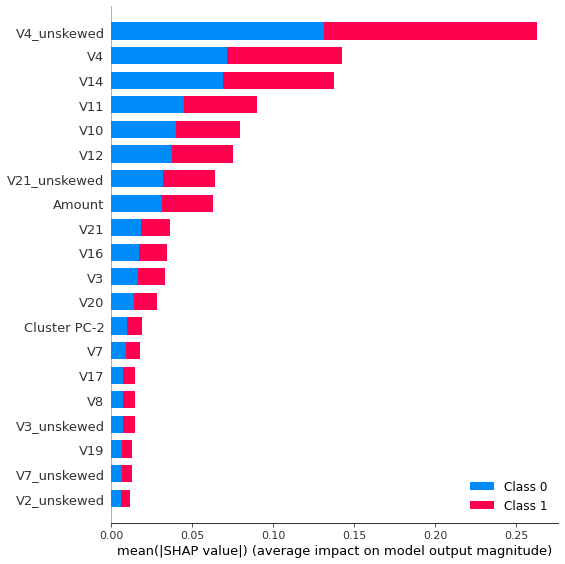

<Figure size 1152x864 with 0 Axes>

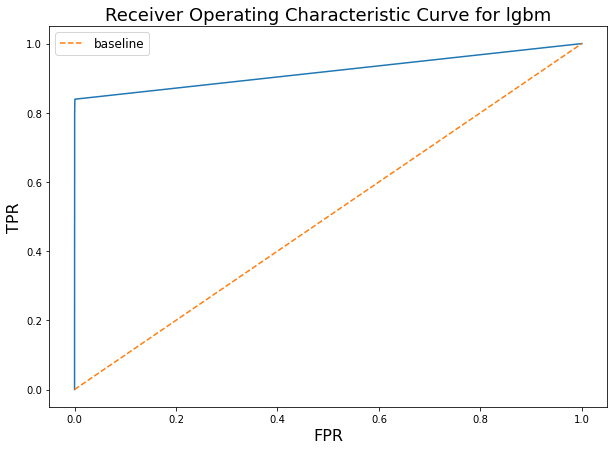

The ROC_AUC score is 0.9453509646578374


The Matthew correlation is 0.850158180440477
-------------------
The accuracy is 0.9994666666666666
The recall is 0.9994666666666666
The macro F1 score is 0.9243947325810189
The micro F1 score is 0.9994666666666666
The weighted F1 score is 0.9994515990409052
              precision    recall  f1-score   support

         0.0       1.00      1.00      1.00     29944
         1.0       0.90      0.80      0.85        56

    accuracy                           1.00     30000
   macro avg       0.95      0.90      0.92     30000
weighted avg       1.00      1.00      1.00     30000



Started Execute test train split at 14:11:55.
Started Started column type detection and casting at 14:11:55.
Started Checking for duplicate columns at 14:11:55.
Started Reset dataframe index. at 14:11:55.
Started Select best features at 14:11:55.
Started Delete columns with high share of NULLs at 14:11:55.
Started Apply datetime transformation at 14:11:55.
Started Start TFIDF to PCA loop at 14:11:55.
Started Handle rare features at 14:11:55.
Started Remove cardinality at 14:11:55.
Started Holistic NULL filling at 14:11:55.
Started Binarize numeric columns + PCA binarized features at 14:11:55.
Started Onehot + PCA categorical features at 14:11:56.
Started Execute categorical encoding at 14:11:56.
Started Fill nulls at 14:11:56.
Started Handle outliers at 14:11:56.
Started Remove collinearity at 14:11:57.
Started Remove skewness at 14:11:57.
Started Execute clustering as a feature at 14:11:57.
Started Execute clustering as a feature at 14:12:10.
Started Execute clustering as a feature at

[I 2022-01-17 14:14:12,032] A new study created in memory with name: lgbm_focal


              precision    recall  f1-score   support

           0       1.00      1.00      1.00     49935
           1       0.89      0.74      0.81        65

    accuracy                           1.00     50000
   macro avg       0.94      0.87      0.90     50000
weighted avg       1.00      1.00      1.00     50000

Score achieved on holdout dataset is: 0.8099704583590523.
End iteration for algorithm lgbm at 1642425251.8770988.
+++++++++++++++++++++++++++++++++++++++++++++++++++++++++++
Start iteration for algorithm lgbm_focal at 1642425252.011285.
Successfully loaded checkpoint last checkpoint.
Started Train LGBM with focal loss model at 14:14:12.


  0%|          | 0/50 [00:00<?, ?it/s]

[LightGBM] [Warning] Unknown parameter: gamma
[I 2022-01-17 14:14:13,001] Trial 0 finished with value: 2.6101143918088935e-07 and parameters: {'learning_rate': 0.023688639503640783, 'num_leaves': 244, 'num_boost_round': 36627, 'alpha': 0.24810409748678125, 'gamma': 16}. Best is trial 0 with value: 2.6101143918088935e-07.
[I 2022-01-17 14:14:13,266] Trial 1 finished with value: 1.2647566205952983e-23 and parameters: {'learning_rate': 0.01432169828911152, 'num_leaves': 16, 'num_boost_round': 43323, 'alpha': 0.2537815508265665, 'gamma': 71}. Best is trial 0 with value: 2.6101143918088935e-07.
[I 2022-01-17 14:14:15,155] Trial 2 finished with value: 3.722800990687638e-09 and parameters: {'learning_rate': 0.010485387725194618, 'num_leaves': 249, 'num_boost_round': 41639, 'alpha': 0.0070689749506246055, 'gamma': 19}. Best is trial 0 with value: 2.6101143918088935e-07.
[I 2022-01-17 14:14:15,466] Trial 3 finished with value: 1.1536504478320467e-11 and parameters: {'learning_rate': 0.015254729

[I 2022-01-17 14:14:32,606] Trial 29 finished with value: -119.94072213385641 and parameters: {'learning_rate': 0.06856031665656741, 'num_leaves': 250, 'num_boost_round': 1671, 'alpha': 4.482658903801731, 'gamma': 22}. Best is trial 25 with value: 0.02117596917595554.
[I 2022-01-17 14:14:32,892] Trial 30 finished with value: -74.46663047521017 and parameters: {'learning_rate': 0.09209860780398567, 'num_leaves': 150, 'num_boost_round': 17615, 'alpha': 7.208150258433598, 'gamma': 6}. Best is trial 25 with value: 0.02117596917595554.
[I 2022-01-17 14:14:34,182] Trial 31 finished with value: 6.976649802393992e-07 and parameters: {'learning_rate': 0.027843455975155147, 'num_leaves': 100, 'num_boost_round': 8102, 'alpha': 0.0017916310215592996, 'gamma': 9}. Best is trial 25 with value: 0.02117596917595554.
[I 2022-01-17 14:14:35,085] Trial 32 finished with value: 0.0007661022832313135 and parameters: {'learning_rate': 0.052454889151195366, 'num_leaves': 5, 'num_boost_round': 23853, 'alpha': 

[30]	train's focal_loss: 0.0291138	valid's focal_loss: 0.0291773
[31]	train's focal_loss: 0.0271242	valid's focal_loss: 0.0271908
[32]	train's focal_loss: 0.0252765	valid's focal_loss: 0.0253449
[33]	train's focal_loss: 0.0235602	valid's focal_loss: 0.0236316
[34]	train's focal_loss: 0.0219647	valid's focal_loss: 0.0220383
[35]	train's focal_loss: 0.0204823	valid's focal_loss: 0.020559
[36]	train's focal_loss: 0.0191042	valid's focal_loss: 0.019183
[37]	train's focal_loss: 0.0178219	valid's focal_loss: 0.0179025
[38]	train's focal_loss: 0.0166288	valid's focal_loss: 0.0167128
[39]	train's focal_loss: 0.0155184	valid's focal_loss: 0.0156046
[40]	train's focal_loss: 0.0144852	valid's focal_loss: 0.014573
[41]	train's focal_loss: 0.0135227	valid's focal_loss: 0.0136131
[42]	train's focal_loss: 0.0126266	valid's focal_loss: 0.0127165
[43]	train's focal_loss: 0.0117922	valid's focal_loss: 0.0118845
[44]	train's focal_loss: 0.0110147	valid's focal_loss: 0.0111077
[45]	train's focal_loss: 0.0

Started Predict with LGBM with focal loss at 14:14:47.
14:14:47


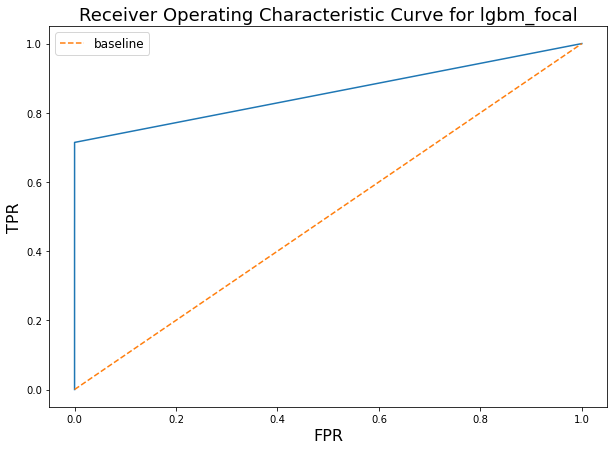

The ROC_AUC score is 0.9177882046486775


The Matthew correlation is 0.8345358437250848
-------------------
The accuracy is 0.9994333333333333
The recall is 0.9994333333333333
The macro F1 score is 0.912229237955313
The micro F1 score is 0.9994333333333333
The weighted F1 score is 0.9993895898483764
              precision    recall  f1-score   support

         0.0       1.00      1.00      1.00     29944
         1.0       0.98      0.71      0.82        56

    accuracy                           1.00     30000
   macro avg       0.99      0.86      0.91     30000
weighted avg       1.00      1.00      1.00     30000

Started Execute test train split at 14:14:49.
Started Started column type detection and casting at 14:14:49.
Started Checking for duplicate columns at 14:14:49.
Started Reset dataframe index. at 14:14:49.
Started Select best features at 14:14:49.
Started Delete columns with high share of NULLs at 14:14:49.
Started Apply datetime transformation at 14:14:49.
Started Start TFIDF to PCA loop at 14:14:49.
Started Ha

[I 2022-01-17 14:17:32,695] A new study created in memory with name: tabnet tuning


Start iteration for algorithm tabnet at 1642425452.6577582.
Successfully loaded checkpoint last checkpoint.
Started Train Tabnet classification model at 14:17:32.


  0%|          | 0/10 [00:00<?, ?it/s]


Early stopping occurred at epoch 48 with best_epoch = 18 and best_val_0_unsup_loss = 0.93367
Best weights from best epoch are automatically used!
Loading weights from unsupervised pretraining

Early stopping occurred at epoch 31 with best_epoch = 1 and best_val_0_matthews = 1.0
Best weights from best epoch are automatically used!
14:18:50
[0.7744315016601495]

Early stopping occurred at epoch 55 with best_epoch = 25 and best_val_0_unsup_loss = 0.93198
Best weights from best epoch are automatically used!
Loading weights from unsupervised pretraining

Early stopping occurred at epoch 34 with best_epoch = 4 and best_val_0_matthews = 0.0
Best weights from best epoch are automatically used!
14:20:12
[0.7744315016601495, 0.15402281650120678]

Early stopping occurred at epoch 55 with best_epoch = 25 and best_val_0_unsup_loss = 0.91778
Best weights from best epoch are automatically used!
Loading weights from unsupervised pretraining

Early stopping occurred at epoch 31 with best_epoch = 1 and


Early stopping occurred at epoch 45 with best_epoch = 15 and best_val_0_matthews = 1.0
Best weights from best epoch are automatically used!
14:42:25
[0.7440694794944864, 0.7166702525370222, 0.6842624548873839, 0.4219389899441105, 0.7249459244347269, 0.2658524613634688, 0.7222193151111687, 0.6179823814514245]

Early stopping occurred at epoch 49 with best_epoch = 19 and best_val_0_unsup_loss = 0.88667
Best weights from best epoch are automatically used!
Loading weights from unsupervised pretraining

Early stopping occurred at epoch 34 with best_epoch = 4 and best_val_0_matthews = 1.0
Best weights from best epoch are automatically used!
14:43:51
[0.7440694794944864, 0.7166702525370222, 0.6842624548873839, 0.4219389899441105, 0.7249459244347269, 0.2658524613634688, 0.7222193151111687, 0.6179823814514245, 0.7249459244347269]

Early stopping occurred at epoch 52 with best_epoch = 22 and best_val_0_unsup_loss = 0.90169
Best weights from best epoch are automatically used!
Loading weights fro


Early stopping occurred at epoch 30 with best_epoch = 0 and best_val_0_matthews = 0.0
Best weights from best epoch are automatically used!
15:02:24
[0.6585656650405458, 0.1264553413432111, 0.6778750225503396, 0.15831455520219273]

Early stopping occurred at epoch 134 with best_epoch = 104 and best_val_0_unsup_loss = 0.74975
Best weights from best epoch are automatically used!
Loading weights from unsupervised pretraining

Early stopping occurred at epoch 45 with best_epoch = 15 and best_val_0_matthews = 1.0
Best weights from best epoch are automatically used!
15:03:08
[0.6585656650405458, 0.1264553413432111, 0.6778750225503396, 0.15831455520219273, 0.7855247179105871]

Early stopping occurred at epoch 192 with best_epoch = 162 and best_val_0_unsup_loss = 0.74946
Best weights from best epoch are automatically used!
Loading weights from unsupervised pretraining

Early stopping occurred at epoch 30 with best_epoch = 0 and best_val_0_matthews = 0.0
Best weights from best epoch are automat


Early stopping occurred at epoch 59 with best_epoch = 29 and best_val_0_unsup_loss = 0.86684
Best weights from best epoch are automatically used!
Loading weights from unsupervised pretraining

Early stopping occurred at epoch 34 with best_epoch = 4 and best_val_0_matthews = 1.0
Best weights from best epoch are automatically used!
15:19:50
[0.6730519628213486]

Early stopping occurred at epoch 57 with best_epoch = 27 and best_val_0_unsup_loss = 0.91704
Best weights from best epoch are automatically used!
Loading weights from unsupervised pretraining

Early stopping occurred at epoch 43 with best_epoch = 13 and best_val_0_matthews = -0.001
Best weights from best epoch are automatically used!
15:20:32
[0.6730519628213486, 0.6967895269330681]

Early stopping occurred at epoch 58 with best_epoch = 28 and best_val_0_unsup_loss = 0.89302
Best weights from best epoch are automatically used!
Loading weights from unsupervised pretraining

Early stopping occurred at epoch 36 with best_epoch = 6 


Early stopping occurred at epoch 35 with best_epoch = 5 and best_val_0_matthews = 0.86559
Best weights from best epoch are automatically used!
15:31:26
[0.5706270753024694, 0.7285488586280746, 0.7012067033914174, 0.11324817059127848, 0.6413985360415482, 0.16542217072729432, 0.6121386570537773, 0.6440772230089032]

Early stopping occurred at epoch 55 with best_epoch = 25 and best_val_0_unsup_loss = 0.8767
Best weights from best epoch are automatically used!
Loading weights from unsupervised pretraining

Early stopping occurred at epoch 44 with best_epoch = 14 and best_val_0_matthews = 1.0
Best weights from best epoch are automatically used!
15:31:57
[0.5706270753024694, 0.7285488586280746, 0.7012067033914174, 0.11324817059127848, 0.6413985360415482, 0.16542217072729432, 0.6121386570537773, 0.6440772230089032, 0.6421892294187245]

Early stopping occurred at epoch 85 with best_epoch = 55 and best_val_0_unsup_loss = 0.8104
Best weights from best epoch are automatically used!
Loading weigh


Early stopping occurred at epoch 30 with best_epoch = 0 and best_val_0_matthews = 0.0
Best weights from best epoch are automatically used!
15:49:07
[0.7285488586280746, 0.6844356360404072, 0.7440694794944864, 0.3708670960799957]

Early stopping occurred at epoch 49 with best_epoch = 19 and best_val_0_unsup_loss = 0.90456
Best weights from best epoch are automatically used!
Loading weights from unsupervised pretraining

Early stopping occurred at epoch 41 with best_epoch = 11 and best_val_0_matthews = 1.0
Best weights from best epoch are automatically used!
15:50:23
[0.7285488586280746, 0.6844356360404072, 0.7440694794944864, 0.3708670960799957, 0.6842624548873839]

Early stopping occurred at epoch 58 with best_epoch = 28 and best_val_0_unsup_loss = 0.89806
Best weights from best epoch are automatically used!
Loading weights from unsupervised pretraining

Early stopping occurred at epoch 30 with best_epoch = 0 and best_val_0_matthews = 0.0
Best weights from best epoch are automatically

Device used : cuda
epoch 0  | loss: 1.45168 | val_0_unsup_loss: 0.91952 |  0:00:08s
epoch 1  | loss: 0.97275 | val_0_unsup_loss: 0.78824 |  0:00:16s
epoch 2  | loss: 0.90807 | val_0_unsup_loss: 1.81016 |  0:00:24s
epoch 3  | loss: 0.87262 | val_0_unsup_loss: 6.22981 |  0:00:32s
epoch 4  | loss: 0.85173 | val_0_unsup_loss: 2.39661 |  0:00:40s
epoch 5  | loss: 0.8361  | val_0_unsup_loss: 2.20905 |  0:00:49s
epoch 6  | loss: 0.81985 | val_0_unsup_loss: 2.92793 |  0:00:57s
epoch 7  | loss: 0.81467 | val_0_unsup_loss: 3.46435 |  0:01:05s
epoch 8  | loss: 0.80276 | val_0_unsup_loss: 2.96712 |  0:01:13s
epoch 9  | loss: 0.79534 | val_0_unsup_loss: 2.59111 |  0:01:21s
epoch 10 | loss: 0.78116 | val_0_unsup_loss: 2.31541 |  0:01:29s
epoch 11 | loss: 0.77181 | val_0_unsup_loss: 2.23684 |  0:01:37s
epoch 12 | loss: 0.77152 | val_0_unsup_loss: 2.58959 |  0:01:45s
epoch 13 | loss: 0.76939 | val_0_unsup_loss: 2.45386 |  0:01:53s
epoch 14 | loss: 0.76625 | val_0_unsup_loss: 2.35594 |  0:02:01s
epoch 

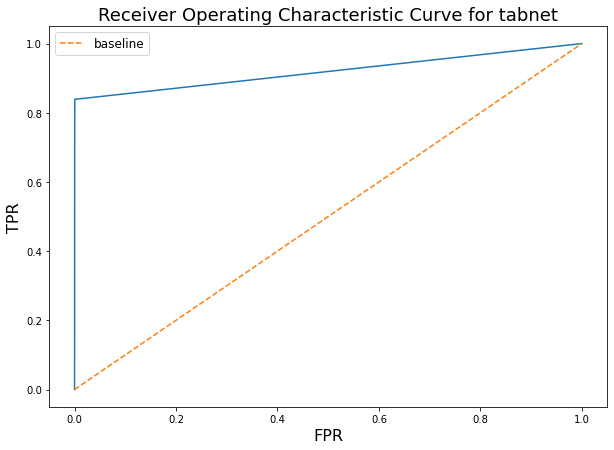

The ROC_AUC score is 0.9734534225792909


The Matthew correlation is 0.8230156362736666
-------------------
The accuracy is 0.9993666666666666
The recall is 0.9993666666666666
The macro F1 score is 0.9110563370721401
The micro F1 score is 0.9993666666666666
The weighted F1 score is 0.9993518955949118
              precision    recall  f1-score   support

         0.0       1.00      1.00      1.00     29944
         1.0       0.86      0.79      0.82        56

    accuracy                           1.00     30000
   macro avg       0.93      0.89      0.91     30000
weighted avg       1.00      1.00      1.00     30000



Started Execute test train split at 16:16:29.
Started Started column type detection and casting at 16:16:29.
Started Checking for duplicate columns at 16:16:29.
Started Reset dataframe index. at 16:16:29.
Started Select best features at 16:16:29.
Started Delete columns with high share of NULLs at 16:16:29.
Started Apply datetime transformation at 16:16:29.
Started Start TFIDF to PCA loop at 16:16:29.
Started Handle rare features at 16:16:29.
Started Remove cardinality at 16:16:29.
Started Holistic NULL filling at 16:16:29.
Started Binarize numeric columns + PCA binarized features at 16:16:29.
Started Onehot + PCA categorical features at 16:16:30.
Started Execute categorical encoding at 16:16:30.
Started Fill nulls at 16:16:30.
Started Handle outliers at 16:16:30.
Started Remove collinearity at 16:16:31.
Started Remove skewness at 16:16:31.
Started Execute clustering as a feature at 16:16:31.
Started Execute clustering as a feature at 16:16:44.
Started Execute clustering as a feature at

              precision    recall  f1-score   support

           0       1.00      1.00      1.00     49935
           1       0.91      0.66      0.77        65

    accuracy                           1.00     50000
   macro avg       0.96      0.83      0.88     50000
weighted avg       1.00      1.00      1.00     50000

Score achieved on holdout dataset is: 0.7777356322039134.
End iteration for algorithm tabnet at 1642432757.885579.
+++++++++++++++++++++++++++++++++++++++++++++++++++++++++++
Start iteration for algorithm vowpal_wabbit at 1642432758.021398.
Successfully loaded checkpoint last checkpoint.
Started Train Vowpal Wabbit model at 16:19:18.
Started Predict with Vowpal Wabbit at 16:19:25.
16:19:28


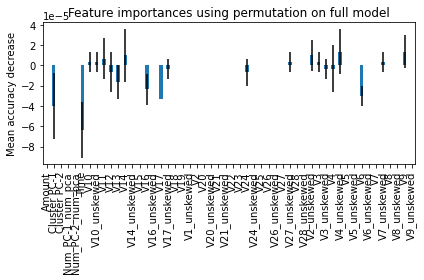

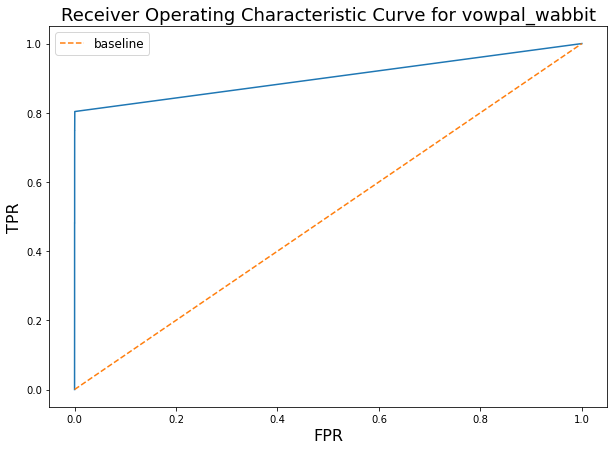

The ROC_AUC score is 0.9595858698141292


The Matthew correlation is 0.8014401446737648
-------------------
The accuracy is 0.9993
The recall is 0.9993
The macro F1 score is 0.899824693213123
The micro F1 score is 0.9993
The weighted F1 score is 0.9992767075715836
              precision    recall  f1-score   support

         0.0       1.00      1.00      1.00     29944
         1.0       0.86      0.75      0.80        56

    accuracy                           1.00     30000
   macro avg       0.93      0.87      0.90     30000
weighted avg       1.00      1.00      1.00     30000



Started Execute test train split at 16:21:35.
Started Started column type detection and casting at 16:21:35.
Started Checking for duplicate columns at 16:21:35.
Started Reset dataframe index. at 16:21:35.
Started Select best features at 16:21:35.
Started Delete columns with high share of NULLs at 16:21:35.
Started Apply datetime transformation at 16:21:35.
Started Start TFIDF to PCA loop at 16:21:35.
Started Handle rare features at 16:21:35.
Started Remove cardinality at 16:21:35.
Started Holistic NULL filling at 16:21:35.
Started Binarize numeric columns + PCA binarized features at 16:21:35.
Started Onehot + PCA categorical features at 16:21:36.
Started Execute categorical encoding at 16:21:36.
Started Fill nulls at 16:21:36.
Started Handle outliers at 16:21:36.
Started Remove collinearity at 16:21:37.
Started Remove skewness at 16:21:37.
Started Execute clustering as a feature at 16:21:37.
Started Execute clustering as a feature at 16:21:50.
Started Execute clustering as a feature at

              precision    recall  f1-score   support

           0       1.00      1.00      1.00     49935
           1       0.97      0.55      0.71        65

    accuracy                           1.00     50000
   macro avg       0.99      0.78      0.85     50000
weighted avg       1.00      1.00      1.00     50000

Score achieved on holdout dataset is: 0.7338503914663518.
End iteration for algorithm vowpal_wabbit at 1642433062.78104.
+++++++++++++++++++++++++++++++++++++++++++++++++++++++++++
Start iteration for algorithm logistic_regression at 1642433062.9183998.
Successfully loaded checkpoint last checkpoint.
Started Train logistic regression model at 16:24:22.
Started Predict with Logistic Regression at 16:24:23.
16:24:23


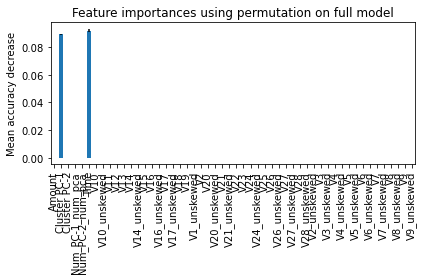

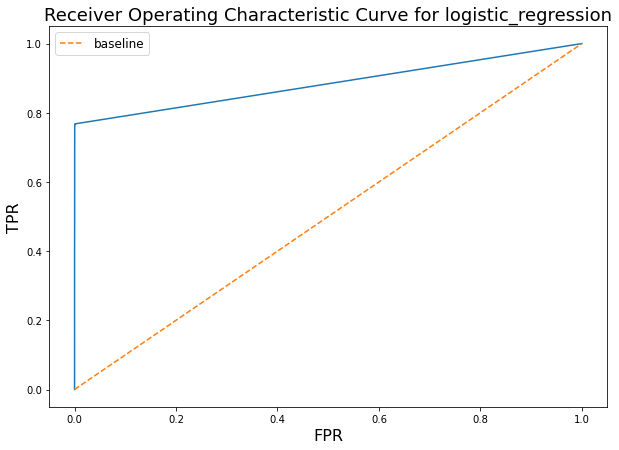

The ROC_AUC score is 0.9622599089729399


The Matthew correlation is 0.7855247179105871
-------------------
The accuracy is 0.9992333333333333
The recall is 0.9992333333333333
The macro F1 score is 0.8923313554031169
The micro F1 score is 0.9992333333333333
The weighted F1 score is 0.9992154525622615
              precision    recall  f1-score   support

         0.0       1.00      1.00      1.00     29944
         1.0       0.82      0.75      0.79        56

    accuracy                           1.00     30000
   macro avg       0.91      0.87      0.89     30000
weighted avg       1.00      1.00      1.00     30000



Started Execute test train split at 16:24:26.
Started Started column type detection and casting at 16:24:26.
Started Checking for duplicate columns at 16:24:26.
Started Reset dataframe index. at 16:24:26.
Started Select best features at 16:24:26.
Started Delete columns with high share of NULLs at 16:24:26.
Started Apply datetime transformation at 16:24:26.
Started Start TFIDF to PCA loop at 16:24:26.
Started Handle rare features at 16:24:26.
Started Remove cardinality at 16:24:26.
Started Holistic NULL filling at 16:24:26.
Started Binarize numeric columns + PCA binarized features at 16:24:26.
Started Onehot + PCA categorical features at 16:24:27.
Started Execute categorical encoding at 16:24:27.
Started Fill nulls at 16:24:27.
Started Handle outliers at 16:24:27.
Started Remove collinearity at 16:24:28.
Started Remove skewness at 16:24:28.
Started Execute clustering as a feature at 16:24:28.
Started Execute clustering as a feature at 16:24:41.
Started Execute clustering as a feature at

              precision    recall  f1-score   support

           0       1.00      1.00      1.00     49935
           1       0.83      0.69      0.76        65

    accuracy                           1.00     50000
   macro avg       0.92      0.85      0.88     50000
weighted avg       1.00      1.00      1.00     50000

Score achieved on holdout dataset is: 0.7592731599126337.
End iteration for algorithm logistic_regression at 1642433195.4804668.
+++++++++++++++++++++++++++++++++++++++++++++++++++++++++++
Start iteration for algorithm sgd at 1642433195.614563.

[I 2022-01-17 16:26:35,636] A new study created in memory with name: sgd



Successfully loaded checkpoint last checkpoint.
Started Train SGD classifier model at 16:26:35.


  0%|          | 0/100 [00:00<?, ?it/s]

[I 2022-01-17 16:26:35,863] Trial 0 finished with value: 0.010929095149104286 and parameters: {'loss': 'log', 'alpha': 24.658329458549105, 'l1_ratio': 0.06250999323228593, 'epsilon': 0.0024348773534554596, 'max_iter': 4688, 'tol': 1.7073967431528103e-05, 'normalize': True, 'power_t': 0.39663473785260006}. Best is trial 0 with value: 0.010929095149104286.
[I 2022-01-17 16:26:36,188] Trial 1 finished with value: 0.002470821353899201 and parameters: {'loss': 'log', 'alpha': 98.77700294007911, 'l1_ratio': 0.004335189736337855, 'epsilon': 0.002820996133514492, 'max_iter': 5510, 'tol': 0.00016480446427978953, 'normalize': True, 'power_t': 0.17624515035546043}. Best is trial 0 with value: 0.010929095149104286.
[I 2022-01-17 16:26:36,494] Trial 2 finished with value: 0.0054051221572065725 and parameters: {'loss': 'modified_huber', 'alpha': 0.05660670699258887, 'l1_ratio': 0.012562313237138797, 'epsilon': 0.013481575603601416, 'max_iter': 23558, 'tol': 6.290644294586152e-05, 'normalize': False,

[I 2022-01-17 16:26:43,042] Trial 22 finished with value: -0.004666149685675436 and parameters: {'loss': 'modified_huber', 'alpha': 561.6384148947801, 'l1_ratio': 0.0010459076615571313, 'epsilon': 0.0020952646669037695, 'max_iter': 29260, 'tol': 0.002062140270729075, 'normalize': False, 'power_t': 0.6888985529442667}. Best is trial 0 with value: 0.010929095149104286.
[I 2022-01-17 16:26:43,415] Trial 23 finished with value: 0.007270896113917966 and parameters: {'loss': 'log', 'alpha': 527.622613250592, 'l1_ratio': 0.0011715321055915829, 'epsilon': 0.002147387878159894, 'max_iter': 15446, 'tol': 0.0006769762964326227, 'normalize': True, 'power_t': 0.52664912896466}. Best is trial 0 with value: 0.010929095149104286.
[I 2022-01-17 16:26:43,769] Trial 24 finished with value: -8.778687545166735e-05 and parameters: {'loss': 'modified_huber', 'alpha': 525.9674672530502, 'l1_ratio': 0.0026472285099273614, 'epsilon': 0.003041553338450723, 'max_iter': 25243, 'tol': 7.673617347007203e-05, 'normal

[I 2022-01-17 16:26:50,507] Trial 44 finished with value: -0.0001714121954193874 and parameters: {'loss': 'log', 'alpha': 135.13737910962755, 'l1_ratio': 0.006259520321944912, 'epsilon': 0.01589464607630582, 'max_iter': 22139, 'tol': 1.639826560634764e-05, 'normalize': True, 'power_t': 0.6830026964377534}. Best is trial 0 with value: 0.010929095149104286.
[I 2022-01-17 16:26:50,854] Trial 45 finished with value: 0.007502967503622744 and parameters: {'loss': 'modified_huber', 'alpha': 197.06726490533842, 'l1_ratio': 0.04583888165368417, 'epsilon': 0.08565157719004904, 'max_iter': 21774, 'tol': 4.313168921451393e-05, 'normalize': True, 'power_t': 0.466164516761252}. Best is trial 0 with value: 0.010929095149104286.
[I 2022-01-17 16:26:51,188] Trial 46 finished with value: 0.008695441006237575 and parameters: {'loss': 'log', 'alpha': 16.660911558239373, 'l1_ratio': 0.03826344306323878, 'epsilon': 0.003102790259403216, 'max_iter': 3160, 'tol': 3.459282204126864e-05, 'normalize': True, 'pow

[I 2022-01-17 16:26:58,526] Trial 67 finished with value: 0.008284928152391565 and parameters: {'loss': 'log', 'alpha': 725.7424779898137, 'l1_ratio': 0.009958259021428394, 'epsilon': 0.003099741552357723, 'max_iter': 23584, 'tol': 0.0005279070948943784, 'normalize': True, 'power_t': 0.2319993868532424}. Best is trial 56 with value: 0.015649905148288335.
[I 2022-01-17 16:26:58,854] Trial 68 finished with value: 0.004496104445704417 and parameters: {'loss': 'log', 'alpha': 15.525663346550663, 'l1_ratio': 0.006658499352949023, 'epsilon': 0.0189048572154971, 'max_iter': 19545, 'tol': 0.00046028116257124265, 'normalize': False, 'power_t': 0.25896325505107953}. Best is trial 56 with value: 0.015649905148288335.
[I 2022-01-17 16:26:59,215] Trial 69 finished with value: 0.009012574086063445 and parameters: {'loss': 'log', 'alpha': 532.3547800585135, 'l1_ratio': 0.0024164385245436983, 'epsilon': 0.008716988456533433, 'max_iter': 25347, 'tol': 9.180328908141944e-05, 'normalize': True, 'power_t'

[I 2022-01-17 16:27:06,007] Trial 89 finished with value: 0.011366643666554575 and parameters: {'loss': 'modified_huber', 'alpha': 0.007264761216422832, 'l1_ratio': 0.9105297194947636, 'epsilon': 0.2852654808964387, 'max_iter': 8254, 'tol': 2.0703624041979246e-05, 'normalize': True, 'power_t': 0.15575146208069532}. Best is trial 86 with value: 0.02252812704341791.
[I 2022-01-17 16:27:06,339] Trial 90 finished with value: 0.012789543033036222 and parameters: {'loss': 'modified_huber', 'alpha': 0.009833263046233314, 'l1_ratio': 0.5784279201853445, 'epsilon': 0.2580000612278902, 'max_iter': 8927, 'tol': 4.288178850807215e-05, 'normalize': True, 'power_t': 0.22212469841305688}. Best is trial 86 with value: 0.02252812704341791.
[I 2022-01-17 16:27:06,657] Trial 91 finished with value: 0.004872414516027787 and parameters: {'loss': 'modified_huber', 'alpha': 0.04277124637552807, 'l1_ratio': 0.3389156538443251, 'epsilon': 0.2216590119747973, 'max_iter': 697, 'tol': 3.7465485650368236e-05, 'nor

Started Predict with SGD classifier at 16:27:10.
16:27:10


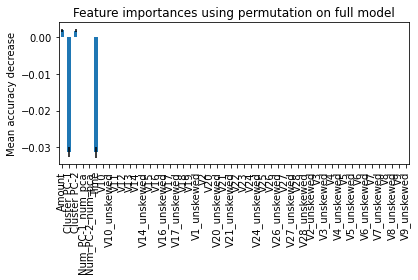

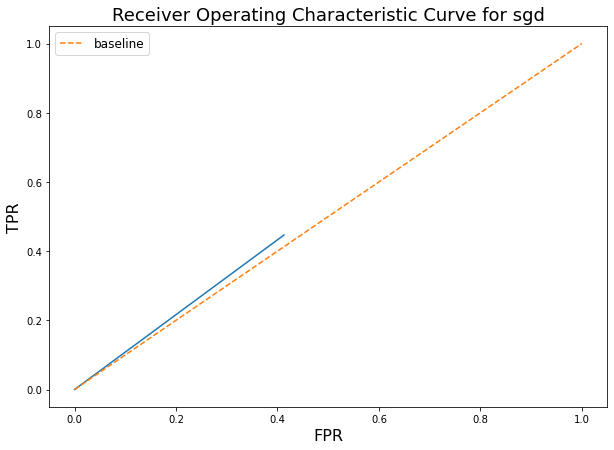

The ROC_AUC score is 0.5168791267508873


The Matthew correlation is 0.0029597510820785055
-------------------
The accuracy is 0.5870666666666666
The recall is 0.5870666666666666
The macro F1 score is 0.3717799538898251
The micro F1 score is 0.5870666666666666
The weighted F1 score is 0.7381669981600814
              precision    recall  f1-score   support

         0.0       1.00      0.59      0.74     29944
         1.0       0.00      0.45      0.00        56

    accuracy                           0.59     30000
   macro avg       0.50      0.52      0.37     30000
weighted avg       1.00      0.59      0.74     30000



Started Execute test train split at 16:27:14.
Started Started column type detection and casting at 16:27:14.
Started Checking for duplicate columns at 16:27:14.
Started Reset dataframe index. at 16:27:14.
Started Select best features at 16:27:14.
Started Delete columns with high share of NULLs at 16:27:14.
Started Apply datetime transformation at 16:27:14.
Started Start TFIDF to PCA loop at 16:27:14.
Started Handle rare features at 16:27:14.
Started Remove cardinality at 16:27:14.
Started Holistic NULL filling at 16:27:14.
Started Binarize numeric columns + PCA binarized features at 16:27:14.
Started Onehot + PCA categorical features at 16:27:14.
Started Execute categorical encoding at 16:27:14.
Started Fill nulls at 16:27:14.
Started Handle outliers at 16:27:14.
Started Remove collinearity at 16:27:15.
Started Remove skewness at 16:27:15.
Started Execute clustering as a feature at 16:27:15.
Started Execute clustering as a feature at 16:27:29.
Started Execute clustering as a feature at

              precision    recall  f1-score   support

           0       1.00      1.00      1.00     49935
           1       0.00      0.00      0.00        65

    accuracy                           1.00     50000
   macro avg       0.50      0.50      0.50     50000
weighted avg       1.00      1.00      1.00     50000

Score achieved on holdout dataset is: -0.0008840159559884403.
End iteration for algorithm sgd at 1642433369.4362006.
+++++++++++++++++++++++++++++++++++++++++++++++++++++++++++
Start iteration for algorithm quadratic_discriminant_analysis at 1642433369.5804374.
Successfully loaded checkpoint last checkpoint.
Started Train Quadratic Discriminant model at 16:29:29.
Started Predict with Quadratic Discriminant Analysis at 16:29:29.
16:29:29


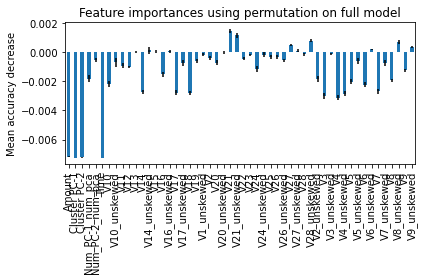

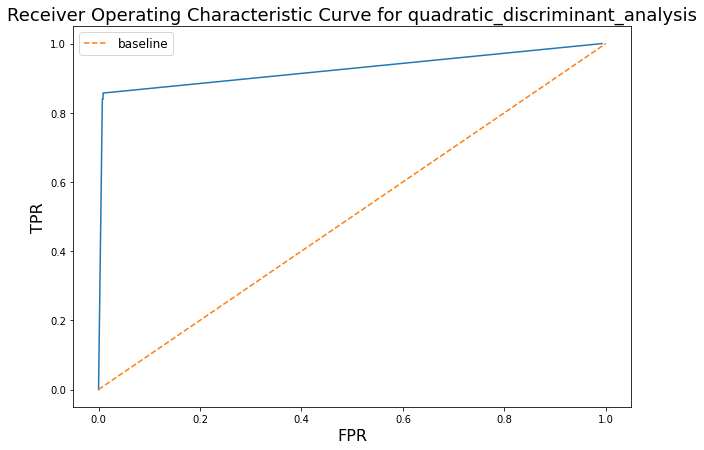

The ROC_AUC score is 0.9416607429105759


The Matthew correlation is 0.38019691632626906
-------------------
The accuracy is 0.9922666666666666
The recall is 0.9922666666666666
The macro F1 score is 0.6422278839773814
The micro F1 score is 0.9922666666666666
The weighted F1 score is 0.9947910415232921
              precision    recall  f1-score   support

         0.0       1.00      0.99      1.00     29944
         1.0       0.17      0.84      0.29        56

    accuracy                           0.99     30000
   macro avg       0.59      0.92      0.64     30000
weighted avg       1.00      0.99      0.99     30000



Started Execute test train split at 16:29:37.
Started Started column type detection and casting at 16:29:37.
Started Checking for duplicate columns at 16:29:37.
Started Reset dataframe index. at 16:29:37.
Started Select best features at 16:29:37.
Started Delete columns with high share of NULLs at 16:29:37.
Started Apply datetime transformation at 16:29:37.
Started Start TFIDF to PCA loop at 16:29:37.
Started Handle rare features at 16:29:37.
Started Remove cardinality at 16:29:37.
Started Holistic NULL filling at 16:29:37.
Started Binarize numeric columns + PCA binarized features at 16:29:37.
Started Onehot + PCA categorical features at 16:29:37.
Started Execute categorical encoding at 16:29:37.
Started Fill nulls at 16:29:37.
Started Handle outliers at 16:29:37.
Started Remove collinearity at 16:29:38.
Started Remove skewness at 16:29:38.
Started Execute clustering as a feature at 16:29:38.
Started Execute clustering as a feature at 16:29:51.
Started Execute clustering as a feature at

              precision    recall  f1-score   support

           0       1.00      1.00      1.00     49935
           1       0.24      0.78      0.36        65

    accuracy                           1.00     50000
   macro avg       0.62      0.89      0.68     50000
weighted avg       1.00      1.00      1.00     50000

Score achieved on holdout dataset is: 0.4282542315512864.
End iteration for algorithm quadratic_discriminant_analysis at 1642433532.396781.
+++++++++++++++++++++++++++++++++++++++++++++++++++++++++++
Start iteration for algorithm svm at 1642433532.531494.


[I 2022-01-17 16:32:12,553] A new study created in memory with name: svm


Successfully loaded checkpoint last checkpoint.
Started Train Support Vector Machine classifier model at 16:32:12.


  0%|          | 0/25 [00:00<?, ?it/s]

[I 2022-01-17 16:34:08,967] Trial 0 finished with value: 0.008739194206611706 and parameters: {'C': 8.616644415858344, 'max_iter': 9508, 'tol': 0.008471801418819975, 'gamma': 'scale', 'class_weight': 'balanced'}. Best is trial 0 with value: 0.008739194206611706.
[I 2022-01-17 16:36:37,239] Trial 1 finished with value: 0.0 and parameters: {'C': 361.6125071428695, 'max_iter': 6012, 'tol': 0.006796578090758156, 'gamma': 'auto', 'class_weight': 'balanced'}. Best is trial 0 with value: 0.008739194206611706.
[I 2022-01-17 16:36:39,012] Trial 2 finished with value: 0.0 and parameters: {'C': 1.991497084946204, 'max_iter': 1835, 'tol': 0.00016480446427978953, 'gamma': 'scale', 'class_weight': None}. Best is trial 0 with value: 0.008739194206611706.
[I 2022-01-17 16:37:50,032] Trial 3 finished with value: 0.0 and parameters: {'C': 1.4435885294521449, 'max_iter': 2922, 'tol': 0.0002920433847181409, 'gamma': 'auto', 'class_weight': None}. Best is trial 0 with value: 0.008739194206611706.
[I 2022-0

Started Predict with Support Vector Machine classifier at 17:00:28.
17:00:37


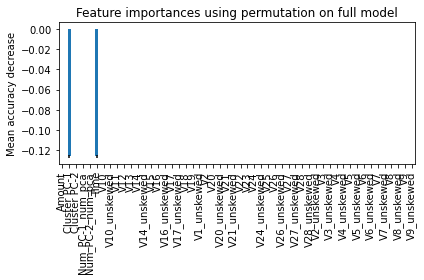

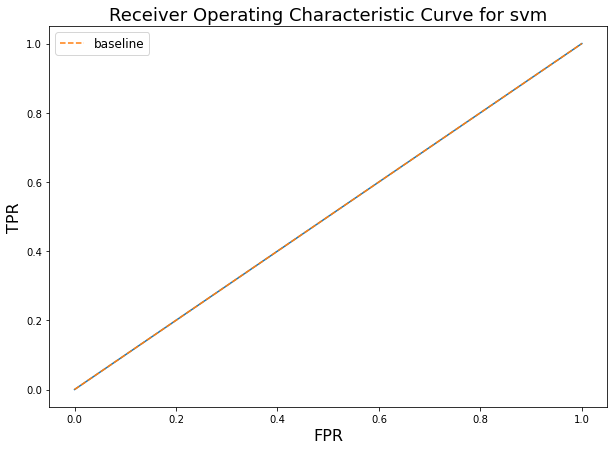

The ROC_AUC score is 0.46823117438265716


The Matthew correlation is 0.0
-------------------
The accuracy is 0.0018666666666666666
The recall is 0.0018666666666666666
The macro F1 score is 0.001863188714399787
The micro F1 score is 0.0018666666666666666
The weighted F1 score is 6.955904533759204e-06
              precision    recall  f1-score   support

         0.0       0.00      0.00      0.00     29944
         1.0       0.00      1.00      0.00        56

    accuracy                           0.00     30000
   macro avg       0.00      0.50      0.00     30000
weighted avg       0.00      0.00      0.00     30000



Started Execute test train split at 17:07:21.
Started Started column type detection and casting at 17:07:21.
Started Checking for duplicate columns at 17:07:21.
Started Reset dataframe index. at 17:07:21.
Started Select best features at 17:07:21.
Started Delete columns with high share of NULLs at 17:07:21.
Started Apply datetime transformation at 17:07:21.
Started Start TFIDF to PCA loop at 17:07:21.
Started Handle rare features at 17:07:21.
Started Remove cardinality at 17:07:21.
Started Holistic NULL filling at 17:07:21.
Started Binarize numeric columns + PCA binarized features at 17:07:21.
Started Onehot + PCA categorical features at 17:07:22.
Started Execute categorical encoding at 17:07:22.
Started Fill nulls at 17:07:22.
Started Handle outliers at 17:07:22.
Started Remove collinearity at 17:07:23.
Started Remove skewness at 17:07:23.
Started Execute clustering as a feature at 17:07:23.
Started Execute clustering as a feature at 17:07:36.
Started Execute clustering as a feature at

[I 2022-01-17 17:09:44,882] A new study created in memory with name: autoencoder_based_oversampling


              precision    recall  f1-score   support

           0       0.00      0.00      0.00     49935
           1       0.00      1.00      0.00        65

    accuracy                           0.00     50000
   macro avg       0.00      0.50      0.00     50000
weighted avg       0.00      0.00      0.00     50000

Score achieved on holdout dataset is: 0.0.
End iteration for algorithm svm at 1642435784.7303216.
+++++++++++++++++++++++++++++++++++++++++++++++++++++++++++
+++++++++++++++++++++++++++++++++++++++++++++++++++++++++++
Start iteration for checkpoint delete_low_variance_features at 1642435784.8653963.
Starting oversampling for class 0.
                Progress after this step is 50.0%.
Starting oversampling for class 1.
                Progress after this step is 100.0%.


  0%|          | 0/10 [00:00<?, ?it/s]

====> Epoch: 200 Average training loss: 7178643642.1818
====> Epoch: 200 Average test loss: 8377692745.1429
====> Epoch: 400 Average training loss: 7178642649.2121
====> Epoch: 400 Average test loss: 8377682797.7143
====> Epoch: 600 Average training loss: 7178667473.4545
====> Epoch: 600 Average test loss: 8377703277.7143
====> Epoch: 800 Average training loss: 7178669459.3939
====> Epoch: 800 Average test loss: 8377689234.2857
====> Epoch: 1000 Average training loss: 7178632223.0303
====> Epoch: 1000 Average test loss: 8377681042.2857
====> Epoch: 1200 Average training loss: 7178656550.7879
====> Epoch: 1200 Average test loss: 8377662317.7143
====> Epoch: 1400 Average training loss: 7178651089.4545
====> Epoch: 1400 Average test loss: 8377680457.1429
====> Epoch: 1600 Average training loss: 7178640663.2727
====> Epoch: 1600 Average test loss: 8377692745.1429
====> Epoch: 1800 Average training loss: 7178658536.7273
====> Epoch: 1800 Average test loss: 8377665243.4286
====> Epoch: 2000 

[I 2022-01-17 17:10:27,022] Trial 6 pruned. 
====> Epoch: 200 Average training loss: 7178662508.6061
====> Epoch: 200 Average test loss: 8377629549.7143
====> Epoch: 400 Average training loss: 7178628747.6364
====> Epoch: 400 Average test loss: 8377686893.7143
====> Epoch: 600 Average training loss: 7178647614.0606
====> Epoch: 600 Average test loss: 8377679872.0000
[I 2022-01-17 17:10:29,609] Trial 7 finished with value: 8377690404.571428 and parameters: {'optimizer_choice': 'RMSprop', 'nb_epochs': 706, 'h': 44, 'h2': 3, 'latent_dim': 3, 'optim_weight_decay': 0.6950202923669917, 'optim_learning_rate': 7.756650107887003e-05}. Best is trial 4 with value: 8377641837.714286.
[I 2022-01-17 17:10:29,755] Trial 8 pruned. 
====> Epoch: 200 Average training loss: 7178644138.6667
====> Epoch: 200 Average test loss: 8377667584.0000
====> Epoch: 400 Average training loss: 7178646124.6061
====> Epoch: 400 Average test loss: 8377647104.0000
====> Epoch: 600 Average training loss: 7178663005.0909
==

====> Epoch: 200 Average training loss: 7178623782.7879
====> Epoch: 200 Average test loss: 8377659977.1429
====> Epoch: 400 Average training loss: 7178609881.2121
====> Epoch: 400 Average test loss: 8377644178.2857
====> Epoch: 600 Average training loss: 7178610874.1818
====> Epoch: 600 Average test loss: 8377619017.1429
====> Epoch: 800 Average training loss: 7178606405.8182
====> Epoch: 800 Average test loss: 8377638326.8571
====> Epoch: 1000 Average training loss: 7178554274.9091
====> Epoch: 1000 Average test loss: 8377632475.4286
====> Epoch: 1200 Average training loss: 7178586049.9394
====> Epoch: 1200 Average test loss: 8377585664.0000
====> Epoch: 1400 Average training loss: 7178542359.2727
====> Epoch: 1400 Average test loss: 8377573376.0000
====> Epoch: 1600 Average training loss: 7178560729.2121
====> Epoch: 1600 Average test loss: 8377568109.7143
====> Epoch: 1800 Average training loss: 7178552785.4545
====> Epoch: 1800 Average test loss: 8377573961.1429
====> Epoch: 2000 

[I 2022-01-17 17:10:46,676] A new study created in memory with name: ridge


All algorithms to be tested are: ['ridge', 'lgbm', 'lgbm_focal', 'tabnet', 'vowpal_wabbit', 'logistic_regression', 'sgd', 'quadratic_discriminant_analysis', 'svm'].
Start iteration for algorithm ridge at 1642435846.618087.
Successfully loaded checkpoint last checkpoint.
Started Train Ridge classifier model at 17:10:46.


  0%|          | 0/10 [00:00<?, ?it/s]

[I 2022-01-17 17:10:47,163] Trial 0 finished with value: 0.9982029397880792 and parameters: {'solver': 'svd', 'alpha': 157.41890047456639, 'max_iter': 6015, 'tol': 0.006796578090758156, 'normalize': False}. Best is trial 0 with value: 0.9982029397880792.
[I 2022-01-17 17:10:47,471] Trial 1 finished with value: 0.9982025357665943 and parameters: {'solver': 'auto', 'alpha': 0.055895242052179224, 'max_iter': 6123, 'tol': 3.613894271216525e-05, 'normalize': False}. Best is trial 0 with value: 0.9982029397880792.
[I 2022-01-17 17:10:47,918] Trial 2 finished with value: 0.9984023457473125 and parameters: {'solver': 'svd', 'alpha': 0.010547383621352036, 'max_iter': 659, 'tol': 0.06245139574743072, 'normalize': True}. Best is trial 2 with value: 0.9984023457473125.
[I 2022-01-17 17:10:48,182] Trial 3 finished with value: 0.9982029397880792 and parameters: {'solver': 'cholesky', 'alpha': 285.7080075040722, 'max_iter': 2595, 'tol': 0.004467752817973905, 'normalize': False}. Best is trial 2 with 

Started Predict with Ridge classifier at 17:14:41.
17:14:41


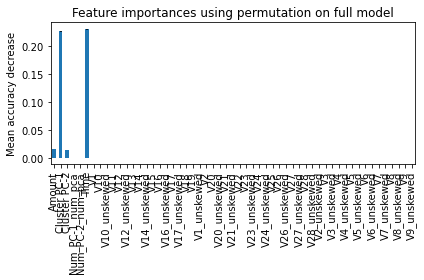

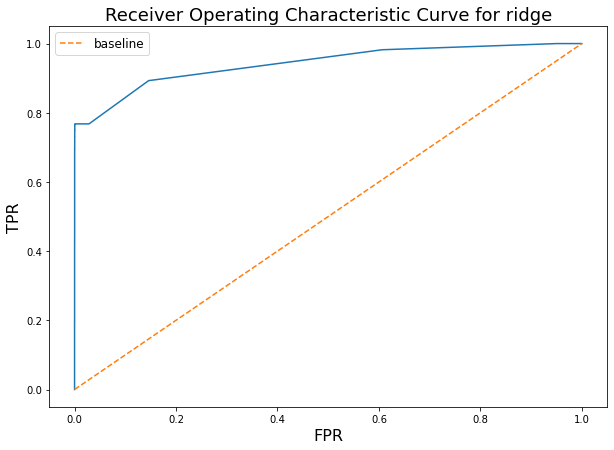

The ROC_AUC score is 0.9431981365215069


The Matthew correlation is 0.7853316686191673
-------------------
The accuracy is 0.9992666666666666
The recall is 0.9992666666666666
The macro F1 score is 0.8898163606010017
The micro F1 score is 0.9992666666666666
The weighted F1 score is 0.9992227401224262
              precision    recall  f1-score   support

         0.0       1.00      1.00      1.00     29944
         1.0       0.89      0.70      0.78        56

    accuracy                           1.00     30000
   macro avg       0.94      0.85      0.89     30000
weighted avg       1.00      1.00      1.00     30000



Started Execute test train split at 17:14:51.
Started Started column type detection and casting at 17:14:51.
Started Checking for duplicate columns at 17:14:51.
Started Reset dataframe index. at 17:14:51.
Started Select best features at 17:14:51.
Started Delete columns with high share of NULLs at 17:14:51.
Started Apply datetime transformation at 17:14:51.
Started Start TFIDF to PCA loop at 17:14:51.
Started Handle rare features at 17:14:51.
Started Remove cardinality at 17:14:51.
Started Holistic NULL filling at 17:14:51.
Started Binarize numeric columns + PCA binarized features at 17:14:51.
Started Onehot + PCA categorical features at 17:14:52.
Started Execute categorical encoding at 17:14:52.
Started Fill nulls at 17:14:52.
Started Handle outliers at 17:14:52.
Started Remove collinearity at 17:14:53.
Started Remove skewness at 17:14:53.
Started Execute clustering as a feature at 17:14:53.
Started Execute clustering as a feature at 17:15:06.
Started Execute clustering as a feature at

              precision    recall  f1-score   support

           0       1.00      1.00      1.00     49935
           1       0.90      0.43      0.58        65

    accuracy                           1.00     50000
   macro avg       0.95      0.72      0.79     50000
weighted avg       1.00      1.00      1.00     50000

Score achieved on holdout dataset is: 0.6234650746107965.
End iteration for algorithm ridge at 1642436226.1193817.
+++++++++++++++++++++++++++++++++++++++++++++++++++++++++++
Start iteration for algorithm lgbm at 1642436226.2583048.
Successfully loaded checkpoint last checkpoint.
Started Train LGBM at 17:17:06.
Started Check LGBM for GPU acceleration. at 17:17:06.
LGBM uses GPU.


[I 2022-01-17 17:17:06,323] A new study created in memory with name: lgbm tuning


  0%|          | 0/10 [00:00<?, ?it/s]

[I 2022-01-17 17:17:06,438] Trial 0 finished with value: 0.6931474161802916 and parameters: {'num_boost_round': 18789, 'lambda_l1': 506157.68887523044, 'lambda_l2': 24658.3294585491, 'num_leaves': 154, 'feature_fraction': 0.4936111842654619, 'feature_fraction_bynode': 0.49359671220172163, 'learning_rate': 1.7073967431528103e-05}. Best is trial 0 with value: 0.6931474161802916.
[I 2022-01-17 17:17:06,633] Trial 1 finished with value: 0.6931474161802915 and parameters: {'num_boost_round': 43323, 'lambda_l1': 4042.8727350273302, 'lambda_l2': 17718.847354806814, 'num_leaves': 7, 'feature_fraction': 0.9819459112971965, 'feature_fraction_bynode': 0.899465584480253, 'learning_rate': 7.068974950624602e-05}. Best is trial 1 with value: 0.6931474161802915.
[I 2022-01-17 17:17:26,362] Trial 2 finished with value: 0.034249524541639875 and parameters: {'num_boost_round': 9173, 'lambda_l1': 12.601639723276797, 'lambda_l2': 66.904211664988, 'num_leaves': 135, 'feature_fraction': 0.6591670111852694, '

[1]	train's binary_logloss: 0.636954	valid's binary_logloss: 0.637046
Training until validation scores don't improve for 10 rounds
[2]	train's binary_logloss: 0.596332	valid's binary_logloss: 0.593778
[3]	train's binary_logloss: 0.558992	valid's binary_logloss: 0.556012
[4]	train's binary_logloss: 0.517118	valid's binary_logloss: 0.514552
[5]	train's binary_logloss: 0.481838	valid's binary_logloss: 0.48187
[6]	train's binary_logloss: 0.450109	valid's binary_logloss: 0.452815
[7]	train's binary_logloss: 0.418733	valid's binary_logloss: 0.421298
[8]	train's binary_logloss: 0.392214	valid's binary_logloss: 0.396765
[9]	train's binary_logloss: 0.366025	valid's binary_logloss: 0.370281
[10]	train's binary_logloss: 0.347939	valid's binary_logloss: 0.350487
[11]	train's binary_logloss: 0.32554	valid's binary_logloss: 0.327981
[12]	train's binary_logloss: 0.306765	valid's binary_logloss: 0.310852
[13]	train's binary_logloss: 0.289443	valid's binary_logloss: 0.294977
[14]	train's binary_logloss

[217]	train's binary_logloss: 0.00882878	valid's binary_logloss: 0.0111826
[218]	train's binary_logloss: 0.00879132	valid's binary_logloss: 0.0111527
[219]	train's binary_logloss: 0.00876076	valid's binary_logloss: 0.0111132
[220]	train's binary_logloss: 0.00871131	valid's binary_logloss: 0.011059
[221]	train's binary_logloss: 0.00866246	valid's binary_logloss: 0.0110035
[222]	train's binary_logloss: 0.00863308	valid's binary_logloss: 0.0109674
[223]	train's binary_logloss: 0.00858528	valid's binary_logloss: 0.0109152
[224]	train's binary_logloss: 0.00855557	valid's binary_logloss: 0.0108784
[225]	train's binary_logloss: 0.00852089	valid's binary_logloss: 0.0108506
[226]	train's binary_logloss: 0.00847501	valid's binary_logloss: 0.0107993
[227]	train's binary_logloss: 0.00842945	valid's binary_logloss: 0.0107494
[228]	train's binary_logloss: 0.00839396	valid's binary_logloss: 0.0107188
[229]	train's binary_logloss: 0.00836042	valid's binary_logloss: 0.0106916
[230]	train's binary_loglo

[326]	train's binary_logloss: 0.00597805	valid's binary_logloss: 0.00823744
[327]	train's binary_logloss: 0.00595999	valid's binary_logloss: 0.00821655
[328]	train's binary_logloss: 0.00594866	valid's binary_logloss: 0.00820312
[329]	train's binary_logloss: 0.00593604	valid's binary_logloss: 0.00819332
[330]	train's binary_logloss: 0.00592292	valid's binary_logloss: 0.00818324
[331]	train's binary_logloss: 0.00591208	valid's binary_logloss: 0.00816944
[332]	train's binary_logloss: 0.00589872	valid's binary_logloss: 0.00815873
[333]	train's binary_logloss: 0.00588472	valid's binary_logloss: 0.00814686
[334]	train's binary_logloss: 0.0058668	valid's binary_logloss: 0.00812713
[335]	train's binary_logloss: 0.00585036	valid's binary_logloss: 0.0081086
[336]	train's binary_logloss: 0.00583921	valid's binary_logloss: 0.00809541
[337]	train's binary_logloss: 0.00582171	valid's binary_logloss: 0.00807622
[338]	train's binary_logloss: 0.0058083	valid's binary_logloss: 0.00806469
[339]	train's b

[530]	train's binary_logloss: 0.00413441	valid's binary_logloss: 0.00633697
[531]	train's binary_logloss: 0.0041305	valid's binary_logloss: 0.00633308
[532]	train's binary_logloss: 0.00412553	valid's binary_logloss: 0.00632905
[533]	train's binary_logloss: 0.00412162	valid's binary_logloss: 0.00632509
[534]	train's binary_logloss: 0.00411774	valid's binary_logloss: 0.00632056
[535]	train's binary_logloss: 0.00411296	valid's binary_logloss: 0.00631649
[536]	train's binary_logloss: 0.00410817	valid's binary_logloss: 0.00631257
[537]	train's binary_logloss: 0.00410357	valid's binary_logloss: 0.00630904
[538]	train's binary_logloss: 0.0040975	valid's binary_logloss: 0.00630208
[539]	train's binary_logloss: 0.00409145	valid's binary_logloss: 0.00629512
[540]	train's binary_logloss: 0.00408543	valid's binary_logloss: 0.00628851
[541]	train's binary_logloss: 0.00408136	valid's binary_logloss: 0.00628379
[542]	train's binary_logloss: 0.00407698	valid's binary_logloss: 0.00628037
[543]	train's 

[729]	train's binary_logloss: 0.00337938	valid's binary_logloss: 0.00556599
[730]	train's binary_logloss: 0.00337701	valid's binary_logloss: 0.00556399
[731]	train's binary_logloss: 0.00337389	valid's binary_logloss: 0.00556036
[732]	train's binary_logloss: 0.00337089	valid's binary_logloss: 0.00555709
[733]	train's binary_logloss: 0.00336888	valid's binary_logloss: 0.00555481
[734]	train's binary_logloss: 0.00336651	valid's binary_logloss: 0.0055528
[735]	train's binary_logloss: 0.0033641	valid's binary_logloss: 0.0055508
[736]	train's binary_logloss: 0.00336101	valid's binary_logloss: 0.00554721
[737]	train's binary_logloss: 0.00335849	valid's binary_logloss: 0.0055452
[738]	train's binary_logloss: 0.00335554	valid's binary_logloss: 0.00554182
[739]	train's binary_logloss: 0.00335315	valid's binary_logloss: 0.00553982
[740]	train's binary_logloss: 0.00335096	valid's binary_logloss: 0.00553704
[741]	train's binary_logloss: 0.00334863	valid's binary_logloss: 0.00553509
[742]	train's bi

[909]	train's binary_logloss: 0.00299702	valid's binary_logloss: 0.00518763
[910]	train's binary_logloss: 0.00299506	valid's binary_logloss: 0.00518573
[911]	train's binary_logloss: 0.00299341	valid's binary_logloss: 0.00518446
[912]	train's binary_logloss: 0.00299177	valid's binary_logloss: 0.0051833
[913]	train's binary_logloss: 0.00299048	valid's binary_logloss: 0.00518251
[914]	train's binary_logloss: 0.0029885	valid's binary_logloss: 0.00518029
[915]	train's binary_logloss: 0.00298703	valid's binary_logloss: 0.00517877
[916]	train's binary_logloss: 0.00298547	valid's binary_logloss: 0.00517745
[917]	train's binary_logloss: 0.00298396	valid's binary_logloss: 0.00517582
[918]	train's binary_logloss: 0.00298195	valid's binary_logloss: 0.00517343
[919]	train's binary_logloss: 0.00298037	valid's binary_logloss: 0.00517207
[920]	train's binary_logloss: 0.00297885	valid's binary_logloss: 0.00517078
[921]	train's binary_logloss: 0.00297737	valid's binary_logloss: 0.00516974
[922]	train's 

[1079]	train's binary_logloss: 0.00275007	valid's binary_logloss: 0.00494176
[1080]	train's binary_logloss: 0.00274858	valid's binary_logloss: 0.00493999
[1081]	train's binary_logloss: 0.00274742	valid's binary_logloss: 0.00493857
[1082]	train's binary_logloss: 0.00274597	valid's binary_logloss: 0.00493712
[1083]	train's binary_logloss: 0.00274487	valid's binary_logloss: 0.00493584
[1084]	train's binary_logloss: 0.00274341	valid's binary_logloss: 0.00493407
[1085]	train's binary_logloss: 0.00274196	valid's binary_logloss: 0.0049326
[1086]	train's binary_logloss: 0.00274077	valid's binary_logloss: 0.00493124
[1087]	train's binary_logloss: 0.00273932	valid's binary_logloss: 0.0049295
[1088]	train's binary_logloss: 0.00273791	valid's binary_logloss: 0.00492783
[1089]	train's binary_logloss: 0.00273652	valid's binary_logloss: 0.00492649
[1090]	train's binary_logloss: 0.00273542	valid's binary_logloss: 0.00492551
[1091]	train's binary_logloss: 0.0027343	valid's binary_logloss: 0.00492447
[1

[1251]	train's binary_logloss: 0.00255849	valid's binary_logloss: 0.00474134
[1252]	train's binary_logloss: 0.00255763	valid's binary_logloss: 0.00474041
[1253]	train's binary_logloss: 0.00255656	valid's binary_logloss: 0.00473932
[1254]	train's binary_logloss: 0.00255553	valid's binary_logloss: 0.00473846
[1255]	train's binary_logloss: 0.00255458	valid's binary_logloss: 0.00473768
[1256]	train's binary_logloss: 0.00255346	valid's binary_logloss: 0.00473636
[1257]	train's binary_logloss: 0.00255237	valid's binary_logloss: 0.00473515
[1258]	train's binary_logloss: 0.00255123	valid's binary_logloss: 0.00473392
[1259]	train's binary_logloss: 0.00255019	valid's binary_logloss: 0.00473286
[1260]	train's binary_logloss: 0.00254929	valid's binary_logloss: 0.00473185
[1261]	train's binary_logloss: 0.00254847	valid's binary_logloss: 0.00473123
[1262]	train's binary_logloss: 0.00254736	valid's binary_logloss: 0.0047301
[1263]	train's binary_logloss: 0.00254656	valid's binary_logloss: 0.00472919


[1418]	train's binary_logloss: 0.00241277	valid's binary_logloss: 0.00459283
[1419]	train's binary_logloss: 0.00241192	valid's binary_logloss: 0.0045919
[1420]	train's binary_logloss: 0.00241117	valid's binary_logloss: 0.00459101
[1421]	train's binary_logloss: 0.0024103	valid's binary_logloss: 0.00458995
[1422]	train's binary_logloss: 0.00240944	valid's binary_logloss: 0.00458904
[1423]	train's binary_logloss: 0.00240853	valid's binary_logloss: 0.00458808
[1424]	train's binary_logloss: 0.00240767	valid's binary_logloss: 0.0045872
[1425]	train's binary_logloss: 0.00240692	valid's binary_logloss: 0.00458642
[1426]	train's binary_logloss: 0.00240604	valid's binary_logloss: 0.00458552
[1427]	train's binary_logloss: 0.00240518	valid's binary_logloss: 0.0045845
[1428]	train's binary_logloss: 0.00240442	valid's binary_logloss: 0.0045837
[1429]	train's binary_logloss: 0.00240359	valid's binary_logloss: 0.00458284
[1430]	train's binary_logloss: 0.00240275	valid's binary_logloss: 0.00458195
[143

[1579]	train's binary_logloss: 0.00229642	valid's binary_logloss: 0.00447145
[1580]	train's binary_logloss: 0.00229578	valid's binary_logloss: 0.00447074
[1581]	train's binary_logloss: 0.00229511	valid's binary_logloss: 0.00447007
[1582]	train's binary_logloss: 0.00229453	valid's binary_logloss: 0.00446952
[1583]	train's binary_logloss: 0.00229391	valid's binary_logloss: 0.00446901
[1584]	train's binary_logloss: 0.00229317	valid's binary_logloss: 0.00446815
[1585]	train's binary_logloss: 0.0022925	valid's binary_logloss: 0.00446748
[1586]	train's binary_logloss: 0.00229179	valid's binary_logloss: 0.0044667
[1587]	train's binary_logloss: 0.00229118	valid's binary_logloss: 0.00446603
[1588]	train's binary_logloss: 0.00229057	valid's binary_logloss: 0.00446561
[1589]	train's binary_logloss: 0.00229002	valid's binary_logloss: 0.00446519
[1590]	train's binary_logloss: 0.00228939	valid's binary_logloss: 0.00446448
[1591]	train's binary_logloss: 0.00228868	valid's binary_logloss: 0.00446364
[

[1739]	train's binary_logloss: 0.00220125	valid's binary_logloss: 0.00437635
[1740]	train's binary_logloss: 0.00220075	valid's binary_logloss: 0.004376
[1741]	train's binary_logloss: 0.00220014	valid's binary_logloss: 0.00437536
[1742]	train's binary_logloss: 0.00219957	valid's binary_logloss: 0.00437471
[1743]	train's binary_logloss: 0.00219898	valid's binary_logloss: 0.004374
[1744]	train's binary_logloss: 0.00219849	valid's binary_logloss: 0.00437359
[1745]	train's binary_logloss: 0.0021979	valid's binary_logloss: 0.00437291
[1746]	train's binary_logloss: 0.00219729	valid's binary_logloss: 0.00437223
[1747]	train's binary_logloss: 0.0021968	valid's binary_logloss: 0.0043717
[1748]	train's binary_logloss: 0.00219621	valid's binary_logloss: 0.00437114
[1749]	train's binary_logloss: 0.00219573	valid's binary_logloss: 0.00437077
[1750]	train's binary_logloss: 0.00219515	valid's binary_logloss: 0.00437014
[1751]	train's binary_logloss: 0.00219468	valid's binary_logloss: 0.0043697
[1752]	

[1897]	train's binary_logloss: 0.0021202	valid's binary_logloss: 0.0042962
[1898]	train's binary_logloss: 0.00211976	valid's binary_logloss: 0.00429591
[1899]	train's binary_logloss: 0.00211927	valid's binary_logloss: 0.00429545
[1900]	train's binary_logloss: 0.0021188	valid's binary_logloss: 0.004295
[1901]	train's binary_logloss: 0.00211827	valid's binary_logloss: 0.00429444
[1902]	train's binary_logloss: 0.00211775	valid's binary_logloss: 0.00429385
[1903]	train's binary_logloss: 0.00211728	valid's binary_logloss: 0.00429342
[1904]	train's binary_logloss: 0.00211676	valid's binary_logloss: 0.0042929
[1905]	train's binary_logloss: 0.0021163	valid's binary_logloss: 0.00429251
[1906]	train's binary_logloss: 0.00211586	valid's binary_logloss: 0.0042921
[1907]	train's binary_logloss: 0.00211544	valid's binary_logloss: 0.00429185
[1908]	train's binary_logloss: 0.00211495	valid's binary_logloss: 0.00429137
[1909]	train's binary_logloss: 0.00211451	valid's binary_logloss: 0.00429096
[1910]	

[2043]	train's binary_logloss: 0.00205537	valid's binary_logloss: 0.00423461
[2044]	train's binary_logloss: 0.00205493	valid's binary_logloss: 0.00423414
[2045]	train's binary_logloss: 0.00205456	valid's binary_logloss: 0.00423385
[2046]	train's binary_logloss: 0.00205416	valid's binary_logloss: 0.00423363
[2047]	train's binary_logloss: 0.00205376	valid's binary_logloss: 0.00423326
[2048]	train's binary_logloss: 0.00205342	valid's binary_logloss: 0.00423292
[2049]	train's binary_logloss: 0.00205296	valid's binary_logloss: 0.00423267
[2050]	train's binary_logloss: 0.00205252	valid's binary_logloss: 0.00423219
[2051]	train's binary_logloss: 0.00205211	valid's binary_logloss: 0.00423173
[2052]	train's binary_logloss: 0.00205167	valid's binary_logloss: 0.00423129
[2053]	train's binary_logloss: 0.00205121	valid's binary_logloss: 0.00423082
[2054]	train's binary_logloss: 0.00205077	valid's binary_logloss: 0.00423037
[2055]	train's binary_logloss: 0.00205038	valid's binary_logloss: 0.00423002

[2189]	train's binary_logloss: 0.00199732	valid's binary_logloss: 0.0041806
[2190]	train's binary_logloss: 0.00199695	valid's binary_logloss: 0.00418028
[2191]	train's binary_logloss: 0.00199653	valid's binary_logloss: 0.00417984
[2192]	train's binary_logloss: 0.00199616	valid's binary_logloss: 0.00417944
[2193]	train's binary_logloss: 0.00199574	valid's binary_logloss: 0.00417901
[2194]	train's binary_logloss: 0.00199537	valid's binary_logloss: 0.0041787
[2195]	train's binary_logloss: 0.00199503	valid's binary_logloss: 0.00417841
[2196]	train's binary_logloss: 0.00199463	valid's binary_logloss: 0.00417797
[2197]	train's binary_logloss: 0.00199427	valid's binary_logloss: 0.00417768
[2198]	train's binary_logloss: 0.00199386	valid's binary_logloss: 0.00417721
[2199]	train's binary_logloss: 0.0019935	valid's binary_logloss: 0.00417687
[2200]	train's binary_logloss: 0.00199315	valid's binary_logloss: 0.00417664
[2201]	train's binary_logloss: 0.00199275	valid's binary_logloss: 0.00417619
[2

[2330]	train's binary_logloss: 0.00194706	valid's binary_logloss: 0.00413482
[2331]	train's binary_logloss: 0.0019467	valid's binary_logloss: 0.00413453
[2332]	train's binary_logloss: 0.00194633	valid's binary_logloss: 0.00413415
[2333]	train's binary_logloss: 0.001946	valid's binary_logloss: 0.00413381
[2334]	train's binary_logloss: 0.00194567	valid's binary_logloss: 0.00413352
[2335]	train's binary_logloss: 0.00194529	valid's binary_logloss: 0.00413316
[2336]	train's binary_logloss: 0.00194495	valid's binary_logloss: 0.0041329
[2337]	train's binary_logloss: 0.00194462	valid's binary_logloss: 0.00413254
[2338]	train's binary_logloss: 0.00194425	valid's binary_logloss: 0.00413217
[2339]	train's binary_logloss: 0.00194395	valid's binary_logloss: 0.00413196
[2340]	train's binary_logloss: 0.00194358	valid's binary_logloss: 0.00413162
[2341]	train's binary_logloss: 0.00194328	valid's binary_logloss: 0.00413142
[2342]	train's binary_logloss: 0.00194291	valid's binary_logloss: 0.00413106
[23

[2475]	train's binary_logloss: 0.00190021	valid's binary_logloss: 0.00409188
[2476]	train's binary_logloss: 0.00189993	valid's binary_logloss: 0.00409158
[2477]	train's binary_logloss: 0.00189964	valid's binary_logloss: 0.00409136
[2478]	train's binary_logloss: 0.00189934	valid's binary_logloss: 0.00409111
[2479]	train's binary_logloss: 0.00189902	valid's binary_logloss: 0.00409081
[2480]	train's binary_logloss: 0.00189868	valid's binary_logloss: 0.00409046
[2481]	train's binary_logloss: 0.00189835	valid's binary_logloss: 0.00409011
[2482]	train's binary_logloss: 0.00189802	valid's binary_logloss: 0.00408975
[2483]	train's binary_logloss: 0.00189772	valid's binary_logloss: 0.00408952
[2484]	train's binary_logloss: 0.00189743	valid's binary_logloss: 0.00408922
[2485]	train's binary_logloss: 0.00189717	valid's binary_logloss: 0.00408905
[2486]	train's binary_logloss: 0.00189687	valid's binary_logloss: 0.00408889
[2487]	train's binary_logloss: 0.00189656	valid's binary_logloss: 0.00408869

[2623]	train's binary_logloss: 0.00185681	valid's binary_logloss: 0.00405414
[2624]	train's binary_logloss: 0.00185655	valid's binary_logloss: 0.00405387
[2625]	train's binary_logloss: 0.00185627	valid's binary_logloss: 0.00405356
[2626]	train's binary_logloss: 0.00185597	valid's binary_logloss: 0.0040533
[2627]	train's binary_logloss: 0.00185567	valid's binary_logloss: 0.00405302
[2628]	train's binary_logloss: 0.00185542	valid's binary_logloss: 0.0040527
[2629]	train's binary_logloss: 0.00185513	valid's binary_logloss: 0.0040524
[2630]	train's binary_logloss: 0.00185486	valid's binary_logloss: 0.0040521
[2631]	train's binary_logloss: 0.00185456	valid's binary_logloss: 0.00405178
[2632]	train's binary_logloss: 0.00185425	valid's binary_logloss: 0.00405147
[2633]	train's binary_logloss: 0.00185397	valid's binary_logloss: 0.00405128
[2634]	train's binary_logloss: 0.00185367	valid's binary_logloss: 0.00405095
[2635]	train's binary_logloss: 0.00185339	valid's binary_logloss: 0.00405073
[26

[2778]	train's binary_logloss: 0.00181531	valid's binary_logloss: 0.00401915
[2779]	train's binary_logloss: 0.00181506	valid's binary_logloss: 0.00401897
[2780]	train's binary_logloss: 0.00181484	valid's binary_logloss: 0.00401876
[2781]	train's binary_logloss: 0.00181457	valid's binary_logloss: 0.00401858
[2782]	train's binary_logloss: 0.00181432	valid's binary_logloss: 0.0040184
[2783]	train's binary_logloss: 0.00181407	valid's binary_logloss: 0.00401817
[2784]	train's binary_logloss: 0.0018138	valid's binary_logloss: 0.00401794
[2785]	train's binary_logloss: 0.00181353	valid's binary_logloss: 0.00401766
[2786]	train's binary_logloss: 0.00181329	valid's binary_logloss: 0.00401751
[2787]	train's binary_logloss: 0.00181305	valid's binary_logloss: 0.0040173
[2788]	train's binary_logloss: 0.00181279	valid's binary_logloss: 0.00401704
[2789]	train's binary_logloss: 0.00181253	valid's binary_logloss: 0.00401678
[2790]	train's binary_logloss: 0.0018123	valid's binary_logloss: 0.00401657
[27

[2915]	train's binary_logloss: 0.00178187	valid's binary_logloss: 0.00399011
[2916]	train's binary_logloss: 0.00178167	valid's binary_logloss: 0.00399
[2917]	train's binary_logloss: 0.00178142	valid's binary_logloss: 0.00398981
[2918]	train's binary_logloss: 0.0017812	valid's binary_logloss: 0.00398962
[2919]	train's binary_logloss: 0.00178101	valid's binary_logloss: 0.00398959
[2920]	train's binary_logloss: 0.0017808	valid's binary_logloss: 0.00398947
[2921]	train's binary_logloss: 0.00178057	valid's binary_logloss: 0.00398931
[2922]	train's binary_logloss: 0.00178031	valid's binary_logloss: 0.00398908
[2923]	train's binary_logloss: 0.00178006	valid's binary_logloss: 0.00398888
[2924]	train's binary_logloss: 0.0017798	valid's binary_logloss: 0.00398876
[2925]	train's binary_logloss: 0.00177954	valid's binary_logloss: 0.00398852
[2926]	train's binary_logloss: 0.00177925	valid's binary_logloss: 0.00398832
[2927]	train's binary_logloss: 0.001779	valid's binary_logloss: 0.00398808
[2928]	

[3054]	train's binary_logloss: 0.00174994	valid's binary_logloss: 0.00396473
[3055]	train's binary_logloss: 0.00174966	valid's binary_logloss: 0.0039646
[3056]	train's binary_logloss: 0.00174946	valid's binary_logloss: 0.00396442
[3057]	train's binary_logloss: 0.00174924	valid's binary_logloss: 0.00396422
[3058]	train's binary_logloss: 0.00174905	valid's binary_logloss: 0.00396412
[3059]	train's binary_logloss: 0.00174886	valid's binary_logloss: 0.00396399
[3060]	train's binary_logloss: 0.00174867	valid's binary_logloss: 0.00396385
[3061]	train's binary_logloss: 0.00174846	valid's binary_logloss: 0.00396377
[3062]	train's binary_logloss: 0.00174827	valid's binary_logloss: 0.00396374
[3063]	train's binary_logloss: 0.00174806	valid's binary_logloss: 0.00396359
[3064]	train's binary_logloss: 0.00174785	valid's binary_logloss: 0.00396339
[3065]	train's binary_logloss: 0.00174765	valid's binary_logloss: 0.00396322
[3066]	train's binary_logloss: 0.00174743	valid's binary_logloss: 0.00396297


[3192]	train's binary_logloss: 0.00172107	valid's binary_logloss: 0.00394442
[3193]	train's binary_logloss: 0.00172085	valid's binary_logloss: 0.00394423
[3194]	train's binary_logloss: 0.00172065	valid's binary_logloss: 0.00394417
[3195]	train's binary_logloss: 0.00172046	valid's binary_logloss: 0.00394402
[3196]	train's binary_logloss: 0.00172026	valid's binary_logloss: 0.00394398
[3197]	train's binary_logloss: 0.00172007	valid's binary_logloss: 0.00394382
[3198]	train's binary_logloss: 0.00171984	valid's binary_logloss: 0.00394362
[3199]	train's binary_logloss: 0.00171962	valid's binary_logloss: 0.00394343
[3200]	train's binary_logloss: 0.00171941	valid's binary_logloss: 0.00394332
[3201]	train's binary_logloss: 0.00171922	valid's binary_logloss: 0.00394321
[3202]	train's binary_logloss: 0.00171899	valid's binary_logloss: 0.00394302
[3203]	train's binary_logloss: 0.00171881	valid's binary_logloss: 0.00394286
[3204]	train's binary_logloss: 0.00171862	valid's binary_logloss: 0.0039428


[3335]	train's binary_logloss: 0.00169281	valid's binary_logloss: 0.00392471
[3336]	train's binary_logloss: 0.00169264	valid's binary_logloss: 0.00392461
[3337]	train's binary_logloss: 0.00169244	valid's binary_logloss: 0.0039244
[3338]	train's binary_logloss: 0.00169223	valid's binary_logloss: 0.00392423
[3339]	train's binary_logloss: 0.00169203	valid's binary_logloss: 0.00392407
[3340]	train's binary_logloss: 0.00169183	valid's binary_logloss: 0.0039239
[3341]	train's binary_logloss: 0.00169163	valid's binary_logloss: 0.00392371
[3342]	train's binary_logloss: 0.00169146	valid's binary_logloss: 0.00392362
[3343]	train's binary_logloss: 0.00169126	valid's binary_logloss: 0.00392348
[3344]	train's binary_logloss: 0.00169107	valid's binary_logloss: 0.00392329
[3345]	train's binary_logloss: 0.0016909	valid's binary_logloss: 0.00392323
[3346]	train's binary_logloss: 0.00169072	valid's binary_logloss: 0.00392309
[3347]	train's binary_logloss: 0.00169051	valid's binary_logloss: 0.00392291
[3

[3487]	train's binary_logloss: 0.00166452	valid's binary_logloss: 0.00390493
[3488]	train's binary_logloss: 0.0016643	valid's binary_logloss: 0.00390483
[3489]	train's binary_logloss: 0.00166412	valid's binary_logloss: 0.0039047
[3490]	train's binary_logloss: 0.00166395	valid's binary_logloss: 0.00390465
[3491]	train's binary_logloss: 0.00166379	valid's binary_logloss: 0.00390466
[3492]	train's binary_logloss: 0.00166364	valid's binary_logloss: 0.0039046
[3493]	train's binary_logloss: 0.00166348	valid's binary_logloss: 0.00390452
[3494]	train's binary_logloss: 0.00166332	valid's binary_logloss: 0.00390446
[3495]	train's binary_logloss: 0.00166312	valid's binary_logloss: 0.0039043
[3496]	train's binary_logloss: 0.00166296	valid's binary_logloss: 0.00390418
[3497]	train's binary_logloss: 0.00166277	valid's binary_logloss: 0.003904
[3498]	train's binary_logloss: 0.0016626	valid's binary_logloss: 0.00390398
[3499]	train's binary_logloss: 0.00166244	valid's binary_logloss: 0.00390392
[3500]

[3618]	train's binary_logloss: 0.00164218	valid's binary_logloss: 0.00389251
[3619]	train's binary_logloss: 0.00164202	valid's binary_logloss: 0.00389238
[3620]	train's binary_logloss: 0.00164188	valid's binary_logloss: 0.00389233
[3621]	train's binary_logloss: 0.00164167	valid's binary_logloss: 0.00389219
[3622]	train's binary_logloss: 0.00164151	valid's binary_logloss: 0.00389219
[3623]	train's binary_logloss: 0.00164135	valid's binary_logloss: 0.00389216
[3624]	train's binary_logloss: 0.00164121	valid's binary_logloss: 0.00389214
[3625]	train's binary_logloss: 0.00164105	valid's binary_logloss: 0.00389212
[3626]	train's binary_logloss: 0.00164086	valid's binary_logloss: 0.00389196
[3627]	train's binary_logloss: 0.00164071	valid's binary_logloss: 0.0038919
[3628]	train's binary_logloss: 0.00164055	valid's binary_logloss: 0.00389186
[3629]	train's binary_logloss: 0.00164039	valid's binary_logloss: 0.00389185
[3630]	train's binary_logloss: 0.00164023	valid's binary_logloss: 0.00389183


[3752]	train's binary_logloss: 0.00162099	valid's binary_logloss: 0.00388096
[3753]	train's binary_logloss: 0.00162083	valid's binary_logloss: 0.00388084
[3754]	train's binary_logloss: 0.00162068	valid's binary_logloss: 0.00388084
[3755]	train's binary_logloss: 0.00162052	valid's binary_logloss: 0.00388078
[3756]	train's binary_logloss: 0.00162034	valid's binary_logloss: 0.00388065
[3757]	train's binary_logloss: 0.00162017	valid's binary_logloss: 0.00388053
[3758]	train's binary_logloss: 0.00162002	valid's binary_logloss: 0.00388054
[3759]	train's binary_logloss: 0.00161987	valid's binary_logloss: 0.00388042
[3760]	train's binary_logloss: 0.00161973	valid's binary_logloss: 0.00388036
[3761]	train's binary_logloss: 0.00161956	valid's binary_logloss: 0.00388024
[3762]	train's binary_logloss: 0.00161941	valid's binary_logloss: 0.00388022
[3763]	train's binary_logloss: 0.00161926	valid's binary_logloss: 0.00388023
[3764]	train's binary_logloss: 0.00161909	valid's binary_logloss: 0.00388014

[3889]	train's binary_logloss: 0.00159992	valid's binary_logloss: 0.00387011
[3890]	train's binary_logloss: 0.00159978	valid's binary_logloss: 0.00387005
[3891]	train's binary_logloss: 0.00159963	valid's binary_logloss: 0.00387
[3892]	train's binary_logloss: 0.00159947	valid's binary_logloss: 0.00386988
[3893]	train's binary_logloss: 0.00159932	valid's binary_logloss: 0.00386986
[3894]	train's binary_logloss: 0.00159917	valid's binary_logloss: 0.00386976
[3895]	train's binary_logloss: 0.00159904	valid's binary_logloss: 0.00386976
[3896]	train's binary_logloss: 0.00159889	valid's binary_logloss: 0.00386967
[3897]	train's binary_logloss: 0.00159872	valid's binary_logloss: 0.00386954
[3898]	train's binary_logloss: 0.00159857	valid's binary_logloss: 0.00386953
[3899]	train's binary_logloss: 0.00159844	valid's binary_logloss: 0.00386951
[3900]	train's binary_logloss: 0.00159828	valid's binary_logloss: 0.00386935
[3901]	train's binary_logloss: 0.00159813	valid's binary_logloss: 0.00386922
[3

[4036]	train's binary_logloss: 0.00157844	valid's binary_logloss: 0.00385915
[4037]	train's binary_logloss: 0.00157828	valid's binary_logloss: 0.00385903
[4038]	train's binary_logloss: 0.00157812	valid's binary_logloss: 0.00385893
[4039]	train's binary_logloss: 0.00157794	valid's binary_logloss: 0.00385882
[4040]	train's binary_logloss: 0.00157781	valid's binary_logloss: 0.00385883
[4041]	train's binary_logloss: 0.00157768	valid's binary_logloss: 0.00385877
[4042]	train's binary_logloss: 0.00157755	valid's binary_logloss: 0.00385879
[4043]	train's binary_logloss: 0.0015774	valid's binary_logloss: 0.00385866
[4044]	train's binary_logloss: 0.00157726	valid's binary_logloss: 0.00385858
[4045]	train's binary_logloss: 0.00157711	valid's binary_logloss: 0.00385853
[4046]	train's binary_logloss: 0.00157698	valid's binary_logloss: 0.00385849
[4047]	train's binary_logloss: 0.00157685	valid's binary_logloss: 0.00385841
[4048]	train's binary_logloss: 0.0015767	valid's binary_logloss: 0.00385839
[

[4182]	train's binary_logloss: 0.00155821	valid's binary_logloss: 0.00384942
[4183]	train's binary_logloss: 0.00155806	valid's binary_logloss: 0.00384935
[4184]	train's binary_logloss: 0.00155793	valid's binary_logloss: 0.00384933
[4185]	train's binary_logloss: 0.0015578	valid's binary_logloss: 0.00384924
[4186]	train's binary_logloss: 0.00155767	valid's binary_logloss: 0.00384912
[4187]	train's binary_logloss: 0.00155752	valid's binary_logloss: 0.00384901
[4188]	train's binary_logloss: 0.00155739	valid's binary_logloss: 0.00384895
[4189]	train's binary_logloss: 0.00155725	valid's binary_logloss: 0.00384882
[4190]	train's binary_logloss: 0.00155712	valid's binary_logloss: 0.00384876
[4191]	train's binary_logloss: 0.00155697	valid's binary_logloss: 0.00384864
[4192]	train's binary_logloss: 0.00155684	valid's binary_logloss: 0.00384859
[4193]	train's binary_logloss: 0.0015567	valid's binary_logloss: 0.00384852
[4194]	train's binary_logloss: 0.00155655	valid's binary_logloss: 0.00384845
[

[4325]	train's binary_logloss: 0.00153942	valid's binary_logloss: 0.00383995
[4326]	train's binary_logloss: 0.00153929	valid's binary_logloss: 0.00383995
[4327]	train's binary_logloss: 0.00153916	valid's binary_logloss: 0.00383993
[4328]	train's binary_logloss: 0.00153901	valid's binary_logloss: 0.00383981
[4329]	train's binary_logloss: 0.0015389	valid's binary_logloss: 0.00383979
[4330]	train's binary_logloss: 0.00153877	valid's binary_logloss: 0.00383969
[4331]	train's binary_logloss: 0.00153865	valid's binary_logloss: 0.00383956
[4332]	train's binary_logloss: 0.00153852	valid's binary_logloss: 0.00383956
[4333]	train's binary_logloss: 0.00153842	valid's binary_logloss: 0.00383952
[4334]	train's binary_logloss: 0.00153829	valid's binary_logloss: 0.00383953
[4335]	train's binary_logloss: 0.00153816	valid's binary_logloss: 0.00383947
[4336]	train's binary_logloss: 0.00153802	valid's binary_logloss: 0.00383938
[4337]	train's binary_logloss: 0.0015379	valid's binary_logloss: 0.00383937
[

[4455]	train's binary_logloss: 0.001523	valid's binary_logloss: 0.00383176
[4456]	train's binary_logloss: 0.00152287	valid's binary_logloss: 0.00383163
[4457]	train's binary_logloss: 0.00152274	valid's binary_logloss: 0.0038316
[4458]	train's binary_logloss: 0.00152262	valid's binary_logloss: 0.00383156
[4459]	train's binary_logloss: 0.0015225	valid's binary_logloss: 0.00383141
[4460]	train's binary_logloss: 0.00152236	valid's binary_logloss: 0.00383132
[4461]	train's binary_logloss: 0.00152225	valid's binary_logloss: 0.00383125
[4462]	train's binary_logloss: 0.0015221	valid's binary_logloss: 0.00383106
[4463]	train's binary_logloss: 0.00152198	valid's binary_logloss: 0.00383097
[4464]	train's binary_logloss: 0.00152185	valid's binary_logloss: 0.00383093
[4465]	train's binary_logloss: 0.00152172	valid's binary_logloss: 0.00383085
[4466]	train's binary_logloss: 0.00152159	valid's binary_logloss: 0.00383074
[4467]	train's binary_logloss: 0.00152147	valid's binary_logloss: 0.00383077
[446

[4584]	train's binary_logloss: 0.00150724	valid's binary_logloss: 0.00382415
[4585]	train's binary_logloss: 0.00150712	valid's binary_logloss: 0.00382407
[4586]	train's binary_logloss: 0.00150699	valid's binary_logloss: 0.00382398
[4587]	train's binary_logloss: 0.00150688	valid's binary_logloss: 0.00382394
[4588]	train's binary_logloss: 0.00150677	valid's binary_logloss: 0.0038239
[4589]	train's binary_logloss: 0.00150666	valid's binary_logloss: 0.00382387
[4590]	train's binary_logloss: 0.00150653	valid's binary_logloss: 0.00382379
[4591]	train's binary_logloss: 0.00150642	valid's binary_logloss: 0.00382373
[4592]	train's binary_logloss: 0.0015063	valid's binary_logloss: 0.0038237
[4593]	train's binary_logloss: 0.0015062	valid's binary_logloss: 0.00382368
[4594]	train's binary_logloss: 0.00150609	valid's binary_logloss: 0.00382365
[4595]	train's binary_logloss: 0.00150598	valid's binary_logloss: 0.00382359
[4596]	train's binary_logloss: 0.00150586	valid's binary_logloss: 0.00382357
[45

[4722]	train's binary_logloss: 0.00149114	valid's binary_logloss: 0.00381701
[4723]	train's binary_logloss: 0.00149102	valid's binary_logloss: 0.00381702
[4724]	train's binary_logloss: 0.0014909	valid's binary_logloss: 0.00381699
[4725]	train's binary_logloss: 0.00149079	valid's binary_logloss: 0.00381698
[4726]	train's binary_logloss: 0.00149069	valid's binary_logloss: 0.00381696
[4727]	train's binary_logloss: 0.00149058	valid's binary_logloss: 0.00381691
[4728]	train's binary_logloss: 0.00149046	valid's binary_logloss: 0.00381687
[4729]	train's binary_logloss: 0.00149034	valid's binary_logloss: 0.00381681
[4730]	train's binary_logloss: 0.00149022	valid's binary_logloss: 0.00381683
[4731]	train's binary_logloss: 0.00149012	valid's binary_logloss: 0.00381684
[4732]	train's binary_logloss: 0.00149002	valid's binary_logloss: 0.00381681
[4733]	train's binary_logloss: 0.00148989	valid's binary_logloss: 0.00381673
[4734]	train's binary_logloss: 0.00148977	valid's binary_logloss: 0.00381667


[4864]	train's binary_logloss: 0.00147511	valid's binary_logloss: 0.00381028
[4865]	train's binary_logloss: 0.00147499	valid's binary_logloss: 0.0038102
[4866]	train's binary_logloss: 0.00147488	valid's binary_logloss: 0.00381014
[4867]	train's binary_logloss: 0.00147477	valid's binary_logloss: 0.00381009
[4868]	train's binary_logloss: 0.00147467	valid's binary_logloss: 0.00381009
[4869]	train's binary_logloss: 0.00147456	valid's binary_logloss: 0.00381004
[4870]	train's binary_logloss: 0.00147445	valid's binary_logloss: 0.00380995
[4871]	train's binary_logloss: 0.00147435	valid's binary_logloss: 0.00380991
[4872]	train's binary_logloss: 0.00147425	valid's binary_logloss: 0.00380987
[4873]	train's binary_logloss: 0.00147413	valid's binary_logloss: 0.00380977
[4874]	train's binary_logloss: 0.00147402	valid's binary_logloss: 0.00380975
[4875]	train's binary_logloss: 0.00147389	valid's binary_logloss: 0.00380959
[4876]	train's binary_logloss: 0.00147379	valid's binary_logloss: 0.00380949


[5009]	train's binary_logloss: 0.00145923	valid's binary_logloss: 0.00380294
[5010]	train's binary_logloss: 0.00145912	valid's binary_logloss: 0.00380294
[5011]	train's binary_logloss: 0.00145902	valid's binary_logloss: 0.00380291
[5012]	train's binary_logloss: 0.00145892	valid's binary_logloss: 0.00380293
[5013]	train's binary_logloss: 0.0014588	valid's binary_logloss: 0.00380286
[5014]	train's binary_logloss: 0.0014587	valid's binary_logloss: 0.00380285
[5015]	train's binary_logloss: 0.00145859	valid's binary_logloss: 0.00380278
[5016]	train's binary_logloss: 0.00145848	valid's binary_logloss: 0.00380275
[5017]	train's binary_logloss: 0.00145837	valid's binary_logloss: 0.00380268
[5018]	train's binary_logloss: 0.00145827	valid's binary_logloss: 0.00380267
[5019]	train's binary_logloss: 0.00145816	valid's binary_logloss: 0.00380267
[5020]	train's binary_logloss: 0.00145806	valid's binary_logloss: 0.00380267
[5021]	train's binary_logloss: 0.00145795	valid's binary_logloss: 0.00380258
[

[5145]	train's binary_logloss: 0.00144478	valid's binary_logloss: 0.00379709
[5146]	train's binary_logloss: 0.00144468	valid's binary_logloss: 0.00379707
[5147]	train's binary_logloss: 0.00144458	valid's binary_logloss: 0.00379701
[5148]	train's binary_logloss: 0.00144449	valid's binary_logloss: 0.00379698
[5149]	train's binary_logloss: 0.00144438	valid's binary_logloss: 0.00379689
[5150]	train's binary_logloss: 0.00144429	valid's binary_logloss: 0.00379686
[5151]	train's binary_logloss: 0.00144418	valid's binary_logloss: 0.00379681
[5152]	train's binary_logloss: 0.00144407	valid's binary_logloss: 0.00379682
[5153]	train's binary_logloss: 0.00144396	valid's binary_logloss: 0.00379679
[5154]	train's binary_logloss: 0.00144387	valid's binary_logloss: 0.00379671
[5155]	train's binary_logloss: 0.00144378	valid's binary_logloss: 0.00379666
[5156]	train's binary_logloss: 0.00144368	valid's binary_logloss: 0.00379667
[5157]	train's binary_logloss: 0.00144358	valid's binary_logloss: 0.00379663

[5275]	train's binary_logloss: 0.00143172	valid's binary_logloss: 0.00379194
[5276]	train's binary_logloss: 0.00143162	valid's binary_logloss: 0.0037919
[5277]	train's binary_logloss: 0.00143153	valid's binary_logloss: 0.00379186
[5278]	train's binary_logloss: 0.00143143	valid's binary_logloss: 0.00379184
[5279]	train's binary_logloss: 0.00143133	valid's binary_logloss: 0.00379175
[5280]	train's binary_logloss: 0.00143123	valid's binary_logloss: 0.00379168
[5281]	train's binary_logloss: 0.00143114	valid's binary_logloss: 0.00379167
[5282]	train's binary_logloss: 0.00143105	valid's binary_logloss: 0.00379161
[5283]	train's binary_logloss: 0.00143094	valid's binary_logloss: 0.00379152
[5284]	train's binary_logloss: 0.00143084	valid's binary_logloss: 0.00379146
[5285]	train's binary_logloss: 0.00143074	valid's binary_logloss: 0.0037914
[5286]	train's binary_logloss: 0.00143065	valid's binary_logloss: 0.00379138
[5287]	train's binary_logloss: 0.00143055	valid's binary_logloss: 0.00379132
[

[5415]	train's binary_logloss: 0.00141788	valid's binary_logloss: 0.00378514
[5416]	train's binary_logloss: 0.00141778	valid's binary_logloss: 0.00378512
[5417]	train's binary_logloss: 0.00141769	valid's binary_logloss: 0.00378506
[5418]	train's binary_logloss: 0.00141759	valid's binary_logloss: 0.00378502
[5419]	train's binary_logloss: 0.00141751	valid's binary_logloss: 0.003785
[5420]	train's binary_logloss: 0.00141742	valid's binary_logloss: 0.00378496
[5421]	train's binary_logloss: 0.00141733	valid's binary_logloss: 0.00378488
[5422]	train's binary_logloss: 0.00141723	valid's binary_logloss: 0.0037848
[5423]	train's binary_logloss: 0.00141712	valid's binary_logloss: 0.00378475
[5424]	train's binary_logloss: 0.00141703	valid's binary_logloss: 0.00378474
[5425]	train's binary_logloss: 0.00141693	valid's binary_logloss: 0.00378472
[5426]	train's binary_logloss: 0.00141684	valid's binary_logloss: 0.00378472
[5427]	train's binary_logloss: 0.00141674	valid's binary_logloss: 0.00378467
[5

[5568]	train's binary_logloss: 0.00140319	valid's binary_logloss: 0.00377866
[5569]	train's binary_logloss: 0.00140311	valid's binary_logloss: 0.00377861
[5570]	train's binary_logloss: 0.00140302	valid's binary_logloss: 0.0037786
[5571]	train's binary_logloss: 0.00140291	valid's binary_logloss: 0.00377853
[5572]	train's binary_logloss: 0.00140282	valid's binary_logloss: 0.00377846
[5573]	train's binary_logloss: 0.00140273	valid's binary_logloss: 0.0037784
[5574]	train's binary_logloss: 0.00140262	valid's binary_logloss: 0.00377831
[5575]	train's binary_logloss: 0.00140253	valid's binary_logloss: 0.00377831
[5576]	train's binary_logloss: 0.00140244	valid's binary_logloss: 0.00377828
[5577]	train's binary_logloss: 0.00140234	valid's binary_logloss: 0.00377816
[5578]	train's binary_logloss: 0.00140225	valid's binary_logloss: 0.00377809
[5579]	train's binary_logloss: 0.00140216	valid's binary_logloss: 0.00377805
[5580]	train's binary_logloss: 0.00140207	valid's binary_logloss: 0.00377804
[

[5722]	train's binary_logloss: 0.00138897	valid's binary_logloss: 0.00377267
[5723]	train's binary_logloss: 0.00138888	valid's binary_logloss: 0.00377263
[5724]	train's binary_logloss: 0.00138878	valid's binary_logloss: 0.00377258
[5725]	train's binary_logloss: 0.0013887	valid's binary_logloss: 0.00377253
[5726]	train's binary_logloss: 0.00138861	valid's binary_logloss: 0.00377251
[5727]	train's binary_logloss: 0.00138852	valid's binary_logloss: 0.00377246
[5728]	train's binary_logloss: 0.00138845	valid's binary_logloss: 0.00377244
[5729]	train's binary_logloss: 0.00138835	valid's binary_logloss: 0.00377238
[5730]	train's binary_logloss: 0.00138827	valid's binary_logloss: 0.00377237
[5731]	train's binary_logloss: 0.00138816	valid's binary_logloss: 0.0037723
[5732]	train's binary_logloss: 0.00138808	valid's binary_logloss: 0.00377229
[5733]	train's binary_logloss: 0.00138799	valid's binary_logloss: 0.00377223
[5734]	train's binary_logloss: 0.00138791	valid's binary_logloss: 0.00377221
[

[5876]	train's binary_logloss: 0.00137527	valid's binary_logloss: 0.00376755
[5877]	train's binary_logloss: 0.00137518	valid's binary_logloss: 0.00376757
[5878]	train's binary_logloss: 0.00137509	valid's binary_logloss: 0.00376751
[5879]	train's binary_logloss: 0.00137501	valid's binary_logloss: 0.00376749
[5880]	train's binary_logloss: 0.00137492	valid's binary_logloss: 0.0037675
[5881]	train's binary_logloss: 0.00137484	valid's binary_logloss: 0.00376746
[5882]	train's binary_logloss: 0.00137475	valid's binary_logloss: 0.00376742
[5883]	train's binary_logloss: 0.00137467	valid's binary_logloss: 0.00376736
[5884]	train's binary_logloss: 0.00137457	valid's binary_logloss: 0.00376731
[5885]	train's binary_logloss: 0.00137449	valid's binary_logloss: 0.00376729
[5886]	train's binary_logloss: 0.00137439	valid's binary_logloss: 0.00376721
[5887]	train's binary_logloss: 0.0013743	valid's binary_logloss: 0.00376716
[5888]	train's binary_logloss: 0.0013742	valid's binary_logloss: 0.00376711
[5

[6033]	train's binary_logloss: 0.00136157	valid's binary_logloss: 0.00376195
[6034]	train's binary_logloss: 0.00136149	valid's binary_logloss: 0.00376193
[6035]	train's binary_logloss: 0.00136142	valid's binary_logloss: 0.00376191
[6036]	train's binary_logloss: 0.00136133	valid's binary_logloss: 0.0037619
[6037]	train's binary_logloss: 0.00136126	valid's binary_logloss: 0.00376187
[6038]	train's binary_logloss: 0.00136117	valid's binary_logloss: 0.00376186
[6039]	train's binary_logloss: 0.00136109	valid's binary_logloss: 0.00376181
[6040]	train's binary_logloss: 0.00136101	valid's binary_logloss: 0.00376182
[6041]	train's binary_logloss: 0.00136092	valid's binary_logloss: 0.00376174
[6042]	train's binary_logloss: 0.00136083	valid's binary_logloss: 0.00376173
[6043]	train's binary_logloss: 0.00136075	valid's binary_logloss: 0.00376172
[6044]	train's binary_logloss: 0.00136068	valid's binary_logloss: 0.00376171
[6045]	train's binary_logloss: 0.00136058	valid's binary_logloss: 0.00376157


[6188]	train's binary_logloss: 0.00134866	valid's binary_logloss: 0.003757
[6189]	train's binary_logloss: 0.00134858	valid's binary_logloss: 0.003757
[6190]	train's binary_logloss: 0.0013485	valid's binary_logloss: 0.00375696
[6191]	train's binary_logloss: 0.00134841	valid's binary_logloss: 0.00375693
[6192]	train's binary_logloss: 0.00134833	valid's binary_logloss: 0.00375684
[6193]	train's binary_logloss: 0.00134824	valid's binary_logloss: 0.00375683
[6194]	train's binary_logloss: 0.00134816	valid's binary_logloss: 0.00375679
[6195]	train's binary_logloss: 0.00134807	valid's binary_logloss: 0.00375675
[6196]	train's binary_logloss: 0.00134799	valid's binary_logloss: 0.00375667
[6197]	train's binary_logloss: 0.00134791	valid's binary_logloss: 0.00375666
[6198]	train's binary_logloss: 0.00134783	valid's binary_logloss: 0.00375664
[6199]	train's binary_logloss: 0.00134774	valid's binary_logloss: 0.00375658
[6200]	train's binary_logloss: 0.00134766	valid's binary_logloss: 0.00375656
[620

[6344]	train's binary_logloss: 0.00133597	valid's binary_logloss: 0.00375191
[6345]	train's binary_logloss: 0.0013359	valid's binary_logloss: 0.00375192
[6346]	train's binary_logloss: 0.00133582	valid's binary_logloss: 0.0037519
[6347]	train's binary_logloss: 0.00133574	valid's binary_logloss: 0.00375187
[6348]	train's binary_logloss: 0.00133566	valid's binary_logloss: 0.00375186
[6349]	train's binary_logloss: 0.00133558	valid's binary_logloss: 0.00375181
[6350]	train's binary_logloss: 0.00133548	valid's binary_logloss: 0.0037517
[6351]	train's binary_logloss: 0.00133539	valid's binary_logloss: 0.00375167
[6352]	train's binary_logloss: 0.00133531	valid's binary_logloss: 0.00375161
[6353]	train's binary_logloss: 0.00133524	valid's binary_logloss: 0.00375158
[6354]	train's binary_logloss: 0.00133516	valid's binary_logloss: 0.00375158
[6355]	train's binary_logloss: 0.00133508	valid's binary_logloss: 0.00375156
[6356]	train's binary_logloss: 0.001335	valid's binary_logloss: 0.00375151
[635

[6495]	train's binary_logloss: 0.00132397	valid's binary_logloss: 0.00374699
[6496]	train's binary_logloss: 0.00132388	valid's binary_logloss: 0.00374693
[6497]	train's binary_logloss: 0.0013238	valid's binary_logloss: 0.0037469
[6498]	train's binary_logloss: 0.00132372	valid's binary_logloss: 0.00374687
[6499]	train's binary_logloss: 0.00132364	valid's binary_logloss: 0.00374685
[6500]	train's binary_logloss: 0.00132356	valid's binary_logloss: 0.00374684
[6501]	train's binary_logloss: 0.00132349	valid's binary_logloss: 0.00374683
[6502]	train's binary_logloss: 0.00132341	valid's binary_logloss: 0.00374679
[6503]	train's binary_logloss: 0.00132332	valid's binary_logloss: 0.00374676
[6504]	train's binary_logloss: 0.00132323	valid's binary_logloss: 0.00374671
[6505]	train's binary_logloss: 0.00132316	valid's binary_logloss: 0.00374668
[6506]	train's binary_logloss: 0.00132308	valid's binary_logloss: 0.00374668
[6507]	train's binary_logloss: 0.001323	valid's binary_logloss: 0.00374667
[65

[6647]	train's binary_logloss: 0.00131235	valid's binary_logloss: 0.00374285
[6648]	train's binary_logloss: 0.00131228	valid's binary_logloss: 0.00374284
[6649]	train's binary_logloss: 0.0013122	valid's binary_logloss: 0.00374278
[6650]	train's binary_logloss: 0.00131213	valid's binary_logloss: 0.00374274
[6651]	train's binary_logloss: 0.00131203	valid's binary_logloss: 0.00374263
[6652]	train's binary_logloss: 0.00131196	valid's binary_logloss: 0.00374264
[6653]	train's binary_logloss: 0.00131189	valid's binary_logloss: 0.00374259
[6654]	train's binary_logloss: 0.00131182	valid's binary_logloss: 0.00374261
[6655]	train's binary_logloss: 0.00131174	valid's binary_logloss: 0.00374258
[6656]	train's binary_logloss: 0.00131167	valid's binary_logloss: 0.00374253
[6657]	train's binary_logloss: 0.00131159	valid's binary_logloss: 0.0037425
[6658]	train's binary_logloss: 0.00131152	valid's binary_logloss: 0.00374249
[6659]	train's binary_logloss: 0.00131144	valid's binary_logloss: 0.00374245
[

[6797]	train's binary_logloss: 0.0013011	valid's binary_logloss: 0.00373859
[6798]	train's binary_logloss: 0.00130103	valid's binary_logloss: 0.00373851
[6799]	train's binary_logloss: 0.00130096	valid's binary_logloss: 0.00373847
[6800]	train's binary_logloss: 0.00130088	valid's binary_logloss: 0.00373845
[6801]	train's binary_logloss: 0.00130081	valid's binary_logloss: 0.00373842
[6802]	train's binary_logloss: 0.00130074	valid's binary_logloss: 0.00373837
[6803]	train's binary_logloss: 0.00130067	valid's binary_logloss: 0.00373834
[6804]	train's binary_logloss: 0.00130059	valid's binary_logloss: 0.00373835
[6805]	train's binary_logloss: 0.00130053	valid's binary_logloss: 0.00373834
[6806]	train's binary_logloss: 0.00130046	valid's binary_logloss: 0.00373835
[6807]	train's binary_logloss: 0.00130039	valid's binary_logloss: 0.00373833
[6808]	train's binary_logloss: 0.00130032	valid's binary_logloss: 0.00373832
[6809]	train's binary_logloss: 0.00130024	valid's binary_logloss: 0.00373829


[6948]	train's binary_logloss: 0.00129025	valid's binary_logloss: 0.00373462
[6949]	train's binary_logloss: 0.00129019	valid's binary_logloss: 0.00373463
[6950]	train's binary_logloss: 0.00129011	valid's binary_logloss: 0.00373461
[6951]	train's binary_logloss: 0.00129005	valid's binary_logloss: 0.00373455
[6952]	train's binary_logloss: 0.00128998	valid's binary_logloss: 0.00373452
[6953]	train's binary_logloss: 0.00128991	valid's binary_logloss: 0.00373449
[6954]	train's binary_logloss: 0.00128984	valid's binary_logloss: 0.00373446
[6955]	train's binary_logloss: 0.00128976	valid's binary_logloss: 0.00373445
[6956]	train's binary_logloss: 0.00128969	valid's binary_logloss: 0.00373443
[6957]	train's binary_logloss: 0.00128961	valid's binary_logloss: 0.0037344
[6958]	train's binary_logloss: 0.00128954	valid's binary_logloss: 0.00373438
[6959]	train's binary_logloss: 0.00128948	valid's binary_logloss: 0.00373436
[6960]	train's binary_logloss: 0.00128941	valid's binary_logloss: 0.00373433


[7100]	train's binary_logloss: 0.0012795	valid's binary_logloss: 0.00373033
[7101]	train's binary_logloss: 0.00127942	valid's binary_logloss: 0.0037303
[7102]	train's binary_logloss: 0.00127935	valid's binary_logloss: 0.00373027
[7103]	train's binary_logloss: 0.00127928	valid's binary_logloss: 0.00373026
[7104]	train's binary_logloss: 0.00127921	valid's binary_logloss: 0.00373019
[7105]	train's binary_logloss: 0.00127915	valid's binary_logloss: 0.00373019
[7106]	train's binary_logloss: 0.00127908	valid's binary_logloss: 0.00373018
[7107]	train's binary_logloss: 0.00127902	valid's binary_logloss: 0.00373017
[7108]	train's binary_logloss: 0.00127896	valid's binary_logloss: 0.00373015
[7109]	train's binary_logloss: 0.00127889	valid's binary_logloss: 0.00373014
[7110]	train's binary_logloss: 0.00127881	valid's binary_logloss: 0.00373011
[7111]	train's binary_logloss: 0.00127874	valid's binary_logloss: 0.00373007
[7112]	train's binary_logloss: 0.00127867	valid's binary_logloss: 0.00373005
[

[7254]	train's binary_logloss: 0.00126895	valid's binary_logloss: 0.00372634
[7255]	train's binary_logloss: 0.00126889	valid's binary_logloss: 0.00372629
[7256]	train's binary_logloss: 0.00126882	valid's binary_logloss: 0.00372629
[7257]	train's binary_logloss: 0.00126875	valid's binary_logloss: 0.00372627
[7258]	train's binary_logloss: 0.00126867	valid's binary_logloss: 0.00372623
[7259]	train's binary_logloss: 0.00126859	valid's binary_logloss: 0.00372614
[7260]	train's binary_logloss: 0.00126853	valid's binary_logloss: 0.00372609
[7261]	train's binary_logloss: 0.00126846	valid's binary_logloss: 0.0037261
[7262]	train's binary_logloss: 0.00126839	valid's binary_logloss: 0.00372608
[7263]	train's binary_logloss: 0.00126833	valid's binary_logloss: 0.00372604
[7264]	train's binary_logloss: 0.00126826	valid's binary_logloss: 0.003726
[7265]	train's binary_logloss: 0.00126818	valid's binary_logloss: 0.00372599
[7266]	train's binary_logloss: 0.00126811	valid's binary_logloss: 0.00372594
[7

[7409]	train's binary_logloss: 0.0012584	valid's binary_logloss: 0.00372202
[7410]	train's binary_logloss: 0.00125834	valid's binary_logloss: 0.00372197
[7411]	train's binary_logloss: 0.00125828	valid's binary_logloss: 0.00372195
[7412]	train's binary_logloss: 0.00125822	valid's binary_logloss: 0.00372194
[7413]	train's binary_logloss: 0.00125815	valid's binary_logloss: 0.00372189
[7414]	train's binary_logloss: 0.00125808	valid's binary_logloss: 0.00372186
[7415]	train's binary_logloss: 0.00125801	valid's binary_logloss: 0.00372186
[7416]	train's binary_logloss: 0.00125794	valid's binary_logloss: 0.00372186
[7417]	train's binary_logloss: 0.00125788	valid's binary_logloss: 0.00372186
[7418]	train's binary_logloss: 0.00125781	valid's binary_logloss: 0.00372179
[7419]	train's binary_logloss: 0.00125774	valid's binary_logloss: 0.0037218
[7420]	train's binary_logloss: 0.00125767	valid's binary_logloss: 0.00372176
[7421]	train's binary_logloss: 0.00125762	valid's binary_logloss: 0.00372174
[

[7560]	train's binary_logloss: 0.00124848	valid's binary_logloss: 0.00371841
[7561]	train's binary_logloss: 0.00124843	valid's binary_logloss: 0.00371842
[7562]	train's binary_logloss: 0.00124836	valid's binary_logloss: 0.0037184
[7563]	train's binary_logloss: 0.0012483	valid's binary_logloss: 0.00371843
[7564]	train's binary_logloss: 0.00124824	valid's binary_logloss: 0.00371844
[7565]	train's binary_logloss: 0.00124816	valid's binary_logloss: 0.00371843
[7566]	train's binary_logloss: 0.00124811	valid's binary_logloss: 0.0037184
[7567]	train's binary_logloss: 0.00124804	valid's binary_logloss: 0.00371837
[7568]	train's binary_logloss: 0.00124796	valid's binary_logloss: 0.00371835
[7569]	train's binary_logloss: 0.0012479	valid's binary_logloss: 0.00371832
[7570]	train's binary_logloss: 0.00124783	valid's binary_logloss: 0.00371828
[7571]	train's binary_logloss: 0.00124777	valid's binary_logloss: 0.00371822
[7572]	train's binary_logloss: 0.0012477	valid's binary_logloss: 0.00371819
[757

[7712]	train's binary_logloss: 0.00123854	valid's binary_logloss: 0.00371511
[7713]	train's binary_logloss: 0.00123849	valid's binary_logloss: 0.0037151
[7714]	train's binary_logloss: 0.00123841	valid's binary_logloss: 0.00371507
[7715]	train's binary_logloss: 0.00123834	valid's binary_logloss: 0.00371505
[7716]	train's binary_logloss: 0.00123828	valid's binary_logloss: 0.00371498
[7717]	train's binary_logloss: 0.00123821	valid's binary_logloss: 0.00371499
[7718]	train's binary_logloss: 0.00123816	valid's binary_logloss: 0.00371496
[7719]	train's binary_logloss: 0.00123808	valid's binary_logloss: 0.00371494
[7720]	train's binary_logloss: 0.00123801	valid's binary_logloss: 0.00371488
[7721]	train's binary_logloss: 0.00123795	valid's binary_logloss: 0.00371485
[7722]	train's binary_logloss: 0.00123787	valid's binary_logloss: 0.00371478
[7723]	train's binary_logloss: 0.00123781	valid's binary_logloss: 0.00371476
[7724]	train's binary_logloss: 0.00123775	valid's binary_logloss: 0.00371476


[7864]	train's binary_logloss: 0.00122873	valid's binary_logloss: 0.00371159
[7865]	train's binary_logloss: 0.00122867	valid's binary_logloss: 0.00371156
[7866]	train's binary_logloss: 0.0012286	valid's binary_logloss: 0.00371151
[7867]	train's binary_logloss: 0.00122853	valid's binary_logloss: 0.00371147
[7868]	train's binary_logloss: 0.00122847	valid's binary_logloss: 0.00371149
[7869]	train's binary_logloss: 0.0012284	valid's binary_logloss: 0.00371148
[7870]	train's binary_logloss: 0.00122834	valid's binary_logloss: 0.00371146
[7871]	train's binary_logloss: 0.00122828	valid's binary_logloss: 0.00371146
[7872]	train's binary_logloss: 0.00122821	valid's binary_logloss: 0.00371145
[7873]	train's binary_logloss: 0.00122815	valid's binary_logloss: 0.00371143
[7874]	train's binary_logloss: 0.00122809	valid's binary_logloss: 0.00371143
[7875]	train's binary_logloss: 0.00122802	valid's binary_logloss: 0.00371138
[7876]	train's binary_logloss: 0.00122794	valid's binary_logloss: 0.00371136
[

[8013]	train's binary_logloss: 0.00121941	valid's binary_logloss: 0.00370862
[8014]	train's binary_logloss: 0.00121935	valid's binary_logloss: 0.0037086
[8015]	train's binary_logloss: 0.00121927	valid's binary_logloss: 0.00370858
[8016]	train's binary_logloss: 0.00121921	valid's binary_logloss: 0.00370857
[8017]	train's binary_logloss: 0.00121915	valid's binary_logloss: 0.00370857
[8018]	train's binary_logloss: 0.00121909	valid's binary_logloss: 0.00370853
[8019]	train's binary_logloss: 0.00121902	valid's binary_logloss: 0.00370849
[8020]	train's binary_logloss: 0.00121896	valid's binary_logloss: 0.00370847
[8021]	train's binary_logloss: 0.0012189	valid's binary_logloss: 0.00370846
[8022]	train's binary_logloss: 0.00121885	valid's binary_logloss: 0.00370843
[8023]	train's binary_logloss: 0.00121878	valid's binary_logloss: 0.00370841
[8024]	train's binary_logloss: 0.00121872	valid's binary_logloss: 0.00370838
[8025]	train's binary_logloss: 0.00121867	valid's binary_logloss: 0.00370835
[

[8166]	train's binary_logloss: 0.00121001	valid's binary_logloss: 0.00370526
[8167]	train's binary_logloss: 0.00120995	valid's binary_logloss: 0.00370526
[8168]	train's binary_logloss: 0.00120988	valid's binary_logloss: 0.00370523
[8169]	train's binary_logloss: 0.00120982	valid's binary_logloss: 0.00370526
[8170]	train's binary_logloss: 0.00120977	valid's binary_logloss: 0.00370522
[8171]	train's binary_logloss: 0.0012097	valid's binary_logloss: 0.00370519
[8172]	train's binary_logloss: 0.00120963	valid's binary_logloss: 0.00370517
[8173]	train's binary_logloss: 0.00120955	valid's binary_logloss: 0.00370512
[8174]	train's binary_logloss: 0.00120949	valid's binary_logloss: 0.00370509
[8175]	train's binary_logloss: 0.00120944	valid's binary_logloss: 0.00370508
[8176]	train's binary_logloss: 0.00120938	valid's binary_logloss: 0.00370505
[8177]	train's binary_logloss: 0.00120932	valid's binary_logloss: 0.00370501
[8178]	train's binary_logloss: 0.00120927	valid's binary_logloss: 0.00370501


[8318]	train's binary_logloss: 0.0012009	valid's binary_logloss: 0.00370228
[8319]	train's binary_logloss: 0.00120084	valid's binary_logloss: 0.00370225
[8320]	train's binary_logloss: 0.00120077	valid's binary_logloss: 0.00370223
[8321]	train's binary_logloss: 0.00120072	valid's binary_logloss: 0.00370221
[8322]	train's binary_logloss: 0.00120066	valid's binary_logloss: 0.00370217
[8323]	train's binary_logloss: 0.00120061	valid's binary_logloss: 0.00370217
[8324]	train's binary_logloss: 0.00120055	valid's binary_logloss: 0.00370219
[8325]	train's binary_logloss: 0.00120049	valid's binary_logloss: 0.00370219
[8326]	train's binary_logloss: 0.00120042	valid's binary_logloss: 0.00370212
[8327]	train's binary_logloss: 0.00120037	valid's binary_logloss: 0.00370214
[8328]	train's binary_logloss: 0.00120031	valid's binary_logloss: 0.00370211
[8329]	train's binary_logloss: 0.00120025	valid's binary_logloss: 0.0037021
[8330]	train's binary_logloss: 0.00120019	valid's binary_logloss: 0.00370211
[

[8473]	train's binary_logloss: 0.00119187	valid's binary_logloss: 0.00369925
[8474]	train's binary_logloss: 0.00119182	valid's binary_logloss: 0.00369924
[8475]	train's binary_logloss: 0.00119175	valid's binary_logloss: 0.00369923
[8476]	train's binary_logloss: 0.0011917	valid's binary_logloss: 0.00369923
[8477]	train's binary_logloss: 0.00119164	valid's binary_logloss: 0.00369926
[8478]	train's binary_logloss: 0.00119157	valid's binary_logloss: 0.00369922
[8479]	train's binary_logloss: 0.0011915	valid's binary_logloss: 0.00369915
[8480]	train's binary_logloss: 0.00119144	valid's binary_logloss: 0.00369911
[8481]	train's binary_logloss: 0.00119137	valid's binary_logloss: 0.00369911
[8482]	train's binary_logloss: 0.00119132	valid's binary_logloss: 0.00369909
[8483]	train's binary_logloss: 0.00119127	valid's binary_logloss: 0.00369906
[8484]	train's binary_logloss: 0.00119121	valid's binary_logloss: 0.00369907
[8485]	train's binary_logloss: 0.00119116	valid's binary_logloss: 0.00369907
[

[8623]	train's binary_logloss: 0.00118322	valid's binary_logloss: 0.0036965
[8624]	train's binary_logloss: 0.00118317	valid's binary_logloss: 0.00369648
[8625]	train's binary_logloss: 0.0011831	valid's binary_logloss: 0.00369647
[8626]	train's binary_logloss: 0.00118305	valid's binary_logloss: 0.00369645
[8627]	train's binary_logloss: 0.00118299	valid's binary_logloss: 0.00369643
[8628]	train's binary_logloss: 0.00118294	valid's binary_logloss: 0.00369644
[8629]	train's binary_logloss: 0.00118288	valid's binary_logloss: 0.00369644
[8630]	train's binary_logloss: 0.00118283	valid's binary_logloss: 0.00369641
[8631]	train's binary_logloss: 0.00118277	valid's binary_logloss: 0.00369639
[8632]	train's binary_logloss: 0.00118272	valid's binary_logloss: 0.00369638
[8633]	train's binary_logloss: 0.00118266	valid's binary_logloss: 0.00369634
[8634]	train's binary_logloss: 0.0011826	valid's binary_logloss: 0.00369633
[8635]	train's binary_logloss: 0.00118254	valid's binary_logloss: 0.0036963
[86

[8773]	train's binary_logloss: 0.00117471	valid's binary_logloss: 0.00369381
[8774]	train's binary_logloss: 0.00117465	valid's binary_logloss: 0.00369379
[8775]	train's binary_logloss: 0.0011746	valid's binary_logloss: 0.00369374
[8776]	train's binary_logloss: 0.00117454	valid's binary_logloss: 0.00369374
[8777]	train's binary_logloss: 0.00117449	valid's binary_logloss: 0.00369373
[8778]	train's binary_logloss: 0.00117444	valid's binary_logloss: 0.0036937
[8779]	train's binary_logloss: 0.00117439	valid's binary_logloss: 0.00369368
[8780]	train's binary_logloss: 0.00117432	valid's binary_logloss: 0.00369364
[8781]	train's binary_logloss: 0.00117427	valid's binary_logloss: 0.00369361
[8782]	train's binary_logloss: 0.00117421	valid's binary_logloss: 0.0036936
[8783]	train's binary_logloss: 0.00117415	valid's binary_logloss: 0.00369358
[8784]	train's binary_logloss: 0.00117409	valid's binary_logloss: 0.00369355
[8785]	train's binary_logloss: 0.00117404	valid's binary_logloss: 0.00369353
[8

[8922]	train's binary_logloss: 0.0011663	valid's binary_logloss: 0.00369066
[8923]	train's binary_logloss: 0.00116626	valid's binary_logloss: 0.0036907
[8924]	train's binary_logloss: 0.0011662	valid's binary_logloss: 0.00369063
[8925]	train's binary_logloss: 0.00116615	valid's binary_logloss: 0.00369063
[8926]	train's binary_logloss: 0.00116611	valid's binary_logloss: 0.00369063
[8927]	train's binary_logloss: 0.00116606	valid's binary_logloss: 0.00369059
[8928]	train's binary_logloss: 0.00116601	valid's binary_logloss: 0.00369058
[8929]	train's binary_logloss: 0.00116594	valid's binary_logloss: 0.00369053
[8930]	train's binary_logloss: 0.00116589	valid's binary_logloss: 0.00369048
[8931]	train's binary_logloss: 0.00116584	valid's binary_logloss: 0.00369047
[8932]	train's binary_logloss: 0.00116577	valid's binary_logloss: 0.00369045
[8933]	train's binary_logloss: 0.00116572	valid's binary_logloss: 0.00369044
[8934]	train's binary_logloss: 0.00116566	valid's binary_logloss: 0.0036904
[89

[9071]	train's binary_logloss: 0.00115812	valid's binary_logloss: 0.00368757
[9072]	train's binary_logloss: 0.00115806	valid's binary_logloss: 0.00368754
[9073]	train's binary_logloss: 0.001158	valid's binary_logloss: 0.00368752
[9074]	train's binary_logloss: 0.00115795	valid's binary_logloss: 0.00368749
[9075]	train's binary_logloss: 0.0011579	valid's binary_logloss: 0.00368749
[9076]	train's binary_logloss: 0.00115783	valid's binary_logloss: 0.00368746
[9077]	train's binary_logloss: 0.00115777	valid's binary_logloss: 0.00368743
[9078]	train's binary_logloss: 0.00115772	valid's binary_logloss: 0.00368742
[9079]	train's binary_logloss: 0.00115765	valid's binary_logloss: 0.00368736
[9080]	train's binary_logloss: 0.0011576	valid's binary_logloss: 0.00368736
[9081]	train's binary_logloss: 0.00115755	valid's binary_logloss: 0.00368734
[9082]	train's binary_logloss: 0.00115749	valid's binary_logloss: 0.00368733
[9083]	train's binary_logloss: 0.00115744	valid's binary_logloss: 0.00368732
[90

[9220]	train's binary_logloss: 0.00114997	valid's binary_logloss: 0.00368479
[9221]	train's binary_logloss: 0.0011499	valid's binary_logloss: 0.00368478
[9222]	train's binary_logloss: 0.00114985	valid's binary_logloss: 0.00368478
[9223]	train's binary_logloss: 0.00114981	valid's binary_logloss: 0.00368475
[9224]	train's binary_logloss: 0.00114975	valid's binary_logloss: 0.00368474
[9225]	train's binary_logloss: 0.0011497	valid's binary_logloss: 0.0036847
[9226]	train's binary_logloss: 0.00114965	valid's binary_logloss: 0.0036847
[9227]	train's binary_logloss: 0.00114959	valid's binary_logloss: 0.00368467
[9228]	train's binary_logloss: 0.00114954	valid's binary_logloss: 0.00368465
[9229]	train's binary_logloss: 0.00114949	valid's binary_logloss: 0.00368462
[9230]	train's binary_logloss: 0.00114944	valid's binary_logloss: 0.00368461
[9231]	train's binary_logloss: 0.00114938	valid's binary_logloss: 0.00368461
[9232]	train's binary_logloss: 0.00114933	valid's binary_logloss: 0.00368461
[92

[9368]	train's binary_logloss: 0.00114195	valid's binary_logloss: 0.00368189
[9369]	train's binary_logloss: 0.0011419	valid's binary_logloss: 0.00368189
[9370]	train's binary_logloss: 0.00114185	valid's binary_logloss: 0.00368183
[9371]	train's binary_logloss: 0.00114179	valid's binary_logloss: 0.00368183
[9372]	train's binary_logloss: 0.00114174	valid's binary_logloss: 0.0036818
[9373]	train's binary_logloss: 0.00114169	valid's binary_logloss: 0.0036818
[9374]	train's binary_logloss: 0.00114163	valid's binary_logloss: 0.00368178
[9375]	train's binary_logloss: 0.00114157	valid's binary_logloss: 0.00368179
[9376]	train's binary_logloss: 0.00114152	valid's binary_logloss: 0.00368178
[9377]	train's binary_logloss: 0.00114147	valid's binary_logloss: 0.00368176
[9378]	train's binary_logloss: 0.00114142	valid's binary_logloss: 0.0036817
[9379]	train's binary_logloss: 0.00114137	valid's binary_logloss: 0.00368168
[9380]	train's binary_logloss: 0.00114131	valid's binary_logloss: 0.00368167
[93

[9517]	train's binary_logloss: 0.0011341	valid's binary_logloss: 0.00367916
[9518]	train's binary_logloss: 0.00113405	valid's binary_logloss: 0.00367912
[9519]	train's binary_logloss: 0.001134	valid's binary_logloss: 0.00367912
[9520]	train's binary_logloss: 0.00113396	valid's binary_logloss: 0.00367914
[9521]	train's binary_logloss: 0.00113391	valid's binary_logloss: 0.00367912
[9522]	train's binary_logloss: 0.00113385	valid's binary_logloss: 0.00367909
[9523]	train's binary_logloss: 0.00113379	valid's binary_logloss: 0.00367908
[9524]	train's binary_logloss: 0.00113374	valid's binary_logloss: 0.00367904
[9525]	train's binary_logloss: 0.00113369	valid's binary_logloss: 0.00367903
[9526]	train's binary_logloss: 0.00113364	valid's binary_logloss: 0.00367906
[9527]	train's binary_logloss: 0.00113359	valid's binary_logloss: 0.00367901
[9528]	train's binary_logloss: 0.00113353	valid's binary_logloss: 0.003679
[9529]	train's binary_logloss: 0.00113347	valid's binary_logloss: 0.003679
[9530]

[9666]	train's binary_logloss: 0.00112636	valid's binary_logloss: 0.00367624
[9667]	train's binary_logloss: 0.00112631	valid's binary_logloss: 0.00367621
[9668]	train's binary_logloss: 0.00112625	valid's binary_logloss: 0.00367617
[9669]	train's binary_logloss: 0.00112619	valid's binary_logloss: 0.00367615
[9670]	train's binary_logloss: 0.00112614	valid's binary_logloss: 0.00367612
[9671]	train's binary_logloss: 0.00112608	valid's binary_logloss: 0.00367607
[9672]	train's binary_logloss: 0.00112603	valid's binary_logloss: 0.00367605
[9673]	train's binary_logloss: 0.00112599	valid's binary_logloss: 0.00367607
[9674]	train's binary_logloss: 0.00112594	valid's binary_logloss: 0.00367603
[9675]	train's binary_logloss: 0.00112588	valid's binary_logloss: 0.00367599
[9676]	train's binary_logloss: 0.00112583	valid's binary_logloss: 0.00367597
[9677]	train's binary_logloss: 0.00112577	valid's binary_logloss: 0.00367597
[9678]	train's binary_logloss: 0.00112572	valid's binary_logloss: 0.00367597

[9812]	train's binary_logloss: 0.00111884	valid's binary_logloss: 0.00367323
[9813]	train's binary_logloss: 0.00111879	valid's binary_logloss: 0.00367322
[9814]	train's binary_logloss: 0.00111873	valid's binary_logloss: 0.00367319
[9815]	train's binary_logloss: 0.00111869	valid's binary_logloss: 0.00367314
[9816]	train's binary_logloss: 0.00111863	valid's binary_logloss: 0.00367313
[9817]	train's binary_logloss: 0.00111858	valid's binary_logloss: 0.00367307
[9818]	train's binary_logloss: 0.00111853	valid's binary_logloss: 0.00367306
[9819]	train's binary_logloss: 0.00111848	valid's binary_logloss: 0.00367309
[9820]	train's binary_logloss: 0.00111844	valid's binary_logloss: 0.00367308
[9821]	train's binary_logloss: 0.00111838	valid's binary_logloss: 0.00367306
[9822]	train's binary_logloss: 0.00111833	valid's binary_logloss: 0.00367305
[9823]	train's binary_logloss: 0.00111827	valid's binary_logloss: 0.00367303
[9824]	train's binary_logloss: 0.00111823	valid's binary_logloss: 0.00367303

[9959]	train's binary_logloss: 0.00111137	valid's binary_logloss: 0.00367042
[9960]	train's binary_logloss: 0.00111132	valid's binary_logloss: 0.0036704
[9961]	train's binary_logloss: 0.00111127	valid's binary_logloss: 0.00367037
[9962]	train's binary_logloss: 0.00111122	valid's binary_logloss: 0.00367037
[9963]	train's binary_logloss: 0.00111117	valid's binary_logloss: 0.00367037
[9964]	train's binary_logloss: 0.00111112	valid's binary_logloss: 0.00367036
[9965]	train's binary_logloss: 0.00111107	valid's binary_logloss: 0.00367034
[9966]	train's binary_logloss: 0.00111102	valid's binary_logloss: 0.00367032
[9967]	train's binary_logloss: 0.00111097	valid's binary_logloss: 0.00367032
[9968]	train's binary_logloss: 0.00111092	valid's binary_logloss: 0.0036703
[9969]	train's binary_logloss: 0.00111087	valid's binary_logloss: 0.00367031
[9970]	train's binary_logloss: 0.00111082	valid's binary_logloss: 0.0036703
[9971]	train's binary_logloss: 0.00111077	valid's binary_logloss: 0.00367024
[9

[10105]	train's binary_logloss: 0.00110399	valid's binary_logloss: 0.00366781
[10106]	train's binary_logloss: 0.00110394	valid's binary_logloss: 0.00366782
[10107]	train's binary_logloss: 0.00110389	valid's binary_logloss: 0.00366779
[10108]	train's binary_logloss: 0.00110384	valid's binary_logloss: 0.00366776
[10109]	train's binary_logloss: 0.00110379	valid's binary_logloss: 0.00366775
[10110]	train's binary_logloss: 0.00110374	valid's binary_logloss: 0.00366773
[10111]	train's binary_logloss: 0.00110369	valid's binary_logloss: 0.00366769
[10112]	train's binary_logloss: 0.00110363	valid's binary_logloss: 0.00366769
[10113]	train's binary_logloss: 0.00110358	valid's binary_logloss: 0.00366769
[10114]	train's binary_logloss: 0.00110353	valid's binary_logloss: 0.00366763
[10115]	train's binary_logloss: 0.00110348	valid's binary_logloss: 0.00366763
[10116]	train's binary_logloss: 0.00110344	valid's binary_logloss: 0.00366761
[10117]	train's binary_logloss: 0.00110338	valid's binary_loglos

[10251]	train's binary_logloss: 0.00109664	valid's binary_logloss: 0.00366515
[10252]	train's binary_logloss: 0.00109659	valid's binary_logloss: 0.00366513
[10253]	train's binary_logloss: 0.00109654	valid's binary_logloss: 0.00366511
[10254]	train's binary_logloss: 0.00109649	valid's binary_logloss: 0.00366511
[10255]	train's binary_logloss: 0.00109645	valid's binary_logloss: 0.00366509
[10256]	train's binary_logloss: 0.0010964	valid's binary_logloss: 0.00366507
[10257]	train's binary_logloss: 0.00109635	valid's binary_logloss: 0.00366505
[10258]	train's binary_logloss: 0.0010963	valid's binary_logloss: 0.00366503
[10259]	train's binary_logloss: 0.00109626	valid's binary_logloss: 0.003665
[10260]	train's binary_logloss: 0.00109621	valid's binary_logloss: 0.003665
[10261]	train's binary_logloss: 0.00109616	valid's binary_logloss: 0.00366497
[10262]	train's binary_logloss: 0.00109611	valid's binary_logloss: 0.00366493
[10263]	train's binary_logloss: 0.00109607	valid's binary_logloss: 0.0

[10398]	train's binary_logloss: 0.00108938	valid's binary_logloss: 0.00366237
[10399]	train's binary_logloss: 0.00108933	valid's binary_logloss: 0.00366235
[10400]	train's binary_logloss: 0.00108929	valid's binary_logloss: 0.00366235
[10401]	train's binary_logloss: 0.00108924	valid's binary_logloss: 0.00366234
[10402]	train's binary_logloss: 0.00108919	valid's binary_logloss: 0.00366231
[10403]	train's binary_logloss: 0.00108915	valid's binary_logloss: 0.00366228
[10404]	train's binary_logloss: 0.00108911	valid's binary_logloss: 0.00366228
[10405]	train's binary_logloss: 0.00108906	valid's binary_logloss: 0.00366225
[10406]	train's binary_logloss: 0.00108901	valid's binary_logloss: 0.00366223
[10407]	train's binary_logloss: 0.00108894	valid's binary_logloss: 0.00366222
[10408]	train's binary_logloss: 0.00108889	valid's binary_logloss: 0.00366221
[10409]	train's binary_logloss: 0.00108884	valid's binary_logloss: 0.00366221
[10410]	train's binary_logloss: 0.00108879	valid's binary_loglos

[10545]	train's binary_logloss: 0.00108225	valid's binary_logloss: 0.00365985
[10546]	train's binary_logloss: 0.0010822	valid's binary_logloss: 0.00365985
[10547]	train's binary_logloss: 0.00108215	valid's binary_logloss: 0.00365981
[10548]	train's binary_logloss: 0.0010821	valid's binary_logloss: 0.00365978
[10549]	train's binary_logloss: 0.00108205	valid's binary_logloss: 0.00365976
[10550]	train's binary_logloss: 0.001082	valid's binary_logloss: 0.00365971
[10551]	train's binary_logloss: 0.00108195	valid's binary_logloss: 0.00365966
[10552]	train's binary_logloss: 0.0010819	valid's binary_logloss: 0.00365964
[10553]	train's binary_logloss: 0.00108185	valid's binary_logloss: 0.0036596
[10554]	train's binary_logloss: 0.00108181	valid's binary_logloss: 0.00365961
[10555]	train's binary_logloss: 0.00108176	valid's binary_logloss: 0.00365958
[10556]	train's binary_logloss: 0.00108171	valid's binary_logloss: 0.00365958
[10557]	train's binary_logloss: 0.00108166	valid's binary_logloss: 0.0

[10692]	train's binary_logloss: 0.00107513	valid's binary_logloss: 0.00365699
[10693]	train's binary_logloss: 0.00107508	valid's binary_logloss: 0.00365699
[10694]	train's binary_logloss: 0.00107503	valid's binary_logloss: 0.00365699
[10695]	train's binary_logloss: 0.00107498	valid's binary_logloss: 0.00365699
[10696]	train's binary_logloss: 0.00107493	valid's binary_logloss: 0.00365696
[10697]	train's binary_logloss: 0.00107488	valid's binary_logloss: 0.00365693
[10698]	train's binary_logloss: 0.00107483	valid's binary_logloss: 0.00365691
[10699]	train's binary_logloss: 0.00107479	valid's binary_logloss: 0.00365691
[10700]	train's binary_logloss: 0.00107473	valid's binary_logloss: 0.00365691
[10701]	train's binary_logloss: 0.00107469	valid's binary_logloss: 0.0036569
[10702]	train's binary_logloss: 0.00107465	valid's binary_logloss: 0.00365689
[10703]	train's binary_logloss: 0.00107459	valid's binary_logloss: 0.00365687
[10704]	train's binary_logloss: 0.00107454	valid's binary_logloss

[10840]	train's binary_logloss: 0.00106808	valid's binary_logloss: 0.00365453
[10841]	train's binary_logloss: 0.00106803	valid's binary_logloss: 0.00365451
[10842]	train's binary_logloss: 0.00106798	valid's binary_logloss: 0.00365452
[10843]	train's binary_logloss: 0.00106793	valid's binary_logloss: 0.00365447
[10844]	train's binary_logloss: 0.00106789	valid's binary_logloss: 0.00365446
[10845]	train's binary_logloss: 0.00106784	valid's binary_logloss: 0.00365444
[10846]	train's binary_logloss: 0.00106778	valid's binary_logloss: 0.00365443
[10847]	train's binary_logloss: 0.00106773	valid's binary_logloss: 0.00365442
[10848]	train's binary_logloss: 0.00106768	valid's binary_logloss: 0.00365439
[10849]	train's binary_logloss: 0.00106763	valid's binary_logloss: 0.00365438
[10850]	train's binary_logloss: 0.00106758	valid's binary_logloss: 0.00365432
[10851]	train's binary_logloss: 0.00106753	valid's binary_logloss: 0.00365427
[10852]	train's binary_logloss: 0.00106749	valid's binary_loglos

[10991]	train's binary_logloss: 0.00106106	valid's binary_logloss: 0.00365191
[10992]	train's binary_logloss: 0.00106102	valid's binary_logloss: 0.0036519
[10993]	train's binary_logloss: 0.00106097	valid's binary_logloss: 0.0036519
[10994]	train's binary_logloss: 0.00106092	valid's binary_logloss: 0.00365188
[10995]	train's binary_logloss: 0.00106088	valid's binary_logloss: 0.00365189
[10996]	train's binary_logloss: 0.00106084	valid's binary_logloss: 0.00365188
[10997]	train's binary_logloss: 0.00106079	valid's binary_logloss: 0.00365185
[10998]	train's binary_logloss: 0.00106074	valid's binary_logloss: 0.00365182
[10999]	train's binary_logloss: 0.00106069	valid's binary_logloss: 0.00365178
[11000]	train's binary_logloss: 0.00106064	valid's binary_logloss: 0.00365176
[11001]	train's binary_logloss: 0.0010606	valid's binary_logloss: 0.00365173
[11002]	train's binary_logloss: 0.00106055	valid's binary_logloss: 0.00365172
[11003]	train's binary_logloss: 0.0010605	valid's binary_logloss: 0

[11142]	train's binary_logloss: 0.00105395	valid's binary_logloss: 0.00364901
[11143]	train's binary_logloss: 0.0010539	valid's binary_logloss: 0.00364898
[11144]	train's binary_logloss: 0.00105385	valid's binary_logloss: 0.00364897
[11145]	train's binary_logloss: 0.0010538	valid's binary_logloss: 0.00364893
[11146]	train's binary_logloss: 0.00105376	valid's binary_logloss: 0.0036489
[11147]	train's binary_logloss: 0.00105371	valid's binary_logloss: 0.00364888
[11148]	train's binary_logloss: 0.00105366	valid's binary_logloss: 0.00364883
[11149]	train's binary_logloss: 0.00105361	valid's binary_logloss: 0.00364882
[11150]	train's binary_logloss: 0.00105357	valid's binary_logloss: 0.00364881
[11151]	train's binary_logloss: 0.00105352	valid's binary_logloss: 0.00364879
[11152]	train's binary_logloss: 0.00105347	valid's binary_logloss: 0.00364877
[11153]	train's binary_logloss: 0.00105343	valid's binary_logloss: 0.00364877
[11154]	train's binary_logloss: 0.00105339	valid's binary_logloss: 

[11293]	train's binary_logloss: 0.00104709	valid's binary_logloss: 0.00364628
[11294]	train's binary_logloss: 0.00104705	valid's binary_logloss: 0.00364628
[11295]	train's binary_logloss: 0.00104701	valid's binary_logloss: 0.00364626
[11296]	train's binary_logloss: 0.00104696	valid's binary_logloss: 0.00364625
[11297]	train's binary_logloss: 0.00104691	valid's binary_logloss: 0.00364621
[11298]	train's binary_logloss: 0.00104688	valid's binary_logloss: 0.00364618
[11299]	train's binary_logloss: 0.00104683	valid's binary_logloss: 0.00364617
[11300]	train's binary_logloss: 0.00104679	valid's binary_logloss: 0.00364618
[11301]	train's binary_logloss: 0.00104674	valid's binary_logloss: 0.00364614
[11302]	train's binary_logloss: 0.0010467	valid's binary_logloss: 0.00364614
[11303]	train's binary_logloss: 0.00104665	valid's binary_logloss: 0.0036461
[11304]	train's binary_logloss: 0.0010466	valid's binary_logloss: 0.00364607
[11305]	train's binary_logloss: 0.00104655	valid's binary_logloss: 

[11442]	train's binary_logloss: 0.00104033	valid's binary_logloss: 0.00364371
[11443]	train's binary_logloss: 0.00104029	valid's binary_logloss: 0.00364371
[11444]	train's binary_logloss: 0.00104024	valid's binary_logloss: 0.00364371
[11445]	train's binary_logloss: 0.00104019	valid's binary_logloss: 0.00364367
[11446]	train's binary_logloss: 0.00104015	valid's binary_logloss: 0.00364365
[11447]	train's binary_logloss: 0.0010401	valid's binary_logloss: 0.00364363
[11448]	train's binary_logloss: 0.00104005	valid's binary_logloss: 0.00364359
[11449]	train's binary_logloss: 0.00104	valid's binary_logloss: 0.00364359
[11450]	train's binary_logloss: 0.00103995	valid's binary_logloss: 0.00364355
[11451]	train's binary_logloss: 0.0010399	valid's binary_logloss: 0.00364352
[11452]	train's binary_logloss: 0.00103985	valid's binary_logloss: 0.00364348
[11453]	train's binary_logloss: 0.00103981	valid's binary_logloss: 0.00364346
[11454]	train's binary_logloss: 0.00103976	valid's binary_logloss: 0.

[11589]	train's binary_logloss: 0.00103373	valid's binary_logloss: 0.00364125
[11590]	train's binary_logloss: 0.00103369	valid's binary_logloss: 0.00364125
[11591]	train's binary_logloss: 0.00103366	valid's binary_logloss: 0.00364124
[11592]	train's binary_logloss: 0.00103361	valid's binary_logloss: 0.00364123
[11593]	train's binary_logloss: 0.00103356	valid's binary_logloss: 0.0036412
[11594]	train's binary_logloss: 0.00103352	valid's binary_logloss: 0.00364119
[11595]	train's binary_logloss: 0.00103348	valid's binary_logloss: 0.00364116
[11596]	train's binary_logloss: 0.00103344	valid's binary_logloss: 0.00364118
[11597]	train's binary_logloss: 0.0010334	valid's binary_logloss: 0.00364117
[11598]	train's binary_logloss: 0.00103335	valid's binary_logloss: 0.00364113
[11599]	train's binary_logloss: 0.00103331	valid's binary_logloss: 0.00364111
[11600]	train's binary_logloss: 0.00103327	valid's binary_logloss: 0.0036411
[11601]	train's binary_logloss: 0.00103322	valid's binary_logloss: 

[11733]	train's binary_logloss: 0.00102728	valid's binary_logloss: 0.00363889
[11734]	train's binary_logloss: 0.00102724	valid's binary_logloss: 0.00363892
[11735]	train's binary_logloss: 0.00102721	valid's binary_logloss: 0.00363889
[11736]	train's binary_logloss: 0.00102716	valid's binary_logloss: 0.00363888
[11737]	train's binary_logloss: 0.00102712	valid's binary_logloss: 0.00363886
[11738]	train's binary_logloss: 0.00102707	valid's binary_logloss: 0.00363881
[11739]	train's binary_logloss: 0.00102702	valid's binary_logloss: 0.00363875
[11740]	train's binary_logloss: 0.00102698	valid's binary_logloss: 0.00363875
[11741]	train's binary_logloss: 0.00102693	valid's binary_logloss: 0.00363875
[11742]	train's binary_logloss: 0.00102689	valid's binary_logloss: 0.00363875
[11743]	train's binary_logloss: 0.00102683	valid's binary_logloss: 0.00363872
[11744]	train's binary_logloss: 0.00102678	valid's binary_logloss: 0.00363867
[11745]	train's binary_logloss: 0.00102674	valid's binary_loglos

[11874]	train's binary_logloss: 0.00102105	valid's binary_logloss: 0.00363667
[11875]	train's binary_logloss: 0.00102101	valid's binary_logloss: 0.00363667
[11876]	train's binary_logloss: 0.00102097	valid's binary_logloss: 0.00363662
[11877]	train's binary_logloss: 0.00102092	valid's binary_logloss: 0.0036366
[11878]	train's binary_logloss: 0.00102087	valid's binary_logloss: 0.00363657
[11879]	train's binary_logloss: 0.00102082	valid's binary_logloss: 0.00363655
[11880]	train's binary_logloss: 0.00102078	valid's binary_logloss: 0.00363653
[11881]	train's binary_logloss: 0.00102074	valid's binary_logloss: 0.00363656
[11882]	train's binary_logloss: 0.00102068	valid's binary_logloss: 0.00363652
[11883]	train's binary_logloss: 0.00102065	valid's binary_logloss: 0.00363655
[11884]	train's binary_logloss: 0.0010206	valid's binary_logloss: 0.00363653
[11885]	train's binary_logloss: 0.00102055	valid's binary_logloss: 0.00363652
[11886]	train's binary_logloss: 0.0010205	valid's binary_logloss: 

[12006]	train's binary_logloss: 0.00101533	valid's binary_logloss: 0.0036344
[12007]	train's binary_logloss: 0.00101529	valid's binary_logloss: 0.00363439
[12008]	train's binary_logloss: 0.00101525	valid's binary_logloss: 0.00363438
[12009]	train's binary_logloss: 0.0010152	valid's binary_logloss: 0.00363436
[12010]	train's binary_logloss: 0.00101516	valid's binary_logloss: 0.00363436
[12011]	train's binary_logloss: 0.00101512	valid's binary_logloss: 0.00363434
[12012]	train's binary_logloss: 0.00101507	valid's binary_logloss: 0.00363431
[12013]	train's binary_logloss: 0.00101502	valid's binary_logloss: 0.00363429
[12014]	train's binary_logloss: 0.00101498	valid's binary_logloss: 0.00363426
[12015]	train's binary_logloss: 0.00101493	valid's binary_logloss: 0.00363423
[12016]	train's binary_logloss: 0.00101488	valid's binary_logloss: 0.00363422
[12017]	train's binary_logloss: 0.00101484	valid's binary_logloss: 0.00363421
[12018]	train's binary_logloss: 0.0010148	valid's binary_logloss: 

[12157]	train's binary_logloss: 0.00100879	valid's binary_logloss: 0.00363201
[12158]	train's binary_logloss: 0.00100876	valid's binary_logloss: 0.00363202
[12159]	train's binary_logloss: 0.00100872	valid's binary_logloss: 0.00363203
[12160]	train's binary_logloss: 0.00100869	valid's binary_logloss: 0.00363199
[12161]	train's binary_logloss: 0.00100864	valid's binary_logloss: 0.00363199
[12162]	train's binary_logloss: 0.0010086	valid's binary_logloss: 0.00363198
[12163]	train's binary_logloss: 0.00100855	valid's binary_logloss: 0.00363196
[12164]	train's binary_logloss: 0.00100852	valid's binary_logloss: 0.00363195
[12165]	train's binary_logloss: 0.00100848	valid's binary_logloss: 0.00363192
[12166]	train's binary_logloss: 0.00100843	valid's binary_logloss: 0.00363191
[12167]	train's binary_logloss: 0.00100839	valid's binary_logloss: 0.00363188
[12168]	train's binary_logloss: 0.00100835	valid's binary_logloss: 0.00363189
[12169]	train's binary_logloss: 0.00100831	valid's binary_logloss

[12307]	train's binary_logloss: 0.00100244	valid's binary_logloss: 0.00362992
[12308]	train's binary_logloss: 0.0010024	valid's binary_logloss: 0.00362992
[12309]	train's binary_logloss: 0.00100237	valid's binary_logloss: 0.00362992
[12310]	train's binary_logloss: 0.00100233	valid's binary_logloss: 0.00362992
[12311]	train's binary_logloss: 0.00100229	valid's binary_logloss: 0.00362992
[12312]	train's binary_logloss: 0.00100225	valid's binary_logloss: 0.00362991
[12313]	train's binary_logloss: 0.00100222	valid's binary_logloss: 0.0036299
[12314]	train's binary_logloss: 0.00100217	valid's binary_logloss: 0.00362987
[12315]	train's binary_logloss: 0.00100213	valid's binary_logloss: 0.00362986
[12316]	train's binary_logloss: 0.00100208	valid's binary_logloss: 0.00362983
[12317]	train's binary_logloss: 0.00100204	valid's binary_logloss: 0.00362983
[12318]	train's binary_logloss: 0.001002	valid's binary_logloss: 0.00362981
[12319]	train's binary_logloss: 0.00100196	valid's binary_logloss: 0

[12457]	train's binary_logloss: 0.000996226	valid's binary_logloss: 0.00362775
[12458]	train's binary_logloss: 0.00099618	valid's binary_logloss: 0.0036277
[12459]	train's binary_logloss: 0.000996145	valid's binary_logloss: 0.00362769
[12460]	train's binary_logloss: 0.000996105	valid's binary_logloss: 0.00362768
[12461]	train's binary_logloss: 0.000996055	valid's binary_logloss: 0.00362764
[12462]	train's binary_logloss: 0.000996011	valid's binary_logloss: 0.00362763
[12463]	train's binary_logloss: 0.000995964	valid's binary_logloss: 0.0036276
[12464]	train's binary_logloss: 0.000995921	valid's binary_logloss: 0.0036276
[12465]	train's binary_logloss: 0.000995884	valid's binary_logloss: 0.00362759
[12466]	train's binary_logloss: 0.000995842	valid's binary_logloss: 0.00362759
[12467]	train's binary_logloss: 0.000995802	valid's binary_logloss: 0.0036276
[12468]	train's binary_logloss: 0.000995756	valid's binary_logloss: 0.00362758
[12469]	train's binary_logloss: 0.000995717	valid's binar

[12603]	train's binary_logloss: 0.000990248	valid's binary_logloss: 0.00362595
[12604]	train's binary_logloss: 0.000990204	valid's binary_logloss: 0.00362591
[12605]	train's binary_logloss: 0.000990155	valid's binary_logloss: 0.00362587
[12606]	train's binary_logloss: 0.000990112	valid's binary_logloss: 0.00362587
[12607]	train's binary_logloss: 0.000990069	valid's binary_logloss: 0.00362586
[12608]	train's binary_logloss: 0.000990028	valid's binary_logloss: 0.00362584
[12609]	train's binary_logloss: 0.000989981	valid's binary_logloss: 0.00362583
[12610]	train's binary_logloss: 0.000989935	valid's binary_logloss: 0.00362583
[12611]	train's binary_logloss: 0.000989885	valid's binary_logloss: 0.00362581
[12612]	train's binary_logloss: 0.000989844	valid's binary_logloss: 0.00362582
[12613]	train's binary_logloss: 0.000989796	valid's binary_logloss: 0.0036258
[12614]	train's binary_logloss: 0.000989752	valid's binary_logloss: 0.00362579
[12615]	train's binary_logloss: 0.000989704	valid's b

[12751]	train's binary_logloss: 0.00098416	valid's binary_logloss: 0.00362375
[12752]	train's binary_logloss: 0.000984114	valid's binary_logloss: 0.00362372
[12753]	train's binary_logloss: 0.000984069	valid's binary_logloss: 0.00362369
[12754]	train's binary_logloss: 0.000984037	valid's binary_logloss: 0.00362368
[12755]	train's binary_logloss: 0.000983996	valid's binary_logloss: 0.00362365
[12756]	train's binary_logloss: 0.000983958	valid's binary_logloss: 0.00362367
[12757]	train's binary_logloss: 0.000983918	valid's binary_logloss: 0.00362367
[12758]	train's binary_logloss: 0.000983875	valid's binary_logloss: 0.00362363
[12759]	train's binary_logloss: 0.000983838	valid's binary_logloss: 0.00362363
[12760]	train's binary_logloss: 0.000983797	valid's binary_logloss: 0.00362359
[12761]	train's binary_logloss: 0.000983761	valid's binary_logloss: 0.0036236
[12762]	train's binary_logloss: 0.000983718	valid's binary_logloss: 0.00362356
[12763]	train's binary_logloss: 0.000983671	valid's bi

[12902]	train's binary_logloss: 0.000978066	valid's binary_logloss: 0.00362154
[12903]	train's binary_logloss: 0.000978019	valid's binary_logloss: 0.00362153
[12904]	train's binary_logloss: 0.00097797	valid's binary_logloss: 0.00362151
[12905]	train's binary_logloss: 0.000977931	valid's binary_logloss: 0.00362147
[12906]	train's binary_logloss: 0.000977891	valid's binary_logloss: 0.00362148
[12907]	train's binary_logloss: 0.000977849	valid's binary_logloss: 0.00362146
[12908]	train's binary_logloss: 0.000977812	valid's binary_logloss: 0.00362146
[12909]	train's binary_logloss: 0.000977771	valid's binary_logloss: 0.00362144
[12910]	train's binary_logloss: 0.000977731	valid's binary_logloss: 0.00362143
[12911]	train's binary_logloss: 0.000977694	valid's binary_logloss: 0.00362142
[12912]	train's binary_logloss: 0.000977654	valid's binary_logloss: 0.00362142
[12913]	train's binary_logloss: 0.000977614	valid's binary_logloss: 0.00362142
[12914]	train's binary_logloss: 0.000977574	valid's b

Started Predict with LGBM at 17:20:31.
17:20:34


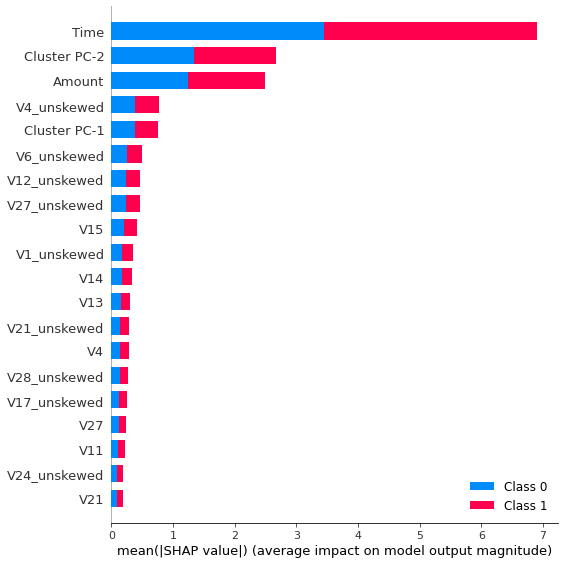

<Figure size 1152x864 with 0 Axes>

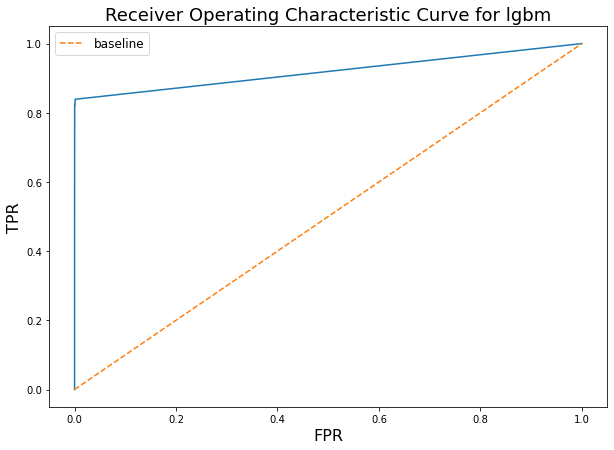

The ROC_AUC score is 0.9542735725735659


The Matthew correlation is 0.8605065546367461
-------------------
The accuracy is 0.9995
The recall is 0.9995
The macro F1 score is 0.9297813187411632
The micro F1 score is 0.9995
The weighted F1 score is 0.9994883386275618
              precision    recall  f1-score   support

         0.0       1.00      1.00      1.00     29944
         1.0       0.90      0.82      0.86        56

    accuracy                           1.00     30000
   macro avg       0.95      0.91      0.93     30000
weighted avg       1.00      1.00      1.00     30000



Started Execute test train split at 17:25:23.
Started Started column type detection and casting at 17:25:23.
Started Checking for duplicate columns at 17:25:23.
Started Reset dataframe index. at 17:25:23.
Started Select best features at 17:25:23.
Started Delete columns with high share of NULLs at 17:25:23.
Started Apply datetime transformation at 17:25:23.
Started Start TFIDF to PCA loop at 17:25:23.
Started Handle rare features at 17:25:23.
Started Remove cardinality at 17:25:23.
Started Holistic NULL filling at 17:25:23.
Started Binarize numeric columns + PCA binarized features at 17:25:23.
Started Onehot + PCA categorical features at 17:25:23.
Started Execute categorical encoding at 17:25:23.
Started Fill nulls at 17:25:24.
Started Handle outliers at 17:25:24.
Started Remove collinearity at 17:25:25.
Started Remove skewness at 17:25:25.
Started Execute clustering as a feature at 17:25:25.
Started Execute clustering as a feature at 17:25:38.
Started Execute clustering as a feature at

[I 2022-01-17 17:26:53,827] A new study created in memory with name: lgbm_focal


              precision    recall  f1-score   support

           0       1.00      1.00      1.00     49935
           1       0.94      0.69      0.80        65

    accuracy                           1.00     50000
   macro avg       0.97      0.85      0.90     50000
weighted avg       1.00      1.00      1.00     50000

Score achieved on holdout dataset is: 0.8054222328655161.
End iteration for algorithm lgbm at 1642436813.6269107.
+++++++++++++++++++++++++++++++++++++++++++++++++++++++++++
Start iteration for algorithm lgbm_focal at 1642436813.790913.
Successfully loaded checkpoint last checkpoint.
Started Train LGBM with focal loss model at 17:26:53.


  0%|          | 0/50 [00:00<?, ?it/s]

[LightGBM] [Warning] Unknown parameter: gamma
[I 2022-01-17 17:26:58,362] Trial 0 finished with value: 8.669236809509677e-07 and parameters: {'learning_rate': 0.023688639503640783, 'num_leaves': 244, 'num_boost_round': 36627, 'alpha': 0.24810409748678125, 'gamma': 16}. Best is trial 0 with value: 8.669236809509677e-07.
[I 2022-01-17 17:26:58,641] Trial 1 finished with value: 1.274960351698559e-22 and parameters: {'learning_rate': 0.01432169828911152, 'num_leaves': 16, 'num_boost_round': 43323, 'alpha': 0.2537815508265665, 'gamma': 71}. Best is trial 0 with value: 8.669236809509677e-07.
[I 2022-01-17 17:27:04,722] Trial 2 finished with value: 1.7073577030141858e-08 and parameters: {'learning_rate': 0.010485387725194618, 'num_leaves': 249, 'num_boost_round': 41639, 'alpha': 0.0070689749506246055, 'gamma': 19}. Best is trial 0 with value: 8.669236809509677e-07.
[I 2022-01-17 17:27:05,009] Trial 3 finished with value: 1.4050025060099736e-10 and parameters: {'learning_rate': 0.0152547294580

[I 2022-01-17 17:27:52,695] Trial 29 finished with value: -59.735796421294836 and parameters: {'learning_rate': 0.06856031665656741, 'num_leaves': 250, 'num_boost_round': 1671, 'alpha': 4.482658903801731, 'gamma': 22}. Best is trial 19 with value: 0.05884144391364562.
[I 2022-01-17 17:27:53,006] Trial 30 finished with value: -106.4843874276 and parameters: {'learning_rate': 0.09209860780398567, 'num_leaves': 150, 'num_boost_round': 17615, 'alpha': 7.208150258433598, 'gamma': 6}. Best is trial 19 with value: 0.05884144391364562.
[I 2022-01-17 17:27:58,264] Trial 31 finished with value: 5.418932613085258e-06 and parameters: {'learning_rate': 0.027843455975155147, 'num_leaves': 100, 'num_boost_round': 8102, 'alpha': 0.0017916310215592996, 'gamma': 9}. Best is trial 19 with value: 0.05884144391364562.
[I 2022-01-17 17:27:59,178] Trial 32 finished with value: 0.0007116614385446353 and parameters: {'learning_rate': 0.052454889151195366, 'num_leaves': 5, 'num_boost_round': 23853, 'alpha': 0.0

[15]	train's focal_loss: 0.0862432	valid's focal_loss: 0.171986
[16]	train's focal_loss: 0.0825436	valid's focal_loss: 0.164615
[17]	train's focal_loss: 0.0790223	valid's focal_loss: 0.157599
[18]	train's focal_loss: 0.075669	valid's focal_loss: 0.150918
[19]	train's focal_loss: 0.0724744	valid's focal_loss: 0.144554
[20]	train's focal_loss: 0.0694298	valid's focal_loss: 0.138488
[21]	train's focal_loss: 0.0665268	valid's focal_loss: 0.132704
[22]	train's focal_loss: 0.0637579	valid's focal_loss: 0.127189
[23]	train's focal_loss: 0.061116	valid's focal_loss: 0.121926
[24]	train's focal_loss: 0.0585942	valid's focal_loss: 0.116902
[25]	train's focal_loss: 0.0561865	valid's focal_loss: 0.112107
[26]	train's focal_loss: 0.0538869	valid's focal_loss: 0.107527
[27]	train's focal_loss: 0.0516898	valid's focal_loss: 0.103151
[28]	train's focal_loss: 0.0495901	valid's focal_loss: 0.0989656
[29]	train's focal_loss: 0.047583	valid's focal_loss: 0.0949659
[30]	train's focal_loss: 0.0456638	valid'

[143]	train's focal_loss: 0.000648391	valid's focal_loss: 0.00135877
[144]	train's focal_loss: 0.000625363	valid's focal_loss: 0.00131283
[145]	train's focal_loss: 0.00060316	valid's focal_loss: 0.00126853
[146]	train's focal_loss: 0.000581762	valid's focal_loss: 0.0012257
[147]	train's focal_loss: 0.000561117	valid's focal_loss: 0.00118536
[148]	train's focal_loss: 0.000541212	valid's focal_loss: 0.0011465
[149]	train's focal_loss: 0.00052202	valid's focal_loss: 0.00110907
[150]	train's focal_loss: 0.000503515	valid's focal_loss: 0.001073
[151]	train's focal_loss: 0.000485672	valid's focal_loss: 0.00103825
[152]	train's focal_loss: 0.000468472	valid's focal_loss: 0.001004
[153]	train's focal_loss: 0.000451891	valid's focal_loss: 0.000970801
[154]	train's focal_loss: 0.000435898	valid's focal_loss: 0.000938023
[155]	train's focal_loss: 0.00042048	valid's focal_loss: 0.000907155
[156]	train's focal_loss: 0.00040561	valid's focal_loss: 0.000876654
[157]	train's focal_loss: 0.000391262	va

[271]	train's focal_loss: 7.55561e-06	valid's focal_loss: 7.08314e-05
[272]	train's focal_loss: 7.3169e-06	valid's focal_loss: 6.97118e-05
[273]	train's focal_loss: 7.08348e-06	valid's focal_loss: 7.02025e-05
[274]	train's focal_loss: 6.85969e-06	valid's focal_loss: 7.07684e-05
[275]	train's focal_loss: 6.64514e-06	valid's focal_loss: 7.09311e-05
[276]	train's focal_loss: 6.43666e-06	valid's focal_loss: 6.99755e-05
[277]	train's focal_loss: 6.23276e-06	valid's focal_loss: 7.05828e-05
[278]	train's focal_loss: 6.03645e-06	valid's focal_loss: 6.97503e-05
[279]	train's focal_loss: 5.84506e-06	valid's focal_loss: 7.01417e-05
[280]	train's focal_loss: 5.65978e-06	valid's focal_loss: 7.05424e-05
[281]	train's focal_loss: 5.48238e-06	valid's focal_loss: 6.98395e-05
[282]	train's focal_loss: 5.31088e-06	valid's focal_loss: 6.94433e-05
[283]	train's focal_loss: 5.14476e-06	valid's focal_loss: 6.85464e-05
[284]	train's focal_loss: 4.9823e-06	valid's focal_loss: 6.78972e-05
[285]	train's focal_lo

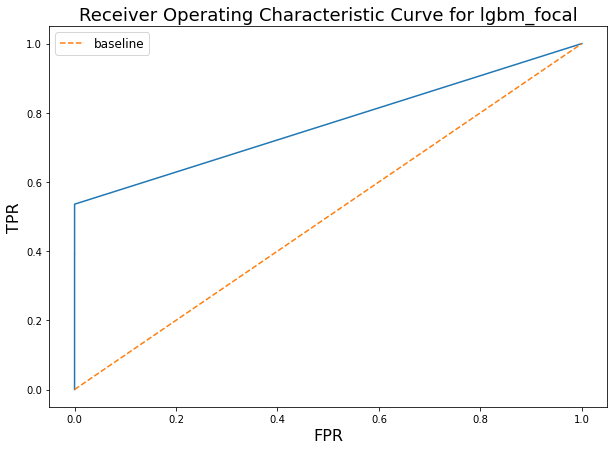

The ROC_AUC score is 0.9230647208121827


The Matthew correlation is 0.7196777920234289
-------------------
The accuracy is 0.9991
The recall is 0.9991
The macro F1 score is 0.844602259483147
The micro F1 score is 0.9991
The weighted F1 score is 0.9989708774274422
              precision    recall  f1-score   support

         0.0       1.00      1.00      1.00     29944
         1.0       0.97      0.54      0.69        56

    accuracy                           1.00     30000
   macro avg       0.98      0.77      0.84     30000
weighted avg       1.00      1.00      1.00     30000

Started Execute test train split at 17:29:42.
Started Started column type detection and casting at 17:29:42.
Started Checking for duplicate columns at 17:29:42.
Started Reset dataframe index. at 17:29:42.
Started Select best features at 17:29:42.
Started Delete columns with high share of NULLs at 17:29:42.
Started Apply datetime transformation at 17:29:42.
Started Start TFIDF to PCA loop at 17:29:42.
Started Handle rare features at 17:29:42.
Star

[I 2022-01-17 17:31:10,240] A new study created in memory with name: tabnet tuning


              precision    recall  f1-score   support

           0       1.00      1.00      1.00     49935
           1       0.96      0.66      0.78        65

    accuracy                           1.00     50000
   macro avg       0.98      0.83      0.89     50000
weighted avg       1.00      1.00      1.00     50000

Score achieved on holdout dataset is: 0.7948629810674627.
End iteration for algorithm lgbm_focal at 1642437070.041517.
+++++++++++++++++++++++++++++++++++++++++++++++++++++++++++
Start iteration for algorithm tabnet at 1642437070.1800296.
Successfully loaded checkpoint last checkpoint.
Started Train Tabnet classification model at 17:31:10.


  0%|          | 0/10 [00:00<?, ?it/s]


Early stopping occurred at epoch 166 with best_epoch = 136 and best_val_0_unsup_loss = 0.35458
Best weights from best epoch are automatically used!
Loading weights from unsupervised pretraining

Early stopping occurred at epoch 31 with best_epoch = 1 and best_val_0_matthews = 1.0
Best weights from best epoch are automatically used!
17:34:44
[0.417359254985643]

Early stopping occurred at epoch 103 with best_epoch = 73 and best_val_0_unsup_loss = 0.35968
Best weights from best epoch are automatically used!
Loading weights from unsupervised pretraining

Early stopping occurred at epoch 32 with best_epoch = 2 and best_val_0_matthews = 1.0
Best weights from best epoch are automatically used!
17:37:14
[0.417359254985643, 0.7251746195887994]

Early stopping occurred at epoch 108 with best_epoch = 78 and best_val_0_unsup_loss = 0.38129
Best weights from best epoch are automatically used!
Loading weights from unsupervised pretraining

Early stopping occurred at epoch 32 with best_epoch = 2 an

18:16:19
[0.7536114740913512, 0.41861417418999053, 0.7563367668648093, 0.7889070342176024, 0.6789264783692929, 0.45947396537554436, 0.7364550841507466, 0.7855247179105871]

Early stopping occurred at epoch 32 with best_epoch = 2 and best_val_0_unsup_loss = 0.76873
Best weights from best epoch are automatically used!
Loading weights from unsupervised pretraining

Early stopping occurred at epoch 30 with best_epoch = 0 and best_val_0_matthews = 1.0
Best weights from best epoch are automatically used!
18:17:13
[0.7536114740913512, 0.41861417418999053, 0.7563367668648093, 0.7889070342176024, 0.6789264783692929, 0.45947396537554436, 0.7364550841507466, 0.7855247179105871, 0.2877428366956581]

Early stopping occurred at epoch 40 with best_epoch = 10 and best_val_0_unsup_loss = 0.64959
Best weights from best epoch are automatically used!
Loading weights from unsupervised pretraining

Early stopping occurred at epoch 30 with best_epoch = 0 and best_val_0_matthews = 1.0
Best weights from best e


Early stopping occurred at epoch 30 with best_epoch = 0 and best_val_0_matthews = 1.0
Best weights from best epoch are automatically used!
18:39:15
[0.5550410848868845, 0.56057920773211, 0.7056944143103018, 0.38972023923546284]

Early stopping occurred at epoch 198 with best_epoch = 168 and best_val_0_unsup_loss = 0.31575
Best weights from best epoch are automatically used!
Loading weights from unsupervised pretraining

Early stopping occurred at epoch 32 with best_epoch = 2 and best_val_0_matthews = 1.0
Best weights from best epoch are automatically used!
18:41:57
[0.5550410848868845, 0.56057920773211, 0.7056944143103018, 0.38972023923546284, 0.7036546657845241]

Early stopping occurred at epoch 311 with best_epoch = 281 and best_val_0_unsup_loss = 0.26458
Best weights from best epoch are automatically used!
Loading weights from unsupervised pretraining

Early stopping occurred at epoch 31 with best_epoch = 1 and best_val_0_matthews = 1.0
Best weights from best epoch are automaticall


Early stopping occurred at epoch 144 with best_epoch = 114 and best_val_0_unsup_loss = 0.47957
Best weights from best epoch are automatically used!
Loading weights from unsupervised pretraining

Early stopping occurred at epoch 31 with best_epoch = 1 and best_val_0_matthews = 1.0
Best weights from best epoch are automatically used!
19:05:43
[0.6508715088917898]

Early stopping occurred at epoch 187 with best_epoch = 157 and best_val_0_unsup_loss = 0.43815
Best weights from best epoch are automatically used!
Loading weights from unsupervised pretraining

Early stopping occurred at epoch 33 with best_epoch = 3 and best_val_0_matthews = 1.0
Best weights from best epoch are automatically used!
19:06:38
[0.6508715088917898, 0.7495324605931072]

Early stopping occurred at epoch 159 with best_epoch = 129 and best_val_0_unsup_loss = 0.48425
Best weights from best epoch are automatically used!
Loading weights from unsupervised pretraining

Early stopping occurred at epoch 33 with best_epoch = 

19:21:37
[0.7633290225141174, 0.7855247179105871, 0.349232251782715, 0.7633290225141174, 0.7563367668648093, 0.4892324642178573, 0.5372081508213339, 0.272442971802649]

Early stopping occurred at epoch 38 with best_epoch = 8 and best_val_0_unsup_loss = 0.54769
Best weights from best epoch are automatically used!
Loading weights from unsupervised pretraining

Early stopping occurred at epoch 30 with best_epoch = 0 and best_val_0_matthews = 1.0
Best weights from best epoch are automatically used!
19:22:46
[0.7633290225141174, 0.7855247179105871, 0.349232251782715, 0.7633290225141174, 0.7563367668648093, 0.4892324642178573, 0.5372081508213339, 0.272442971802649, 0.5693731636943677]

Early stopping occurred at epoch 35 with best_epoch = 5 and best_val_0_unsup_loss = 0.49961
Best weights from best epoch are automatically used!
Loading weights from unsupervised pretraining

Early stopping occurred at epoch 30 with best_epoch = 0 and best_val_0_matthews = 1.0
Best weights from best epoch are 

Device used : cuda
epoch 0  | loss: 0.71363 | val_0_unsup_loss: 1.01014 |  0:00:02s
epoch 1  | loss: 0.58762 | val_0_unsup_loss: 0.99815 |  0:00:04s
epoch 2  | loss: 0.54651 | val_0_unsup_loss: 1.04112 |  0:00:07s
epoch 3  | loss: 0.51155 | val_0_unsup_loss: 0.84659 |  0:00:09s
epoch 4  | loss: 0.4859  | val_0_unsup_loss: 0.71187 |  0:00:11s
epoch 5  | loss: 0.46712 | val_0_unsup_loss: 0.63714 |  0:00:14s
epoch 6  | loss: 0.45559 | val_0_unsup_loss: 0.62927 |  0:00:16s
epoch 7  | loss: 0.44752 | val_0_unsup_loss: 0.61101 |  0:00:19s
epoch 8  | loss: 0.44834 | val_0_unsup_loss: 0.63506 |  0:00:21s
epoch 9  | loss: 0.43591 | val_0_unsup_loss: 0.57259 |  0:00:23s
epoch 10 | loss: 0.43439 | val_0_unsup_loss: 0.86319 |  0:00:26s
epoch 11 | loss: 0.43024 | val_0_unsup_loss: 0.5552  |  0:00:28s
epoch 12 | loss: 0.43018 | val_0_unsup_loss: 0.57371 |  0:00:31s
epoch 13 | loss: 0.42723 | val_0_unsup_loss: 0.54937 |  0:00:33s
epoch 14 | loss: 0.42632 | val_0_unsup_loss: 0.55023 |  0:00:35s
epoch 

epoch 76 | loss: 0.0015  | val_0_matthews: 0.80427 |  0:02:51s
epoch 77 | loss: 0.00158 | val_0_matthews: 0.82109 |  0:02:53s
epoch 78 | loss: 0.00158 | val_0_matthews: 0.81504 |  0:02:55s
epoch 79 | loss: 0.00148 | val_0_matthews: 0.81504 |  0:02:58s
epoch 80 | loss: 0.0015  | val_0_matthews: 0.82302 |  0:03:00s
epoch 81 | loss: 0.00144 | val_0_matthews: 0.8073  |  0:03:02s
epoch 82 | loss: 0.00141 | val_0_matthews: 0.83123 |  0:03:04s
epoch 83 | loss: 0.00139 | val_0_matthews: 0.82056 |  0:03:06s
epoch 84 | loss: 0.00136 | val_0_matthews: 0.82056 |  0:03:09s
epoch 85 | loss: 0.0014  | val_0_matthews: 0.82569 |  0:03:11s

Early stopping occurred at epoch 85 with best_epoch = 35 and best_val_0_matthews = 0.83899
Best weights from best epoch are automatically used!
Started Predict with Tabnet classification at 19:38:55.
19:38:55


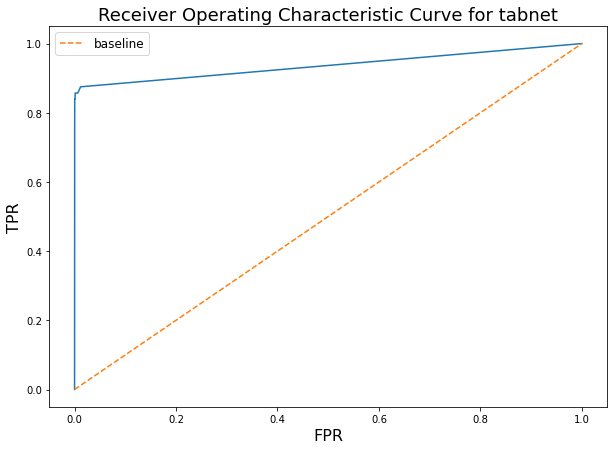

The ROC_AUC score is 0.9755430374794856


The Matthew correlation is 0.838985153238426
-------------------
The accuracy is 0.9994
The recall is 0.9994
The macro F1 score is 0.919492576619213
The micro F1 score is 0.9994
The weighted F1 score is 0.9994
              precision    recall  f1-score   support

         0.0       1.00      1.00      1.00     29944
         1.0       0.84      0.84      0.84        56

    accuracy                           1.00     30000
   macro avg       0.92      0.92      0.92     30000
weighted avg       1.00      1.00      1.00     30000



Started Execute test train split at 19:39:00.
Started Started column type detection and casting at 19:39:00.
Started Checking for duplicate columns at 19:39:00.
Started Reset dataframe index. at 19:39:00.
Started Select best features at 19:39:00.
Started Delete columns with high share of NULLs at 19:39:00.
Started Apply datetime transformation at 19:39:00.
Started Start TFIDF to PCA loop at 19:39:00.
Started Handle rare features at 19:39:00.
Started Remove cardinality at 19:39:00.
Started Holistic NULL filling at 19:39:00.
Started Binarize numeric columns + PCA binarized features at 19:39:00.
Started Onehot + PCA categorical features at 19:39:01.
Started Execute categorical encoding at 19:39:01.
Started Fill nulls at 19:39:01.
Started Handle outliers at 19:39:01.
Started Remove collinearity at 19:39:01.
Started Remove skewness at 19:39:01.
Started Execute clustering as a feature at 19:39:02.
Started Execute clustering as a feature at 19:39:15.
Started Execute clustering as a feature at

              precision    recall  f1-score   support

           0       1.00      1.00      1.00     49935
           1       0.77      0.74      0.76        65

    accuracy                           1.00     50000
   macro avg       0.89      0.87      0.88     50000
weighted avg       1.00      1.00      1.00     50000

Score achieved on holdout dataset is: 0.7558067274372335.
End iteration for algorithm tabnet at 1642444844.5980976.
+++++++++++++++++++++++++++++++++++++++++++++++++++++++++++
Start iteration for algorithm vowpal_wabbit at 1642444844.7392178.
Successfully loaded checkpoint last checkpoint.
Started Train Vowpal Wabbit model at 19:40:44.
Started Predict with Vowpal Wabbit at 19:41:00.
19:41:03


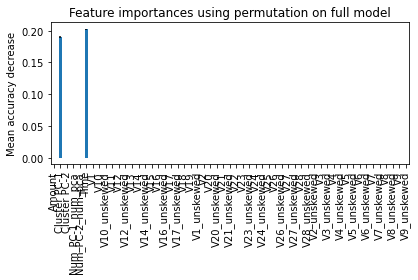

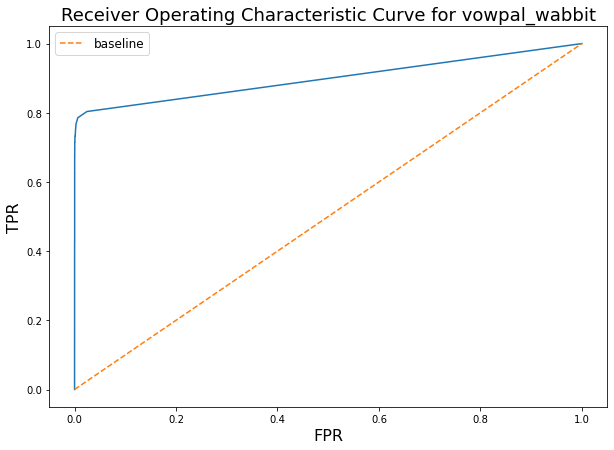

The ROC_AUC score is 0.9581844442960192


The Matthew correlation is 0.7651524621034153
-------------------
The accuracy is 0.9992
The recall is 0.9992
The macro F1 score is 0.8797996661101837
The micro F1 score is 0.9992
The weighted F1 score is 0.9991520801335558
              precision    recall  f1-score   support

         0.0       1.00      1.00      1.00     29944
         1.0       0.86      0.68      0.76        56

    accuracy                           1.00     30000
   macro avg       0.93      0.84      0.88     30000
weighted avg       1.00      1.00      1.00     30000



Started Execute test train split at 19:43:23.
Started Started column type detection and casting at 19:43:23.
Started Checking for duplicate columns at 19:43:23.
Started Reset dataframe index. at 19:43:23.
Started Select best features at 19:43:23.
Started Delete columns with high share of NULLs at 19:43:23.
Started Apply datetime transformation at 19:43:23.
Started Start TFIDF to PCA loop at 19:43:23.
Started Handle rare features at 19:43:23.
Started Remove cardinality at 19:43:23.
Started Holistic NULL filling at 19:43:23.
Started Binarize numeric columns + PCA binarized features at 19:43:23.
Started Onehot + PCA categorical features at 19:43:23.
Started Execute categorical encoding at 19:43:23.
Started Fill nulls at 19:43:23.
Started Handle outliers at 19:43:23.
Started Remove collinearity at 19:43:24.
Started Remove skewness at 19:43:24.
Started Execute clustering as a feature at 19:43:24.
Started Execute clustering as a feature at 19:43:38.
Started Execute clustering as a feature at

              precision    recall  f1-score   support

           0       1.00      1.00      1.00     49935
           1       1.00      0.37      0.54        65

    accuracy                           1.00     50000
   macro avg       1.00      0.68      0.77     50000
weighted avg       1.00      1.00      1.00     50000

Score achieved on holdout dataset is: 0.6073943155817131.
End iteration for algorithm vowpal_wabbit at 1642445106.1023777.
+++++++++++++++++++++++++++++++++++++++++++++++++++++++++++
Start iteration for algorithm logistic_regression at 1642445106.2417297.
Successfully loaded checkpoint last checkpoint.
Started Train logistic regression model at 19:45:06.
Started Predict with Logistic Regression at 19:45:08.
19:45:08


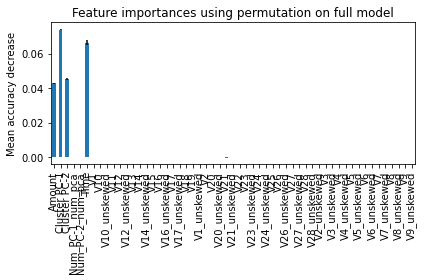

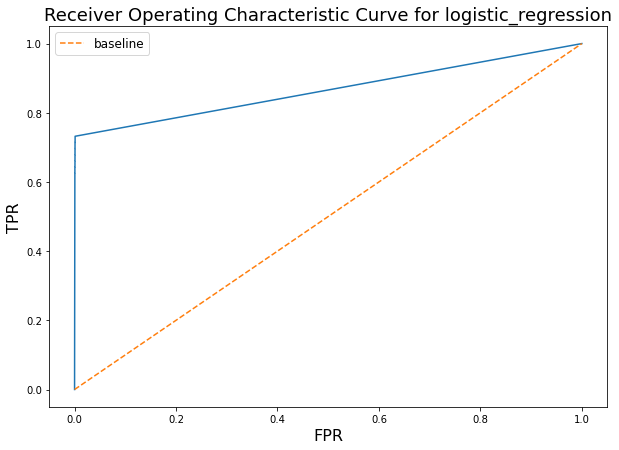

The ROC_AUC score is 0.9495540485095989


The Matthew correlation is 0.6523186269077815
-------------------
The accuracy is 0.9985666666666667
The recall is 0.9985666666666667
The macro F1 score is 0.8248441826068643
The micro F1 score is 0.9985666666666667
The weighted F1 score is 0.9986306271487987
              precision    recall  f1-score   support

         0.0       1.00      1.00      1.00     29944
         1.0       0.60      0.71      0.65        56

    accuracy                           1.00     30000
   macro avg       0.80      0.86      0.82     30000
weighted avg       1.00      1.00      1.00     30000



Started Execute test train split at 19:45:11.
Started Started column type detection and casting at 19:45:11.
Started Checking for duplicate columns at 19:45:11.
Started Reset dataframe index. at 19:45:11.
Started Select best features at 19:45:11.
Started Delete columns with high share of NULLs at 19:45:11.
Started Apply datetime transformation at 19:45:11.
Started Start TFIDF to PCA loop at 19:45:11.
Started Handle rare features at 19:45:11.
Started Remove cardinality at 19:45:11.
Started Holistic NULL filling at 19:45:11.
Started Binarize numeric columns + PCA binarized features at 19:45:11.
Started Onehot + PCA categorical features at 19:45:11.
Started Execute categorical encoding at 19:45:11.
Started Fill nulls at 19:45:11.
Started Handle outliers at 19:45:11.
Started Remove collinearity at 19:45:12.
Started Remove skewness at 19:45:12.
Started Execute clustering as a feature at 19:45:12.
Started Execute clustering as a feature at 19:45:26.
Started Execute clustering as a feature at

              precision    recall  f1-score   support

           0       1.00      1.00      1.00     49935
           1       0.42      0.55      0.48        65

    accuracy                           1.00     50000
   macro avg       0.71      0.78      0.74     50000
weighted avg       1.00      1.00      1.00     50000

Score achieved on holdout dataset is: 0.48356315922724596.
End iteration for algorithm logistic_regression at 1642445220.4431994.
+++++++++++++++++++++++++++++++++++++++++++++++++++++++++++
Start iteration for algorithm sgd at 1642445220.5856884.


[I 2022-01-17 19:47:00,626] A new study created in memory with name: sgd


Successfully loaded checkpoint last checkpoint.
Started Train SGD classifier model at 19:47:00.


  0%|          | 0/100 [00:00<?, ?it/s]

[I 2022-01-17 19:47:00,790] Trial 0 finished with value: 0.9976037287703676 and parameters: {'loss': 'log', 'alpha': 24.658329458549105, 'l1_ratio': 0.06250999323228593, 'epsilon': 0.0024348773534554596, 'max_iter': 4688, 'tol': 1.7073967431528103e-05, 'normalize': True, 'power_t': 0.39663473785260006}. Best is trial 0 with value: 0.9976037287703676.
[I 2022-01-17 19:47:01,103] Trial 1 finished with value: 0.9974034180491215 and parameters: {'loss': 'log', 'alpha': 98.77700294007911, 'l1_ratio': 0.004335189736337855, 'epsilon': 0.002820996133514492, 'max_iter': 5510, 'tol': 0.00016480446427978953, 'normalize': True, 'power_t': 0.17624515035546043}. Best is trial 0 with value: 0.9976037287703676.
[I 2022-01-17 19:47:01,397] Trial 2 finished with value: 0.9100445000743728 and parameters: {'loss': 'modified_huber', 'alpha': 0.05660670699258887, 'l1_ratio': 0.012562313237138797, 'epsilon': 0.013481575603601416, 'max_iter': 23558, 'tol': 6.290644294586152e-05, 'normalize': False, 'power_t':

[I 2022-01-17 19:47:07,906] Trial 23 finished with value: 0.8385322237604169 and parameters: {'loss': 'log', 'alpha': 0.009216870163244795, 'l1_ratio': 0.05419710338778496, 'epsilon': 0.01870218685022104, 'max_iter': 8741, 'tol': 1.0600428338266263e-05, 'normalize': False, 'power_t': 0.23879791634070946}. Best is trial 0 with value: 0.9976037287703676.
[I 2022-01-17 19:47:08,217] Trial 24 finished with value: 0.9568058199480355 and parameters: {'loss': 'log', 'alpha': 0.04252176382430986, 'l1_ratio': 0.16682860544054923, 'epsilon': 0.0018587653185283077, 'max_iter': 811, 'tol': 0.00012456746447248978, 'normalize': False, 'power_t': 0.20954172615354297}. Best is trial 0 with value: 0.9976037287703676.
[I 2022-01-17 19:47:08,527] Trial 25 finished with value: 0.8589507145638817 and parameters: {'loss': 'log', 'alpha': 0.2226207575784022, 'l1_ratio': 0.11227129616820317, 'epsilon': 0.00883057063388442, 'max_iter': 18270, 'tol': 1.3267361854236589e-05, 'normalize': True, 'power_t': 0.50723

[I 2022-01-17 19:47:15,043] Trial 46 finished with value: 0.8877504697499365 and parameters: {'loss': 'modified_huber', 'alpha': 0.01927164031541856, 'l1_ratio': 0.017458632110905415, 'epsilon': 0.0013918695661846083, 'max_iter': 1433, 'tol': 0.011443281716440299, 'normalize': False, 'power_t': 0.5950582315065501}. Best is trial 0 with value: 0.9976037287703676.
[I 2022-01-17 19:47:15,360] Trial 47 finished with value: 0.9497238473766002 and parameters: {'loss': 'log', 'alpha': 0.023668496185328656, 'l1_ratio': 0.07050827673184361, 'epsilon': 0.016535582289773504, 'max_iter': 86, 'tol': 4.5785303197889426e-05, 'normalize': True, 'power_t': 0.3415603443075439}. Best is trial 0 with value: 0.9976037287703676.
[I 2022-01-17 19:47:15,685] Trial 48 finished with value: 0.9974034180491215 and parameters: {'loss': 'log', 'alpha': 155.3217053277969, 'l1_ratio': 0.042931472460619284, 'epsilon': 0.09060991619341036, 'max_iter': 21195, 'tol': 0.00024271582885818113, 'normalize': True, 'power_t': 

[I 2022-01-17 19:47:22,132] Trial 69 finished with value: 0.8338797442079912 and parameters: {'loss': 'modified_huber', 'alpha': 0.003473398397062126, 'l1_ratio': 0.029662164446248803, 'epsilon': 0.0021471044595217617, 'max_iter': 13991, 'tol': 0.00015526684082901984, 'normalize': True, 'power_t': 0.38513584144768925}. Best is trial 0 with value: 0.9976037287703676.
[I 2022-01-17 19:47:22,440] Trial 70 finished with value: 0.9464341904395253 and parameters: {'loss': 'log', 'alpha': 1.3647026849492003, 'l1_ratio': 0.001256467392242752, 'epsilon': 0.0383888148343962, 'max_iter': 9304, 'tol': 0.00478330419725498, 'normalize': True, 'power_t': 0.12963262675154982}. Best is trial 0 with value: 0.9976037287703676.
[I 2022-01-17 19:47:22,738] Trial 71 finished with value: 0.9972031073278753 and parameters: {'loss': 'modified_huber', 'alpha': 695.8391549608201, 'l1_ratio': 0.0337552372754344, 'epsilon': 0.10821882889799708, 'max_iter': 11125, 'tol': 0.0018105320402543577, 'normalize': True, 'p

[I 2022-01-17 19:47:28,852] Trial 91 finished with value: 0.9974034180491215 and parameters: {'loss': 'modified_huber', 'alpha': 26.37072424491736, 'l1_ratio': 0.004085202898577604, 'epsilon': 0.06010091971888526, 'max_iter': 3779, 'tol': 5.2239492573894026e-05, 'normalize': True, 'power_t': 0.16719233967965738}. Best is trial 0 with value: 0.9976037287703676.
[I 2022-01-17 19:47:29,155] Trial 92 finished with value: 0.9976037287703676 and parameters: {'loss': 'modified_huber', 'alpha': 0.050076308326866686, 'l1_ratio': 0.01762418836992673, 'epsilon': 0.002003837658148814, 'max_iter': 5296, 'tol': 1.8116335709195727e-05, 'normalize': True, 'power_t': 0.29138411316803925}. Best is trial 0 with value: 0.9976037287703676.
[I 2022-01-17 19:47:29,448] Trial 93 finished with value: 0.9976037287703676 and parameters: {'loss': 'modified_huber', 'alpha': 81.05390151694672, 'l1_ratio': 0.02094541195138461, 'epsilon': 0.0465510248498768, 'max_iter': 27855, 'tol': 2.3974199700153537e-05, 'normaliz

Started Predict with SGD classifier at 19:47:32.
19:47:33


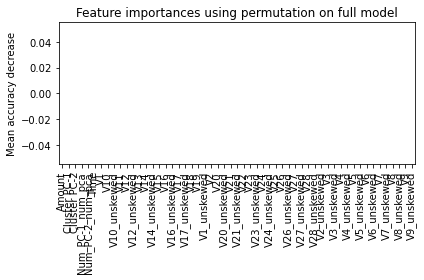

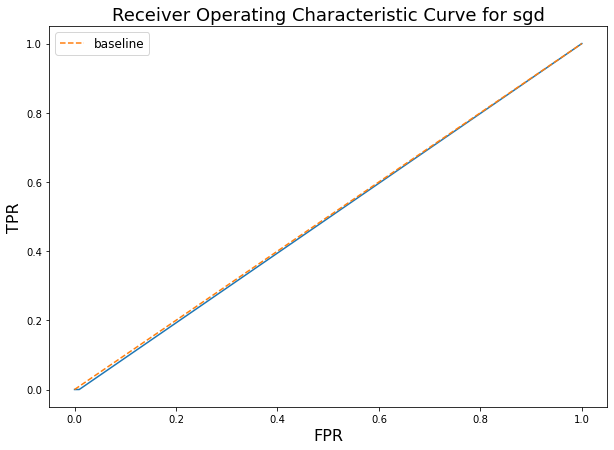

The ROC_AUC score is 0.5480838040532805


The Matthew correlation is 0.0
-------------------
The accuracy is 0.0018666666666666666
The recall is 0.0018666666666666666
The macro F1 score is 0.001863188714399787
The micro F1 score is 0.0018666666666666666
The weighted F1 score is 6.955904533759204e-06
              precision    recall  f1-score   support

         0.0       0.00      0.00      0.00     29944
         1.0       0.00      1.00      0.00        56

    accuracy                           0.00     30000
   macro avg       0.00      0.50      0.00     30000
weighted avg       0.00      0.00      0.00     30000



Started Execute test train split at 19:47:36.
Started Started column type detection and casting at 19:47:36.
Started Checking for duplicate columns at 19:47:36.
Started Reset dataframe index. at 19:47:36.
Started Select best features at 19:47:36.
Started Delete columns with high share of NULLs at 19:47:36.
Started Apply datetime transformation at 19:47:36.
Started Start TFIDF to PCA loop at 19:47:36.
Started Handle rare features at 19:47:36.
Started Remove cardinality at 19:47:36.
Started Holistic NULL filling at 19:47:36.
Started Binarize numeric columns + PCA binarized features at 19:47:36.
Started Onehot + PCA categorical features at 19:47:36.
Started Execute categorical encoding at 19:47:36.
Started Fill nulls at 19:47:36.
Started Handle outliers at 19:47:36.
Started Remove collinearity at 19:47:37.
Started Remove skewness at 19:47:37.
Started Execute clustering as a feature at 19:47:37.
Started Execute clustering as a feature at 19:47:50.
Started Execute clustering as a feature at

              precision    recall  f1-score   support

           0       0.00      0.00      0.00     49935
           1       0.00      1.00      0.00        65

    accuracy                           0.00     50000
   macro avg       0.00      0.50      0.00     50000
weighted avg       0.00      0.00      0.00     50000

Score achieved on holdout dataset is: 0.0.
End iteration for algorithm sgd at 1642445369.2832737.
+++++++++++++++++++++++++++++++++++++++++++++++++++++++++++
Start iteration for algorithm quadratic_discriminant_analysis at 1642445369.419277.
Successfully loaded checkpoint last checkpoint.
Started Train Quadratic Discriminant model at 19:49:29.
Started Predict with Quadratic Discriminant Analysis at 19:49:29.
19:49:29


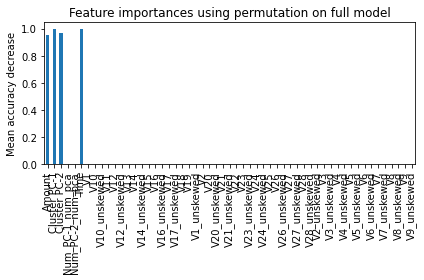

The Matthew correlation is 0.0
-------------------
The accuracy is 0.9981333333333333
The recall is 0.9981333333333333
The macro F1 score is 0.49953289737087947
The micro F1 score is 0.9981333333333333
The weighted F1 score is 0.9972008719249077
              precision    recall  f1-score   support

         0.0       1.00      1.00      1.00     29944
         1.0       0.00      0.00      0.00        56

    accuracy                           1.00     30000
   macro avg       0.50      0.50      0.50     30000
weighted avg       1.00      1.00      1.00     30000



Started Execute test train split at 19:49:36.
Started Started column type detection and casting at 19:49:36.
Started Checking for duplicate columns at 19:49:36.
Started Reset dataframe index. at 19:49:36.
Started Select best features at 19:49:36.
Started Delete columns with high share of NULLs at 19:49:36.
Started Apply datetime transformation at 19:49:36.
Started Start TFIDF to PCA loop at 19:49:36.
Started Handle rare features at 19:49:36.
Started Remove cardinality at 19:49:36.
Started Holistic NULL filling at 19:49:36.
Started Binarize numeric columns + PCA binarized features at 19:49:36.
Started Onehot + PCA categorical features at 19:49:37.
Started Execute categorical encoding at 19:49:37.
Started Fill nulls at 19:49:37.
Started Handle outliers at 19:49:37.
Started Remove collinearity at 19:49:38.
Started Remove skewness at 19:49:38.
Started Execute clustering as a feature at 19:49:38.
Started Execute clustering as a feature at 19:49:51.
Started Execute clustering as a feature at

[I 2022-01-17 19:50:57,954] A new study created in memory with name: svm


              precision    recall  f1-score   support

           0       1.00      1.00      1.00     49935
           1       0.00      0.00      0.00        65

    accuracy                           1.00     50000
   macro avg       0.50      0.50      0.50     50000
weighted avg       1.00      1.00      1.00     50000

Score achieved on holdout dataset is: 0.0.
End iteration for algorithm quadratic_discriminant_analysis at 1642445457.7847228.
+++++++++++++++++++++++++++++++++++++++++++++++++++++++++++
Start iteration for algorithm svm at 1642445457.9185672.
Successfully loaded checkpoint last checkpoint.
Started Train Support Vector Machine classifier model at 19:50:57.


  0%|          | 0/25 [00:00<?, ?it/s]

[I 2022-01-17 19:50:58,936] Trial 0 finished with value: 0.9976051362356417 and parameters: {'C': 8.616644415858344, 'max_iter': 9508, 'tol': 0.008471801418819975, 'gamma': 'scale', 'class_weight': 'balanced'}. Best is trial 0 with value: 0.9976051362356417.
[I 2022-01-17 19:52:46,997] Trial 1 finished with value: 0.9976051362356417 and parameters: {'C': 361.6125071428695, 'max_iter': 6012, 'tol': 0.006796578090758156, 'gamma': 'auto', 'class_weight': 'balanced'}. Best is trial 0 with value: 0.9976051362356417.
[I 2022-01-17 19:52:51,315] Trial 2 finished with value: 0.9976051362356417 and parameters: {'C': 1.991497084946204, 'max_iter': 1835, 'tol': 0.00016480446427978953, 'gamma': 'scale', 'class_weight': None}. Best is trial 0 with value: 0.9976051362356417.
[I 2022-01-17 19:53:57,135] Trial 3 finished with value: 0.9976051362356417 and parameters: {'C': 1.4435885294521449, 'max_iter': 2922, 'tol': 0.0002920433847181409, 'gamma': 'auto', 'class_weight': None}. Best is trial 0 with v

Started Predict with Support Vector Machine classifier at 20:09:24.
20:09:24


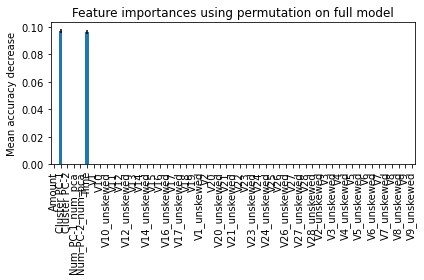

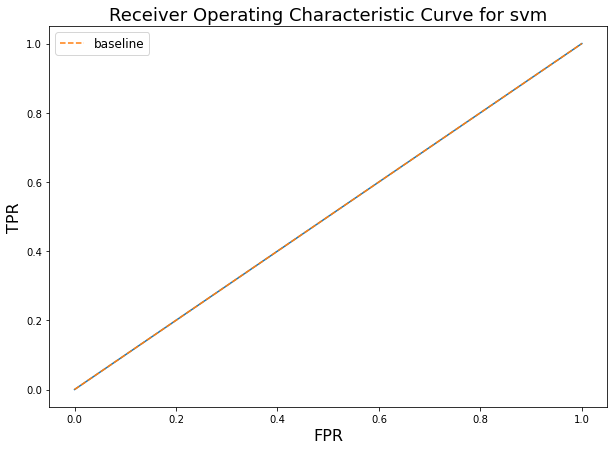

The ROC_AUC score is 0.46487729475974193


The Matthew correlation is 0.0
-------------------
The accuracy is 0.0018666666666666666
The recall is 0.0018666666666666666
The macro F1 score is 0.001863188714399787
The micro F1 score is 0.0018666666666666666
The weighted F1 score is 6.955904533759204e-06
              precision    recall  f1-score   support

         0.0       0.00      0.00      0.00     29944
         1.0       0.00      1.00      0.00        56

    accuracy                           0.00     30000
   macro avg       0.00      0.50      0.00     30000
weighted avg       0.00      0.00      0.00     30000



Started Execute test train split at 20:09:44.
Started Started column type detection and casting at 20:09:44.
Started Checking for duplicate columns at 20:09:44.
Started Reset dataframe index. at 20:09:44.
Started Select best features at 20:09:44.
Started Delete columns with high share of NULLs at 20:09:44.
Started Apply datetime transformation at 20:09:44.
Started Start TFIDF to PCA loop at 20:09:44.
Started Handle rare features at 20:09:44.
Started Remove cardinality at 20:09:44.
Started Holistic NULL filling at 20:09:44.
Started Binarize numeric columns + PCA binarized features at 20:09:44.
Started Onehot + PCA categorical features at 20:09:45.
Started Execute categorical encoding at 20:09:45.
Started Fill nulls at 20:09:45.
Started Handle outliers at 20:09:45.
Started Remove collinearity at 20:09:46.
Started Remove skewness at 20:09:46.
Started Execute clustering as a feature at 20:09:46.
Started Execute clustering as a feature at 20:09:59.
Started Execute clustering as a feature at

              precision    recall  f1-score   support

           0       0.00      0.00      0.00     49935
           1       0.00      1.00      0.00        65

    accuracy                           0.00     50000
   macro avg       0.00      0.50      0.00     50000
weighted avg       0.00      0.00      0.00     50000

Score achieved on holdout dataset is: 0.0.
End iteration for algorithm svm at 1642446674.2507715.
+++++++++++++++++++++++++++++++++++++++++++++++++++++++++++
+++++++++++++++++++++++++++++++++++++++++++++++++++++++++++
Start iteration for checkpoint automated_feature_selection at 1642446674.3916154.
Started Start deleting low variance features at 20:11:14.
Features before low variance deletion: 57
Features before low variance deletion: 55
The following features have been dropped....:
isolation_class
isolation_probs
Started Sort columns alphabetically at 20:11:14.


[I 2022-01-17 20:11:15,091] A new study created in memory with name: ridge


All algorithms to be tested are: ['ridge', 'lgbm', 'lgbm_focal', 'tabnet', 'vowpal_wabbit', 'logistic_regression', 'sgd', 'quadratic_discriminant_analysis', 'svm'].
Start iteration for algorithm ridge at 1642446675.065165.
Successfully loaded checkpoint last checkpoint.
Started Train Ridge classifier model at 20:11:15.


  0%|          | 0/10 [00:00<?, ?it/s]

[I 2022-01-17 20:11:15,457] Trial 0 finished with value: 0.43734383792273057 and parameters: {'solver': 'svd', 'alpha': 157.41890047456639, 'max_iter': 6015, 'tol': 0.006796578090758156, 'normalize': False}. Best is trial 0 with value: 0.43734383792273057.
[I 2022-01-17 20:11:15,743] Trial 1 finished with value: 0.43734383792273057 and parameters: {'solver': 'auto', 'alpha': 0.055895242052179224, 'max_iter': 6123, 'tol': 3.613894271216525e-05, 'normalize': False}. Best is trial 0 with value: 0.43734383792273057.
[I 2022-01-17 20:11:16,321] Trial 2 finished with value: 0.43734383792273057 and parameters: {'solver': 'svd', 'alpha': 0.010547383621352036, 'max_iter': 659, 'tol': 0.06245139574743072, 'normalize': True}. Best is trial 0 with value: 0.43734383792273057.
[I 2022-01-17 20:11:16,639] Trial 3 finished with value: 0.43734383792273057 and parameters: {'solver': 'cholesky', 'alpha': 285.7080075040722, 'max_iter': 2595, 'tol': 0.004467752817973905, 'normalize': False}. Best is trial 

Started Predict with Ridge classifier at 20:15:12.
20:15:12


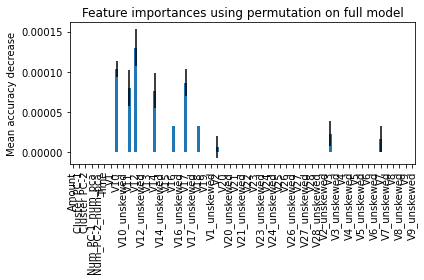

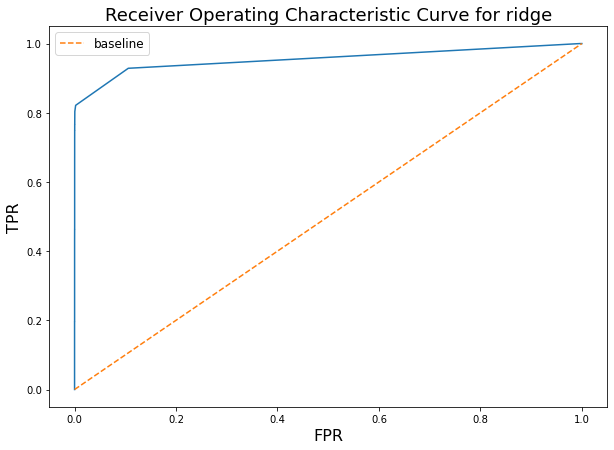

The ROC_AUC score is 0.9666884136101674


The Matthew correlation is 0.8042701770921268
-------------------
The accuracy is 0.9993
The recall is 0.9993
The macro F1 score is 0.9016938462376285
The micro F1 score is 0.9993
The weighted F1 score is 0.9992836740785866
              precision    recall  f1-score   support

         0.0       1.00      1.00      1.00     29944
         1.0       0.84      0.77      0.80        56

    accuracy                           1.00     30000
   macro avg       0.92      0.88      0.90     30000
weighted avg       1.00      1.00      1.00     30000



Started Execute test train split at 20:15:22.
Started Started column type detection and casting at 20:15:22.
Started Checking for duplicate columns at 20:15:22.
Started Reset dataframe index. at 20:15:22.
Started Select best features at 20:15:22.
Started Delete columns with high share of NULLs at 20:15:22.
Started Apply datetime transformation at 20:15:22.
Started Start TFIDF to PCA loop at 20:15:22.
Started Handle rare features at 20:15:22.
Started Remove cardinality at 20:15:22.
Started Holistic NULL filling at 20:15:22.
Started Binarize numeric columns + PCA binarized features at 20:15:22.
Started Onehot + PCA categorical features at 20:15:23.
Started Execute categorical encoding at 20:15:23.
Started Fill nulls at 20:15:23.
Started Handle outliers at 20:15:23.
Started Remove collinearity at 20:15:24.
Started Remove skewness at 20:15:24.
Started Execute clustering as a feature at 20:15:24.
Started Execute clustering as a feature at 20:15:37.
Started Execute clustering as a feature at

[I 2022-01-17 20:16:47,237] A new study created in memory with name: lgbm tuning


              precision    recall  f1-score   support

           0       1.00      1.00      1.00     49935
           1       0.91      0.74      0.81        65

    accuracy                           1.00     50000
   macro avg       0.95      0.87      0.91     50000
weighted avg       1.00      1.00      1.00     50000

Score achieved on holdout dataset is: 0.8175899720485358.
End iteration for algorithm ridge at 1642447007.076844.
+++++++++++++++++++++++++++++++++++++++++++++++++++++++++++
Start iteration for algorithm lgbm at 1642447007.2133324.
Successfully loaded checkpoint last checkpoint.
Started Train LGBM at 20:16:47.
Started Check LGBM for GPU acceleration. at 20:16:47.
LGBM uses GPU.


  0%|          | 0/10 [00:00<?, ?it/s]

[I 2022-01-17 20:16:47,344] Trial 0 finished with value: 0.03388846282051174 and parameters: {'num_boost_round': 18789, 'lambda_l1': 506157.68887523044, 'lambda_l2': 24658.3294585491, 'num_leaves': 154, 'feature_fraction': 0.4936111842654619, 'feature_fraction_bynode': 0.49359671220172163, 'learning_rate': 1.7073967431528103e-05}. Best is trial 0 with value: 0.03388846282051174.
[I 2022-01-17 20:16:47,532] Trial 1 finished with value: 0.03388846282051174 and parameters: {'num_boost_round': 43323, 'lambda_l1': 4042.8727350273302, 'lambda_l2': 17718.847354806814, 'num_leaves': 7, 'feature_fraction': 0.9819459112971965, 'feature_fraction_bynode': 0.899465584480253, 'learning_rate': 7.068974950624602e-05}. Best is trial 0 with value: 0.03388846282051174.
[I 2022-01-17 20:17:08,423] Trial 2 finished with value: 0.015731815994223172 and parameters: {'num_boost_round': 9173, 'lambda_l1': 12.601639723276797, 'lambda_l2': 66.904211664988, 'num_leaves': 135, 'feature_fraction': 0.659167011185269

[1]	train's binary_logloss: 0.0128173	valid's binary_logloss: 0.0127204
Training until validation scores don't improve for 10 rounds
[2]	train's binary_logloss: 0.0117216	valid's binary_logloss: 0.0117252
[3]	train's binary_logloss: 0.0111861	valid's binary_logloss: 0.0111248
[4]	train's binary_logloss: 0.0103687	valid's binary_logloss: 0.0103451
[5]	train's binary_logloss: 0.00970294	valid's binary_logloss: 0.00967818
[6]	train's binary_logloss: 0.00928963	valid's binary_logloss: 0.00929864
[7]	train's binary_logloss: 0.00886242	valid's binary_logloss: 0.00888911
[8]	train's binary_logloss: 0.00847099	valid's binary_logloss: 0.00852914
[9]	train's binary_logloss: 0.00812959	valid's binary_logloss: 0.00821643
[10]	train's binary_logloss: 0.00785621	valid's binary_logloss: 0.00796614
[11]	train's binary_logloss: 0.007643	valid's binary_logloss: 0.00775741
[12]	train's binary_logloss: 0.00746198	valid's binary_logloss: 0.00759657
[13]	train's binary_logloss: 0.00730223	valid's binary_log

[228]	train's binary_logloss: 0.00302873	valid's binary_logloss: 0.00384429
[229]	train's binary_logloss: 0.00302861	valid's binary_logloss: 0.00384413
[230]	train's binary_logloss: 0.00302736	valid's binary_logloss: 0.00384304
[231]	train's binary_logloss: 0.00302736	valid's binary_logloss: 0.00384304
[232]	train's binary_logloss: 0.00302671	valid's binary_logloss: 0.00384217
[233]	train's binary_logloss: 0.0030266	valid's binary_logloss: 0.00384203
[234]	train's binary_logloss: 0.00302588	valid's binary_logloss: 0.00384166
[235]	train's binary_logloss: 0.00302578	valid's binary_logloss: 0.00384153
[236]	train's binary_logloss: 0.00302486	valid's binary_logloss: 0.0038404
[237]	train's binary_logloss: 0.00302411	valid's binary_logloss: 0.00383941
[238]	train's binary_logloss: 0.00302311	valid's binary_logloss: 0.00383818
[239]	train's binary_logloss: 0.00302311	valid's binary_logloss: 0.00383818
[240]	train's binary_logloss: 0.00302261	valid's binary_logloss: 0.00383742
[241]	train's 

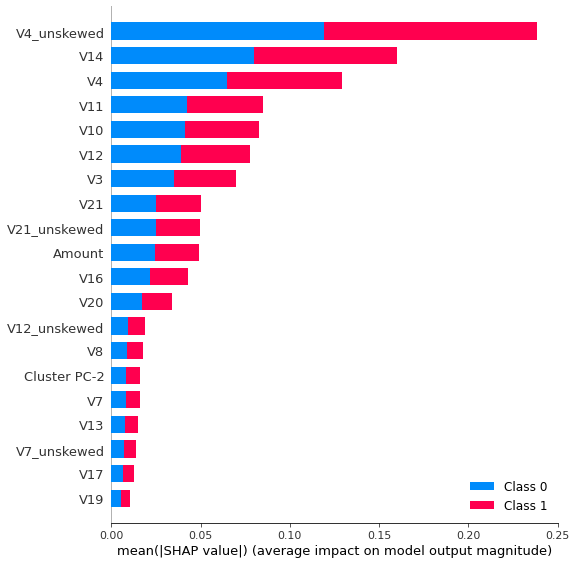

<Figure size 1152x864 with 0 Axes>

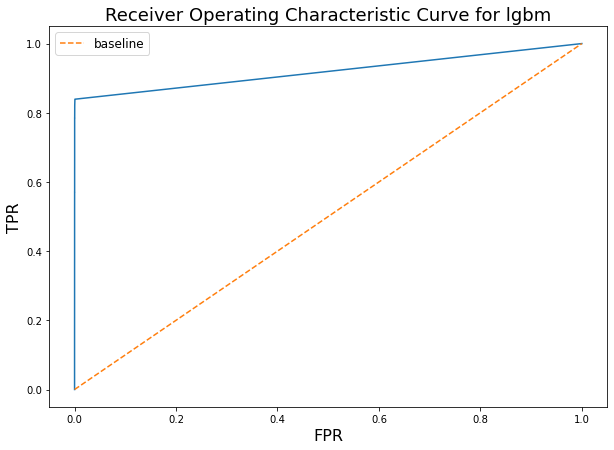

The ROC_AUC score is 0.9479480745009732


The Matthew correlation is 0.8396872547932838
-------------------
The accuracy is 0.9994333333333333
The recall is 0.9994333333333333
The macro F1 score is 0.9189057040296709
The micro F1 score is 0.9994333333333333
The weighted F1 score is 0.9994144775579485
              precision    recall  f1-score   support

         0.0       1.00      1.00      1.00     29944
         1.0       0.90      0.79      0.84        56

    accuracy                           1.00     30000
   macro avg       0.95      0.89      0.92     30000
weighted avg       1.00      1.00      1.00     30000



Started Execute test train split at 20:18:40.
Started Started column type detection and casting at 20:18:40.
Started Checking for duplicate columns at 20:18:40.
Started Reset dataframe index. at 20:18:40.
Started Select best features at 20:18:40.
Started Delete columns with high share of NULLs at 20:18:40.
Started Apply datetime transformation at 20:18:40.
Started Start TFIDF to PCA loop at 20:18:40.
Started Handle rare features at 20:18:40.
Started Remove cardinality at 20:18:40.
Started Holistic NULL filling at 20:18:40.
Started Binarize numeric columns + PCA binarized features at 20:18:40.
Started Onehot + PCA categorical features at 20:18:41.
Started Execute categorical encoding at 20:18:41.
Started Fill nulls at 20:18:41.
Started Handle outliers at 20:18:41.
Started Remove collinearity at 20:18:42.
Started Remove skewness at 20:18:42.
Started Execute clustering as a feature at 20:18:42.
Started Execute clustering as a feature at 20:18:55.
Started Execute clustering as a feature at

[I 2022-01-17 20:20:37,959] A new study created in memory with name: lgbm_focal


              precision    recall  f1-score   support

           0       1.00      1.00      1.00     49935
           1       0.88      0.69      0.78        65

    accuracy                           1.00     50000
   macro avg       0.94      0.85      0.89     50000
weighted avg       1.00      1.00      1.00     50000

Score achieved on holdout dataset is: 0.7813299882970713.
End iteration for algorithm lgbm at 1642447237.7759795.
+++++++++++++++++++++++++++++++++++++++++++++++++++++++++++
Start iteration for algorithm lgbm_focal at 1642447237.936028.
Successfully loaded checkpoint last checkpoint.
Started Train LGBM with focal loss model at 20:20:37.


  0%|          | 0/50 [00:00<?, ?it/s]

[LightGBM] [Warning] Unknown parameter: gamma
[I 2022-01-17 20:20:38,977] Trial 0 finished with value: 2.5855887364208845e-07 and parameters: {'learning_rate': 0.023688639503640783, 'num_leaves': 244, 'num_boost_round': 36627, 'alpha': 0.24810409748678125, 'gamma': 16}. Best is trial 0 with value: 2.5855887364208845e-07.
[I 2022-01-17 20:20:39,307] Trial 1 finished with value: 1.2647566205952983e-23 and parameters: {'learning_rate': 0.01432169828911152, 'num_leaves': 16, 'num_boost_round': 43323, 'alpha': 0.2537815508265665, 'gamma': 71}. Best is trial 0 with value: 2.5855887364208845e-07.
[I 2022-01-17 20:20:41,443] Trial 2 finished with value: 3.721017796970999e-09 and parameters: {'learning_rate': 0.010485387725194618, 'num_leaves': 249, 'num_boost_round': 41639, 'alpha': 0.0070689749506246055, 'gamma': 19}. Best is trial 0 with value: 2.5855887364208845e-07.
[I 2022-01-17 20:20:41,735] Trial 3 finished with value: 1.1536504478320467e-11 and parameters: {'learning_rate': 0.015254729

[I 2022-01-17 20:20:59,116] Trial 29 finished with value: -119.94072213385641 and parameters: {'learning_rate': 0.06856031665656741, 'num_leaves': 250, 'num_boost_round': 1671, 'alpha': 4.482658903801731, 'gamma': 22}. Best is trial 25 with value: 0.02117595655485851.
[I 2022-01-17 20:20:59,405] Trial 30 finished with value: -74.46663047521017 and parameters: {'learning_rate': 0.09209860780398567, 'num_leaves': 150, 'num_boost_round': 17615, 'alpha': 7.208150258433598, 'gamma': 6}. Best is trial 25 with value: 0.02117595655485851.
[I 2022-01-17 20:21:00,946] Trial 31 finished with value: 6.738245156893606e-07 and parameters: {'learning_rate': 0.027843455975155147, 'num_leaves': 100, 'num_boost_round': 8102, 'alpha': 0.0017916310215592996, 'gamma': 9}. Best is trial 25 with value: 0.02117595655485851.
[I 2022-01-17 20:21:01,755] Trial 32 finished with value: 0.001018577850500243 and parameters: {'learning_rate': 0.052454889151195366, 'num_leaves': 5, 'num_boost_round': 23853, 'alpha': 0

[29]	train's focal_loss: 0.0312566	valid's focal_loss: 0.0313151
[30]	train's focal_loss: 0.0291133	valid's focal_loss: 0.0291759
[31]	train's focal_loss: 0.0271232	valid's focal_loss: 0.0271886
[32]	train's focal_loss: 0.0252757	valid's focal_loss: 0.0253446
[33]	train's focal_loss: 0.0235591	valid's focal_loss: 0.0236303
[34]	train's focal_loss: 0.0219642	valid's focal_loss: 0.0220381
[35]	train's focal_loss: 0.0204814	valid's focal_loss: 0.0205559
[36]	train's focal_loss: 0.0191029	valid's focal_loss: 0.0191806
[37]	train's focal_loss: 0.017821	valid's focal_loss: 0.017901
[38]	train's focal_loss: 0.0166278	valid's focal_loss: 0.0167096
[39]	train's focal_loss: 0.0155183	valid's focal_loss: 0.0156016
[40]	train's focal_loss: 0.0144846	valid's focal_loss: 0.0145705
[41]	train's focal_loss: 0.0135228	valid's focal_loss: 0.0136117
[42]	train's focal_loss: 0.0126266	valid's focal_loss: 0.0127182
[43]	train's focal_loss: 0.0117919	valid's focal_loss: 0.0118855
[44]	train's focal_loss: 0.

Started Predict with LGBM with focal loss at 20:21:14.
20:21:14


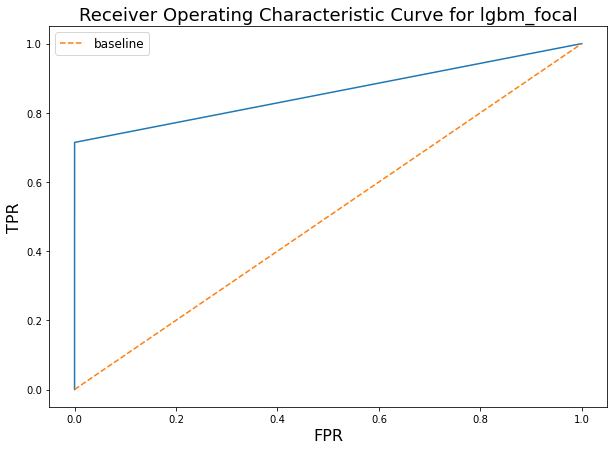

The ROC_AUC score is 0.9215696681424373


The Matthew correlation is 0.8245162504462057
-------------------
The accuracy is 0.9994
The recall is 0.9994
The macro F1 score is 0.9080130199053011
The micro F1 score is 0.9994
The weighted F1 score is 0.9993572129716632
              precision    recall  f1-score   support

         0.0       1.00      1.00      1.00     29944
         1.0       0.95      0.71      0.82        56

    accuracy                           1.00     30000
   macro avg       0.98      0.86      0.91     30000
weighted avg       1.00      1.00      1.00     30000

Started Execute test train split at 20:21:16.
Started Started column type detection and casting at 20:21:16.
Started Checking for duplicate columns at 20:21:16.
Started Reset dataframe index. at 20:21:16.
Started Select best features at 20:21:16.
Started Delete columns with high share of NULLs at 20:21:16.
Started Apply datetime transformation at 20:21:16.
Started Start TFIDF to PCA loop at 20:21:16.
Started Handle rare features at 20:21:16.
Sta

[I 2022-01-17 20:23:11,204] A new study created in memory with name: tabnet tuning


Start iteration for algorithm tabnet at 1642447391.1634161.
Successfully loaded checkpoint last checkpoint.
Started Train Tabnet classification model at 20:23:11.


  0%|          | 0/10 [00:00<?, ?it/s]


Early stopping occurred at epoch 44 with best_epoch = 14 and best_val_0_unsup_loss = 0.91214
Best weights from best epoch are automatically used!
Loading weights from unsupervised pretraining

Early stopping occurred at epoch 41 with best_epoch = 11 and best_val_0_matthews = 1.0
Best weights from best epoch are automatically used!
20:24:14
[0.6917974220028883]

Early stopping occurred at epoch 45 with best_epoch = 15 and best_val_0_unsup_loss = 0.88647
Best weights from best epoch are automatically used!
Loading weights from unsupervised pretraining

Early stopping occurred at epoch 48 with best_epoch = 18 and best_val_0_matthews = -0.001
Best weights from best epoch are automatically used!
20:25:24
[0.6917974220028883, 0.7699902925790555]

Early stopping occurred at epoch 43 with best_epoch = 13 and best_val_0_unsup_loss = 0.92763
Best weights from best epoch are automatically used!
Loading weights from unsupervised pretraining

Early stopping occurred at epoch 61 with best_epoch = 3

20:43:57
[0.7711251761291891, 0.4404435534781184, 0.7705180500847074, 0.6411962905743834, 0.7744315016601495, 0.636853986523321, 0.6805685093122652, 0.7793088972629358]

Early stopping occurred at epoch 75 with best_epoch = 45 and best_val_0_unsup_loss = 0.84169
Best weights from best epoch are automatically used!
Loading weights from unsupervised pretraining

Early stopping occurred at epoch 33 with best_epoch = 3 and best_val_0_matthews = 1.0
Best weights from best epoch are automatically used!
20:45:07
[0.7711251761291891, 0.4404435534781184, 0.7705180500847074, 0.6411962905743834, 0.7744315016601495, 0.636853986523321, 0.6805685093122652, 0.7793088972629358, 0.8042701770921268]

Early stopping occurred at epoch 67 with best_epoch = 37 and best_val_0_unsup_loss = 0.88698
Best weights from best epoch are automatically used!
Loading weights from unsupervised pretraining

Early stopping occurred at epoch 33 with best_epoch = 3 and best_val_0_matthews = 1.0
Best weights from best epoch 

20:58:38
[0.6799425421498588, 0.6816811549235379, 0.7402578003271767, 0.22532032495482338]

Early stopping occurred at epoch 37 with best_epoch = 7 and best_val_0_unsup_loss = 0.89845
Best weights from best epoch are automatically used!
Loading weights from unsupervised pretraining

Early stopping occurred at epoch 35 with best_epoch = 5 and best_val_0_matthews = 1.0
Best weights from best epoch are automatically used!
20:59:56
[0.6799425421498588, 0.6816811549235379, 0.7402578003271767, 0.22532032495482338, 0.7440694794944864]

Early stopping occurred at epoch 35 with best_epoch = 5 and best_val_0_unsup_loss = 0.89153
Best weights from best epoch are automatically used!
Loading weights from unsupervised pretraining

Early stopping occurred at epoch 30 with best_epoch = 0 and best_val_0_matthews = 0.0
Best weights from best epoch are automatically used!
21:01:07
[0.6799425421498588, 0.6816811549235379, 0.7402578003271767, 0.22532032495482338, 0.7440694794944864, 0.3685777952234063]

Ea


Early stopping occurred at epoch 40 with best_epoch = 10 and best_val_0_unsup_loss = 1.0158
Best weights from best epoch are automatically used!
Loading weights from unsupervised pretraining

Early stopping occurred at epoch 35 with best_epoch = 5 and best_val_0_matthews = 1.0
Best weights from best epoch are automatically used!
21:16:59
[0.7554998319650675]

Early stopping occurred at epoch 48 with best_epoch = 18 and best_val_0_unsup_loss = 0.96846
Best weights from best epoch are automatically used!
Loading weights from unsupervised pretraining

Early stopping occurred at epoch 42 with best_epoch = 12 and best_val_0_matthews = -0.001
Best weights from best epoch are automatically used!
21:18:04
[0.7554998319650675, 0.6987048228798219]

Early stopping occurred at epoch 46 with best_epoch = 16 and best_val_0_unsup_loss = 0.96177
Best weights from best epoch are automatically used!
Loading weights from unsupervised pretraining

Early stopping occurred at epoch 66 with best_epoch = 36 


Early stopping occurred at epoch 48 with best_epoch = 18 and best_val_0_matthews = 1.0
Best weights from best epoch are automatically used!
21:29:30
[0.7988344457308155, 0.3091950960119551, 0.7964865185507233, 0.6426300579877786, 0.7247940490719113, 0.0682555703349889, 0.7933631713552314, 0.626990490855339]
Stop training because you reached max_epochs = 19 with best_epoch = 13 and best_val_0_unsup_loss = 0.93861
Best weights from best epoch are automatically used!
Loading weights from unsupervised pretraining

Early stopping occurred at epoch 39 with best_epoch = 9 and best_val_0_matthews = 1.0
Best weights from best epoch are automatically used!
21:29:54
[0.7988344457308155, 0.3091950960119551, 0.7964865185507233, 0.6426300579877786, 0.7247940490719113, 0.0682555703349889, 0.7933631713552314, 0.626990490855339, 0.7933631713552314]
Stop training because you reached max_epochs = 19 with best_epoch = 17 and best_val_0_unsup_loss = 0.97807
Best weights from best epoch are automatically u


Early stopping occurred at epoch 30 with best_epoch = 0 and best_val_0_matthews = 0.0
Best weights from best epoch are automatically used!
21:39:29
[0.7067514023779529, 0.7565783855438727, 0.6675752592554486, 0.19238993410741365]

Early stopping occurred at epoch 63 with best_epoch = 33 and best_val_0_unsup_loss = 0.7778
Best weights from best epoch are automatically used!
Loading weights from unsupervised pretraining

Early stopping occurred at epoch 54 with best_epoch = 24 and best_val_0_matthews = 1.0
Best weights from best epoch are automatically used!
21:40:11
[0.7067514023779529, 0.7565783855438727, 0.6675752592554486, 0.19238993410741365, 0.7331993149002949]

Early stopping occurred at epoch 59 with best_epoch = 29 and best_val_0_unsup_loss = 0.8279
Best weights from best epoch are automatically used!
Loading weights from unsupervised pretraining

Early stopping occurred at epoch 30 with best_epoch = 0 and best_val_0_matthews = 0.0
Best weights from best epoch are automatically

Device used : cuda
epoch 0  | loss: 1.24678 | val_0_unsup_loss: 1.06194 |  0:00:03s
epoch 1  | loss: 1.05875 | val_0_unsup_loss: 1.02652 |  0:00:06s
epoch 2  | loss: 1.03662 | val_0_unsup_loss: 0.97924 |  0:00:10s
epoch 3  | loss: 1.02019 | val_0_unsup_loss: 0.91874 |  0:00:13s
epoch 4  | loss: 1.00143 | val_0_unsup_loss: 0.86733 |  0:00:17s
epoch 5  | loss: 0.98622 | val_0_unsup_loss: 1.0383  |  0:00:20s
epoch 6  | loss: 0.96505 | val_0_unsup_loss: 1.27064 |  0:00:24s
epoch 7  | loss: 0.95211 | val_0_unsup_loss: 2.22951 |  0:00:27s
epoch 8  | loss: 0.94133 | val_0_unsup_loss: 2.87243 |  0:00:31s
epoch 9  | loss: 0.93383 | val_0_unsup_loss: 2.27429 |  0:00:34s
epoch 10 | loss: 0.92974 | val_0_unsup_loss: 3.06758 |  0:00:38s
epoch 11 | loss: 0.9228  | val_0_unsup_loss: 2.6801  |  0:00:42s
epoch 12 | loss: 0.92212 | val_0_unsup_loss: 3.19842 |  0:00:45s
epoch 13 | loss: 0.91652 | val_0_unsup_loss: 3.22999 |  0:00:49s
epoch 14 | loss: 0.91643 | val_0_unsup_loss: 2.75678 |  0:00:52s
epoch 

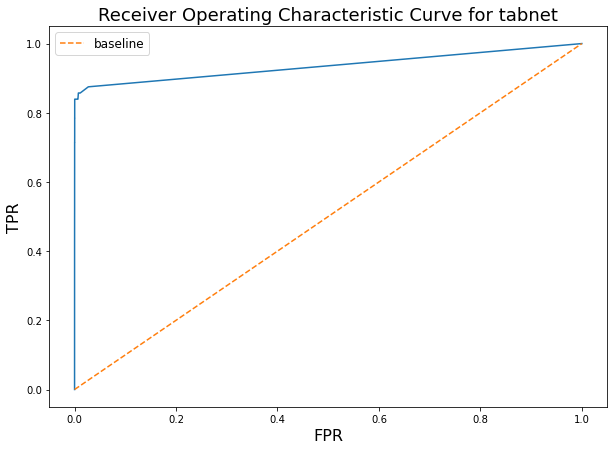

The ROC_AUC score is 0.961622409450021


The Matthew correlation is 0.8465974954948903
-------------------
The accuracy is 0.9994333333333333
The recall is 0.9994333333333333
The macro F1 score is 0.9232814941876706
The micro F1 score is 0.9994333333333333
The weighted F1 score is 0.9994307855117555
              precision    recall  f1-score   support

         0.0       1.00      1.00      1.00     29944
         1.0       0.85      0.84      0.85        56

    accuracy                           1.00     30000
   macro avg       0.93      0.92      0.92     30000
weighted avg       1.00      1.00      1.00     30000



Started Execute test train split at 21:57:57.
Started Started column type detection and casting at 21:57:57.
Started Checking for duplicate columns at 21:57:57.
Started Reset dataframe index. at 21:57:57.
Started Select best features at 21:57:57.
Started Delete columns with high share of NULLs at 21:57:57.
Started Apply datetime transformation at 21:57:57.
Started Start TFIDF to PCA loop at 21:57:57.
Started Handle rare features at 21:57:57.
Started Remove cardinality at 21:57:57.
Started Holistic NULL filling at 21:57:57.
Started Binarize numeric columns + PCA binarized features at 21:57:57.
Started Onehot + PCA categorical features at 21:57:58.
Started Execute categorical encoding at 21:57:58.
Started Fill nulls at 21:57:58.
Started Handle outliers at 21:57:58.
Started Remove collinearity at 21:57:59.
Started Remove skewness at 21:57:59.
Started Execute clustering as a feature at 21:57:59.
Started Execute clustering as a feature at 21:58:12.
Started Execute clustering as a feature at

              precision    recall  f1-score   support

           0       1.00      1.00      1.00     49935
           1       0.71      0.75      0.73        65

    accuracy                           1.00     50000
   macro avg       0.85      0.88      0.87     50000
weighted avg       1.00      1.00      1.00     50000

Score achieved on holdout dataset is: 0.7313098924433392.
End iteration for algorithm tabnet at 1642453190.7877102.
+++++++++++++++++++++++++++++++++++++++++++++++++++++++++++
Start iteration for algorithm vowpal_wabbit at 1642453190.9282215.
Successfully loaded checkpoint last checkpoint.
Started Train Vowpal Wabbit model at 21:59:50.
Started Predict with Vowpal Wabbit at 21:59:58.
22:00:01


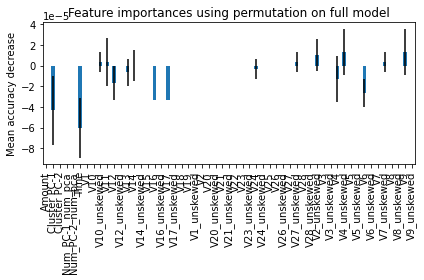

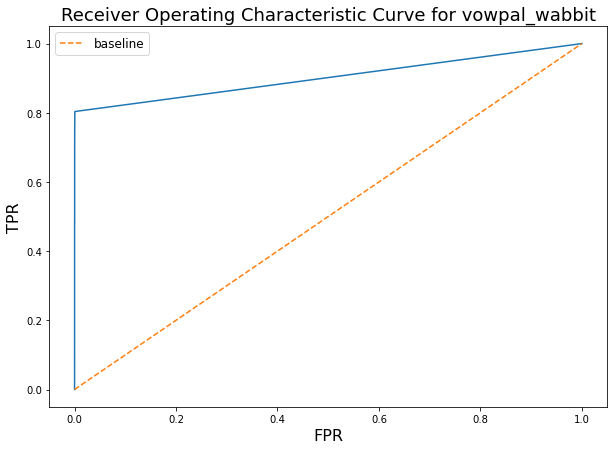

The ROC_AUC score is 0.9586752414029999


The Matthew correlation is 0.8014401446737648
-------------------
The accuracy is 0.9993
The recall is 0.9993
The macro F1 score is 0.899824693213123
The micro F1 score is 0.9993
The weighted F1 score is 0.9992767075715836
              precision    recall  f1-score   support

         0.0       1.00      1.00      1.00     29944
         1.0       0.86      0.75      0.80        56

    accuracy                           1.00     30000
   macro avg       0.93      0.87      0.90     30000
weighted avg       1.00      1.00      1.00     30000



Started Execute test train split at 22:02:24.
Started Started column type detection and casting at 22:02:24.
Started Checking for duplicate columns at 22:02:24.
Started Reset dataframe index. at 22:02:24.
Started Select best features at 22:02:24.
Started Delete columns with high share of NULLs at 22:02:24.
Started Apply datetime transformation at 22:02:24.
Started Start TFIDF to PCA loop at 22:02:24.
Started Handle rare features at 22:02:24.
Started Remove cardinality at 22:02:24.
Started Holistic NULL filling at 22:02:24.
Started Binarize numeric columns + PCA binarized features at 22:02:24.
Started Onehot + PCA categorical features at 22:02:24.
Started Execute categorical encoding at 22:02:24.
Started Fill nulls at 22:02:24.
Started Handle outliers at 22:02:24.
Started Remove collinearity at 22:02:25.
Started Remove skewness at 22:02:25.
Started Execute clustering as a feature at 22:02:25.
Started Execute clustering as a feature at 22:02:38.
Started Execute clustering as a feature at

              precision    recall  f1-score   support

           0       1.00      1.00      1.00     49935
           1       0.97      0.57      0.72        65

    accuracy                           1.00     50000
   macro avg       0.99      0.78      0.86     50000
weighted avg       1.00      1.00      1.00     50000

Score achieved on holdout dataset is: 0.7442529896858046.
End iteration for algorithm vowpal_wabbit at 1642453470.6552916.
+++++++++++++++++++++++++++++++++++++++++++++++++++++++++++
Start iteration for algorithm logistic_regression at 1642453470.7990966.
Successfully loaded checkpoint last checkpoint.
Started Train logistic regression model at 22:04:30.
Started Predict with Logistic Regression at 22:04:31.
22:04:31


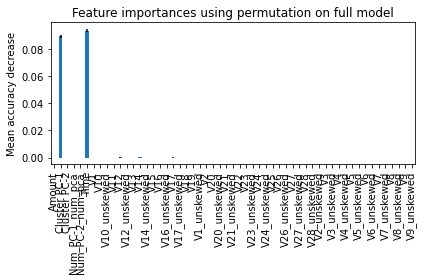

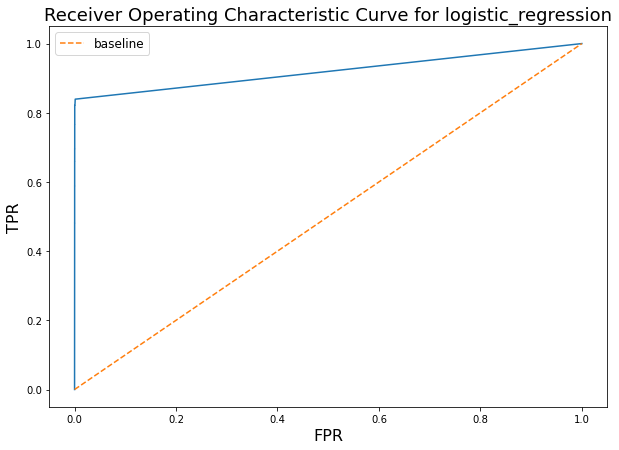

The ROC_AUC score is 0.9691376283347962


The Matthew correlation is 0.8138406479635082
-------------------
The accuracy is 0.9993
The recall is 0.9993
The macro F1 score is 0.9069043158124792
The micro F1 score is 0.9993
The weighted F1 score is 0.9993030915007926
              precision    recall  f1-score   support

         0.0       1.00      1.00      1.00     29944
         1.0       0.81      0.82      0.81        56

    accuracy                           1.00     30000
   macro avg       0.90      0.91      0.91     30000
weighted avg       1.00      1.00      1.00     30000



Started Execute test train split at 22:04:34.
Started Started column type detection and casting at 22:04:34.
Started Checking for duplicate columns at 22:04:34.
Started Reset dataframe index. at 22:04:34.
Started Select best features at 22:04:34.
Started Delete columns with high share of NULLs at 22:04:34.
Started Apply datetime transformation at 22:04:34.
Started Start TFIDF to PCA loop at 22:04:34.
Started Handle rare features at 22:04:34.
Started Remove cardinality at 22:04:34.
Started Holistic NULL filling at 22:04:34.
Started Binarize numeric columns + PCA binarized features at 22:04:34.
Started Onehot + PCA categorical features at 22:04:35.
Started Execute categorical encoding at 22:04:35.
Started Fill nulls at 22:04:35.
Started Handle outliers at 22:04:35.
Started Remove collinearity at 22:04:36.
Started Remove skewness at 22:04:36.
Started Execute clustering as a feature at 22:04:36.
Started Execute clustering as a feature at 22:04:49.
Started Execute clustering as a feature at

              precision    recall  f1-score   support

           0       1.00      1.00      1.00     49935
           1       0.72      0.71      0.71        65

    accuracy                           1.00     50000
   macro avg       0.86      0.85      0.86     50000
weighted avg       1.00      1.00      1.00     50000

Score achieved on holdout dataset is: 0.7128293124970295.
End iteration for algorithm logistic_regression at 1642453591.0173435.
+++++++++++++++++++++++++++++++++++++++++++++++++++++++++++


[I 2022-01-17 22:06:31,186] A new study created in memory with name: sgd


Start iteration for algorithm sgd at 1642453591.1637468.
Successfully loaded checkpoint last checkpoint.
Started Train SGD classifier model at 22:06:31.


  0%|          | 0/100 [00:00<?, ?it/s]

[I 2022-01-17 22:06:31,414] Trial 0 finished with value: 0.010929095149104286 and parameters: {'loss': 'log', 'alpha': 24.658329458549105, 'l1_ratio': 0.06250999323228593, 'epsilon': 0.0024348773534554596, 'max_iter': 4688, 'tol': 1.7073967431528103e-05, 'normalize': True, 'power_t': 0.39663473785260006}. Best is trial 0 with value: 0.010929095149104286.
[I 2022-01-17 22:06:31,782] Trial 1 finished with value: 0.002470821353899201 and parameters: {'loss': 'log', 'alpha': 98.77700294007911, 'l1_ratio': 0.004335189736337855, 'epsilon': 0.002820996133514492, 'max_iter': 5510, 'tol': 0.00016480446427978953, 'normalize': True, 'power_t': 0.17624515035546043}. Best is trial 0 with value: 0.010929095149104286.
[I 2022-01-17 22:06:32,097] Trial 2 finished with value: 0.0054051221572065725 and parameters: {'loss': 'modified_huber', 'alpha': 0.05660670699258887, 'l1_ratio': 0.012562313237138797, 'epsilon': 0.013481575603601416, 'max_iter': 23558, 'tol': 6.290644294586152e-05, 'normalize': False,

[I 2022-01-17 22:06:38,990] Trial 22 finished with value: -0.0046114443730373095 and parameters: {'loss': 'modified_huber', 'alpha': 561.6384148947801, 'l1_ratio': 0.0010459076615571313, 'epsilon': 0.0020952646669037695, 'max_iter': 29260, 'tol': 0.002062140270729075, 'normalize': False, 'power_t': 0.6888985529442667}. Best is trial 0 with value: 0.010929095149104286.
[I 2022-01-17 22:06:39,393] Trial 23 finished with value: 0.007270896113917966 and parameters: {'loss': 'log', 'alpha': 527.622613250592, 'l1_ratio': 0.0011715321055915829, 'epsilon': 0.002147387878159894, 'max_iter': 15446, 'tol': 0.0006769762964326227, 'normalize': True, 'power_t': 0.52664912896466}. Best is trial 0 with value: 0.010929095149104286.
[I 2022-01-17 22:06:39,773] Trial 24 finished with value: -8.778687545166735e-05 and parameters: {'loss': 'modified_huber', 'alpha': 525.9674672530502, 'l1_ratio': 0.0026472285099273614, 'epsilon': 0.003041553338450723, 'max_iter': 25243, 'tol': 7.673617347007203e-05, 'norma

[I 2022-01-17 22:06:46,972] Trial 44 finished with value: -0.0001714121954193874 and parameters: {'loss': 'log', 'alpha': 135.13737910962755, 'l1_ratio': 0.006259520321944912, 'epsilon': 0.01589464607630582, 'max_iter': 22139, 'tol': 1.639826560634764e-05, 'normalize': True, 'power_t': 0.6830026964377534}. Best is trial 0 with value: 0.010929095149104286.
[I 2022-01-17 22:06:47,325] Trial 45 finished with value: 0.007502967503622744 and parameters: {'loss': 'modified_huber', 'alpha': 197.06726490533842, 'l1_ratio': 0.04583888165368417, 'epsilon': 0.08565157719004904, 'max_iter': 21774, 'tol': 4.313168921451393e-05, 'normalize': True, 'power_t': 0.466164516761252}. Best is trial 0 with value: 0.010929095149104286.
[I 2022-01-17 22:06:47,673] Trial 46 finished with value: 0.008669299475451697 and parameters: {'loss': 'log', 'alpha': 16.660911558239373, 'l1_ratio': 0.03826344306323878, 'epsilon': 0.003102790259403216, 'max_iter': 3160, 'tol': 3.459282204126864e-05, 'normalize': True, 'pow

[I 2022-01-17 22:06:54,704] Trial 66 finished with value: -0.0048595769082521 and parameters: {'loss': 'modified_huber', 'alpha': 160.15936966309891, 'l1_ratio': 0.008255103978313486, 'epsilon': 0.0013768581380805168, 'max_iter': 21382, 'tol': 6.808620939092924e-05, 'normalize': False, 'power_t': 0.38459281267804896}. Best is trial 60 with value: 0.030209077603920824.
[I 2022-01-17 22:06:55,022] Trial 67 finished with value: 0.001968425857045649 and parameters: {'loss': 'modified_huber', 'alpha': 645.5166102621741, 'l1_ratio': 0.009537138092039075, 'epsilon': 0.0014385602652500988, 'max_iter': 23437, 'tol': 7.818175983174202e-05, 'normalize': True, 'power_t': 0.5202357236169637}. Best is trial 60 with value: 0.030209077603920824.
[I 2022-01-17 22:06:55,388] Trial 68 finished with value: -0.001158349688648304 and parameters: {'loss': 'modified_huber', 'alpha': 569.2765945970876, 'l1_ratio': 0.09261268927200987, 'epsilon': 0.0010385379590971643, 'max_iter': 17603, 'tol': 2.00353951169632

[I 2022-01-17 22:07:02,309] Trial 88 finished with value: 0.012680152603160678 and parameters: {'loss': 'modified_huber', 'alpha': 0.015116891211117159, 'l1_ratio': 0.5499390949200783, 'epsilon': 0.19777152095498668, 'max_iter': 12415, 'tol': 0.00011548740552831441, 'normalize': True, 'power_t': 0.16549528489892504}. Best is trial 60 with value: 0.030209077603920824.
[I 2022-01-17 22:07:02,665] Trial 89 finished with value: 0.011366643666554575 and parameters: {'loss': 'modified_huber', 'alpha': 0.007264761216422832, 'l1_ratio': 0.9105297194947636, 'epsilon': 0.2852654808964387, 'max_iter': 8254, 'tol': 2.0703624041979246e-05, 'normalize': True, 'power_t': 0.15575146208069532}. Best is trial 60 with value: 0.030209077603920824.
[I 2022-01-17 22:07:03,021] Trial 90 finished with value: 0.012789543033036222 and parameters: {'loss': 'modified_huber', 'alpha': 0.009833263046233314, 'l1_ratio': 0.5784279201853445, 'epsilon': 0.2580000612278902, 'max_iter': 8927, 'tol': 4.288178850807215e-05

Started Predict with SGD classifier at 22:07:07.
22:07:07


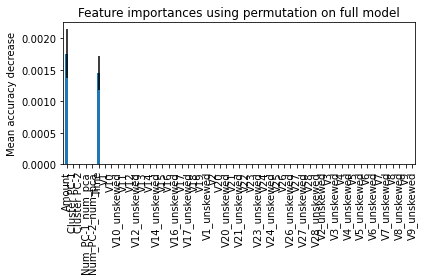

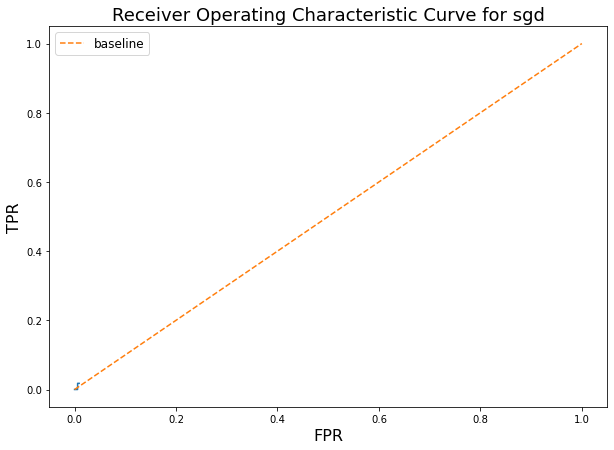

The ROC_AUC score is 0.5043611169421014


The Matthew correlation is 0.006566240078325926
-------------------
The accuracy is 0.9921333333333333
The recall is 0.9921333333333333
The macro F1 score is 0.5022271818268488
The micro F1 score is 0.9921333333333333
The weighted F1 score is 0.994207393379359
              precision    recall  f1-score   support

         0.0       1.00      0.99      1.00     29944
         1.0       0.01      0.02      0.01        56

    accuracy                           0.99     30000
   macro avg       0.50      0.51      0.50     30000
weighted avg       1.00      0.99      0.99     30000



Started Execute test train split at 22:07:10.
Started Started column type detection and casting at 22:07:10.
Started Checking for duplicate columns at 22:07:10.
Started Reset dataframe index. at 22:07:10.
Started Select best features at 22:07:10.
Started Delete columns with high share of NULLs at 22:07:10.
Started Apply datetime transformation at 22:07:10.
Started Start TFIDF to PCA loop at 22:07:10.
Started Handle rare features at 22:07:10.
Started Remove cardinality at 22:07:10.
Started Holistic NULL filling at 22:07:10.
Started Binarize numeric columns + PCA binarized features at 22:07:10.
Started Onehot + PCA categorical features at 22:07:11.
Started Execute categorical encoding at 22:07:11.
Started Fill nulls at 22:07:11.
Started Handle outliers at 22:07:11.
Started Remove collinearity at 22:07:12.
Started Remove skewness at 22:07:12.
Started Execute clustering as a feature at 22:07:12.
Started Execute clustering as a feature at 22:07:25.
Started Execute clustering as a feature at

              precision    recall  f1-score   support

           0       1.00      1.00      1.00     49935
           1       0.00      0.00      0.00        65

    accuracy                           1.00     50000
   macro avg       0.50      0.50      0.50     50000
weighted avg       1.00      1.00      1.00     50000

Score achieved on holdout dataset is: -0.0002794748975573494.
End iteration for algorithm sgd at 1642453751.4532988.
+++++++++++++++++++++++++++++++++++++++++++++++++++++++++++
Start iteration for algorithm quadratic_discriminant_analysis at 1642453751.5974424.
Successfully loaded checkpoint last checkpoint.
Started Train Quadratic Discriminant model at 22:09:11.
Started Predict with Quadratic Discriminant Analysis at 22:09:11.
22:09:11


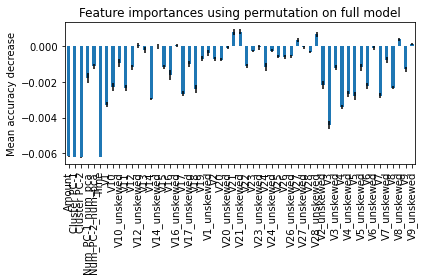

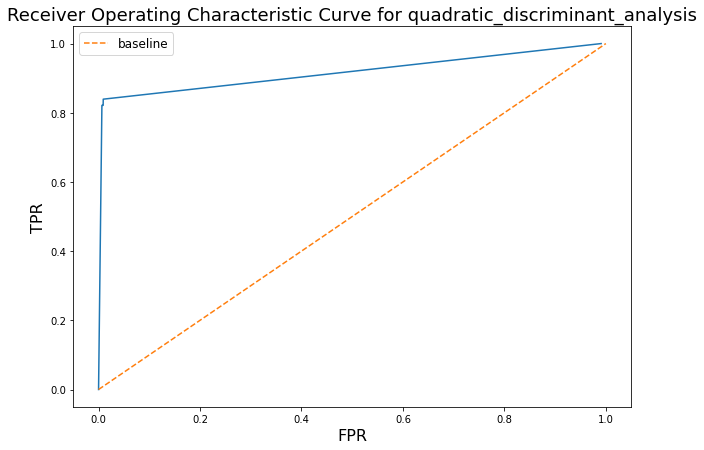

The ROC_AUC score is 0.9413440803786114


The Matthew correlation is 0.39239971274457286
-------------------
The accuracy is 0.9931
The recall is 0.9931
The macro F1 score is 0.6521125145436296
The micro F1 score is 0.9931
The weighted F1 score is 0.9952468859560399
              precision    recall  f1-score   support

         0.0       1.00      0.99      1.00     29944
         1.0       0.19      0.82      0.31        56

    accuracy                           0.99     30000
   macro avg       0.59      0.91      0.65     30000
weighted avg       1.00      0.99      1.00     30000



Started Execute test train split at 22:09:20.
Started Started column type detection and casting at 22:09:20.
Started Checking for duplicate columns at 22:09:20.
Started Reset dataframe index. at 22:09:20.
Started Select best features at 22:09:20.
Started Delete columns with high share of NULLs at 22:09:20.
Started Apply datetime transformation at 22:09:20.
Started Start TFIDF to PCA loop at 22:09:20.
Started Handle rare features at 22:09:20.
Started Remove cardinality at 22:09:20.
Started Holistic NULL filling at 22:09:20.
Started Binarize numeric columns + PCA binarized features at 22:09:20.
Started Onehot + PCA categorical features at 22:09:20.
Started Execute categorical encoding at 22:09:20.
Started Fill nulls at 22:09:20.
Started Handle outliers at 22:09:20.
Started Remove collinearity at 22:09:21.
Started Remove skewness at 22:09:21.
Started Execute clustering as a feature at 22:09:21.
Started Execute clustering as a feature at 22:09:35.
Started Execute clustering as a feature at

[I 2022-01-17 22:11:11,754] A new study created in memory with name: svm


              precision    recall  f1-score   support

           0       1.00      1.00      1.00     49935
           1       0.27      0.78      0.40        65

    accuracy                           1.00     50000
   macro avg       0.63      0.89      0.70     50000
weighted avg       1.00      1.00      1.00     50000

Score achieved on holdout dataset is: 0.4566577138219963.
End iteration for algorithm quadratic_discriminant_analysis at 1642453871.5844333.
+++++++++++++++++++++++++++++++++++++++++++++++++++++++++++
Start iteration for algorithm svm at 1642453871.7320862.
Successfully loaded checkpoint last checkpoint.
Started Train Support Vector Machine classifier model at 22:11:11.


  0%|          | 0/25 [00:00<?, ?it/s]

[I 2022-01-17 22:13:16,972] Trial 0 finished with value: 0.019323231915996636 and parameters: {'C': 8.616644415858344, 'max_iter': 9508, 'tol': 0.008471801418819975, 'gamma': 'scale', 'class_weight': 'balanced'}. Best is trial 0 with value: 0.019323231915996636.
[I 2022-01-17 22:15:54,380] Trial 1 finished with value: 0.0 and parameters: {'C': 361.6125071428695, 'max_iter': 6012, 'tol': 0.006796578090758156, 'gamma': 'auto', 'class_weight': 'balanced'}. Best is trial 0 with value: 0.019323231915996636.
[I 2022-01-17 22:15:56,213] Trial 2 finished with value: 0.0 and parameters: {'C': 1.991497084946204, 'max_iter': 1835, 'tol': 0.00016480446427978953, 'gamma': 'scale', 'class_weight': None}. Best is trial 0 with value: 0.019323231915996636.
[I 2022-01-17 22:17:14,203] Trial 3 finished with value: 0.0 and parameters: {'C': 1.4435885294521449, 'max_iter': 2922, 'tol': 0.0002920433847181409, 'gamma': 'auto', 'class_weight': None}. Best is trial 0 with value: 0.019323231915996636.
[I 2022-0

Started Predict with Support Vector Machine classifier at 22:47:24.
22:47:33


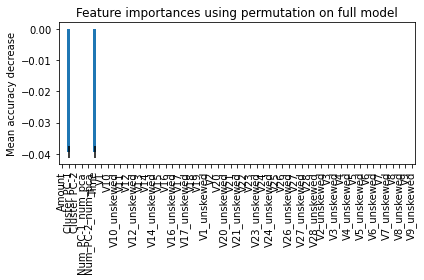

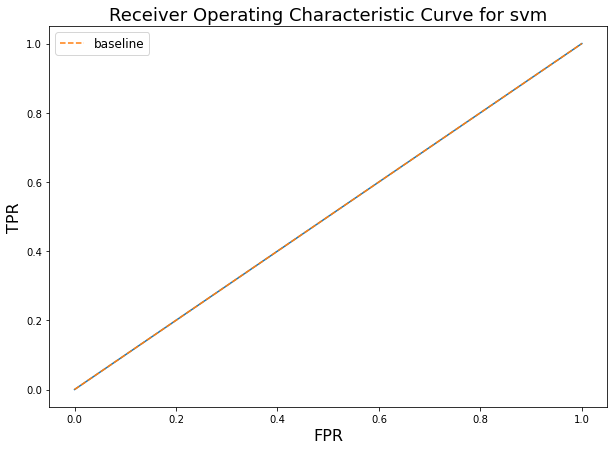

The ROC_AUC score is 0.5173508406167704


The Matthew correlation is 0.0
-------------------
The accuracy is 0.0018666666666666666
The recall is 0.0018666666666666666
The macro F1 score is 0.001863188714399787
The micro F1 score is 0.0018666666666666666
The weighted F1 score is 6.955904533759204e-06
              precision    recall  f1-score   support

         0.0       0.00      0.00      0.00     29944
         1.0       0.00      1.00      0.00        56

    accuracy                           0.00     30000
   macro avg       0.00      0.50      0.00     30000
weighted avg       0.00      0.00      0.00     30000



Started Execute test train split at 22:54:20.
Started Started column type detection and casting at 22:54:20.
Started Checking for duplicate columns at 22:54:20.
Started Reset dataframe index. at 22:54:20.
Started Select best features at 22:54:20.
Started Delete columns with high share of NULLs at 22:54:20.
Started Apply datetime transformation at 22:54:20.
Started Start TFIDF to PCA loop at 22:54:20.
Started Handle rare features at 22:54:20.
Started Remove cardinality at 22:54:20.
Started Holistic NULL filling at 22:54:20.
Started Binarize numeric columns + PCA binarized features at 22:54:20.
Started Onehot + PCA categorical features at 22:54:20.
Started Execute categorical encoding at 22:54:20.
Started Fill nulls at 22:54:20.
Started Handle outliers at 22:54:20.
Started Remove collinearity at 22:54:21.
Started Remove skewness at 22:54:21.
Started Execute clustering as a feature at 22:54:21.
Started Execute clustering as a feature at 22:54:35.
Started Execute clustering as a feature at

              precision    recall  f1-score   support

           0       0.00      0.00      0.00     49935
           1       0.00      1.00      0.00        65

    accuracy                           0.00     50000
   macro avg       0.00      0.50      0.00     50000
weighted avg       0.00      0.00      0.00     50000

Score achieved on holdout dataset is: 0.0.
End iteration for algorithm svm at 1642456552.8803463.
+++++++++++++++++++++++++++++++++++++++++++++++++++++++++++
+++++++++++++++++++++++++++++++++++++++++++++++++++++++++++
Start iteration for checkpoint autotuned_clustering at 1642456553.0245636.
Started Scale data at 22:55:53.
Started Select best features at 22:55:53.
Features before selection are...Time
Features before selection are...V1
Features before selection are...V2
Features before selection are...V3
Features before selection are...V4
Features before selection are...V5
Features before selection are...V6
Features before selection are...V7
Features before selectio

Started epoch 1 from 300 with score of 23.954910375248073.
Started epoch 2 from 300 with score of 66.08414834896583.
Started epoch 3 from 300 with score of 27.785184874735442.
Started epoch 4 from 300 with score of 28.738321801238904.
Started epoch 5 from 300 with score of 30.32235737016096.
Started epoch 6 from 300 with score of 73.31993149002949.
Started epoch 7 from 300 with score of -0.4630127939865654.
Started epoch 8 from 300 with score of 1.372204101595637.
Started epoch 9 from 300 with score of 31.20013484431899.
Started epoch 10 from 300 with score of 32.211740079460604.
Started epoch 11 from 300 with score of 9.080796668424375.
Started epoch 12 from 300 with score of 32.01595358955765.
Started epoch 13 from 300 with score of 0.994730989628799.
Started epoch 14 from 300 with score of 77.6532452047298.
Started epoch 15 from 300 with score of 67.71822989647097.
Started epoch 16 from 300 with score of 76.25560897477713.
Started epoch 17 from 300 with score of 78.32094766472494.
S

Started epoch 139 from 300 with score of 27.51386105617587.
Started epoch 140 from 300 with score of 26.216679931223137.
Started epoch 141 from 300 with score of 19.442211353206062.
Started epoch 142 from 300 with score of 53.484599824434184.
Started epoch 143 from 300 with score of 68.16811549235379.
Started epoch 144 from 300 with score of 28.587692169735096.
Started epoch 145 from 300 with score of 82.37658317520041.
Started epoch 146 from 300 with score of 9.773887622848042.
Started epoch 147 from 300 with score of 66.42564295246552.
Started epoch 148 from 300 with score of 72.68925739654999.
Started epoch 149 from 300 with score of 71.79522444028908.
Started epoch 150 from 300 with score of 19.949914285780647.
Started epoch 151 from 300 with score of 26.150054770792487.
Started epoch 152 from 300 with score of -0.18701576275714668.
Started epoch 153 from 300 with score of 28.450191168500172.
Started epoch 154 from 300 with score of 0.6676855723857176.
Started epoch 155 from 300 wi

Started epoch 275 from 300 with score of 79.64779124177474.
Started epoch 276 from 300 with score of 32.16571499132359.
Started epoch 277 from 300 with score of 73.66243190404475.
Started epoch 278 from 300 with score of 15.151485873051385.
Started epoch 279 from 300 with score of 67.67621195301716.
Started epoch 280 from 300 with score of 13.204868908301282.
Started epoch 281 from 300 with score of 1.632223330468183.
Started epoch 282 from 300 with score of 15.194347207866898.
Started epoch 283 from 300 with score of 65.85656650405458.
Started epoch 284 from 300 with score of 73.66243190404475.
Started epoch 285 from 300 with score of 34.24517703246165.
Started epoch 286 from 300 with score of 4.495544315104576.
Started epoch 287 from 300 with score of 69.38395386884028.
Started epoch 288 from 300 with score of 2.3320214164917235.
Started epoch 289 from 300 with score of 78.32094766472494.
Started epoch 290 from 300 with score of 21.080653827512972.
Started epoch 291 from 300 with sco

[I 2022-01-17 22:57:14,969] A new study created in memory with name: ridge


All algorithms to be tested are: ['ridge', 'lgbm', 'lgbm_focal', 'tabnet', 'vowpal_wabbit', 'logistic_regression', 'sgd', 'quadratic_discriminant_analysis', 'svm'].
Start iteration for algorithm ridge at 1642456634.9453998.
Successfully loaded checkpoint last checkpoint.
Started Train Ridge classifier model at 22:57:14.


  0%|          | 0/10 [00:00<?, ?it/s]

[I 2022-01-17 22:57:15,286] Trial 0 finished with value: 0.43220011210755677 and parameters: {'solver': 'svd', 'alpha': 157.41890047456639, 'max_iter': 6015, 'tol': 0.006796578090758156, 'normalize': False}. Best is trial 0 with value: 0.43220011210755677.
[I 2022-01-17 22:57:15,662] Trial 1 finished with value: 0.43220011210755677 and parameters: {'solver': 'auto', 'alpha': 0.055895242052179224, 'max_iter': 6123, 'tol': 3.613894271216525e-05, 'normalize': False}. Best is trial 0 with value: 0.43220011210755677.
[I 2022-01-17 22:57:16,105] Trial 2 finished with value: 0.43220011210755677 and parameters: {'solver': 'svd', 'alpha': 0.010547383621352036, 'max_iter': 659, 'tol': 0.06245139574743072, 'normalize': True}. Best is trial 0 with value: 0.43220011210755677.
[I 2022-01-17 22:57:16,367] Trial 3 finished with value: 0.3615248335796656 and parameters: {'solver': 'cholesky', 'alpha': 285.7080075040722, 'max_iter': 2595, 'tol': 0.004467752817973905, 'normalize': False}. Best is trial 0

Started Predict with Ridge classifier at 23:01:01.
23:01:01


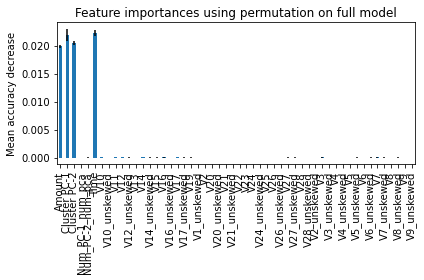

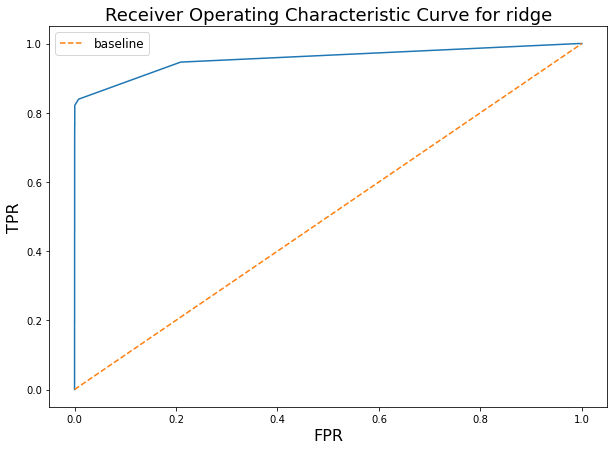

The ROC_AUC score is 0.9719327268043204


The Matthew correlation is 0.8014401446737648
-------------------
The accuracy is 0.9993
The recall is 0.9993
The macro F1 score is 0.899824693213123
The micro F1 score is 0.9993
The weighted F1 score is 0.9992767075715836
              precision    recall  f1-score   support

         0.0       1.00      1.00      1.00     29944
         1.0       0.86      0.75      0.80        56

    accuracy                           1.00     30000
   macro avg       0.93      0.87      0.90     30000
weighted avg       1.00      1.00      1.00     30000



Started Execute test train split at 23:01:11.
Started Started column type detection and casting at 23:01:11.
Started Checking for duplicate columns at 23:01:11.
Started Reset dataframe index. at 23:01:11.
Started Select best features at 23:01:11.
Started Delete columns with high share of NULLs at 23:01:11.
Started Apply datetime transformation at 23:01:11.
Started Start TFIDF to PCA loop at 23:01:11.
Started Handle rare features at 23:01:11.
Started Remove cardinality at 23:01:11.
Started Holistic NULL filling at 23:01:11.
Started Binarize numeric columns + PCA binarized features at 23:01:11.
Started Onehot + PCA categorical features at 23:01:12.
Started Execute categorical encoding at 23:01:12.
Started Fill nulls at 23:01:12.
Started Handle outliers at 23:01:12.
Started Remove collinearity at 23:01:13.
Started Remove skewness at 23:01:13.
Started Execute clustering as a feature at 23:01:13.
Started Execute clustering as a feature at 23:01:26.
Started Execute clustering as a feature at

[I 2022-01-17 23:03:12,293] A new study created in memory with name: lgbm tuning


              precision    recall  f1-score   support

           0       1.00      1.00      1.00     49935
           1       0.92      0.68      0.78        65

    accuracy                           1.00     50000
   macro avg       0.96      0.84      0.89     50000
weighted avg       1.00      1.00      1.00     50000

Score achieved on holdout dataset is: 0.7874991076237248.
End iteration for algorithm ridge at 1642456992.1258485.
+++++++++++++++++++++++++++++++++++++++++++++++++++++++++++
Start iteration for algorithm lgbm at 1642456992.2705295.
Successfully loaded checkpoint last checkpoint.
Started Train LGBM at 23:03:12.
Started Check LGBM for GPU acceleration. at 23:03:12.
LGBM uses GPU.


  0%|          | 0/10 [00:00<?, ?it/s]

[I 2022-01-17 23:03:12,396] Trial 0 finished with value: 0.024854440423070088 and parameters: {'num_boost_round': 18789, 'lambda_l1': 506157.68887523044, 'lambda_l2': 24658.3294585491, 'num_leaves': 154, 'feature_fraction': 0.4936111842654619, 'feature_fraction_bynode': 0.49359671220172163, 'learning_rate': 1.7073967431528103e-05}. Best is trial 0 with value: 0.024854440423070088.
[I 2022-01-17 23:03:12,588] Trial 1 finished with value: 0.024854440423070084 and parameters: {'num_boost_round': 43323, 'lambda_l1': 4042.8727350273302, 'lambda_l2': 17718.847354806814, 'num_leaves': 7, 'feature_fraction': 0.9819459112971965, 'feature_fraction_bynode': 0.899465584480253, 'learning_rate': 7.068974950624602e-05}. Best is trial 1 with value: 0.024854440423070084.
[I 2022-01-17 23:03:28,542] Trial 2 finished with value: 0.01309941870607073 and parameters: {'num_boost_round': 9173, 'lambda_l1': 12.601639723276797, 'lambda_l2': 66.904211664988, 'num_leaves': 135, 'feature_fraction': 0.659167011185

[1]	train's binary_logloss: 0.0137296	valid's binary_logloss: 0.0135892
Training until validation scores don't improve for 10 rounds
[2]	train's binary_logloss: 0.0137238	valid's binary_logloss: 0.013584
[3]	train's binary_logloss: 0.0137181	valid's binary_logloss: 0.0135788
[4]	train's binary_logloss: 0.0137123	valid's binary_logloss: 0.0135734
[5]	train's binary_logloss: 0.0137066	valid's binary_logloss: 0.0135684
[6]	train's binary_logloss: 0.0137009	valid's binary_logloss: 0.0135633
[7]	train's binary_logloss: 0.0136952	valid's binary_logloss: 0.013558
[8]	train's binary_logloss: 0.0136899	valid's binary_logloss: 0.0135531
[9]	train's binary_logloss: 0.0136847	valid's binary_logloss: 0.0135482
[10]	train's binary_logloss: 0.013679	valid's binary_logloss: 0.013543
[11]	train's binary_logloss: 0.0136734	valid's binary_logloss: 0.0135379
[12]	train's binary_logloss: 0.0136677	valid's binary_logloss: 0.0135327
[13]	train's binary_logloss: 0.0136627	valid's binary_logloss: 0.0135279
[14

[201]	train's binary_logloss: 0.0127591	valid's binary_logloss: 0.0127047
[202]	train's binary_logloss: 0.0127546	valid's binary_logloss: 0.0127008
[203]	train's binary_logloss: 0.0127502	valid's binary_logloss: 0.0126969
[204]	train's binary_logloss: 0.0127458	valid's binary_logloss: 0.0126929
[205]	train's binary_logloss: 0.0127413	valid's binary_logloss: 0.0126888
[206]	train's binary_logloss: 0.0127371	valid's binary_logloss: 0.0126849
[207]	train's binary_logloss: 0.0127328	valid's binary_logloss: 0.012681
[208]	train's binary_logloss: 0.0127283	valid's binary_logloss: 0.0126771
[209]	train's binary_logloss: 0.0127245	valid's binary_logloss: 0.0126737
[210]	train's binary_logloss: 0.0127202	valid's binary_logloss: 0.0126698
[211]	train's binary_logloss: 0.012716	valid's binary_logloss: 0.0126664
[212]	train's binary_logloss: 0.0127116	valid's binary_logloss: 0.0126624
[213]	train's binary_logloss: 0.0127075	valid's binary_logloss: 0.0126588
[214]	train's binary_logloss: 0.0127031	

[407]	train's binary_logloss: 0.0119324	valid's binary_logloss: 0.0119635
[408]	train's binary_logloss: 0.0119286	valid's binary_logloss: 0.0119601
[409]	train's binary_logloss: 0.0119247	valid's binary_logloss: 0.0119566
[410]	train's binary_logloss: 0.0119209	valid's binary_logloss: 0.0119531
[411]	train's binary_logloss: 0.0119174	valid's binary_logloss: 0.0119499
[412]	train's binary_logloss: 0.0119137	valid's binary_logloss: 0.0119466
[413]	train's binary_logloss: 0.0119098	valid's binary_logloss: 0.0119432
[414]	train's binary_logloss: 0.0119062	valid's binary_logloss: 0.0119399
[415]	train's binary_logloss: 0.0119027	valid's binary_logloss: 0.0119368
[416]	train's binary_logloss: 0.0118988	valid's binary_logloss: 0.0119334
[417]	train's binary_logloss: 0.0118952	valid's binary_logloss: 0.0119302
[418]	train's binary_logloss: 0.0118918	valid's binary_logloss: 0.011927
[419]	train's binary_logloss: 0.011888	valid's binary_logloss: 0.0119234
[420]	train's binary_logloss: 0.0118844	

[604]	train's binary_logloss: 0.0112247	valid's binary_logloss: 0.0113316
[605]	train's binary_logloss: 0.0112212	valid's binary_logloss: 0.0113284
[606]	train's binary_logloss: 0.0112179	valid's binary_logloss: 0.0113256
[607]	train's binary_logloss: 0.0112144	valid's binary_logloss: 0.0113225
[608]	train's binary_logloss: 0.0112109	valid's binary_logloss: 0.0113193
[609]	train's binary_logloss: 0.0112073	valid's binary_logloss: 0.0113162
[610]	train's binary_logloss: 0.011204	valid's binary_logloss: 0.0113132
[611]	train's binary_logloss: 0.0112008	valid's binary_logloss: 0.0113104
[612]	train's binary_logloss: 0.0111972	valid's binary_logloss: 0.0113071
[613]	train's binary_logloss: 0.0111937	valid's binary_logloss: 0.0113041
[614]	train's binary_logloss: 0.0111904	valid's binary_logloss: 0.011301
[615]	train's binary_logloss: 0.0111869	valid's binary_logloss: 0.0112978
[616]	train's binary_logloss: 0.0111837	valid's binary_logloss: 0.0112946
[617]	train's binary_logloss: 0.0111803	

[803]	train's binary_logloss: 0.0105564	valid's binary_logloss: 0.0107377
[804]	train's binary_logloss: 0.0105531	valid's binary_logloss: 0.0107347
[805]	train's binary_logloss: 0.0105498	valid's binary_logloss: 0.0107318
[806]	train's binary_logloss: 0.0105465	valid's binary_logloss: 0.0107287
[807]	train's binary_logloss: 0.0105432	valid's binary_logloss: 0.0107258
[808]	train's binary_logloss: 0.0105399	valid's binary_logloss: 0.0107227
[809]	train's binary_logloss: 0.0105367	valid's binary_logloss: 0.01072
[810]	train's binary_logloss: 0.0105334	valid's binary_logloss: 0.010717
[811]	train's binary_logloss: 0.0105302	valid's binary_logloss: 0.0107142
[812]	train's binary_logloss: 0.010527	valid's binary_logloss: 0.0107113
[813]	train's binary_logloss: 0.0105238	valid's binary_logloss: 0.0107086
[814]	train's binary_logloss: 0.0105205	valid's binary_logloss: 0.0107057
[815]	train's binary_logloss: 0.0105172	valid's binary_logloss: 0.0107026
[816]	train's binary_logloss: 0.0105141	va

[993]	train's binary_logloss: 0.00993971	valid's binary_logloss: 0.0101878
[994]	train's binary_logloss: 0.00993637	valid's binary_logloss: 0.0101848
[995]	train's binary_logloss: 0.00993317	valid's binary_logloss: 0.010182
[996]	train's binary_logloss: 0.00992997	valid's binary_logloss: 0.0101792
[997]	train's binary_logloss: 0.00992682	valid's binary_logloss: 0.0101763
[998]	train's binary_logloss: 0.00992362	valid's binary_logloss: 0.0101735
[999]	train's binary_logloss: 0.00992035	valid's binary_logloss: 0.0101705
[1000]	train's binary_logloss: 0.00991699	valid's binary_logloss: 0.0101676
[1001]	train's binary_logloss: 0.00991365	valid's binary_logloss: 0.0101649
[1002]	train's binary_logloss: 0.00991058	valid's binary_logloss: 0.0101622
[1003]	train's binary_logloss: 0.00990753	valid's binary_logloss: 0.0101595
[1004]	train's binary_logloss: 0.00990424	valid's binary_logloss: 0.0101565
[1005]	train's binary_logloss: 0.00990104	valid's binary_logloss: 0.0101537
[1006]	train's binar

[1167]	train's binary_logloss: 0.00939026	valid's binary_logloss: 0.00969703
[1168]	train's binary_logloss: 0.00938706	valid's binary_logloss: 0.00969404
[1169]	train's binary_logloss: 0.009384	valid's binary_logloss: 0.00969128
[1170]	train's binary_logloss: 0.00938087	valid's binary_logloss: 0.0096882
[1171]	train's binary_logloss: 0.00937769	valid's binary_logloss: 0.00968573
[1172]	train's binary_logloss: 0.00937446	valid's binary_logloss: 0.00968299
[1173]	train's binary_logloss: 0.00937146	valid's binary_logloss: 0.00968037
[1174]	train's binary_logloss: 0.00936829	valid's binary_logloss: 0.00967736
[1175]	train's binary_logloss: 0.00936521	valid's binary_logloss: 0.00967457
[1176]	train's binary_logloss: 0.00936201	valid's binary_logloss: 0.00967156
[1177]	train's binary_logloss: 0.00935902	valid's binary_logloss: 0.00966899
[1178]	train's binary_logloss: 0.00935603	valid's binary_logloss: 0.00966636
[1179]	train's binary_logloss: 0.00935295	valid's binary_logloss: 0.00966361
[1

[1356]	train's binary_logloss: 0.00881259	valid's binary_logloss: 0.00918124
[1357]	train's binary_logloss: 0.00880957	valid's binary_logloss: 0.00917842
[1358]	train's binary_logloss: 0.00880657	valid's binary_logloss: 0.00917576
[1359]	train's binary_logloss: 0.00880362	valid's binary_logloss: 0.00917325
[1360]	train's binary_logloss: 0.00880062	valid's binary_logloss: 0.00917055
[1361]	train's binary_logloss: 0.00879768	valid's binary_logloss: 0.00916792
[1362]	train's binary_logloss: 0.00879459	valid's binary_logloss: 0.00916508
[1363]	train's binary_logloss: 0.00879159	valid's binary_logloss: 0.00916248
[1364]	train's binary_logloss: 0.00878847	valid's binary_logloss: 0.00915955
[1365]	train's binary_logloss: 0.00878559	valid's binary_logloss: 0.00915701
[1366]	train's binary_logloss: 0.00878264	valid's binary_logloss: 0.00915451
[1367]	train's binary_logloss: 0.00877965	valid's binary_logloss: 0.00915192
[1368]	train's binary_logloss: 0.00877667	valid's binary_logloss: 0.00914932

[1546]	train's binary_logloss: 0.00825032	valid's binary_logloss: 0.00867509
[1547]	train's binary_logloss: 0.00824732	valid's binary_logloss: 0.00867219
[1548]	train's binary_logloss: 0.00824449	valid's binary_logloss: 0.00866983
[1549]	train's binary_logloss: 0.00824158	valid's binary_logloss: 0.00866722
[1550]	train's binary_logloss: 0.00823867	valid's binary_logloss: 0.00866465
[1551]	train's binary_logloss: 0.00823576	valid's binary_logloss: 0.00866198
[1552]	train's binary_logloss: 0.00823286	valid's binary_logloss: 0.00865925
[1553]	train's binary_logloss: 0.00822999	valid's binary_logloss: 0.00865672
[1554]	train's binary_logloss: 0.00822715	valid's binary_logloss: 0.00865411
[1555]	train's binary_logloss: 0.00822414	valid's binary_logloss: 0.00865135
[1556]	train's binary_logloss: 0.00822124	valid's binary_logloss: 0.0086488
[1557]	train's binary_logloss: 0.0082184	valid's binary_logloss: 0.00864621
[1558]	train's binary_logloss: 0.00821544	valid's binary_logloss: 0.00864349
[

[1737]	train's binary_logloss: 0.00770363	valid's binary_logloss: 0.00818683
[1738]	train's binary_logloss: 0.00770092	valid's binary_logloss: 0.00818456
[1739]	train's binary_logloss: 0.00769812	valid's binary_logloss: 0.00818215
[1740]	train's binary_logloss: 0.00769535	valid's binary_logloss: 0.00817966
[1741]	train's binary_logloss: 0.0076926	valid's binary_logloss: 0.00817721
[1742]	train's binary_logloss: 0.00768987	valid's binary_logloss: 0.00817477
[1743]	train's binary_logloss: 0.00768703	valid's binary_logloss: 0.00817199
[1744]	train's binary_logloss: 0.00768411	valid's binary_logloss: 0.00816939
[1745]	train's binary_logloss: 0.00768131	valid's binary_logloss: 0.00816672
[1746]	train's binary_logloss: 0.0076784	valid's binary_logloss: 0.00816406
[1747]	train's binary_logloss: 0.00767551	valid's binary_logloss: 0.00816145
[1748]	train's binary_logloss: 0.00767273	valid's binary_logloss: 0.00815898
[1749]	train's binary_logloss: 0.00766997	valid's binary_logloss: 0.00815647
[

[1929]	train's binary_logloss: 0.00717634	valid's binary_logloss: 0.00771321
[1930]	train's binary_logloss: 0.00717371	valid's binary_logloss: 0.0077108
[1931]	train's binary_logloss: 0.00717105	valid's binary_logloss: 0.00770851
[1932]	train's binary_logloss: 0.00716841	valid's binary_logloss: 0.00770616
[1933]	train's binary_logloss: 0.00716581	valid's binary_logloss: 0.00770389
[1934]	train's binary_logloss: 0.00716315	valid's binary_logloss: 0.00770152
[1935]	train's binary_logloss: 0.00716042	valid's binary_logloss: 0.00769915
[1936]	train's binary_logloss: 0.0071578	valid's binary_logloss: 0.00769682
[1937]	train's binary_logloss: 0.00715499	valid's binary_logloss: 0.0076943
[1938]	train's binary_logloss: 0.00715235	valid's binary_logloss: 0.00769196
[1939]	train's binary_logloss: 0.00714966	valid's binary_logloss: 0.00768943
[1940]	train's binary_logloss: 0.00714703	valid's binary_logloss: 0.00768716
[1941]	train's binary_logloss: 0.00714443	valid's binary_logloss: 0.00768493
[1

[2121]	train's binary_logloss: 0.00667359	valid's binary_logloss: 0.00726374
[2122]	train's binary_logloss: 0.00667105	valid's binary_logloss: 0.0072615
[2123]	train's binary_logloss: 0.00666851	valid's binary_logloss: 0.00725926
[2124]	train's binary_logloss: 0.00666585	valid's binary_logloss: 0.00725681
[2125]	train's binary_logloss: 0.00666333	valid's binary_logloss: 0.00725463
[2126]	train's binary_logloss: 0.00666083	valid's binary_logloss: 0.00725248
[2127]	train's binary_logloss: 0.00665828	valid's binary_logloss: 0.00724995
[2128]	train's binary_logloss: 0.00665566	valid's binary_logloss: 0.00724754
[2129]	train's binary_logloss: 0.00665301	valid's binary_logloss: 0.00724515
[2130]	train's binary_logloss: 0.00665036	valid's binary_logloss: 0.00724283
[2131]	train's binary_logloss: 0.00664783	valid's binary_logloss: 0.00724066
[2132]	train's binary_logloss: 0.00664523	valid's binary_logloss: 0.00723829
[2133]	train's binary_logloss: 0.00664262	valid's binary_logloss: 0.00723588


[2313]	train's binary_logloss: 0.00619748	valid's binary_logloss: 0.00683884
[2314]	train's binary_logloss: 0.00619516	valid's binary_logloss: 0.00683682
[2315]	train's binary_logloss: 0.00619268	valid's binary_logloss: 0.00683468
[2316]	train's binary_logloss: 0.00619031	valid's binary_logloss: 0.00683266
[2317]	train's binary_logloss: 0.00618798	valid's binary_logloss: 0.00683068
[2318]	train's binary_logloss: 0.0061856	valid's binary_logloss: 0.00682861
[2319]	train's binary_logloss: 0.00618324	valid's binary_logloss: 0.00682656
[2320]	train's binary_logloss: 0.00618084	valid's binary_logloss: 0.00682427
[2321]	train's binary_logloss: 0.00617825	valid's binary_logloss: 0.00682231
[2322]	train's binary_logloss: 0.00617572	valid's binary_logloss: 0.00682013
[2323]	train's binary_logloss: 0.00617328	valid's binary_logloss: 0.00681797
[2324]	train's binary_logloss: 0.00617093	valid's binary_logloss: 0.0068159
[2325]	train's binary_logloss: 0.00616862	valid's binary_logloss: 0.00681378
[

[2501]	train's binary_logloss: 0.00576565	valid's binary_logloss: 0.0064552
[2502]	train's binary_logloss: 0.00576352	valid's binary_logloss: 0.00645327
[2503]	train's binary_logloss: 0.00576128	valid's binary_logloss: 0.00645138
[2504]	train's binary_logloss: 0.0057591	valid's binary_logloss: 0.00644948
[2505]	train's binary_logloss: 0.00575697	valid's binary_logloss: 0.00644748
[2506]	train's binary_logloss: 0.00575483	valid's binary_logloss: 0.00644568
[2507]	train's binary_logloss: 0.00575256	valid's binary_logloss: 0.00644348
[2508]	train's binary_logloss: 0.0057504	valid's binary_logloss: 0.00644161
[2509]	train's binary_logloss: 0.00574802	valid's binary_logloss: 0.00643991
[2510]	train's binary_logloss: 0.00574586	valid's binary_logloss: 0.00643796
[2511]	train's binary_logloss: 0.00574371	valid's binary_logloss: 0.00643605
[2512]	train's binary_logloss: 0.00574157	valid's binary_logloss: 0.0064342
[2513]	train's binary_logloss: 0.00573943	valid's binary_logloss: 0.00643228
[25

[2689]	train's binary_logloss: 0.00536865	valid's binary_logloss: 0.00610331
[2690]	train's binary_logloss: 0.00536665	valid's binary_logloss: 0.00610157
[2691]	train's binary_logloss: 0.00536467	valid's binary_logloss: 0.00609979
[2692]	train's binary_logloss: 0.00536271	valid's binary_logloss: 0.00609817
[2693]	train's binary_logloss: 0.00536064	valid's binary_logloss: 0.00609632
[2694]	train's binary_logloss: 0.00535871	valid's binary_logloss: 0.00609461
[2695]	train's binary_logloss: 0.00535651	valid's binary_logloss: 0.00609281
[2696]	train's binary_logloss: 0.00535456	valid's binary_logloss: 0.00609098
[2697]	train's binary_logloss: 0.00535247	valid's binary_logloss: 0.0060892
[2698]	train's binary_logloss: 0.00535051	valid's binary_logloss: 0.00608745
[2699]	train's binary_logloss: 0.00534854	valid's binary_logloss: 0.00608573
[2700]	train's binary_logloss: 0.00534656	valid's binary_logloss: 0.00608401
[2701]	train's binary_logloss: 0.00534457	valid's binary_logloss: 0.00608228


[2874]	train's binary_logloss: 0.00501401	valid's binary_logloss: 0.00579064
[2875]	train's binary_logloss: 0.00501211	valid's binary_logloss: 0.00578879
[2876]	train's binary_logloss: 0.00501037	valid's binary_logloss: 0.00578717
[2877]	train's binary_logloss: 0.00500841	valid's binary_logloss: 0.00578557
[2878]	train's binary_logloss: 0.00500647	valid's binary_logloss: 0.00578378
[2879]	train's binary_logloss: 0.00500474	valid's binary_logloss: 0.00578214
[2880]	train's binary_logloss: 0.00500296	valid's binary_logloss: 0.00578055
[2881]	train's binary_logloss: 0.00500107	valid's binary_logloss: 0.00577907
[2882]	train's binary_logloss: 0.00499917	valid's binary_logloss: 0.00577744
[2883]	train's binary_logloss: 0.00499731	valid's binary_logloss: 0.00577587
[2884]	train's binary_logloss: 0.00499556	valid's binary_logloss: 0.00577429
[2885]	train's binary_logloss: 0.00499385	valid's binary_logloss: 0.00577268
[2886]	train's binary_logloss: 0.00499209	valid's binary_logloss: 0.00577118

[3062]	train's binary_logloss: 0.00469384	valid's binary_logloss: 0.00550669
[3063]	train's binary_logloss: 0.00469226	valid's binary_logloss: 0.00550533
[3064]	train's binary_logloss: 0.0046907	valid's binary_logloss: 0.00550392
[3065]	train's binary_logloss: 0.00468913	valid's binary_logloss: 0.00550253
[3066]	train's binary_logloss: 0.00468757	valid's binary_logloss: 0.00550111
[3067]	train's binary_logloss: 0.00468603	valid's binary_logloss: 0.00549966
[3068]	train's binary_logloss: 0.00468448	valid's binary_logloss: 0.00549839
[3069]	train's binary_logloss: 0.00468294	valid's binary_logloss: 0.00549705
[3070]	train's binary_logloss: 0.00468138	valid's binary_logloss: 0.00549575
[3071]	train's binary_logloss: 0.00467982	valid's binary_logloss: 0.00549434
[3072]	train's binary_logloss: 0.00467813	valid's binary_logloss: 0.00549291
[3073]	train's binary_logloss: 0.00467658	valid's binary_logloss: 0.00549151
[3074]	train's binary_logloss: 0.00467501	valid's binary_logloss: 0.00549015


[3248]	train's binary_logloss: 0.00441569	valid's binary_logloss: 0.00526357
[3249]	train's binary_logloss: 0.00441419	valid's binary_logloss: 0.0052623
[3250]	train's binary_logloss: 0.00441281	valid's binary_logloss: 0.00526106
[3251]	train's binary_logloss: 0.00441144	valid's binary_logloss: 0.00525984
[3252]	train's binary_logloss: 0.00441009	valid's binary_logloss: 0.0052586
[3253]	train's binary_logloss: 0.00440873	valid's binary_logloss: 0.00525738
[3254]	train's binary_logloss: 0.00440736	valid's binary_logloss: 0.00525614
[3255]	train's binary_logloss: 0.00440602	valid's binary_logloss: 0.00525491
[3256]	train's binary_logloss: 0.00440453	valid's binary_logloss: 0.00525366
[3257]	train's binary_logloss: 0.00440317	valid's binary_logloss: 0.00525246
[3258]	train's binary_logloss: 0.00440179	valid's binary_logloss: 0.00525123
[3259]	train's binary_logloss: 0.00440044	valid's binary_logloss: 0.00525001
[3260]	train's binary_logloss: 0.00439901	valid's binary_logloss: 0.00524877
[

[3428]	train's binary_logloss: 0.00417751	valid's binary_logloss: 0.00505635
[3429]	train's binary_logloss: 0.00417635	valid's binary_logloss: 0.00505529
[3430]	train's binary_logloss: 0.00417518	valid's binary_logloss: 0.00505428
[3431]	train's binary_logloss: 0.00417399	valid's binary_logloss: 0.00505321
[3432]	train's binary_logloss: 0.00417283	valid's binary_logloss: 0.00505219
[3433]	train's binary_logloss: 0.00417165	valid's binary_logloss: 0.00505123
[3434]	train's binary_logloss: 0.00417049	valid's binary_logloss: 0.00505021
[3435]	train's binary_logloss: 0.00416927	valid's binary_logloss: 0.00504921
[3436]	train's binary_logloss: 0.00416802	valid's binary_logloss: 0.00504803
[3437]	train's binary_logloss: 0.00416681	valid's binary_logloss: 0.00504703
[3438]	train's binary_logloss: 0.00416553	valid's binary_logloss: 0.00504595
[3439]	train's binary_logloss: 0.00416422	valid's binary_logloss: 0.00504486
[3440]	train's binary_logloss: 0.00416302	valid's binary_logloss: 0.00504382

[3610]	train's binary_logloss: 0.00396866	valid's binary_logloss: 0.00487437
[3611]	train's binary_logloss: 0.00396766	valid's binary_logloss: 0.00487346
[3612]	train's binary_logloss: 0.00396665	valid's binary_logloss: 0.00487252
[3613]	train's binary_logloss: 0.00396554	valid's binary_logloss: 0.00487142
[3614]	train's binary_logloss: 0.00396453	valid's binary_logloss: 0.00487049
[3615]	train's binary_logloss: 0.0039635	valid's binary_logloss: 0.00486953
[3616]	train's binary_logloss: 0.00396226	valid's binary_logloss: 0.00486849
[3617]	train's binary_logloss: 0.00396115	valid's binary_logloss: 0.00486763
[3618]	train's binary_logloss: 0.00396	valid's binary_logloss: 0.00486656
[3619]	train's binary_logloss: 0.00395899	valid's binary_logloss: 0.00486564
[3620]	train's binary_logloss: 0.00395796	valid's binary_logloss: 0.00486477
[3621]	train's binary_logloss: 0.00395685	valid's binary_logloss: 0.00486386
[3622]	train's binary_logloss: 0.00395584	valid's binary_logloss: 0.00486296
[36

[3793]	train's binary_logloss: 0.0037876	valid's binary_logloss: 0.00471713
[3794]	train's binary_logloss: 0.00378674	valid's binary_logloss: 0.00471633
[3795]	train's binary_logloss: 0.00378582	valid's binary_logloss: 0.00471544
[3796]	train's binary_logloss: 0.00378497	valid's binary_logloss: 0.00471464
[3797]	train's binary_logloss: 0.00378412	valid's binary_logloss: 0.00471384
[3798]	train's binary_logloss: 0.00378317	valid's binary_logloss: 0.00471305
[3799]	train's binary_logloss: 0.00378217	valid's binary_logloss: 0.00471226
[3800]	train's binary_logloss: 0.00378132	valid's binary_logloss: 0.00471148
[3801]	train's binary_logloss: 0.00378043	valid's binary_logloss: 0.0047107
[3802]	train's binary_logloss: 0.00377944	valid's binary_logloss: 0.00470986
[3803]	train's binary_logloss: 0.00377846	valid's binary_logloss: 0.00470909
[3804]	train's binary_logloss: 0.00377761	valid's binary_logloss: 0.00470832
[3805]	train's binary_logloss: 0.00377677	valid's binary_logloss: 0.00470753
[

[3981]	train's binary_logloss: 0.00362385	valid's binary_logloss: 0.00458134
[3982]	train's binary_logloss: 0.00362297	valid's binary_logloss: 0.00458057
[3983]	train's binary_logloss: 0.00362217	valid's binary_logloss: 0.00457978
[3984]	train's binary_logloss: 0.00362135	valid's binary_logloss: 0.00457907
[3985]	train's binary_logloss: 0.00362054	valid's binary_logloss: 0.00457832
[3986]	train's binary_logloss: 0.0036197	valid's binary_logloss: 0.00457768
[3987]	train's binary_logloss: 0.00361885	valid's binary_logloss: 0.00457703
[3988]	train's binary_logloss: 0.00361801	valid's binary_logloss: 0.00457639
[3989]	train's binary_logloss: 0.00361723	valid's binary_logloss: 0.00457575
[3990]	train's binary_logloss: 0.00361644	valid's binary_logloss: 0.00457517
[3991]	train's binary_logloss: 0.00361563	valid's binary_logloss: 0.00457454
[3992]	train's binary_logloss: 0.00361473	valid's binary_logloss: 0.00457393
[3993]	train's binary_logloss: 0.00361394	valid's binary_logloss: 0.00457333


[4166]	train's binary_logloss: 0.00348547	valid's binary_logloss: 0.00446915
[4167]	train's binary_logloss: 0.00348471	valid's binary_logloss: 0.00446852
[4168]	train's binary_logloss: 0.00348399	valid's binary_logloss: 0.00446803
[4169]	train's binary_logloss: 0.0034833	valid's binary_logloss: 0.00446746
[4170]	train's binary_logloss: 0.00348268	valid's binary_logloss: 0.00446688
[4171]	train's binary_logloss: 0.00348197	valid's binary_logloss: 0.00446631
[4172]	train's binary_logloss: 0.00348126	valid's binary_logloss: 0.00446575
[4173]	train's binary_logloss: 0.00348063	valid's binary_logloss: 0.00446519
[4174]	train's binary_logloss: 0.00347992	valid's binary_logloss: 0.00446462
[4175]	train's binary_logloss: 0.0034792	valid's binary_logloss: 0.00446396
[4176]	train's binary_logloss: 0.00347848	valid's binary_logloss: 0.00446343
[4177]	train's binary_logloss: 0.00347782	valid's binary_logloss: 0.00446279
[4178]	train's binary_logloss: 0.00347713	valid's binary_logloss: 0.00446223
[

[4345]	train's binary_logloss: 0.00337061	valid's binary_logloss: 0.00437723
[4346]	train's binary_logloss: 0.00336997	valid's binary_logloss: 0.00437676
[4347]	train's binary_logloss: 0.00336935	valid's binary_logloss: 0.00437632
[4348]	train's binary_logloss: 0.00336873	valid's binary_logloss: 0.00437581
[4349]	train's binary_logloss: 0.00336809	valid's binary_logloss: 0.0043754
[4350]	train's binary_logloss: 0.00336749	valid's binary_logloss: 0.00437489
[4351]	train's binary_logloss: 0.00336691	valid's binary_logloss: 0.0043744
[4352]	train's binary_logloss: 0.00336628	valid's binary_logloss: 0.00437397
[4353]	train's binary_logloss: 0.00336566	valid's binary_logloss: 0.00437352
[4354]	train's binary_logloss: 0.00336504	valid's binary_logloss: 0.00437299
[4355]	train's binary_logloss: 0.0033644	valid's binary_logloss: 0.00437259
[4356]	train's binary_logloss: 0.00336375	valid's binary_logloss: 0.00437218
[4357]	train's binary_logloss: 0.00336318	valid's binary_logloss: 0.00437174
[4

[4525]	train's binary_logloss: 0.00326889	valid's binary_logloss: 0.00429997
[4526]	train's binary_logloss: 0.00326842	valid's binary_logloss: 0.00429955
[4527]	train's binary_logloss: 0.00326787	valid's binary_logloss: 0.00429914
[4528]	train's binary_logloss: 0.00326734	valid's binary_logloss: 0.0042987
[4529]	train's binary_logloss: 0.00326681	valid's binary_logloss: 0.0042983
[4530]	train's binary_logloss: 0.00326621	valid's binary_logloss: 0.00429784
[4531]	train's binary_logloss: 0.00326567	valid's binary_logloss: 0.00429744
[4532]	train's binary_logloss: 0.00326509	valid's binary_logloss: 0.00429697
[4533]	train's binary_logloss: 0.00326464	valid's binary_logloss: 0.00429657
[4534]	train's binary_logloss: 0.00326409	valid's binary_logloss: 0.00429617
[4535]	train's binary_logloss: 0.00326352	valid's binary_logloss: 0.00429578
[4536]	train's binary_logloss: 0.00326297	valid's binary_logloss: 0.00429538
[4537]	train's binary_logloss: 0.0032624	valid's binary_logloss: 0.00429503
[4

[4704]	train's binary_logloss: 0.00318112	valid's binary_logloss: 0.00423517
[4705]	train's binary_logloss: 0.00318073	valid's binary_logloss: 0.00423484
[4706]	train's binary_logloss: 0.00318025	valid's binary_logloss: 0.00423448
[4707]	train's binary_logloss: 0.00317983	valid's binary_logloss: 0.00423412
[4708]	train's binary_logloss: 0.00317937	valid's binary_logloss: 0.00423383
[4709]	train's binary_logloss: 0.00317886	valid's binary_logloss: 0.00423348
[4710]	train's binary_logloss: 0.00317839	valid's binary_logloss: 0.0042332
[4711]	train's binary_logloss: 0.00317799	valid's binary_logloss: 0.00423286
[4712]	train's binary_logloss: 0.00317754	valid's binary_logloss: 0.00423252
[4713]	train's binary_logloss: 0.00317699	valid's binary_logloss: 0.00423227
[4714]	train's binary_logloss: 0.00317653	valid's binary_logloss: 0.00423198
[4715]	train's binary_logloss: 0.00317608	valid's binary_logloss: 0.00423171
[4716]	train's binary_logloss: 0.00317567	valid's binary_logloss: 0.00423135


[4880]	train's binary_logloss: 0.00310481	valid's binary_logloss: 0.00418169
[4881]	train's binary_logloss: 0.00310441	valid's binary_logloss: 0.00418145
[4882]	train's binary_logloss: 0.003104	valid's binary_logloss: 0.00418117
[4883]	train's binary_logloss: 0.00310361	valid's binary_logloss: 0.00418085
[4884]	train's binary_logloss: 0.00310319	valid's binary_logloss: 0.00418057
[4885]	train's binary_logloss: 0.00310279	valid's binary_logloss: 0.00418022
[4886]	train's binary_logloss: 0.00310246	valid's binary_logloss: 0.00417996
[4887]	train's binary_logloss: 0.00310206	valid's binary_logloss: 0.00417968
[4888]	train's binary_logloss: 0.00310164	valid's binary_logloss: 0.00417947
[4889]	train's binary_logloss: 0.00310123	valid's binary_logloss: 0.00417917
[4890]	train's binary_logloss: 0.00310083	valid's binary_logloss: 0.00417887
[4891]	train's binary_logloss: 0.00310043	valid's binary_logloss: 0.00417854
[4892]	train's binary_logloss: 0.0031	valid's binary_logloss: 0.00417829
[4893

[5058]	train's binary_logloss: 0.00303545	valid's binary_logloss: 0.004135
[5059]	train's binary_logloss: 0.00303507	valid's binary_logloss: 0.00413481
[5060]	train's binary_logloss: 0.00303473	valid's binary_logloss: 0.00413455
[5061]	train's binary_logloss: 0.00303435	valid's binary_logloss: 0.0041343
[5062]	train's binary_logloss: 0.00303396	valid's binary_logloss: 0.0041341
[5063]	train's binary_logloss: 0.00303359	valid's binary_logloss: 0.00413391
[5064]	train's binary_logloss: 0.00303323	valid's binary_logloss: 0.00413364
[5065]	train's binary_logloss: 0.00303286	valid's binary_logloss: 0.0041334
[5066]	train's binary_logloss: 0.00303247	valid's binary_logloss: 0.00413313
[5067]	train's binary_logloss: 0.00303212	valid's binary_logloss: 0.00413287
[5068]	train's binary_logloss: 0.00303176	valid's binary_logloss: 0.00413265
[5069]	train's binary_logloss: 0.00303138	valid's binary_logloss: 0.00413243
[5070]	train's binary_logloss: 0.00303103	valid's binary_logloss: 0.00413218
[507

[5229]	train's binary_logloss: 0.00297495	valid's binary_logloss: 0.00409667
[5230]	train's binary_logloss: 0.00297462	valid's binary_logloss: 0.00409643
[5231]	train's binary_logloss: 0.00297431	valid's binary_logloss: 0.00409625
[5232]	train's binary_logloss: 0.00297397	valid's binary_logloss: 0.00409607
[5233]	train's binary_logloss: 0.00297361	valid's binary_logloss: 0.00409589
[5234]	train's binary_logloss: 0.00297327	valid's binary_logloss: 0.00409567
[5235]	train's binary_logloss: 0.00297295	valid's binary_logloss: 0.00409545
[5236]	train's binary_logloss: 0.0029726	valid's binary_logloss: 0.00409521
[5237]	train's binary_logloss: 0.00297221	valid's binary_logloss: 0.00409509
[5238]	train's binary_logloss: 0.0029719	valid's binary_logloss: 0.00409487
[5239]	train's binary_logloss: 0.00297151	valid's binary_logloss: 0.00409457
[5240]	train's binary_logloss: 0.00297119	valid's binary_logloss: 0.00409432
[5241]	train's binary_logloss: 0.00297087	valid's binary_logloss: 0.00409412
[

[5396]	train's binary_logloss: 0.00292109	valid's binary_logloss: 0.0040629
[5397]	train's binary_logloss: 0.00292079	valid's binary_logloss: 0.00406273
[5398]	train's binary_logloss: 0.0029205	valid's binary_logloss: 0.00406256
[5399]	train's binary_logloss: 0.00292019	valid's binary_logloss: 0.00406236
[5400]	train's binary_logloss: 0.00291988	valid's binary_logloss: 0.00406216
[5401]	train's binary_logloss: 0.00291958	valid's binary_logloss: 0.00406197
[5402]	train's binary_logloss: 0.0029193	valid's binary_logloss: 0.00406177
[5403]	train's binary_logloss: 0.002919	valid's binary_logloss: 0.00406159
[5404]	train's binary_logloss: 0.0029187	valid's binary_logloss: 0.00406138
[5405]	train's binary_logloss: 0.00291841	valid's binary_logloss: 0.00406116
[5406]	train's binary_logloss: 0.00291812	valid's binary_logloss: 0.00406095
[5407]	train's binary_logloss: 0.00291783	valid's binary_logloss: 0.00406077
[5408]	train's binary_logloss: 0.00291749	valid's binary_logloss: 0.00406055
[5409

[5564]	train's binary_logloss: 0.00287173	valid's binary_logloss: 0.00403375
[5565]	train's binary_logloss: 0.00287145	valid's binary_logloss: 0.00403362
[5566]	train's binary_logloss: 0.0028711	valid's binary_logloss: 0.0040334
[5567]	train's binary_logloss: 0.00287085	valid's binary_logloss: 0.00403324
[5568]	train's binary_logloss: 0.00287054	valid's binary_logloss: 0.00403306
[5569]	train's binary_logloss: 0.00287025	valid's binary_logloss: 0.00403295
[5570]	train's binary_logloss: 0.00286997	valid's binary_logloss: 0.00403284
[5571]	train's binary_logloss: 0.00286968	valid's binary_logloss: 0.00403268
[5572]	train's binary_logloss: 0.0028694	valid's binary_logloss: 0.00403256
[5573]	train's binary_logloss: 0.00286912	valid's binary_logloss: 0.00403237
[5574]	train's binary_logloss: 0.00286883	valid's binary_logloss: 0.00403224
[5575]	train's binary_logloss: 0.00286855	valid's binary_logloss: 0.00403206
[5576]	train's binary_logloss: 0.00286826	valid's binary_logloss: 0.0040319
[55

[5728]	train's binary_logloss: 0.00282681	valid's binary_logloss: 0.00400903
[5729]	train's binary_logloss: 0.00282656	valid's binary_logloss: 0.00400888
[5730]	train's binary_logloss: 0.00282628	valid's binary_logloss: 0.00400876
[5731]	train's binary_logloss: 0.00282603	valid's binary_logloss: 0.00400861
[5732]	train's binary_logloss: 0.00282577	valid's binary_logloss: 0.00400847
[5733]	train's binary_logloss: 0.00282549	valid's binary_logloss: 0.00400836
[5734]	train's binary_logloss: 0.00282525	valid's binary_logloss: 0.00400821
[5735]	train's binary_logloss: 0.00282498	valid's binary_logloss: 0.00400809
[5736]	train's binary_logloss: 0.00282472	valid's binary_logloss: 0.00400794
[5737]	train's binary_logloss: 0.00282444	valid's binary_logloss: 0.00400781
[5738]	train's binary_logloss: 0.00282421	valid's binary_logloss: 0.00400765
[5739]	train's binary_logloss: 0.00282396	valid's binary_logloss: 0.00400744
[5740]	train's binary_logloss: 0.00282366	valid's binary_logloss: 0.00400725

[5891]	train's binary_logloss: 0.00278462	valid's binary_logloss: 0.00398761
[5892]	train's binary_logloss: 0.00278438	valid's binary_logloss: 0.00398747
[5893]	train's binary_logloss: 0.00278409	valid's binary_logloss: 0.00398734
[5894]	train's binary_logloss: 0.00278384	valid's binary_logloss: 0.00398721
[5895]	train's binary_logloss: 0.00278361	valid's binary_logloss: 0.00398708
[5896]	train's binary_logloss: 0.00278335	valid's binary_logloss: 0.00398692
[5897]	train's binary_logloss: 0.00278311	valid's binary_logloss: 0.00398679
[5898]	train's binary_logloss: 0.00278287	valid's binary_logloss: 0.00398667
[5899]	train's binary_logloss: 0.00278262	valid's binary_logloss: 0.00398658
[5900]	train's binary_logloss: 0.00278237	valid's binary_logloss: 0.00398644
[5901]	train's binary_logloss: 0.00278211	valid's binary_logloss: 0.00398633
[5902]	train's binary_logloss: 0.00278191	valid's binary_logloss: 0.00398615
[5903]	train's binary_logloss: 0.00278165	valid's binary_logloss: 0.00398603

[6054]	train's binary_logloss: 0.00274591	valid's binary_logloss: 0.00396747
[6055]	train's binary_logloss: 0.00274568	valid's binary_logloss: 0.00396735
[6056]	train's binary_logloss: 0.00274541	valid's binary_logloss: 0.00396723
[6057]	train's binary_logloss: 0.00274518	valid's binary_logloss: 0.00396715
[6058]	train's binary_logloss: 0.00274494	valid's binary_logloss: 0.003967
[6059]	train's binary_logloss: 0.00274476	valid's binary_logloss: 0.00396686
[6060]	train's binary_logloss: 0.00274455	valid's binary_logloss: 0.00396675
[6061]	train's binary_logloss: 0.00274429	valid's binary_logloss: 0.00396659
[6062]	train's binary_logloss: 0.00274409	valid's binary_logloss: 0.00396652
[6063]	train's binary_logloss: 0.00274387	valid's binary_logloss: 0.00396641
[6064]	train's binary_logloss: 0.00274366	valid's binary_logloss: 0.00396627
[6065]	train's binary_logloss: 0.00274342	valid's binary_logloss: 0.00396613
[6066]	train's binary_logloss: 0.00274314	valid's binary_logloss: 0.00396598
[

[6216]	train's binary_logloss: 0.00270968	valid's binary_logloss: 0.00394934
[6217]	train's binary_logloss: 0.00270947	valid's binary_logloss: 0.00394925
[6218]	train's binary_logloss: 0.00270928	valid's binary_logloss: 0.00394918
[6219]	train's binary_logloss: 0.00270903	valid's binary_logloss: 0.00394906
[6220]	train's binary_logloss: 0.00270882	valid's binary_logloss: 0.00394893
[6221]	train's binary_logloss: 0.00270862	valid's binary_logloss: 0.00394885
[6222]	train's binary_logloss: 0.00270841	valid's binary_logloss: 0.00394875
[6223]	train's binary_logloss: 0.00270819	valid's binary_logloss: 0.00394866
[6224]	train's binary_logloss: 0.00270797	valid's binary_logloss: 0.00394857
[6225]	train's binary_logloss: 0.00270776	valid's binary_logloss: 0.0039485
[6226]	train's binary_logloss: 0.00270752	valid's binary_logloss: 0.00394838
[6227]	train's binary_logloss: 0.0027073	valid's binary_logloss: 0.00394828
[6228]	train's binary_logloss: 0.00270708	valid's binary_logloss: 0.00394818
[

[6376]	train's binary_logloss: 0.00267603	valid's binary_logloss: 0.00393318
[6377]	train's binary_logloss: 0.0026758	valid's binary_logloss: 0.0039331
[6378]	train's binary_logloss: 0.0026756	valid's binary_logloss: 0.00393299
[6379]	train's binary_logloss: 0.0026754	valid's binary_logloss: 0.0039329
[6380]	train's binary_logloss: 0.0026752	valid's binary_logloss: 0.00393283
[6381]	train's binary_logloss: 0.00267497	valid's binary_logloss: 0.00393274
[6382]	train's binary_logloss: 0.00267476	valid's binary_logloss: 0.0039326
[6383]	train's binary_logloss: 0.00267454	valid's binary_logloss: 0.0039325
[6384]	train's binary_logloss: 0.00267433	valid's binary_logloss: 0.00393238
[6385]	train's binary_logloss: 0.00267411	valid's binary_logloss: 0.00393229
[6386]	train's binary_logloss: 0.00267389	valid's binary_logloss: 0.00393214
[6387]	train's binary_logloss: 0.00267369	valid's binary_logloss: 0.00393204
[6388]	train's binary_logloss: 0.00267348	valid's binary_logloss: 0.00393196
[6389]	

[6535]	train's binary_logloss: 0.00264413	valid's binary_logloss: 0.00391807
[6536]	train's binary_logloss: 0.00264395	valid's binary_logloss: 0.00391799
[6537]	train's binary_logloss: 0.00264375	valid's binary_logloss: 0.00391786
[6538]	train's binary_logloss: 0.00264355	valid's binary_logloss: 0.00391771
[6539]	train's binary_logloss: 0.00264338	valid's binary_logloss: 0.00391759
[6540]	train's binary_logloss: 0.00264314	valid's binary_logloss: 0.0039175
[6541]	train's binary_logloss: 0.00264299	valid's binary_logloss: 0.00391739
[6542]	train's binary_logloss: 0.00264278	valid's binary_logloss: 0.0039173
[6543]	train's binary_logloss: 0.00264258	valid's binary_logloss: 0.0039172
[6544]	train's binary_logloss: 0.00264239	valid's binary_logloss: 0.00391713
[6545]	train's binary_logloss: 0.00264215	valid's binary_logloss: 0.00391704
[6546]	train's binary_logloss: 0.00264195	valid's binary_logloss: 0.00391695
[6547]	train's binary_logloss: 0.00264179	valid's binary_logloss: 0.00391688
[6

[6688]	train's binary_logloss: 0.00261451	valid's binary_logloss: 0.00390489
[6689]	train's binary_logloss: 0.00261432	valid's binary_logloss: 0.00390483
[6690]	train's binary_logloss: 0.00261415	valid's binary_logloss: 0.00390479
[6691]	train's binary_logloss: 0.00261393	valid's binary_logloss: 0.0039047
[6692]	train's binary_logloss: 0.00261376	valid's binary_logloss: 0.00390464
[6693]	train's binary_logloss: 0.00261358	valid's binary_logloss: 0.00390452
[6694]	train's binary_logloss: 0.00261341	valid's binary_logloss: 0.00390441
[6695]	train's binary_logloss: 0.00261325	valid's binary_logloss: 0.00390434
[6696]	train's binary_logloss: 0.00261305	valid's binary_logloss: 0.00390427
[6697]	train's binary_logloss: 0.00261286	valid's binary_logloss: 0.00390417
[6698]	train's binary_logloss: 0.0026127	valid's binary_logloss: 0.00390412
[6699]	train's binary_logloss: 0.00261253	valid's binary_logloss: 0.00390406
[6700]	train's binary_logloss: 0.0026123	valid's binary_logloss: 0.00390401
[6

[6841]	train's binary_logloss: 0.00258646	valid's binary_logloss: 0.00389248
[6842]	train's binary_logloss: 0.00258628	valid's binary_logloss: 0.00389239
[6843]	train's binary_logloss: 0.00258611	valid's binary_logloss: 0.00389232
[6844]	train's binary_logloss: 0.00258593	valid's binary_logloss: 0.00389226
[6845]	train's binary_logloss: 0.00258574	valid's binary_logloss: 0.0038922
[6846]	train's binary_logloss: 0.00258552	valid's binary_logloss: 0.0038921
[6847]	train's binary_logloss: 0.00258533	valid's binary_logloss: 0.00389201
[6848]	train's binary_logloss: 0.00258516	valid's binary_logloss: 0.00389194
[6849]	train's binary_logloss: 0.002585	valid's binary_logloss: 0.00389183
[6850]	train's binary_logloss: 0.00258483	valid's binary_logloss: 0.00389178
[6851]	train's binary_logloss: 0.00258466	valid's binary_logloss: 0.00389172
[6852]	train's binary_logloss: 0.00258449	valid's binary_logloss: 0.00389164
[6853]	train's binary_logloss: 0.00258432	valid's binary_logloss: 0.00389156
[68

[6992]	train's binary_logloss: 0.00255977	valid's binary_logloss: 0.0038813
[6993]	train's binary_logloss: 0.00255959	valid's binary_logloss: 0.00388126
[6994]	train's binary_logloss: 0.00255942	valid's binary_logloss: 0.0038812
[6995]	train's binary_logloss: 0.00255926	valid's binary_logloss: 0.00388111
[6996]	train's binary_logloss: 0.00255912	valid's binary_logloss: 0.00388105
[6997]	train's binary_logloss: 0.00255895	valid's binary_logloss: 0.00388095
[6998]	train's binary_logloss: 0.0025588	valid's binary_logloss: 0.00388084
[6999]	train's binary_logloss: 0.00255864	valid's binary_logloss: 0.00388079
[7000]	train's binary_logloss: 0.00255847	valid's binary_logloss: 0.00388072
[7001]	train's binary_logloss: 0.00255832	valid's binary_logloss: 0.00388063
[7002]	train's binary_logloss: 0.00255814	valid's binary_logloss: 0.00388058
[7003]	train's binary_logloss: 0.00255798	valid's binary_logloss: 0.00388053
[7004]	train's binary_logloss: 0.00255778	valid's binary_logloss: 0.00388046
[7

[7145]	train's binary_logloss: 0.00253402	valid's binary_logloss: 0.00387053
[7146]	train's binary_logloss: 0.00253385	valid's binary_logloss: 0.00387047
[7147]	train's binary_logloss: 0.00253369	valid's binary_logloss: 0.00387038
[7148]	train's binary_logloss: 0.00253352	valid's binary_logloss: 0.00387029
[7149]	train's binary_logloss: 0.00253335	valid's binary_logloss: 0.00387025
[7150]	train's binary_logloss: 0.00253318	valid's binary_logloss: 0.00387015
[7151]	train's binary_logloss: 0.00253299	valid's binary_logloss: 0.00387008
[7152]	train's binary_logloss: 0.00253281	valid's binary_logloss: 0.00387
[7153]	train's binary_logloss: 0.00253265	valid's binary_logloss: 0.00386992
[7154]	train's binary_logloss: 0.00253248	valid's binary_logloss: 0.00386985
[7155]	train's binary_logloss: 0.00253229	valid's binary_logloss: 0.00386978
[7156]	train's binary_logloss: 0.00253213	valid's binary_logloss: 0.00386972
[7157]	train's binary_logloss: 0.00253198	valid's binary_logloss: 0.00386963
[7

[7298]	train's binary_logloss: 0.0025095	valid's binary_logloss: 0.00386016
[7299]	train's binary_logloss: 0.00250935	valid's binary_logloss: 0.0038601
[7300]	train's binary_logloss: 0.00250918	valid's binary_logloss: 0.00386003
[7301]	train's binary_logloss: 0.00250901	valid's binary_logloss: 0.00385994
[7302]	train's binary_logloss: 0.00250886	valid's binary_logloss: 0.00385987
[7303]	train's binary_logloss: 0.00250868	valid's binary_logloss: 0.00385982
[7304]	train's binary_logloss: 0.00250853	valid's binary_logloss: 0.00385979
[7305]	train's binary_logloss: 0.00250838	valid's binary_logloss: 0.00385973
[7306]	train's binary_logloss: 0.00250824	valid's binary_logloss: 0.00385967
[7307]	train's binary_logloss: 0.00250811	valid's binary_logloss: 0.00385961
[7308]	train's binary_logloss: 0.00250793	valid's binary_logloss: 0.00385951
[7309]	train's binary_logloss: 0.00250774	valid's binary_logloss: 0.00385944
[7310]	train's binary_logloss: 0.00250759	valid's binary_logloss: 0.00385937
[

[7447]	train's binary_logloss: 0.0024866	valid's binary_logloss: 0.00385105
[7448]	train's binary_logloss: 0.00248645	valid's binary_logloss: 0.00385099
[7449]	train's binary_logloss: 0.00248631	valid's binary_logloss: 0.00385094
[7450]	train's binary_logloss: 0.00248615	valid's binary_logloss: 0.00385088
[7451]	train's binary_logloss: 0.002486	valid's binary_logloss: 0.00385085
[7452]	train's binary_logloss: 0.00248585	valid's binary_logloss: 0.0038508
[7453]	train's binary_logloss: 0.0024857	valid's binary_logloss: 0.00385072
[7454]	train's binary_logloss: 0.00248555	valid's binary_logloss: 0.00385068
[7455]	train's binary_logloss: 0.00248538	valid's binary_logloss: 0.00385064
[7456]	train's binary_logloss: 0.00248525	valid's binary_logloss: 0.00385059
[7457]	train's binary_logloss: 0.00248509	valid's binary_logloss: 0.00385054
[7458]	train's binary_logloss: 0.00248493	valid's binary_logloss: 0.00385045
[7459]	train's binary_logloss: 0.00248478	valid's binary_logloss: 0.00385041
[746

[7595]	train's binary_logloss: 0.00246493	valid's binary_logloss: 0.00384247
[7596]	train's binary_logloss: 0.00246478	valid's binary_logloss: 0.00384238
[7597]	train's binary_logloss: 0.0024646	valid's binary_logloss: 0.00384231
[7598]	train's binary_logloss: 0.00246446	valid's binary_logloss: 0.00384226
[7599]	train's binary_logloss: 0.00246432	valid's binary_logloss: 0.00384223
[7600]	train's binary_logloss: 0.00246417	valid's binary_logloss: 0.00384217
[7601]	train's binary_logloss: 0.00246404	valid's binary_logloss: 0.0038421
[7602]	train's binary_logloss: 0.0024639	valid's binary_logloss: 0.00384205
[7603]	train's binary_logloss: 0.00246377	valid's binary_logloss: 0.00384198
[7604]	train's binary_logloss: 0.00246362	valid's binary_logloss: 0.00384191
[7605]	train's binary_logloss: 0.00246348	valid's binary_logloss: 0.00384186
[7606]	train's binary_logloss: 0.00246333	valid's binary_logloss: 0.00384183
[7607]	train's binary_logloss: 0.00246315	valid's binary_logloss: 0.00384178
[7

[7739]	train's binary_logloss: 0.00244424	valid's binary_logloss: 0.00383444
[7740]	train's binary_logloss: 0.00244407	valid's binary_logloss: 0.00383439
[7741]	train's binary_logloss: 0.00244394	valid's binary_logloss: 0.00383435
[7742]	train's binary_logloss: 0.00244379	valid's binary_logloss: 0.00383428
[7743]	train's binary_logloss: 0.00244365	valid's binary_logloss: 0.00383419
[7744]	train's binary_logloss: 0.00244352	valid's binary_logloss: 0.0038341
[7745]	train's binary_logloss: 0.0024434	valid's binary_logloss: 0.00383407
[7746]	train's binary_logloss: 0.00244328	valid's binary_logloss: 0.00383403
[7747]	train's binary_logloss: 0.00244314	valid's binary_logloss: 0.00383398
[7748]	train's binary_logloss: 0.00244296	valid's binary_logloss: 0.00383393
[7749]	train's binary_logloss: 0.00244282	valid's binary_logloss: 0.0038339
[7750]	train's binary_logloss: 0.00244269	valid's binary_logloss: 0.00383383
[7751]	train's binary_logloss: 0.00244253	valid's binary_logloss: 0.00383378
[7

[7882]	train's binary_logloss: 0.00242415	valid's binary_logloss: 0.00382674
[7883]	train's binary_logloss: 0.00242401	valid's binary_logloss: 0.00382667
[7884]	train's binary_logloss: 0.00242386	valid's binary_logloss: 0.00382662
[7885]	train's binary_logloss: 0.00242373	valid's binary_logloss: 0.00382655
[7886]	train's binary_logloss: 0.00242357	valid's binary_logloss: 0.00382651
[7887]	train's binary_logloss: 0.00242344	valid's binary_logloss: 0.00382647
[7888]	train's binary_logloss: 0.00242331	valid's binary_logloss: 0.00382646
[7889]	train's binary_logloss: 0.00242315	valid's binary_logloss: 0.0038264
[7890]	train's binary_logloss: 0.00242303	valid's binary_logloss: 0.00382633
[7891]	train's binary_logloss: 0.00242288	valid's binary_logloss: 0.00382629
[7892]	train's binary_logloss: 0.00242278	valid's binary_logloss: 0.00382622
[7893]	train's binary_logloss: 0.00242265	valid's binary_logloss: 0.00382614
[7894]	train's binary_logloss: 0.00242252	valid's binary_logloss: 0.00382608


[8026]	train's binary_logloss: 0.00240481	valid's binary_logloss: 0.00381939
[8027]	train's binary_logloss: 0.00240469	valid's binary_logloss: 0.00381932
[8028]	train's binary_logloss: 0.00240455	valid's binary_logloss: 0.00381928
[8029]	train's binary_logloss: 0.00240443	valid's binary_logloss: 0.00381926
[8030]	train's binary_logloss: 0.00240427	valid's binary_logloss: 0.00381919
[8031]	train's binary_logloss: 0.00240415	valid's binary_logloss: 0.00381912
[8032]	train's binary_logloss: 0.00240402	valid's binary_logloss: 0.00381907
[8033]	train's binary_logloss: 0.00240388	valid's binary_logloss: 0.00381903
[8034]	train's binary_logloss: 0.00240375	valid's binary_logloss: 0.00381897
[8035]	train's binary_logloss: 0.00240359	valid's binary_logloss: 0.00381891
[8036]	train's binary_logloss: 0.00240347	valid's binary_logloss: 0.00381885
[8037]	train's binary_logloss: 0.00240334	valid's binary_logloss: 0.00381882
[8038]	train's binary_logloss: 0.00240321	valid's binary_logloss: 0.00381878

[8168]	train's binary_logloss: 0.00238618	valid's binary_logloss: 0.00381244
[8169]	train's binary_logloss: 0.00238605	valid's binary_logloss: 0.00381237
[8170]	train's binary_logloss: 0.00238591	valid's binary_logloss: 0.00381229
[8171]	train's binary_logloss: 0.0023858	valid's binary_logloss: 0.00381225
[8172]	train's binary_logloss: 0.00238565	valid's binary_logloss: 0.00381222
[8173]	train's binary_logloss: 0.00238553	valid's binary_logloss: 0.0038122
[8174]	train's binary_logloss: 0.00238543	valid's binary_logloss: 0.00381218
[8175]	train's binary_logloss: 0.0023853	valid's binary_logloss: 0.00381211
[8176]	train's binary_logloss: 0.00238515	valid's binary_logloss: 0.00381203
[8177]	train's binary_logloss: 0.002385	valid's binary_logloss: 0.00381197
[8178]	train's binary_logloss: 0.00238489	valid's binary_logloss: 0.0038119
[8179]	train's binary_logloss: 0.00238473	valid's binary_logloss: 0.00381186
[8180]	train's binary_logloss: 0.0023846	valid's binary_logloss: 0.00381184
[8181]

[8312]	train's binary_logloss: 0.00236787	valid's binary_logloss: 0.00380604
[8313]	train's binary_logloss: 0.00236775	valid's binary_logloss: 0.00380602
[8314]	train's binary_logloss: 0.00236763	valid's binary_logloss: 0.003806
[8315]	train's binary_logloss: 0.00236751	valid's binary_logloss: 0.00380597
[8316]	train's binary_logloss: 0.00236739	valid's binary_logloss: 0.00380591
[8317]	train's binary_logloss: 0.00236728	valid's binary_logloss: 0.00380584
[8318]	train's binary_logloss: 0.00236716	valid's binary_logloss: 0.0038058
[8319]	train's binary_logloss: 0.00236705	valid's binary_logloss: 0.00380577
[8320]	train's binary_logloss: 0.00236693	valid's binary_logloss: 0.00380575
[8321]	train's binary_logloss: 0.00236679	valid's binary_logloss: 0.0038057
[8322]	train's binary_logloss: 0.00236666	valid's binary_logloss: 0.00380564
[8323]	train's binary_logloss: 0.00236655	valid's binary_logloss: 0.00380558
[8324]	train's binary_logloss: 0.0023664	valid's binary_logloss: 0.00380553
[832

[8456]	train's binary_logloss: 0.00235009	valid's binary_logloss: 0.00380019
[8457]	train's binary_logloss: 0.00234997	valid's binary_logloss: 0.00380016
[8458]	train's binary_logloss: 0.00234985	valid's binary_logloss: 0.00380011
[8459]	train's binary_logloss: 0.00234974	valid's binary_logloss: 0.00380006
[8460]	train's binary_logloss: 0.0023496	valid's binary_logloss: 0.00380001
[8461]	train's binary_logloss: 0.00234949	valid's binary_logloss: 0.00379997
[8462]	train's binary_logloss: 0.00234939	valid's binary_logloss: 0.00379992
[8463]	train's binary_logloss: 0.00234926	valid's binary_logloss: 0.00379989
[8464]	train's binary_logloss: 0.00234915	valid's binary_logloss: 0.00379985
[8465]	train's binary_logloss: 0.00234903	valid's binary_logloss: 0.00379983
[8466]	train's binary_logloss: 0.0023489	valid's binary_logloss: 0.00379978
[8467]	train's binary_logloss: 0.00234875	valid's binary_logloss: 0.00379973
[8468]	train's binary_logloss: 0.00234861	valid's binary_logloss: 0.0037997
[8

[8598]	train's binary_logloss: 0.002333	valid's binary_logloss: 0.00379434
[8599]	train's binary_logloss: 0.00233287	valid's binary_logloss: 0.00379431
[8600]	train's binary_logloss: 0.00233278	valid's binary_logloss: 0.00379428
[8601]	train's binary_logloss: 0.00233266	valid's binary_logloss: 0.00379425
[8602]	train's binary_logloss: 0.00233256	valid's binary_logloss: 0.00379419
[8603]	train's binary_logloss: 0.00233245	valid's binary_logloss: 0.00379416
[8604]	train's binary_logloss: 0.00233234	valid's binary_logloss: 0.00379413
[8605]	train's binary_logloss: 0.00233223	valid's binary_logloss: 0.00379411
[8606]	train's binary_logloss: 0.00233212	valid's binary_logloss: 0.00379406
[8607]	train's binary_logloss: 0.00233199	valid's binary_logloss: 0.00379402
[8608]	train's binary_logloss: 0.00233187	valid's binary_logloss: 0.00379399
[8609]	train's binary_logloss: 0.00233173	valid's binary_logloss: 0.00379395
[8610]	train's binary_logloss: 0.00233161	valid's binary_logloss: 0.00379389
[

[8739]	train's binary_logloss: 0.00231653	valid's binary_logloss: 0.00378905
[8740]	train's binary_logloss: 0.00231642	valid's binary_logloss: 0.00378899
[8741]	train's binary_logloss: 0.00231629	valid's binary_logloss: 0.00378894
[8742]	train's binary_logloss: 0.00231617	valid's binary_logloss: 0.0037889
[8743]	train's binary_logloss: 0.00231606	valid's binary_logloss: 0.00378885
[8744]	train's binary_logloss: 0.00231595	valid's binary_logloss: 0.00378883
[8745]	train's binary_logloss: 0.00231583	valid's binary_logloss: 0.00378881
[8746]	train's binary_logloss: 0.00231569	valid's binary_logloss: 0.00378876
[8747]	train's binary_logloss: 0.00231558	valid's binary_logloss: 0.0037887
[8748]	train's binary_logloss: 0.00231547	valid's binary_logloss: 0.00378867
[8749]	train's binary_logloss: 0.00231535	valid's binary_logloss: 0.00378864
[8750]	train's binary_logloss: 0.00231524	valid's binary_logloss: 0.00378862
[8751]	train's binary_logloss: 0.00231511	valid's binary_logloss: 0.00378858
[

[8877]	train's binary_logloss: 0.00230089	valid's binary_logloss: 0.0037842
[8878]	train's binary_logloss: 0.00230077	valid's binary_logloss: 0.00378417
[8879]	train's binary_logloss: 0.00230067	valid's binary_logloss: 0.00378411
[8880]	train's binary_logloss: 0.00230056	valid's binary_logloss: 0.00378409
[8881]	train's binary_logloss: 0.00230044	valid's binary_logloss: 0.00378407
[8882]	train's binary_logloss: 0.00230033	valid's binary_logloss: 0.00378402
[8883]	train's binary_logloss: 0.00230022	valid's binary_logloss: 0.00378397
[8884]	train's binary_logloss: 0.00230009	valid's binary_logloss: 0.00378392
[8885]	train's binary_logloss: 0.00229999	valid's binary_logloss: 0.00378388
[8886]	train's binary_logloss: 0.00229986	valid's binary_logloss: 0.00378382
[8887]	train's binary_logloss: 0.00229973	valid's binary_logloss: 0.00378377
[8888]	train's binary_logloss: 0.00229962	valid's binary_logloss: 0.00378373
[8889]	train's binary_logloss: 0.00229953	valid's binary_logloss: 0.0037837
[

[9017]	train's binary_logloss: 0.00228512	valid's binary_logloss: 0.00377874
[9018]	train's binary_logloss: 0.002285	valid's binary_logloss: 0.00377872
[9019]	train's binary_logloss: 0.00228488	valid's binary_logloss: 0.00377863
[9020]	train's binary_logloss: 0.00228478	valid's binary_logloss: 0.00377858
[9021]	train's binary_logloss: 0.00228467	valid's binary_logloss: 0.00377856
[9022]	train's binary_logloss: 0.00228455	valid's binary_logloss: 0.00377851
[9023]	train's binary_logloss: 0.00228443	valid's binary_logloss: 0.00377847
[9024]	train's binary_logloss: 0.00228433	valid's binary_logloss: 0.00377844
[9025]	train's binary_logloss: 0.00228423	valid's binary_logloss: 0.00377839
[9026]	train's binary_logloss: 0.00228412	valid's binary_logloss: 0.00377835
[9027]	train's binary_logloss: 0.002284	valid's binary_logloss: 0.00377832
[9028]	train's binary_logloss: 0.00228389	valid's binary_logloss: 0.0037783
[9029]	train's binary_logloss: 0.00228377	valid's binary_logloss: 0.00377826
[903

[9156]	train's binary_logloss: 0.00226977	valid's binary_logloss: 0.00377331
[9157]	train's binary_logloss: 0.00226967	valid's binary_logloss: 0.00377327
[9158]	train's binary_logloss: 0.00226956	valid's binary_logloss: 0.00377325
[9159]	train's binary_logloss: 0.00226947	valid's binary_logloss: 0.0037732
[9160]	train's binary_logloss: 0.00226936	valid's binary_logloss: 0.00377318
[9161]	train's binary_logloss: 0.00226926	valid's binary_logloss: 0.00377317
[9162]	train's binary_logloss: 0.00226917	valid's binary_logloss: 0.00377311
[9163]	train's binary_logloss: 0.00226904	valid's binary_logloss: 0.00377306
[9164]	train's binary_logloss: 0.00226895	valid's binary_logloss: 0.00377301
[9165]	train's binary_logloss: 0.00226886	valid's binary_logloss: 0.00377296
[9166]	train's binary_logloss: 0.00226873	valid's binary_logloss: 0.00377291
[9167]	train's binary_logloss: 0.00226862	valid's binary_logloss: 0.00377287
[9168]	train's binary_logloss: 0.00226851	valid's binary_logloss: 0.00377282


[9293]	train's binary_logloss: 0.0022549	valid's binary_logloss: 0.00376847
[9294]	train's binary_logloss: 0.0022548	valid's binary_logloss: 0.00376846
[9295]	train's binary_logloss: 0.0022547	valid's binary_logloss: 0.00376844
[9296]	train's binary_logloss: 0.00225457	valid's binary_logloss: 0.00376843
[9297]	train's binary_logloss: 0.00225447	valid's binary_logloss: 0.00376841
[9298]	train's binary_logloss: 0.00225436	valid's binary_logloss: 0.00376837
[9299]	train's binary_logloss: 0.00225426	valid's binary_logloss: 0.00376834
[9300]	train's binary_logloss: 0.00225414	valid's binary_logloss: 0.00376833
[9301]	train's binary_logloss: 0.00225403	valid's binary_logloss: 0.0037683
[9302]	train's binary_logloss: 0.00225393	valid's binary_logloss: 0.00376828
[9303]	train's binary_logloss: 0.00225382	valid's binary_logloss: 0.00376822
[9304]	train's binary_logloss: 0.00225372	valid's binary_logloss: 0.0037682
[9305]	train's binary_logloss: 0.00225363	valid's binary_logloss: 0.00376816
[930

[9425]	train's binary_logloss: 0.00224085	valid's binary_logloss: 0.00376425
[9426]	train's binary_logloss: 0.00224073	valid's binary_logloss: 0.00376422
[9427]	train's binary_logloss: 0.00224062	valid's binary_logloss: 0.0037642
[9428]	train's binary_logloss: 0.00224053	valid's binary_logloss: 0.00376418
[9429]	train's binary_logloss: 0.00224044	valid's binary_logloss: 0.00376412
[9430]	train's binary_logloss: 0.00224032	valid's binary_logloss: 0.00376408
[9431]	train's binary_logloss: 0.0022402	valid's binary_logloss: 0.00376404
[9432]	train's binary_logloss: 0.00224009	valid's binary_logloss: 0.003764
[9433]	train's binary_logloss: 0.00223998	valid's binary_logloss: 0.00376398
[9434]	train's binary_logloss: 0.00223988	valid's binary_logloss: 0.00376394
[9435]	train's binary_logloss: 0.00223979	valid's binary_logloss: 0.00376389
[9436]	train's binary_logloss: 0.00223969	valid's binary_logloss: 0.00376386
[9437]	train's binary_logloss: 0.00223958	valid's binary_logloss: 0.00376383
[94

[9554]	train's binary_logloss: 0.00222723	valid's binary_logloss: 0.0037604
[9555]	train's binary_logloss: 0.00222711	valid's binary_logloss: 0.00376038
[9556]	train's binary_logloss: 0.00222702	valid's binary_logloss: 0.00376035
[9557]	train's binary_logloss: 0.00222692	valid's binary_logloss: 0.00376034
[9558]	train's binary_logloss: 0.00222681	valid's binary_logloss: 0.00376031
[9559]	train's binary_logloss: 0.00222671	valid's binary_logloss: 0.00376028
[9560]	train's binary_logloss: 0.00222661	valid's binary_logloss: 0.00376024
[9561]	train's binary_logloss: 0.0022265	valid's binary_logloss: 0.0037602
[9562]	train's binary_logloss: 0.00222639	valid's binary_logloss: 0.00376018
[9563]	train's binary_logloss: 0.00222628	valid's binary_logloss: 0.00376013
[9564]	train's binary_logloss: 0.00222618	valid's binary_logloss: 0.00376012
[9565]	train's binary_logloss: 0.00222608	valid's binary_logloss: 0.00376007
[9566]	train's binary_logloss: 0.00222598	valid's binary_logloss: 0.00376005
[9

[9681]	train's binary_logloss: 0.00221409	valid's binary_logloss: 0.0037566
[9682]	train's binary_logloss: 0.002214	valid's binary_logloss: 0.00375657
[9683]	train's binary_logloss: 0.00221389	valid's binary_logloss: 0.00375653
[9684]	train's binary_logloss: 0.00221377	valid's binary_logloss: 0.00375649
[9685]	train's binary_logloss: 0.00221367	valid's binary_logloss: 0.00375647
[9686]	train's binary_logloss: 0.00221357	valid's binary_logloss: 0.00375645
[9687]	train's binary_logloss: 0.00221348	valid's binary_logloss: 0.00375645
[9688]	train's binary_logloss: 0.00221338	valid's binary_logloss: 0.00375641
[9689]	train's binary_logloss: 0.00221328	valid's binary_logloss: 0.0037564
[9690]	train's binary_logloss: 0.00221318	valid's binary_logloss: 0.00375635
[9691]	train's binary_logloss: 0.00221308	valid's binary_logloss: 0.00375631
[9692]	train's binary_logloss: 0.00221297	valid's binary_logloss: 0.00375625
[9693]	train's binary_logloss: 0.00221287	valid's binary_logloss: 0.00375624
[96

[9805]	train's binary_logloss: 0.00220121	valid's binary_logloss: 0.00375258
[9806]	train's binary_logloss: 0.00220109	valid's binary_logloss: 0.00375252
[9807]	train's binary_logloss: 0.00220101	valid's binary_logloss: 0.00375248
[9808]	train's binary_logloss: 0.00220091	valid's binary_logloss: 0.00375247
[9809]	train's binary_logloss: 0.00220081	valid's binary_logloss: 0.00375243
[9810]	train's binary_logloss: 0.0022007	valid's binary_logloss: 0.00375241
[9811]	train's binary_logloss: 0.00220058	valid's binary_logloss: 0.00375239
[9812]	train's binary_logloss: 0.00220047	valid's binary_logloss: 0.00375236
[9813]	train's binary_logloss: 0.00220036	valid's binary_logloss: 0.0037523
[9814]	train's binary_logloss: 0.00220028	valid's binary_logloss: 0.0037523
[9815]	train's binary_logloss: 0.00220019	valid's binary_logloss: 0.00375228
[9816]	train's binary_logloss: 0.0022001	valid's binary_logloss: 0.00375225
[9817]	train's binary_logloss: 0.00219999	valid's binary_logloss: 0.0037522
[981

[9930]	train's binary_logloss: 0.0021886	valid's binary_logloss: 0.00374876
[9931]	train's binary_logloss: 0.0021885	valid's binary_logloss: 0.00374876
[9932]	train's binary_logloss: 0.00218839	valid's binary_logloss: 0.00374871
[9933]	train's binary_logloss: 0.00218829	valid's binary_logloss: 0.00374868
[9934]	train's binary_logloss: 0.0021882	valid's binary_logloss: 0.00374865
[9935]	train's binary_logloss: 0.00218809	valid's binary_logloss: 0.00374862
[9936]	train's binary_logloss: 0.00218798	valid's binary_logloss: 0.00374859
[9937]	train's binary_logloss: 0.00218788	valid's binary_logloss: 0.00374856
[9938]	train's binary_logloss: 0.00218778	valid's binary_logloss: 0.00374851
[9939]	train's binary_logloss: 0.00218768	valid's binary_logloss: 0.00374845
[9940]	train's binary_logloss: 0.00218758	valid's binary_logloss: 0.00374841
[9941]	train's binary_logloss: 0.00218747	valid's binary_logloss: 0.0037484
[9942]	train's binary_logloss: 0.00218738	valid's binary_logloss: 0.00374836
[99

[10054]	train's binary_logloss: 0.00217621	valid's binary_logloss: 0.00374504
[10055]	train's binary_logloss: 0.00217611	valid's binary_logloss: 0.00374501
[10056]	train's binary_logloss: 0.00217602	valid's binary_logloss: 0.00374496
[10057]	train's binary_logloss: 0.00217591	valid's binary_logloss: 0.00374494
[10058]	train's binary_logloss: 0.00217582	valid's binary_logloss: 0.00374494
[10059]	train's binary_logloss: 0.00217571	valid's binary_logloss: 0.00374491
[10060]	train's binary_logloss: 0.00217562	valid's binary_logloss: 0.00374489
[10061]	train's binary_logloss: 0.00217551	valid's binary_logloss: 0.00374486
[10062]	train's binary_logloss: 0.00217541	valid's binary_logloss: 0.00374481
[10063]	train's binary_logloss: 0.00217531	valid's binary_logloss: 0.00374478
[10064]	train's binary_logloss: 0.00217519	valid's binary_logloss: 0.00374472
[10065]	train's binary_logloss: 0.00217509	valid's binary_logloss: 0.00374469
[10066]	train's binary_logloss: 0.00217499	valid's binary_loglos

[10177]	train's binary_logloss: 0.00216403	valid's binary_logloss: 0.00374145
[10178]	train's binary_logloss: 0.00216392	valid's binary_logloss: 0.00374141
[10179]	train's binary_logloss: 0.00216381	valid's binary_logloss: 0.00374136
[10180]	train's binary_logloss: 0.00216371	valid's binary_logloss: 0.00374134
[10181]	train's binary_logloss: 0.00216361	valid's binary_logloss: 0.00374133
[10182]	train's binary_logloss: 0.00216352	valid's binary_logloss: 0.00374132
[10183]	train's binary_logloss: 0.00216343	valid's binary_logloss: 0.00374131
[10184]	train's binary_logloss: 0.00216334	valid's binary_logloss: 0.00374127
[10185]	train's binary_logloss: 0.00216324	valid's binary_logloss: 0.00374125
[10186]	train's binary_logloss: 0.00216316	valid's binary_logloss: 0.00374123
[10187]	train's binary_logloss: 0.00216307	valid's binary_logloss: 0.00374121
[10188]	train's binary_logloss: 0.00216295	valid's binary_logloss: 0.00374114
[10189]	train's binary_logloss: 0.00216285	valid's binary_loglos

[10300]	train's binary_logloss: 0.00215181	valid's binary_logloss: 0.00373761
[10301]	train's binary_logloss: 0.00215171	valid's binary_logloss: 0.00373755
[10302]	train's binary_logloss: 0.00215161	valid's binary_logloss: 0.00373751
[10303]	train's binary_logloss: 0.00215153	valid's binary_logloss: 0.00373749
[10304]	train's binary_logloss: 0.00215141	valid's binary_logloss: 0.00373744
[10305]	train's binary_logloss: 0.00215131	valid's binary_logloss: 0.0037374
[10306]	train's binary_logloss: 0.00215121	valid's binary_logloss: 0.00373737
[10307]	train's binary_logloss: 0.00215113	valid's binary_logloss: 0.00373732
[10308]	train's binary_logloss: 0.00215103	valid's binary_logloss: 0.0037373
[10309]	train's binary_logloss: 0.00215093	valid's binary_logloss: 0.00373725
[10310]	train's binary_logloss: 0.00215084	valid's binary_logloss: 0.0037372
[10311]	train's binary_logloss: 0.00215074	valid's binary_logloss: 0.00373718
[10312]	train's binary_logloss: 0.00215064	valid's binary_logloss: 

[10422]	train's binary_logloss: 0.00213969	valid's binary_logloss: 0.0037335
[10423]	train's binary_logloss: 0.00213959	valid's binary_logloss: 0.00373344
[10424]	train's binary_logloss: 0.00213947	valid's binary_logloss: 0.00373338
[10425]	train's binary_logloss: 0.00213937	valid's binary_logloss: 0.00373332
[10426]	train's binary_logloss: 0.00213927	valid's binary_logloss: 0.00373329
[10427]	train's binary_logloss: 0.00213916	valid's binary_logloss: 0.00373328
[10428]	train's binary_logloss: 0.00213907	valid's binary_logloss: 0.00373326
[10429]	train's binary_logloss: 0.00213898	valid's binary_logloss: 0.00373321
[10430]	train's binary_logloss: 0.00213887	valid's binary_logloss: 0.00373316
[10431]	train's binary_logloss: 0.00213876	valid's binary_logloss: 0.0037331
[10432]	train's binary_logloss: 0.00213866	valid's binary_logloss: 0.00373306
[10433]	train's binary_logloss: 0.00213857	valid's binary_logloss: 0.00373303
[10434]	train's binary_logloss: 0.00213847	valid's binary_logloss:

[10544]	train's binary_logloss: 0.00212757	valid's binary_logloss: 0.00372872
[10545]	train's binary_logloss: 0.00212748	valid's binary_logloss: 0.00372867
[10546]	train's binary_logloss: 0.00212737	valid's binary_logloss: 0.00372862
[10547]	train's binary_logloss: 0.00212726	valid's binary_logloss: 0.00372856
[10548]	train's binary_logloss: 0.00212717	valid's binary_logloss: 0.00372853
[10549]	train's binary_logloss: 0.00212706	valid's binary_logloss: 0.00372849
[10550]	train's binary_logloss: 0.00212698	valid's binary_logloss: 0.00372847
[10551]	train's binary_logloss: 0.0021269	valid's binary_logloss: 0.00372846
[10552]	train's binary_logloss: 0.00212679	valid's binary_logloss: 0.0037284
[10553]	train's binary_logloss: 0.00212669	valid's binary_logloss: 0.0037284
[10554]	train's binary_logloss: 0.0021266	valid's binary_logloss: 0.00372837
[10555]	train's binary_logloss: 0.0021265	valid's binary_logloss: 0.00372834
[10556]	train's binary_logloss: 0.0021264	valid's binary_logloss: 0.0

[10668]	train's binary_logloss: 0.00211549	valid's binary_logloss: 0.00372452
[10669]	train's binary_logloss: 0.0021154	valid's binary_logloss: 0.0037245
[10670]	train's binary_logloss: 0.00211529	valid's binary_logloss: 0.00372444
[10671]	train's binary_logloss: 0.0021152	valid's binary_logloss: 0.0037244
[10672]	train's binary_logloss: 0.00211509	valid's binary_logloss: 0.00372434
[10673]	train's binary_logloss: 0.00211502	valid's binary_logloss: 0.00372433
[10674]	train's binary_logloss: 0.00211493	valid's binary_logloss: 0.0037243
[10675]	train's binary_logloss: 0.00211484	valid's binary_logloss: 0.00372423
[10676]	train's binary_logloss: 0.00211473	valid's binary_logloss: 0.00372418
[10677]	train's binary_logloss: 0.00211464	valid's binary_logloss: 0.00372417
[10678]	train's binary_logloss: 0.00211454	valid's binary_logloss: 0.00372415
[10679]	train's binary_logloss: 0.00211445	valid's binary_logloss: 0.00372415
[10680]	train's binary_logloss: 0.00211434	valid's binary_logloss: 0.

[10789]	train's binary_logloss: 0.00210374	valid's binary_logloss: 0.00372065
[10790]	train's binary_logloss: 0.00210365	valid's binary_logloss: 0.00372065
[10791]	train's binary_logloss: 0.00210357	valid's binary_logloss: 0.00372063
[10792]	train's binary_logloss: 0.00210346	valid's binary_logloss: 0.00372057
[10793]	train's binary_logloss: 0.00210337	valid's binary_logloss: 0.00372053
[10794]	train's binary_logloss: 0.00210327	valid's binary_logloss: 0.00372051
[10795]	train's binary_logloss: 0.0021032	valid's binary_logloss: 0.00372049
[10796]	train's binary_logloss: 0.0021031	valid's binary_logloss: 0.00372046
[10797]	train's binary_logloss: 0.00210299	valid's binary_logloss: 0.00372048
[10798]	train's binary_logloss: 0.0021029	valid's binary_logloss: 0.00372045
[10799]	train's binary_logloss: 0.00210281	valid's binary_logloss: 0.0037204
[10800]	train's binary_logloss: 0.00210272	valid's binary_logloss: 0.00372036
[10801]	train's binary_logloss: 0.00210262	valid's binary_logloss: 0

[10911]	train's binary_logloss: 0.00209218	valid's binary_logloss: 0.00371642
[10912]	train's binary_logloss: 0.00209206	valid's binary_logloss: 0.00371637
[10913]	train's binary_logloss: 0.00209197	valid's binary_logloss: 0.00371633
[10914]	train's binary_logloss: 0.00209186	valid's binary_logloss: 0.00371631
[10915]	train's binary_logloss: 0.00209177	valid's binary_logloss: 0.00371626
[10916]	train's binary_logloss: 0.00209166	valid's binary_logloss: 0.00371623
[10917]	train's binary_logloss: 0.00209158	valid's binary_logloss: 0.00371621
[10918]	train's binary_logloss: 0.00209149	valid's binary_logloss: 0.00371616
[10919]	train's binary_logloss: 0.0020914	valid's binary_logloss: 0.00371614
[10920]	train's binary_logloss: 0.00209131	valid's binary_logloss: 0.0037161
[10921]	train's binary_logloss: 0.00209121	valid's binary_logloss: 0.00371607
[10922]	train's binary_logloss: 0.00209113	valid's binary_logloss: 0.00371605
[10923]	train's binary_logloss: 0.00209102	valid's binary_logloss:

[11034]	train's binary_logloss: 0.00208057	valid's binary_logloss: 0.00371265
[11035]	train's binary_logloss: 0.00208048	valid's binary_logloss: 0.00371263
[11036]	train's binary_logloss: 0.00208039	valid's binary_logloss: 0.00371261
[11037]	train's binary_logloss: 0.00208029	valid's binary_logloss: 0.00371257
[11038]	train's binary_logloss: 0.00208021	valid's binary_logloss: 0.00371254
[11039]	train's binary_logloss: 0.00208014	valid's binary_logloss: 0.00371253
[11040]	train's binary_logloss: 0.00208007	valid's binary_logloss: 0.00371252
[11041]	train's binary_logloss: 0.00207996	valid's binary_logloss: 0.00371248
[11042]	train's binary_logloss: 0.00207988	valid's binary_logloss: 0.00371245
[11043]	train's binary_logloss: 0.0020798	valid's binary_logloss: 0.00371245
[11044]	train's binary_logloss: 0.00207971	valid's binary_logloss: 0.00371243
[11045]	train's binary_logloss: 0.00207961	valid's binary_logloss: 0.00371241
[11046]	train's binary_logloss: 0.00207952	valid's binary_logloss

[11155]	train's binary_logloss: 0.00206935	valid's binary_logloss: 0.00370909
[11156]	train's binary_logloss: 0.00206927	valid's binary_logloss: 0.00370909
[11157]	train's binary_logloss: 0.00206917	valid's binary_logloss: 0.00370906
[11158]	train's binary_logloss: 0.00206906	valid's binary_logloss: 0.00370901
[11159]	train's binary_logloss: 0.00206898	valid's binary_logloss: 0.00370896
[11160]	train's binary_logloss: 0.0020689	valid's binary_logloss: 0.00370895
[11161]	train's binary_logloss: 0.00206882	valid's binary_logloss: 0.00370893
[11162]	train's binary_logloss: 0.00206872	valid's binary_logloss: 0.00370888
[11163]	train's binary_logloss: 0.00206862	valid's binary_logloss: 0.00370884
[11164]	train's binary_logloss: 0.00206852	valid's binary_logloss: 0.00370883
[11165]	train's binary_logloss: 0.00206842	valid's binary_logloss: 0.00370879
[11166]	train's binary_logloss: 0.00206833	valid's binary_logloss: 0.00370877
[11167]	train's binary_logloss: 0.00206823	valid's binary_logloss

[11277]	train's binary_logloss: 0.00205803	valid's binary_logloss: 0.00370542
[11278]	train's binary_logloss: 0.00205795	valid's binary_logloss: 0.00370536
[11279]	train's binary_logloss: 0.00205786	valid's binary_logloss: 0.00370533
[11280]	train's binary_logloss: 0.00205777	valid's binary_logloss: 0.00370533
[11281]	train's binary_logloss: 0.00205767	valid's binary_logloss: 0.00370529
[11282]	train's binary_logloss: 0.00205757	valid's binary_logloss: 0.00370527
[11283]	train's binary_logloss: 0.00205747	valid's binary_logloss: 0.00370525
[11284]	train's binary_logloss: 0.00205738	valid's binary_logloss: 0.00370524
[11285]	train's binary_logloss: 0.00205731	valid's binary_logloss: 0.00370522
[11286]	train's binary_logloss: 0.00205723	valid's binary_logloss: 0.0037052
[11287]	train's binary_logloss: 0.00205713	valid's binary_logloss: 0.00370513
[11288]	train's binary_logloss: 0.00205704	valid's binary_logloss: 0.00370514
[11289]	train's binary_logloss: 0.00205695	valid's binary_logloss

[11399]	train's binary_logloss: 0.00204692	valid's binary_logloss: 0.00370146
[11400]	train's binary_logloss: 0.00204683	valid's binary_logloss: 0.00370143
[11401]	train's binary_logloss: 0.00204672	valid's binary_logloss: 0.00370138
[11402]	train's binary_logloss: 0.00204662	valid's binary_logloss: 0.00370134
[11403]	train's binary_logloss: 0.00204653	valid's binary_logloss: 0.00370131
[11404]	train's binary_logloss: 0.00204644	valid's binary_logloss: 0.00370128
[11405]	train's binary_logloss: 0.00204634	valid's binary_logloss: 0.00370123
[11406]	train's binary_logloss: 0.00204624	valid's binary_logloss: 0.00370119
[11407]	train's binary_logloss: 0.00204614	valid's binary_logloss: 0.00370115
[11408]	train's binary_logloss: 0.00204605	valid's binary_logloss: 0.00370113
[11409]	train's binary_logloss: 0.00204597	valid's binary_logloss: 0.00370111
[11410]	train's binary_logloss: 0.00204588	valid's binary_logloss: 0.00370108
[11411]	train's binary_logloss: 0.00204579	valid's binary_loglos

[11522]	train's binary_logloss: 0.00203584	valid's binary_logloss: 0.00369782
[11523]	train's binary_logloss: 0.00203575	valid's binary_logloss: 0.00369779
[11524]	train's binary_logloss: 0.00203565	valid's binary_logloss: 0.00369775
[11525]	train's binary_logloss: 0.00203558	valid's binary_logloss: 0.00369772
[11526]	train's binary_logloss: 0.00203548	valid's binary_logloss: 0.00369769
[11527]	train's binary_logloss: 0.00203539	valid's binary_logloss: 0.00369766
[11528]	train's binary_logloss: 0.00203529	valid's binary_logloss: 0.00369762
[11529]	train's binary_logloss: 0.00203519	valid's binary_logloss: 0.00369759
[11530]	train's binary_logloss: 0.00203511	valid's binary_logloss: 0.00369757
[11531]	train's binary_logloss: 0.00203503	valid's binary_logloss: 0.00369753
[11532]	train's binary_logloss: 0.00203495	valid's binary_logloss: 0.00369748
[11533]	train's binary_logloss: 0.00203486	valid's binary_logloss: 0.00369748
[11534]	train's binary_logloss: 0.00203478	valid's binary_loglos

[11644]	train's binary_logloss: 0.00202505	valid's binary_logloss: 0.00369425
[11645]	train's binary_logloss: 0.00202498	valid's binary_logloss: 0.00369423
[11646]	train's binary_logloss: 0.0020249	valid's binary_logloss: 0.00369419
[11647]	train's binary_logloss: 0.00202483	valid's binary_logloss: 0.00369416
[11648]	train's binary_logloss: 0.00202476	valid's binary_logloss: 0.00369412
[11649]	train's binary_logloss: 0.00202467	valid's binary_logloss: 0.00369406
[11650]	train's binary_logloss: 0.00202458	valid's binary_logloss: 0.00369404
[11651]	train's binary_logloss: 0.00202448	valid's binary_logloss: 0.00369399
[11652]	train's binary_logloss: 0.0020244	valid's binary_logloss: 0.00369397
[11653]	train's binary_logloss: 0.00202432	valid's binary_logloss: 0.00369394
[11654]	train's binary_logloss: 0.00202425	valid's binary_logloss: 0.00369391
[11655]	train's binary_logloss: 0.00202414	valid's binary_logloss: 0.00369387
[11656]	train's binary_logloss: 0.00202407	valid's binary_logloss:

[11766]	train's binary_logloss: 0.00201456	valid's binary_logloss: 0.0036907
[11767]	train's binary_logloss: 0.00201447	valid's binary_logloss: 0.00369067
[11768]	train's binary_logloss: 0.00201438	valid's binary_logloss: 0.00369063
[11769]	train's binary_logloss: 0.00201428	valid's binary_logloss: 0.0036906
[11770]	train's binary_logloss: 0.00201418	valid's binary_logloss: 0.00369059
[11771]	train's binary_logloss: 0.0020141	valid's binary_logloss: 0.00369056
[11772]	train's binary_logloss: 0.00201401	valid's binary_logloss: 0.00369053
[11773]	train's binary_logloss: 0.00201392	valid's binary_logloss: 0.0036905
[11774]	train's binary_logloss: 0.00201383	valid's binary_logloss: 0.00369048
[11775]	train's binary_logloss: 0.00201374	valid's binary_logloss: 0.00369044
[11776]	train's binary_logloss: 0.00201367	valid's binary_logloss: 0.00369044
[11777]	train's binary_logloss: 0.00201359	valid's binary_logloss: 0.00369042
[11778]	train's binary_logloss: 0.00201352	valid's binary_logloss: 0

[11888]	train's binary_logloss: 0.00200402	valid's binary_logloss: 0.0036872
[11889]	train's binary_logloss: 0.00200393	valid's binary_logloss: 0.00368715
[11890]	train's binary_logloss: 0.00200385	valid's binary_logloss: 0.00368713
[11891]	train's binary_logloss: 0.00200377	valid's binary_logloss: 0.00368709
[11892]	train's binary_logloss: 0.00200368	valid's binary_logloss: 0.00368707
[11893]	train's binary_logloss: 0.00200361	valid's binary_logloss: 0.00368704
[11894]	train's binary_logloss: 0.0020035	valid's binary_logloss: 0.00368699
[11895]	train's binary_logloss: 0.00200341	valid's binary_logloss: 0.00368697
[11896]	train's binary_logloss: 0.00200332	valid's binary_logloss: 0.00368693
[11897]	train's binary_logloss: 0.00200323	valid's binary_logloss: 0.00368691
[11898]	train's binary_logloss: 0.00200315	valid's binary_logloss: 0.00368688
[11899]	train's binary_logloss: 0.00200306	valid's binary_logloss: 0.00368686
[11900]	train's binary_logloss: 0.00200298	valid's binary_logloss:

[12007]	train's binary_logloss: 0.00199382	valid's binary_logloss: 0.00368384
[12008]	train's binary_logloss: 0.00199373	valid's binary_logloss: 0.00368378
[12009]	train's binary_logloss: 0.00199364	valid's binary_logloss: 0.00368374
[12010]	train's binary_logloss: 0.00199355	valid's binary_logloss: 0.00368369
[12011]	train's binary_logloss: 0.00199346	valid's binary_logloss: 0.00368364
[12012]	train's binary_logloss: 0.00199336	valid's binary_logloss: 0.00368361
[12013]	train's binary_logloss: 0.00199329	valid's binary_logloss: 0.00368358
[12014]	train's binary_logloss: 0.0019932	valid's binary_logloss: 0.00368355
[12015]	train's binary_logloss: 0.00199311	valid's binary_logloss: 0.0036835
[12016]	train's binary_logloss: 0.00199302	valid's binary_logloss: 0.00368347
[12017]	train's binary_logloss: 0.00199292	valid's binary_logloss: 0.00368342
[12018]	train's binary_logloss: 0.00199282	valid's binary_logloss: 0.0036834
[12019]	train's binary_logloss: 0.00199275	valid's binary_logloss: 

[12129]	train's binary_logloss: 0.0019834	valid's binary_logloss: 0.00368034
[12130]	train's binary_logloss: 0.00198331	valid's binary_logloss: 0.00368029
[12131]	train's binary_logloss: 0.00198323	valid's binary_logloss: 0.00368026
[12132]	train's binary_logloss: 0.00198315	valid's binary_logloss: 0.00368027
[12133]	train's binary_logloss: 0.00198305	valid's binary_logloss: 0.00368021
[12134]	train's binary_logloss: 0.00198298	valid's binary_logloss: 0.00368018
[12135]	train's binary_logloss: 0.0019829	valid's binary_logloss: 0.00368017
[12136]	train's binary_logloss: 0.00198282	valid's binary_logloss: 0.00368014
[12137]	train's binary_logloss: 0.00198273	valid's binary_logloss: 0.0036801
[12138]	train's binary_logloss: 0.00198265	valid's binary_logloss: 0.00368008
[12139]	train's binary_logloss: 0.00198257	valid's binary_logloss: 0.00368008
[12140]	train's binary_logloss: 0.00198249	valid's binary_logloss: 0.00368003
[12141]	train's binary_logloss: 0.0019824	valid's binary_logloss: 0

[12249]	train's binary_logloss: 0.00197345	valid's binary_logloss: 0.00367749
[12250]	train's binary_logloss: 0.00197335	valid's binary_logloss: 0.00367747
[12251]	train's binary_logloss: 0.00197327	valid's binary_logloss: 0.00367743
[12252]	train's binary_logloss: 0.00197319	valid's binary_logloss: 0.00367741
[12253]	train's binary_logloss: 0.00197311	valid's binary_logloss: 0.0036774
[12254]	train's binary_logloss: 0.00197303	valid's binary_logloss: 0.00367738
[12255]	train's binary_logloss: 0.00197296	valid's binary_logloss: 0.00367739
[12256]	train's binary_logloss: 0.00197288	valid's binary_logloss: 0.00367736
[12257]	train's binary_logloss: 0.00197281	valid's binary_logloss: 0.00367734
[12258]	train's binary_logloss: 0.00197274	valid's binary_logloss: 0.00367734
[12259]	train's binary_logloss: 0.00197267	valid's binary_logloss: 0.00367732
[12260]	train's binary_logloss: 0.00197258	valid's binary_logloss: 0.00367734
[12261]	train's binary_logloss: 0.0019725	valid's binary_logloss:

[12372]	train's binary_logloss: 0.00196363	valid's binary_logloss: 0.00367542
[12373]	train's binary_logloss: 0.00196355	valid's binary_logloss: 0.00367543
[12374]	train's binary_logloss: 0.00196346	valid's binary_logloss: 0.00367541
[12375]	train's binary_logloss: 0.00196338	valid's binary_logloss: 0.00367538
[12376]	train's binary_logloss: 0.00196331	valid's binary_logloss: 0.00367535
[12377]	train's binary_logloss: 0.00196323	valid's binary_logloss: 0.00367533
[12378]	train's binary_logloss: 0.00196314	valid's binary_logloss: 0.00367531
[12379]	train's binary_logloss: 0.00196305	valid's binary_logloss: 0.00367531
[12380]	train's binary_logloss: 0.00196296	valid's binary_logloss: 0.0036753
[12381]	train's binary_logloss: 0.00196288	valid's binary_logloss: 0.00367525
[12382]	train's binary_logloss: 0.00196281	valid's binary_logloss: 0.00367523
[12383]	train's binary_logloss: 0.00196273	valid's binary_logloss: 0.00367521
[12384]	train's binary_logloss: 0.00196266	valid's binary_logloss

[12495]	train's binary_logloss: 0.00195389	valid's binary_logloss: 0.00367334
[12496]	train's binary_logloss: 0.00195381	valid's binary_logloss: 0.00367333
[12497]	train's binary_logloss: 0.00195374	valid's binary_logloss: 0.00367331
[12498]	train's binary_logloss: 0.00195367	valid's binary_logloss: 0.00367328
[12499]	train's binary_logloss: 0.00195357	valid's binary_logloss: 0.00367323
[12500]	train's binary_logloss: 0.0019535	valid's binary_logloss: 0.00367323
[12501]	train's binary_logloss: 0.00195342	valid's binary_logloss: 0.00367322
[12502]	train's binary_logloss: 0.00195335	valid's binary_logloss: 0.0036732
[12503]	train's binary_logloss: 0.00195326	valid's binary_logloss: 0.00367316
[12504]	train's binary_logloss: 0.00195319	valid's binary_logloss: 0.00367313
[12505]	train's binary_logloss: 0.00195309	valid's binary_logloss: 0.00367309
[12506]	train's binary_logloss: 0.00195302	valid's binary_logloss: 0.00367305
[12507]	train's binary_logloss: 0.00195295	valid's binary_logloss:

[12617]	train's binary_logloss: 0.00194423	valid's binary_logloss: 0.00367096
[12618]	train's binary_logloss: 0.00194414	valid's binary_logloss: 0.00367093
[12619]	train's binary_logloss: 0.00194407	valid's binary_logloss: 0.0036709
[12620]	train's binary_logloss: 0.00194398	valid's binary_logloss: 0.00367085
[12621]	train's binary_logloss: 0.0019439	valid's binary_logloss: 0.00367088
[12622]	train's binary_logloss: 0.00194384	valid's binary_logloss: 0.00367086
[12623]	train's binary_logloss: 0.00194376	valid's binary_logloss: 0.00367085
[12624]	train's binary_logloss: 0.00194367	valid's binary_logloss: 0.00367081
[12625]	train's binary_logloss: 0.0019436	valid's binary_logloss: 0.00367079
[12626]	train's binary_logloss: 0.00194352	valid's binary_logloss: 0.00367076
[12627]	train's binary_logloss: 0.00194345	valid's binary_logloss: 0.00367075
[12628]	train's binary_logloss: 0.00194336	valid's binary_logloss: 0.00367071
[12629]	train's binary_logloss: 0.00194328	valid's binary_logloss: 

[12739]	train's binary_logloss: 0.0019346	valid's binary_logloss: 0.00366876
[12740]	train's binary_logloss: 0.00193452	valid's binary_logloss: 0.00366877
[12741]	train's binary_logloss: 0.00193443	valid's binary_logloss: 0.00366877
[12742]	train's binary_logloss: 0.00193437	valid's binary_logloss: 0.00366874
[12743]	train's binary_logloss: 0.0019343	valid's binary_logloss: 0.00366872
[12744]	train's binary_logloss: 0.00193421	valid's binary_logloss: 0.00366871
[12745]	train's binary_logloss: 0.00193415	valid's binary_logloss: 0.0036687
[12746]	train's binary_logloss: 0.00193407	valid's binary_logloss: 0.00366866
[12747]	train's binary_logloss: 0.00193399	valid's binary_logloss: 0.00366865
[12748]	train's binary_logloss: 0.00193391	valid's binary_logloss: 0.00366863
[12749]	train's binary_logloss: 0.00193383	valid's binary_logloss: 0.00366866
[12750]	train's binary_logloss: 0.00193376	valid's binary_logloss: 0.00366864
[12751]	train's binary_logloss: 0.00193367	valid's binary_logloss: 

[12862]	train's binary_logloss: 0.00192508	valid's binary_logloss: 0.00366654
[12863]	train's binary_logloss: 0.00192498	valid's binary_logloss: 0.00366652
[12864]	train's binary_logloss: 0.0019249	valid's binary_logloss: 0.0036665
[12865]	train's binary_logloss: 0.00192484	valid's binary_logloss: 0.0036665
[12866]	train's binary_logloss: 0.00192476	valid's binary_logloss: 0.00366647
[12867]	train's binary_logloss: 0.0019247	valid's binary_logloss: 0.00366645
[12868]	train's binary_logloss: 0.00192463	valid's binary_logloss: 0.00366643
[12869]	train's binary_logloss: 0.00192456	valid's binary_logloss: 0.00366644
[12870]	train's binary_logloss: 0.00192448	valid's binary_logloss: 0.00366641
[12871]	train's binary_logloss: 0.0019244	valid's binary_logloss: 0.0036664
[12872]	train's binary_logloss: 0.00192432	valid's binary_logloss: 0.00366637
[12873]	train's binary_logloss: 0.00192424	valid's binary_logloss: 0.00366637
[12874]	train's binary_logloss: 0.00192416	valid's binary_logloss: 0.0

[12984]	train's binary_logloss: 0.00191566	valid's binary_logloss: 0.00366443
[12985]	train's binary_logloss: 0.00191559	valid's binary_logloss: 0.00366442
[12986]	train's binary_logloss: 0.00191552	valid's binary_logloss: 0.00366442
[12987]	train's binary_logloss: 0.00191545	valid's binary_logloss: 0.00366441
[12988]	train's binary_logloss: 0.00191537	valid's binary_logloss: 0.00366439
[12989]	train's binary_logloss: 0.0019153	valid's binary_logloss: 0.00366438
[12990]	train's binary_logloss: 0.00191522	valid's binary_logloss: 0.00366436
[12991]	train's binary_logloss: 0.00191516	valid's binary_logloss: 0.00366433
[12992]	train's binary_logloss: 0.00191509	valid's binary_logloss: 0.00366433
[12993]	train's binary_logloss: 0.00191501	valid's binary_logloss: 0.00366431
[12994]	train's binary_logloss: 0.00191494	valid's binary_logloss: 0.00366428
[12995]	train's binary_logloss: 0.00191485	valid's binary_logloss: 0.00366424
[12996]	train's binary_logloss: 0.00191477	valid's binary_logloss

[13108]	train's binary_logloss: 0.00190624	valid's binary_logloss: 0.0036624
[13109]	train's binary_logloss: 0.00190616	valid's binary_logloss: 0.00366239
[13110]	train's binary_logloss: 0.00190608	valid's binary_logloss: 0.00366238
[13111]	train's binary_logloss: 0.001906	valid's binary_logloss: 0.00366238
[13112]	train's binary_logloss: 0.00190594	valid's binary_logloss: 0.00366236
[13113]	train's binary_logloss: 0.00190587	valid's binary_logloss: 0.00366235
[13114]	train's binary_logloss: 0.0019058	valid's binary_logloss: 0.00366235
[13115]	train's binary_logloss: 0.00190572	valid's binary_logloss: 0.00366234
[13116]	train's binary_logloss: 0.00190566	valid's binary_logloss: 0.00366232
[13117]	train's binary_logloss: 0.00190558	valid's binary_logloss: 0.00366228
[13118]	train's binary_logloss: 0.0019055	valid's binary_logloss: 0.00366231
[13119]	train's binary_logloss: 0.00190543	valid's binary_logloss: 0.00366228
[13120]	train's binary_logloss: 0.00190535	valid's binary_logloss: 0.

[13230]	train's binary_logloss: 0.0018969	valid's binary_logloss: 0.00366018
[13231]	train's binary_logloss: 0.00189682	valid's binary_logloss: 0.00366016
[13232]	train's binary_logloss: 0.00189672	valid's binary_logloss: 0.00366013
[13233]	train's binary_logloss: 0.00189664	valid's binary_logloss: 0.00366007
[13234]	train's binary_logloss: 0.00189657	valid's binary_logloss: 0.00366008
[13235]	train's binary_logloss: 0.0018965	valid's binary_logloss: 0.00366008
[13236]	train's binary_logloss: 0.00189644	valid's binary_logloss: 0.00366007
[13237]	train's binary_logloss: 0.00189636	valid's binary_logloss: 0.00366008
[13238]	train's binary_logloss: 0.00189629	valid's binary_logloss: 0.00366008
[13239]	train's binary_logloss: 0.00189622	valid's binary_logloss: 0.00366006
[13240]	train's binary_logloss: 0.00189615	valid's binary_logloss: 0.00366003
[13241]	train's binary_logloss: 0.00189609	valid's binary_logloss: 0.00366003
[13242]	train's binary_logloss: 0.00189602	valid's binary_logloss:

[13353]	train's binary_logloss: 0.00188784	valid's binary_logloss: 0.00365806
[13354]	train's binary_logloss: 0.00188776	valid's binary_logloss: 0.00365807
[13355]	train's binary_logloss: 0.0018877	valid's binary_logloss: 0.00365806
[13356]	train's binary_logloss: 0.00188764	valid's binary_logloss: 0.00365805
[13357]	train's binary_logloss: 0.00188757	valid's binary_logloss: 0.00365807
[13358]	train's binary_logloss: 0.00188751	valid's binary_logloss: 0.00365806
[13359]	train's binary_logloss: 0.00188743	valid's binary_logloss: 0.00365803
[13360]	train's binary_logloss: 0.00188736	valid's binary_logloss: 0.00365801
[13361]	train's binary_logloss: 0.00188728	valid's binary_logloss: 0.00365802
[13362]	train's binary_logloss: 0.00188721	valid's binary_logloss: 0.00365799
[13363]	train's binary_logloss: 0.00188713	valid's binary_logloss: 0.00365797
[13364]	train's binary_logloss: 0.00188705	valid's binary_logloss: 0.00365794
[13365]	train's binary_logloss: 0.00188696	valid's binary_logloss

[13477]	train's binary_logloss: 0.00187876	valid's binary_logloss: 0.0036562
[13478]	train's binary_logloss: 0.00187869	valid's binary_logloss: 0.00365618
[13479]	train's binary_logloss: 0.00187863	valid's binary_logloss: 0.00365616
[13480]	train's binary_logloss: 0.00187856	valid's binary_logloss: 0.00365613
[13481]	train's binary_logloss: 0.00187849	valid's binary_logloss: 0.00365612
[13482]	train's binary_logloss: 0.00187842	valid's binary_logloss: 0.0036561
[13483]	train's binary_logloss: 0.00187834	valid's binary_logloss: 0.00365608
[13484]	train's binary_logloss: 0.00187826	valid's binary_logloss: 0.00365607
[13485]	train's binary_logloss: 0.00187819	valid's binary_logloss: 0.00365605
[13486]	train's binary_logloss: 0.00187811	valid's binary_logloss: 0.00365602
[13487]	train's binary_logloss: 0.00187804	valid's binary_logloss: 0.00365602
[13488]	train's binary_logloss: 0.00187797	valid's binary_logloss: 0.00365602
[13489]	train's binary_logloss: 0.00187791	valid's binary_logloss:

[13600]	train's binary_logloss: 0.00186992	valid's binary_logloss: 0.00365445
[13601]	train's binary_logloss: 0.00186983	valid's binary_logloss: 0.00365441
[13602]	train's binary_logloss: 0.00186977	valid's binary_logloss: 0.00365437
[13603]	train's binary_logloss: 0.0018697	valid's binary_logloss: 0.00365436
[13604]	train's binary_logloss: 0.00186962	valid's binary_logloss: 0.00365433
[13605]	train's binary_logloss: 0.00186955	valid's binary_logloss: 0.00365431
[13606]	train's binary_logloss: 0.00186947	valid's binary_logloss: 0.00365432
[13607]	train's binary_logloss: 0.00186942	valid's binary_logloss: 0.00365429
[13608]	train's binary_logloss: 0.00186934	valid's binary_logloss: 0.00365428
[13609]	train's binary_logloss: 0.00186927	valid's binary_logloss: 0.00365423
[13610]	train's binary_logloss: 0.00186918	valid's binary_logloss: 0.00365422
[13611]	train's binary_logloss: 0.00186913	valid's binary_logloss: 0.00365421
[13612]	train's binary_logloss: 0.00186904	valid's binary_logloss

[13724]	train's binary_logloss: 0.00186109	valid's binary_logloss: 0.0036525
[13725]	train's binary_logloss: 0.00186101	valid's binary_logloss: 0.00365249
[13726]	train's binary_logloss: 0.00186095	valid's binary_logloss: 0.00365251
[13727]	train's binary_logloss: 0.00186087	valid's binary_logloss: 0.00365252
[13728]	train's binary_logloss: 0.00186081	valid's binary_logloss: 0.0036525
[13729]	train's binary_logloss: 0.00186073	valid's binary_logloss: 0.00365246
[13730]	train's binary_logloss: 0.00186065	valid's binary_logloss: 0.00365242
[13731]	train's binary_logloss: 0.00186057	valid's binary_logloss: 0.00365239
[13732]	train's binary_logloss: 0.0018605	valid's binary_logloss: 0.00365235
[13733]	train's binary_logloss: 0.00186042	valid's binary_logloss: 0.00365235
[13734]	train's binary_logloss: 0.00186035	valid's binary_logloss: 0.00365232
[13735]	train's binary_logloss: 0.00186029	valid's binary_logloss: 0.00365231
[13736]	train's binary_logloss: 0.00186021	valid's binary_logloss: 

[13846]	train's binary_logloss: 0.00185237	valid's binary_logloss: 0.00365084
[13847]	train's binary_logloss: 0.00185232	valid's binary_logloss: 0.00365082
[13848]	train's binary_logloss: 0.00185224	valid's binary_logloss: 0.0036508
[13849]	train's binary_logloss: 0.00185217	valid's binary_logloss: 0.00365076
[13850]	train's binary_logloss: 0.0018521	valid's binary_logloss: 0.00365074
[13851]	train's binary_logloss: 0.00185201	valid's binary_logloss: 0.00365072
[13852]	train's binary_logloss: 0.00185194	valid's binary_logloss: 0.00365071
[13853]	train's binary_logloss: 0.00185187	valid's binary_logloss: 0.00365066
[13854]	train's binary_logloss: 0.0018518	valid's binary_logloss: 0.00365066
[13855]	train's binary_logloss: 0.00185172	valid's binary_logloss: 0.00365068
[13856]	train's binary_logloss: 0.00185165	valid's binary_logloss: 0.00365066
[13857]	train's binary_logloss: 0.00185159	valid's binary_logloss: 0.00365066
[13858]	train's binary_logloss: 0.00185152	valid's binary_logloss: 

[13971]	train's binary_logloss: 0.00184354	valid's binary_logloss: 0.00364901
[13972]	train's binary_logloss: 0.00184346	valid's binary_logloss: 0.00364897
[13973]	train's binary_logloss: 0.00184339	valid's binary_logloss: 0.00364895
[13974]	train's binary_logloss: 0.00184332	valid's binary_logloss: 0.00364895
[13975]	train's binary_logloss: 0.00184325	valid's binary_logloss: 0.00364893
[13976]	train's binary_logloss: 0.00184318	valid's binary_logloss: 0.00364894
[13977]	train's binary_logloss: 0.00184312	valid's binary_logloss: 0.00364893
[13978]	train's binary_logloss: 0.00184305	valid's binary_logloss: 0.00364891
[13979]	train's binary_logloss: 0.00184298	valid's binary_logloss: 0.0036489
[13980]	train's binary_logloss: 0.00184291	valid's binary_logloss: 0.00364891
[13981]	train's binary_logloss: 0.00184283	valid's binary_logloss: 0.00364889
[13982]	train's binary_logloss: 0.00184277	valid's binary_logloss: 0.00364889
[13983]	train's binary_logloss: 0.0018427	valid's binary_logloss:

[14094]	train's binary_logloss: 0.001835	valid's binary_logloss: 0.00364752
[14095]	train's binary_logloss: 0.00183493	valid's binary_logloss: 0.0036475
[14096]	train's binary_logloss: 0.00183488	valid's binary_logloss: 0.00364751
[14097]	train's binary_logloss: 0.00183482	valid's binary_logloss: 0.00364751
[14098]	train's binary_logloss: 0.00183474	valid's binary_logloss: 0.00364753
[14099]	train's binary_logloss: 0.00183468	valid's binary_logloss: 0.00364753
[14100]	train's binary_logloss: 0.0018346	valid's binary_logloss: 0.00364752
[14101]	train's binary_logloss: 0.00183452	valid's binary_logloss: 0.00364749
[14102]	train's binary_logloss: 0.00183445	valid's binary_logloss: 0.0036475
[14103]	train's binary_logloss: 0.00183439	valid's binary_logloss: 0.0036475
[14104]	train's binary_logloss: 0.00183433	valid's binary_logloss: 0.0036475
[14105]	train's binary_logloss: 0.00183426	valid's binary_logloss: 0.00364751
[14106]	train's binary_logloss: 0.00183418	valid's binary_logloss: 0.00

[14219]	train's binary_logloss: 0.0018263	valid's binary_logloss: 0.00364629
[14220]	train's binary_logloss: 0.00182625	valid's binary_logloss: 0.00364629
[14221]	train's binary_logloss: 0.00182616	valid's binary_logloss: 0.00364625
[14222]	train's binary_logloss: 0.00182609	valid's binary_logloss: 0.00364624
[14223]	train's binary_logloss: 0.00182602	valid's binary_logloss: 0.00364623
[14224]	train's binary_logloss: 0.00182596	valid's binary_logloss: 0.00364623
[14225]	train's binary_logloss: 0.00182588	valid's binary_logloss: 0.0036462
[14226]	train's binary_logloss: 0.00182582	valid's binary_logloss: 0.00364618
[14227]	train's binary_logloss: 0.00182575	valid's binary_logloss: 0.00364622
[14228]	train's binary_logloss: 0.00182568	valid's binary_logloss: 0.0036462
[14229]	train's binary_logloss: 0.00182561	valid's binary_logloss: 0.0036462
[14230]	train's binary_logloss: 0.00182554	valid's binary_logloss: 0.00364619
[14231]	train's binary_logloss: 0.00182547	valid's binary_logloss: 0

[14344]	train's binary_logloss: 0.00181766	valid's binary_logloss: 0.00364524
[14345]	train's binary_logloss: 0.00181758	valid's binary_logloss: 0.00364526
[14346]	train's binary_logloss: 0.0018175	valid's binary_logloss: 0.00364523
[14347]	train's binary_logloss: 0.00181744	valid's binary_logloss: 0.00364521
[14348]	train's binary_logloss: 0.00181737	valid's binary_logloss: 0.00364518
[14349]	train's binary_logloss: 0.00181731	valid's binary_logloss: 0.00364517
[14350]	train's binary_logloss: 0.00181723	valid's binary_logloss: 0.00364515
[14351]	train's binary_logloss: 0.00181715	valid's binary_logloss: 0.00364512
[14352]	train's binary_logloss: 0.00181709	valid's binary_logloss: 0.00364512
[14353]	train's binary_logloss: 0.00181702	valid's binary_logloss: 0.00364509
[14354]	train's binary_logloss: 0.00181695	valid's binary_logloss: 0.00364508
[14355]	train's binary_logloss: 0.00181689	valid's binary_logloss: 0.00364511
[14356]	train's binary_logloss: 0.00181683	valid's binary_logloss

[14466]	train's binary_logloss: 0.0018093	valid's binary_logloss: 0.00364416
[14467]	train's binary_logloss: 0.00180924	valid's binary_logloss: 0.00364416
[14468]	train's binary_logloss: 0.00180917	valid's binary_logloss: 0.00364414
[14469]	train's binary_logloss: 0.0018091	valid's binary_logloss: 0.00364411
[14470]	train's binary_logloss: 0.00180904	valid's binary_logloss: 0.00364411
[14471]	train's binary_logloss: 0.00180898	valid's binary_logloss: 0.00364411
[14472]	train's binary_logloss: 0.00180891	valid's binary_logloss: 0.00364412
[14473]	train's binary_logloss: 0.00180885	valid's binary_logloss: 0.00364411
[14474]	train's binary_logloss: 0.00180878	valid's binary_logloss: 0.00364414
[14475]	train's binary_logloss: 0.00180872	valid's binary_logloss: 0.00364413
[14476]	train's binary_logloss: 0.00180865	valid's binary_logloss: 0.00364414
[14477]	train's binary_logloss: 0.00180857	valid's binary_logloss: 0.00364413
[14478]	train's binary_logloss: 0.00180851	valid's binary_logloss:

[14591]	train's binary_logloss: 0.00180088	valid's binary_logloss: 0.00364309
[14592]	train's binary_logloss: 0.00180082	valid's binary_logloss: 0.00364306
[14593]	train's binary_logloss: 0.00180076	valid's binary_logloss: 0.00364306
[14594]	train's binary_logloss: 0.0018007	valid's binary_logloss: 0.00364307
[14595]	train's binary_logloss: 0.00180063	valid's binary_logloss: 0.0036431
[14596]	train's binary_logloss: 0.00180056	valid's binary_logloss: 0.00364309
[14597]	train's binary_logloss: 0.0018005	valid's binary_logloss: 0.0036431
[14598]	train's binary_logloss: 0.00180042	valid's binary_logloss: 0.00364304
[14599]	train's binary_logloss: 0.00180037	valid's binary_logloss: 0.00364305
[14600]	train's binary_logloss: 0.00180029	valid's binary_logloss: 0.00364303
[14601]	train's binary_logloss: 0.00180023	valid's binary_logloss: 0.00364302
[14602]	train's binary_logloss: 0.00180016	valid's binary_logloss: 0.00364303
[14603]	train's binary_logloss: 0.0018001	valid's binary_logloss: 0.

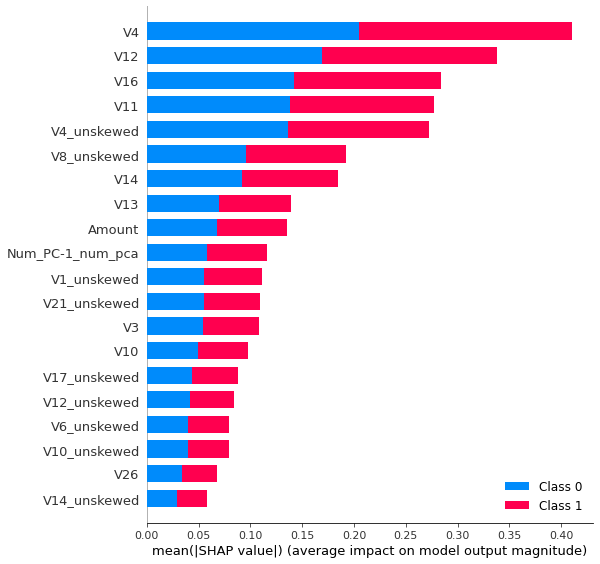

<Figure size 1152x864 with 0 Axes>

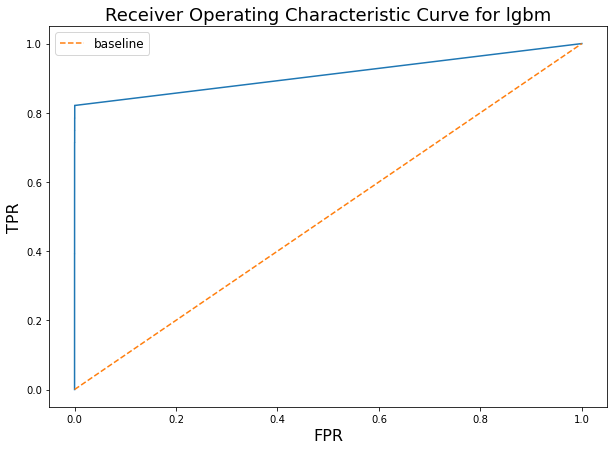

The ROC_AUC score is 0.9505994523109805


The Matthew correlation is 0.8230156362736666
-------------------
The accuracy is 0.9993666666666666
The recall is 0.9993666666666666
The macro F1 score is 0.9110563370721401
The micro F1 score is 0.9993666666666666
The weighted F1 score is 0.9993518955949118
              precision    recall  f1-score   support

         0.0       1.00      1.00      1.00     29944
         1.0       0.86      0.79      0.82        56

    accuracy                           1.00     30000
   macro avg       0.93      0.89      0.91     30000
weighted avg       1.00      1.00      1.00     30000



Started Execute test train split at 23:07:51.
Started Started column type detection and casting at 23:07:51.
Started Checking for duplicate columns at 23:07:51.
Started Reset dataframe index. at 23:07:51.
Started Select best features at 23:07:51.
Started Delete columns with high share of NULLs at 23:07:51.
Started Apply datetime transformation at 23:07:51.
Started Start TFIDF to PCA loop at 23:07:51.
Started Handle rare features at 23:07:51.
Started Remove cardinality at 23:07:51.
Started Holistic NULL filling at 23:07:51.
Started Binarize numeric columns + PCA binarized features at 23:07:51.
Started Onehot + PCA categorical features at 23:07:51.
Started Execute categorical encoding at 23:07:51.
Started Fill nulls at 23:07:51.
Started Handle outliers at 23:07:52.
Started Remove collinearity at 23:07:52.
Started Remove skewness at 23:07:52.
Started Execute clustering as a feature at 23:07:52.
Started Execute clustering as a feature at 23:08:06.
Started Execute clustering as a feature at

[I 2022-01-17 23:10:31,823] A new study created in memory with name: lgbm_focal


              precision    recall  f1-score   support

           0       1.00      1.00      1.00     49935
           1       0.98      0.63      0.77        65

    accuracy                           1.00     50000
   macro avg       0.99      0.82      0.88     50000
weighted avg       1.00      1.00      1.00     50000

Score achieved on holdout dataset is: 0.7844924170297901.
End iteration for algorithm lgbm at 1642457431.648669.
+++++++++++++++++++++++++++++++++++++++++++++++++++++++++++
Start iteration for algorithm lgbm_focal at 1642457431.802193.
Successfully loaded checkpoint last checkpoint.
Started Train LGBM with focal loss model at 23:10:31.


  0%|          | 0/50 [00:00<?, ?it/s]

[LightGBM] [Warning] Unknown parameter: gamma
[I 2022-01-17 23:10:33,168] Trial 0 finished with value: 1.401382861968297e-07 and parameters: {'learning_rate': 0.023688639503640783, 'num_leaves': 244, 'num_boost_round': 36627, 'alpha': 0.24810409748678125, 'gamma': 16}. Best is trial 0 with value: 1.401382861968297e-07.
[I 2022-01-17 23:10:33,438] Trial 1 finished with value: 1.041227552844004e-23 and parameters: {'learning_rate': 0.01432169828911152, 'num_leaves': 16, 'num_boost_round': 43323, 'alpha': 0.2537815508265665, 'gamma': 71}. Best is trial 0 with value: 1.401382861968297e-07.
[I 2022-01-17 23:10:34,534] Trial 2 finished with value: 3.1931901563162505e-09 and parameters: {'learning_rate': 0.010485387725194618, 'num_leaves': 249, 'num_boost_round': 41639, 'alpha': 0.0070689749506246055, 'gamma': 19}. Best is trial 0 with value: 1.401382861968297e-07.
[I 2022-01-17 23:10:34,809] Trial 3 finished with value: 9.33585045224308e-12 and parameters: {'learning_rate': 0.015254729458052

[I 2022-01-17 23:10:51,220] Trial 29 finished with value: -120.04898273953336 and parameters: {'learning_rate': 0.06856031665656741, 'num_leaves': 250, 'num_boost_round': 1671, 'alpha': 4.482658903801731, 'gamma': 22}. Best is trial 25 with value: 0.017098554821108978.
[I 2022-01-17 23:10:51,520] Trial 30 finished with value: -213.99802386779052 and parameters: {'learning_rate': 0.09209860780398567, 'num_leaves': 150, 'num_boost_round': 17615, 'alpha': 7.208150258433598, 'gamma': 6}. Best is trial 25 with value: 0.017098554821108978.
[I 2022-01-17 23:10:52,834] Trial 31 finished with value: 4.0957839637210665e-07 and parameters: {'learning_rate': 0.027843455975155147, 'num_leaves': 100, 'num_boost_round': 8102, 'alpha': 0.0017916310215592996, 'gamma': 9}. Best is trial 25 with value: 0.017098554821108978.
[I 2022-01-17 23:10:53,544] Trial 32 finished with value: 0.00034848873118358903 and parameters: {'learning_rate': 0.052454889151195366, 'num_leaves': 5, 'num_boost_round': 23853, 'al

[31]	train's focal_loss: 0.00583137	valid's focal_loss: 0.00588315
[32]	train's focal_loss: 0.00529389	valid's focal_loss: 0.00534833
[33]	train's focal_loss: 0.0048076	valid's focal_loss: 0.00486447
[34]	train's focal_loss: 0.00436735	valid's focal_loss: 0.00442621
[35]	train's focal_loss: 0.00396873	valid's focal_loss: 0.00403032
[36]	train's focal_loss: 0.00360769	valid's focal_loss: 0.00366966
[37]	train's focal_loss: 0.00328073	valid's focal_loss: 0.00334501
[38]	train's focal_loss: 0.00298434	valid's focal_loss: 0.00305134
[39]	train's focal_loss: 0.00271536	valid's focal_loss: 0.0027846
[40]	train's focal_loss: 0.00247166	valid's focal_loss: 0.00254182
[41]	train's focal_loss: 0.00225062	valid's focal_loss: 0.00232326
[42]	train's focal_loss: 0.00204954	valid's focal_loss: 0.00212454
[43]	train's focal_loss: 0.00186706	valid's focal_loss: 0.0019448
[44]	train's focal_loss: 0.00170187	valid's focal_loss: 0.0017826
[45]	train's focal_loss: 0.00155116	valid's focal_loss: 0.00163398

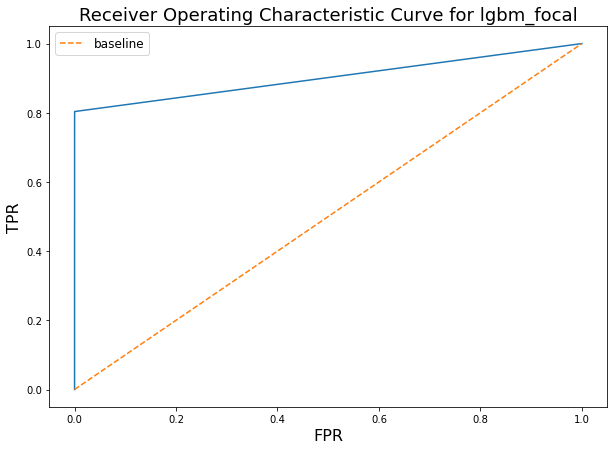

The ROC_AUC score is 0.9229034077897791


The Matthew correlation is 0.8588108098530433
-------------------
The accuracy is 0.9995
The recall is 0.9995
The macro F1 score is 0.928446209437945
The micro F1 score is 0.9995
The weighted F1 score is 0.9994833625511312
              precision    recall  f1-score   support

         0.0       1.00      1.00      1.00     29944
         1.0       0.92      0.80      0.86        56

    accuracy                           1.00     30000
   macro avg       0.96      0.90      0.93     30000
weighted avg       1.00      1.00      1.00     30000

Started Execute test train split at 23:11:07.
Started Started column type detection and casting at 23:11:07.
Started Checking for duplicate columns at 23:11:07.
Started Reset dataframe index. at 23:11:07.
Started Select best features at 23:11:07.
Started Delete columns with high share of NULLs at 23:11:07.
Started Apply datetime transformation at 23:11:07.
Started Start TFIDF to PCA loop at 23:11:07.
Started Handle rare features at 23:11:07.
Star

[I 2022-01-17 23:13:11,334] A new study created in memory with name: tabnet tuning


Start iteration for algorithm tabnet at 1642457591.2963943.
Successfully loaded checkpoint last checkpoint.
Started Train Tabnet classification model at 23:13:11.


  0%|          | 0/10 [00:00<?, ?it/s]


Early stopping occurred at epoch 46 with best_epoch = 16 and best_val_0_unsup_loss = 0.81054
Best weights from best epoch are automatically used!
Loading weights from unsupervised pretraining

Early stopping occurred at epoch 30 with best_epoch = 0 and best_val_0_matthews = 0.0
Best weights from best epoch are automatically used!
23:14:27
[0.776532452047298]

Early stopping occurred at epoch 44 with best_epoch = 14 and best_val_0_unsup_loss = 0.79253
Best weights from best epoch are automatically used!
Loading weights from unsupervised pretraining

Early stopping occurred at epoch 30 with best_epoch = 0 and best_val_0_matthews = 0.0
Best weights from best epoch are automatically used!
23:15:43
[0.776532452047298, 0.46310854057252576]

Early stopping occurred at epoch 44 with best_epoch = 14 and best_val_0_unsup_loss = 0.9067
Best weights from best epoch are automatically used!
Loading weights from unsupervised pretraining

Early stopping occurred at epoch 31 with best_epoch = 1 and be


Early stopping occurred at epoch 49 with best_epoch = 19 and best_val_0_matthews = 0.70675
Best weights from best epoch are automatically used!
23:33:13
[0.613395349476239, 0.4053876614055449, 0.5175756791354904, 0.6255831212928308, 0.5166157775942148, 0.10222345428779189, 0.592557132225388, 0.6311385189450128]
Stop training because you reached max_epochs = 163 with best_epoch = 154 and best_val_0_unsup_loss = 0.66322
Best weights from best epoch are automatically used!
Loading weights from unsupervised pretraining

Early stopping occurred at epoch 42 with best_epoch = 12 and best_val_0_matthews = 0.70675
Best weights from best epoch are automatically used!
23:34:12
[0.613395349476239, 0.4053876614055449, 0.5175756791354904, 0.6255831212928308, 0.5166157775942148, 0.10222345428779189, 0.592557132225388, 0.6311385189450128, 0.56057920773211]
Stop training because you reached max_epochs = 163 with best_epoch = 159 and best_val_0_unsup_loss = 0.75195
Best weights from best epoch are auto


Early stopping occurred at epoch 30 with best_epoch = 0 and best_val_0_matthews = 0.04955
Best weights from best epoch are automatically used!
23:46:17
[0.5431811904301433, 0.5508627333634577, 0.6121386570537773, 0.15706876795827954]

Early stopping occurred at epoch 45 with best_epoch = 15 and best_val_0_unsup_loss = 0.75164
Best weights from best epoch are automatically used!
Loading weights from unsupervised pretraining

Early stopping occurred at epoch 37 with best_epoch = 7 and best_val_0_matthews = 0.0
Best weights from best epoch are automatically used!
23:47:00
[0.5431811904301433, 0.5508627333634577, 0.6121386570537773, 0.15706876795827954, 0.56057920773211]

Early stopping occurred at epoch 60 with best_epoch = 30 and best_val_0_unsup_loss = 0.77608
Best weights from best epoch are automatically used!
Loading weights from unsupervised pretraining

Early stopping occurred at epoch 30 with best_epoch = 0 and best_val_0_matthews = 0.0
Best weights from best epoch are automatica


Early stopping occurred at epoch 94 with best_epoch = 64 and best_val_0_unsup_loss = 0.76664
Best weights from best epoch are automatically used!
Loading weights from unsupervised pretraining

Early stopping occurred at epoch 30 with best_epoch = 0 and best_val_0_matthews = 0.0
Best weights from best epoch are automatically used!
00:04:31
[0.5910810390164107]

Early stopping occurred at epoch 73 with best_epoch = 43 and best_val_0_unsup_loss = 0.78779
Best weights from best epoch are automatically used!
Loading weights from unsupervised pretraining

Early stopping occurred at epoch 30 with best_epoch = 0 and best_val_0_matthews = 0.0
Best weights from best epoch are automatically used!
00:05:10
[0.5910810390164107, 0.1004608055080036]

Early stopping occurred at epoch 119 with best_epoch = 89 and best_val_0_unsup_loss = 0.66245
Best weights from best epoch are automatically used!
Loading weights from unsupervised pretraining

Early stopping occurred at epoch 32 with best_epoch = 2 and

00:19:06
[0.5958153873798807, 0.494683288091283, 0.5661831350142488, 0.5101077371777664, 0.5081684528313279, 0.14794371637186673, 0.5402694714346047, 0.667308713738026]

Early stopping occurred at epoch 103 with best_epoch = 73 and best_val_0_unsup_loss = 0.80573
Best weights from best epoch are automatically used!
Loading weights from unsupervised pretraining

Early stopping occurred at epoch 37 with best_epoch = 7 and best_val_0_matthews = 0.70675
Best weights from best epoch are automatically used!
00:19:50
[0.5958153873798807, 0.494683288091283, 0.5661831350142488, 0.5101077371777664, 0.5081684528313279, 0.14794371637186673, 0.5402694714346047, 0.667308713738026, 0.48825340460761807]

Early stopping occurred at epoch 145 with best_epoch = 115 and best_val_0_unsup_loss = 0.84242
Best weights from best epoch are automatically used!
Loading weights from unsupervised pretraining

Early stopping occurred at epoch 59 with best_epoch = 29 and best_val_0_matthews = 0.49925
Best weights fro

00:37:02
[0.7449732555876633, 0.7536114740913512, 0.7877577951117761, 0.6568080530267464]

Early stopping occurred at epoch 99 with best_epoch = 69 and best_val_0_unsup_loss = 0.60823
Best weights from best epoch are automatically used!
Loading weights from unsupervised pretraining

Early stopping occurred at epoch 30 with best_epoch = 0 and best_val_0_matthews = 0.0
Best weights from best epoch are automatically used!
00:37:40
[0.7449732555876633, 0.7536114740913512, 0.7877577951117761, 0.6568080530267464, 0.30270373700982267]

Early stopping occurred at epoch 141 with best_epoch = 111 and best_val_0_unsup_loss = 0.61003
Best weights from best epoch are automatically used!
Loading weights from unsupervised pretraining

Early stopping occurred at epoch 30 with best_epoch = 0 and best_val_0_matthews = 0.0
Best weights from best epoch are automatically used!
00:38:31
[0.7449732555876633, 0.7536114740913512, 0.7877577951117761, 0.6568080530267464, 0.30270373700982267, 0.7012951599580302]


Device used : cuda
epoch 0  | loss: 1.5733  | val_0_unsup_loss: 0.94806 |  0:00:09s
epoch 1  | loss: 1.00951 | val_0_unsup_loss: 0.9409  |  0:00:19s
epoch 2  | loss: 0.98496 | val_0_unsup_loss: 1.05424 |  0:00:28s
epoch 3  | loss: 0.96431 | val_0_unsup_loss: 1.60475 |  0:00:37s
epoch 4  | loss: 0.94651 | val_0_unsup_loss: 3.8872  |  0:00:46s
epoch 5  | loss: 0.94268 | val_0_unsup_loss: 2.19518 |  0:00:55s
epoch 6  | loss: 0.93458 | val_0_unsup_loss: 3.23106 |  0:01:05s
epoch 7  | loss: 0.92734 | val_0_unsup_loss: 4.48011 |  0:01:14s
epoch 8  | loss: 0.92356 | val_0_unsup_loss: 3.96366 |  0:01:23s
epoch 9  | loss: 0.92336 | val_0_unsup_loss: 3.37509 |  0:01:32s
epoch 10 | loss: 0.91835 | val_0_unsup_loss: 4.29963 |  0:01:42s
epoch 11 | loss: 0.91326 | val_0_unsup_loss: 5.12546 |  0:01:51s
epoch 12 | loss: 0.91451 | val_0_unsup_loss: 3.69998 |  0:02:00s
epoch 13 | loss: 0.90976 | val_0_unsup_loss: 4.02735 |  0:02:10s
epoch 14 | loss: 0.91025 | val_0_unsup_loss: 3.40593 |  0:02:19s
epoch 

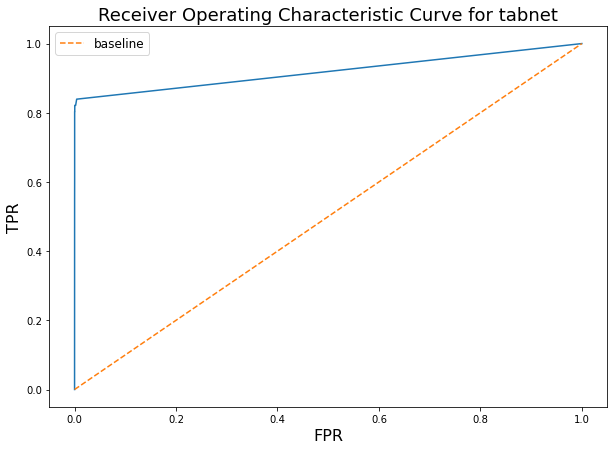

The ROC_AUC score is 0.9502207692454487


The Matthew correlation is 0.850158180440477
-------------------
The accuracy is 0.9994666666666666
The recall is 0.9994666666666666
The macro F1 score is 0.9243947325810189
The micro F1 score is 0.9994666666666666
The weighted F1 score is 0.9994515990409052
              precision    recall  f1-score   support

         0.0       1.00      1.00      1.00     29944
         1.0       0.90      0.80      0.85        56

    accuracy                           1.00     30000
   macro avg       0.95      0.90      0.92     30000
weighted avg       1.00      1.00      1.00     30000



Started Execute test train split at 01:04:00.
Started Started column type detection and casting at 01:04:00.
Started Checking for duplicate columns at 01:04:00.
Started Reset dataframe index. at 01:04:00.
Started Select best features at 01:04:00.
Started Delete columns with high share of NULLs at 01:04:00.
Started Apply datetime transformation at 01:04:00.
Started Start TFIDF to PCA loop at 01:04:00.
Started Handle rare features at 01:04:00.
Started Remove cardinality at 01:04:00.
Started Holistic NULL filling at 01:04:00.
Started Binarize numeric columns + PCA binarized features at 01:04:00.
Started Onehot + PCA categorical features at 01:04:01.
Started Execute categorical encoding at 01:04:01.
Started Fill nulls at 01:04:01.
Started Handle outliers at 01:04:01.
Started Remove collinearity at 01:04:02.
Started Remove skewness at 01:04:02.
Started Execute clustering as a feature at 01:04:02.
Started Execute clustering as a feature at 01:04:15.
Started Execute clustering as a feature at

              precision    recall  f1-score   support

           0       1.00      1.00      1.00     49935
           1       0.89      0.74      0.81        65

    accuracy                           1.00     50000
   macro avg       0.94      0.87      0.90     50000
weighted avg       1.00      1.00      1.00     50000

Score achieved on holdout dataset is: 0.8099704583590523.
End iteration for algorithm tabnet at 1642464365.7801023.
+++++++++++++++++++++++++++++++++++++++++++++++++++++++++++
Start iteration for algorithm vowpal_wabbit at 1642464365.930627.
Successfully loaded checkpoint last checkpoint.
Started Train Vowpal Wabbit model at 01:06:05.
Started Predict with Vowpal Wabbit at 01:06:12.
01:06:16


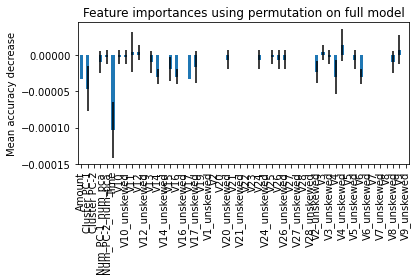

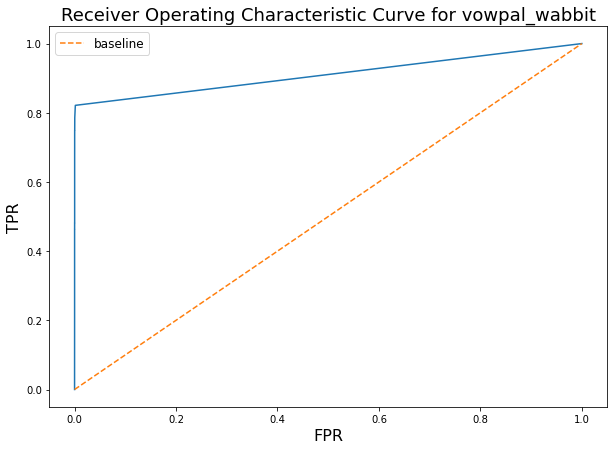

The ROC_AUC score is 0.9628813070111828


The Matthew correlation is 0.8014401446737648
-------------------
The accuracy is 0.9993
The recall is 0.9993
The macro F1 score is 0.899824693213123
The micro F1 score is 0.9993
The weighted F1 score is 0.9992767075715836
              precision    recall  f1-score   support

         0.0       1.00      1.00      1.00     29944
         1.0       0.86      0.75      0.80        56

    accuracy                           1.00     30000
   macro avg       0.93      0.87      0.90     30000
weighted avg       1.00      1.00      1.00     30000



Started Execute test train split at 01:08:19.
Started Started column type detection and casting at 01:08:19.
Started Checking for duplicate columns at 01:08:19.
Started Reset dataframe index. at 01:08:19.
Started Select best features at 01:08:19.
Started Delete columns with high share of NULLs at 01:08:19.
Started Apply datetime transformation at 01:08:19.
Started Start TFIDF to PCA loop at 01:08:19.
Started Handle rare features at 01:08:19.
Started Remove cardinality at 01:08:19.
Started Holistic NULL filling at 01:08:19.
Started Binarize numeric columns + PCA binarized features at 01:08:19.
Started Onehot + PCA categorical features at 01:08:20.
Started Execute categorical encoding at 01:08:20.
Started Fill nulls at 01:08:20.
Started Handle outliers at 01:08:20.
Started Remove collinearity at 01:08:21.
Started Remove skewness at 01:08:21.
Started Execute clustering as a feature at 01:08:21.
Started Execute clustering as a feature at 01:08:34.
Started Execute clustering as a feature at

              precision    recall  f1-score   support

           0       1.00      1.00      1.00     49935
           1       0.93      0.57      0.70        65

    accuracy                           1.00     50000
   macro avg       0.96      0.78      0.85     50000
weighted avg       1.00      1.00      1.00     50000

Score achieved on holdout dataset is: 0.7253715589371341.
End iteration for algorithm vowpal_wabbit at 1642464653.1382637.
+++++++++++++++++++++++++++++++++++++++++++++++++++++++++++
Start iteration for algorithm logistic_regression at 1642464653.293986.
Successfully loaded checkpoint last checkpoint.
Started Train logistic regression model at 01:10:53.
Started Predict with Logistic Regression at 01:10:54.
01:10:54


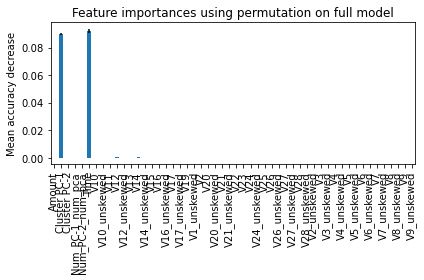

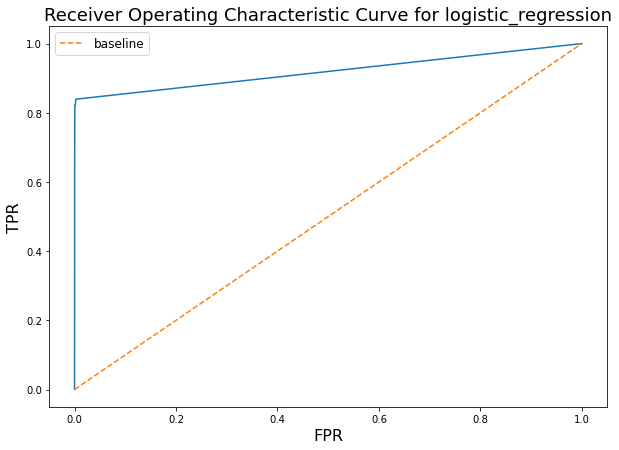

The ROC_AUC score is 0.9680182769741613


The Matthew correlation is 0.793176686370561
-------------------
The accuracy is 0.9992
The recall is 0.9992
The macro F1 score is 0.8963513367222606
The micro F1 score is 0.9992
The weighted F1 score is 0.9992137663851262
              precision    recall  f1-score   support

         0.0       1.00      1.00      1.00     29944
         1.0       0.77      0.82      0.79        56

    accuracy                           1.00     30000
   macro avg       0.88      0.91      0.90     30000
weighted avg       1.00      1.00      1.00     30000



Started Execute test train split at 01:10:56.
Started Started column type detection and casting at 01:10:56.
Started Checking for duplicate columns at 01:10:56.
Started Reset dataframe index. at 01:10:56.
Started Select best features at 01:10:56.
Started Delete columns with high share of NULLs at 01:10:56.
Started Apply datetime transformation at 01:10:56.
Started Start TFIDF to PCA loop at 01:10:56.
Started Handle rare features at 01:10:56.
Started Remove cardinality at 01:10:56.
Started Holistic NULL filling at 01:10:56.
Started Binarize numeric columns + PCA binarized features at 01:10:56.
Started Onehot + PCA categorical features at 01:10:57.
Started Execute categorical encoding at 01:10:57.
Started Fill nulls at 01:10:57.
Started Handle outliers at 01:10:57.
Started Remove collinearity at 01:10:58.
Started Remove skewness at 01:10:58.
Started Execute clustering as a feature at 01:10:58.
Started Execute clustering as a feature at 01:11:11.
Started Execute clustering as a feature at

              precision    recall  f1-score   support

           0       1.00      1.00      1.00     49935
           1       0.64      0.72      0.68        65

    accuracy                           1.00     50000
   macro avg       0.82      0.86      0.84     50000
weighted avg       1.00      1.00      1.00     50000

Score achieved on holdout dataset is: 0.6772352923882434.
End iteration for algorithm logistic_regression at 1642464783.8367403.
+++++++++++++++++++++++++++++++++++++++++++++++++++++++++++


[I 2022-01-18 01:13:04,004] A new study created in memory with name: sgd


Start iteration for algorithm sgd at 1642464783.9825835.
Successfully loaded checkpoint last checkpoint.
Started Train SGD classifier model at 01:13:03.


  0%|          | 0/100 [00:00<?, ?it/s]

[I 2022-01-18 01:13:04,183] Trial 0 finished with value: -0.0036810994577003457 and parameters: {'loss': 'log', 'alpha': 24.658329458549105, 'l1_ratio': 0.06250999323228593, 'epsilon': 0.0024348773534554596, 'max_iter': 4688, 'tol': 1.7073967431528103e-05, 'normalize': True, 'power_t': 0.39663473785260006}. Best is trial 0 with value: -0.0036810994577003457.
[I 2022-01-18 01:13:04,505] Trial 1 finished with value: -0.0015426889517515898 and parameters: {'loss': 'log', 'alpha': 98.77700294007911, 'l1_ratio': 0.004335189736337855, 'epsilon': 0.002820996133514492, 'max_iter': 5510, 'tol': 0.00016480446427978953, 'normalize': True, 'power_t': 0.17624515035546043}. Best is trial 1 with value: -0.0015426889517515898.
[I 2022-01-18 01:13:04,807] Trial 2 finished with value: -0.00269840770076936 and parameters: {'loss': 'modified_huber', 'alpha': 0.05660670699258887, 'l1_ratio': 0.012562313237138797, 'epsilon': 0.013481575603601416, 'max_iter': 23558, 'tol': 6.290644294586152e-05, 'normalize':

[I 2022-01-18 01:13:11,557] Trial 23 finished with value: 0.0 and parameters: {'loss': 'log', 'alpha': 118.84376924786243, 'l1_ratio': 0.17638810945358196, 'epsilon': 0.012565422625326034, 'max_iter': 29503, 'tol': 2.904592428778375e-05, 'normalize': True, 'power_t': 0.20213362907461707}. Best is trial 16 with value: 0.000167235096084408.
[I 2022-01-18 01:13:11,897] Trial 24 finished with value: 0.0 and parameters: {'loss': 'log', 'alpha': 620.6165368071711, 'l1_ratio': 0.1462791972812699, 'epsilon': 0.045539661346751616, 'max_iter': 19266, 'tol': 1.8621809180092208e-05, 'normalize': True, 'power_t': 0.5854642066954672}. Best is trial 16 with value: 0.000167235096084408.
[I 2022-01-18 01:13:12,235] Trial 25 finished with value: 0.0 and parameters: {'loss': 'log', 'alpha': 880.5801640101535, 'l1_ratio': 0.35352475241257897, 'epsilon': 0.06105616596432508, 'max_iter': 16343, 'tol': 2.6020423380688792e-05, 'normalize': True, 'power_t': 0.6650161174570065}. Best is trial 16 with value: 0.0

[I 2022-01-18 01:13:19,109] Trial 46 finished with value: -0.005305837038569306 and parameters: {'loss': 'modified_huber', 'alpha': 86.47574683800022, 'l1_ratio': 0.11717069838604893, 'epsilon': 0.08696944598714582, 'max_iter': 8202, 'tol': 0.0026206245702051646, 'normalize': True, 'power_t': 0.20924049932911673}. Best is trial 41 with value: 0.00044591500724620143.
[I 2022-01-18 01:13:19,436] Trial 47 finished with value: -0.004925463282874394 and parameters: {'loss': 'log', 'alpha': 1.2992787311977625, 'l1_ratio': 0.5412582329613124, 'epsilon': 0.010498125059898979, 'max_iter': 20512, 'tol': 1.0533383555746792e-05, 'normalize': True, 'power_t': 0.44636831571773916}. Best is trial 41 with value: 0.00044591500724620143.
[I 2022-01-18 01:13:19,773] Trial 48 finished with value: -0.001361603528634903 and parameters: {'loss': 'modified_huber', 'alpha': 44.989178449137476, 'l1_ratio': 0.4672096631122599, 'epsilon': 0.05158876642360513, 'max_iter': 20025, 'tol': 0.0013873401378500657, 'norm

[I 2022-01-18 01:13:26,344] Trial 68 finished with value: -0.00120152602281497 and parameters: {'loss': 'log', 'alpha': 0.909989605439603, 'l1_ratio': 0.29593453313645396, 'epsilon': 0.09233419664337711, 'max_iter': 14215, 'tol': 7.186845276406208e-05, 'normalize': True, 'power_t': 0.6711658923378987}. Best is trial 56 with value: 0.0017454140594894592.
[I 2022-01-18 01:13:26,672] Trial 69 finished with value: 0.0 and parameters: {'loss': 'log', 'alpha': 156.95016592955344, 'l1_ratio': 0.15653147159895256, 'epsilon': 0.0252274468514326, 'max_iter': 21279, 'tol': 0.0005792876716580946, 'normalize': True, 'power_t': 0.5734477310380489}. Best is trial 56 with value: 0.0017454140594894592.
[I 2022-01-18 01:13:27,001] Trial 70 finished with value: -0.005920004694771755 and parameters: {'loss': 'modified_huber', 'alpha': 499.88637647256485, 'l1_ratio': 0.003586644745099828, 'epsilon': 0.010217465477991136, 'max_iter': 27028, 'tol': 0.06647826153888824, 'normalize': True, 'power_t': 0.2176596

[I 2022-01-18 01:13:33,858] Trial 91 finished with value: 0.0 and parameters: {'loss': 'log', 'alpha': 270.42779367972247, 'l1_ratio': 0.1711468847557402, 'epsilon': 0.04634787237820301, 'max_iter': 2783, 'tol': 0.0014910030547511143, 'normalize': False, 'power_t': 0.1075736847059658}. Best is trial 56 with value: 0.0017454140594894592.
[I 2022-01-18 01:13:34,191] Trial 92 finished with value: 0.0 and parameters: {'loss': 'log', 'alpha': 261.3522521408157, 'l1_ratio': 0.38112950413063534, 'epsilon': 0.011578888268943762, 'max_iter': 11579, 'tol': 0.0026617301200948726, 'normalize': False, 'power_t': 0.6541091537679398}. Best is trial 56 with value: 0.0017454140594894592.
[I 2022-01-18 01:13:34,523] Trial 93 finished with value: 0.0 and parameters: {'loss': 'modified_huber', 'alpha': 486.75390173015984, 'l1_ratio': 0.19653794549901543, 'epsilon': 0.18207985782168135, 'max_iter': 9798, 'tol': 0.0002968626718623687, 'normalize': False, 'power_t': 0.13516206393979804}. Best is trial 56 wit

Started Predict with SGD classifier at 01:13:37.
01:13:37


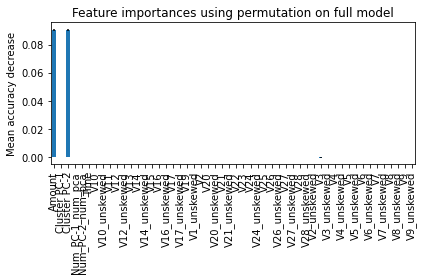

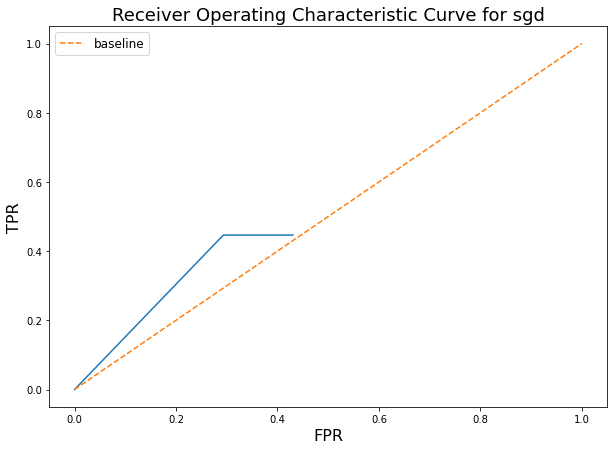

The ROC_AUC score is 0.5387452411167513


The Matthew correlation is 0.014508788503407848
-------------------
The accuracy is 0.7061666666666667
The recall is 0.7061666666666667
The macro F1 score is 0.4166266693601771
The micro F1 score is 0.7061666666666667
The weighted F1 score is 0.8260788311532389
              precision    recall  f1-score   support

         0.0       1.00      0.71      0.83     29944
         1.0       0.00      0.45      0.01        56

    accuracy                           0.71     30000
   macro avg       0.50      0.58      0.42     30000
weighted avg       1.00      0.71      0.83     30000



Started Execute test train split at 01:13:40.
Started Started column type detection and casting at 01:13:40.
Started Checking for duplicate columns at 01:13:40.
Started Reset dataframe index. at 01:13:40.
Started Select best features at 01:13:40.
Started Delete columns with high share of NULLs at 01:13:40.
Started Apply datetime transformation at 01:13:40.
Started Start TFIDF to PCA loop at 01:13:40.
Started Handle rare features at 01:13:40.
Started Remove cardinality at 01:13:40.
Started Holistic NULL filling at 01:13:40.
Started Binarize numeric columns + PCA binarized features at 01:13:40.
Started Onehot + PCA categorical features at 01:13:41.
Started Execute categorical encoding at 01:13:41.
Started Fill nulls at 01:13:41.
Started Handle outliers at 01:13:41.
Started Remove collinearity at 01:13:42.
Started Remove skewness at 01:13:42.
Started Execute clustering as a feature at 01:13:42.
Started Execute clustering as a feature at 01:13:55.
Started Execute clustering as a feature at

              precision    recall  f1-score   support

           0       1.00      0.76      0.86     49935
           1       0.00      0.25      0.00        65

    accuracy                           0.76     50000
   macro avg       0.50      0.50      0.43     50000
weighted avg       1.00      0.76      0.86     50000

Score achieved on holdout dataset is: 0.00033297340559772085.
End iteration for algorithm sgd at 1642464971.9055982.
+++++++++++++++++++++++++++++++++++++++++++++++++++++++++++
Start iteration for algorithm quadratic_discriminant_analysis at 1642464972.0528553.
Successfully loaded checkpoint last checkpoint.
Started Train Quadratic Discriminant model at 01:16:12.
Started Predict with Quadratic Discriminant Analysis at 01:16:12.
01:16:12


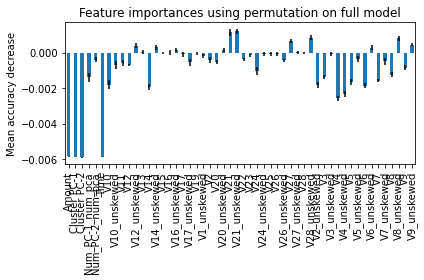

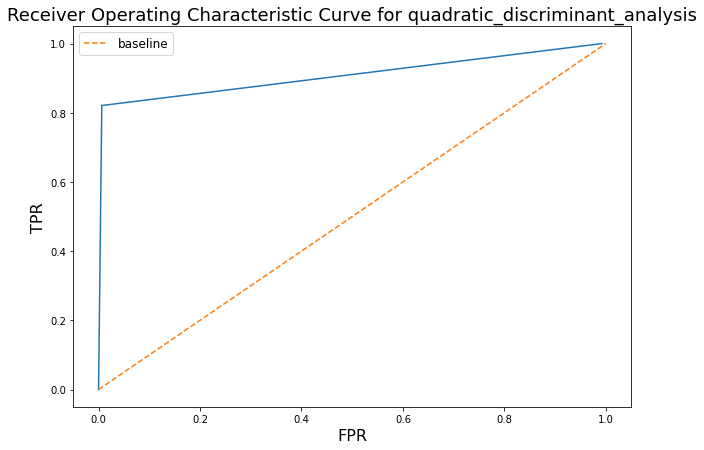

The ROC_AUC score is 0.9362303681157208


The Matthew correlation is 0.3973933964695407
-------------------
The accuracy is 0.9933
The recall is 0.9933
The macro F1 score is 0.6553133673077361
The micro F1 score is 0.9933
The weighted F1 score is 0.9953592984992526
              precision    recall  f1-score   support

         0.0       1.00      0.99      1.00     29944
         1.0       0.19      0.82      0.31        56

    accuracy                           0.99     30000
   macro avg       0.60      0.91      0.66     30000
weighted avg       1.00      0.99      1.00     30000



Started Execute test train split at 01:16:19.
Started Started column type detection and casting at 01:16:19.
Started Checking for duplicate columns at 01:16:19.
Started Reset dataframe index. at 01:16:19.
Started Select best features at 01:16:19.
Started Delete columns with high share of NULLs at 01:16:19.
Started Apply datetime transformation at 01:16:19.
Started Start TFIDF to PCA loop at 01:16:19.
Started Handle rare features at 01:16:19.
Started Remove cardinality at 01:16:19.
Started Holistic NULL filling at 01:16:19.
Started Binarize numeric columns + PCA binarized features at 01:16:19.
Started Onehot + PCA categorical features at 01:16:20.
Started Execute categorical encoding at 01:16:20.
Started Fill nulls at 01:16:20.
Started Handle outliers at 01:16:20.
Started Remove collinearity at 01:16:21.
Started Remove skewness at 01:16:21.
Started Execute clustering as a feature at 01:16:21.
Started Execute clustering as a feature at 01:16:34.
Started Execute clustering as a feature at

              precision    recall  f1-score   support

           0       1.00      1.00      1.00     49935
           1       0.25      0.78      0.38        65

    accuracy                           1.00     50000
   macro avg       0.63      0.89      0.69     50000
weighted avg       1.00      1.00      1.00     50000

Score achieved on holdout dataset is: 0.44397383071219176.
End iteration for algorithm quadratic_discriminant_analysis at 1642465102.5018268.
+++++++++++++++++++++++++++++++++++++++++++++++++++++++++++


[I 2022-01-18 01:18:22,664] A new study created in memory with name: svm


Start iteration for algorithm svm at 1642465102.6422913.
Successfully loaded checkpoint last checkpoint.
Started Train Support Vector Machine classifier model at 01:18:22.


  0%|          | 0/25 [00:00<?, ?it/s]

[I 2022-01-18 01:20:19,801] Trial 0 finished with value: 0.005620522254039395 and parameters: {'C': 8.616644415858344, 'max_iter': 9508, 'tol': 0.008471801418819975, 'gamma': 'scale', 'class_weight': 'balanced'}. Best is trial 0 with value: 0.005620522254039395.
[I 2022-01-18 01:22:42,445] Trial 1 finished with value: 0.0 and parameters: {'C': 361.6125071428695, 'max_iter': 6012, 'tol': 0.006796578090758156, 'gamma': 'auto', 'class_weight': 'balanced'}. Best is trial 0 with value: 0.005620522254039395.
[I 2022-01-18 01:22:43,837] Trial 2 finished with value: 0.0 and parameters: {'C': 1.991497084946204, 'max_iter': 1835, 'tol': 0.00016480446427978953, 'gamma': 'scale', 'class_weight': None}. Best is trial 0 with value: 0.005620522254039395.
[I 2022-01-18 01:23:52,684] Trial 3 finished with value: 0.0 and parameters: {'C': 1.4435885294521449, 'max_iter': 2922, 'tol': 0.0002920433847181409, 'gamma': 'auto', 'class_weight': None}. Best is trial 0 with value: 0.005620522254039395.
[I 2022-0

Started Predict with Support Vector Machine classifier at 01:56:16.
01:56:24


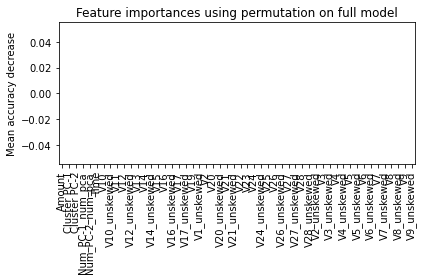

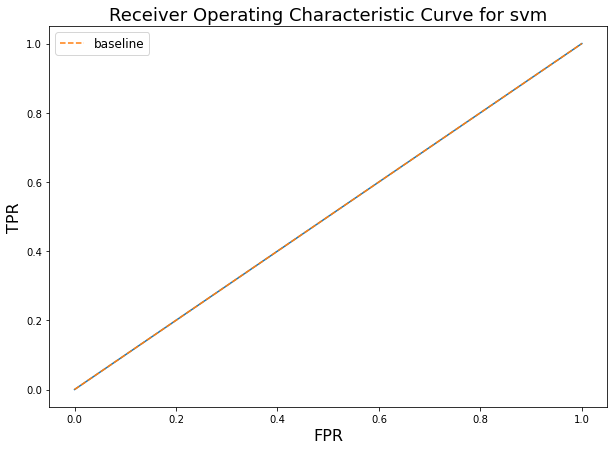

The ROC_AUC score is 0.4899484991030877


The Matthew correlation is 0.0
-------------------
The accuracy is 0.0018666666666666666
The recall is 0.0018666666666666666
The macro F1 score is 0.001863188714399787
The micro F1 score is 0.0018666666666666666
The weighted F1 score is 6.955904533759204e-06
              precision    recall  f1-score   support

         0.0       0.00      0.00      0.00     29944
         1.0       0.00      1.00      0.00        56

    accuracy                           0.00     30000
   macro avg       0.00      0.50      0.00     30000
weighted avg       0.00      0.00      0.00     30000



Started Execute test train split at 02:02:39.
Started Started column type detection and casting at 02:02:39.
Started Checking for duplicate columns at 02:02:39.
Started Reset dataframe index. at 02:02:39.
Started Select best features at 02:02:39.
Started Delete columns with high share of NULLs at 02:02:39.
Started Apply datetime transformation at 02:02:39.
Started Start TFIDF to PCA loop at 02:02:39.
Started Handle rare features at 02:02:39.
Started Remove cardinality at 02:02:39.
Started Holistic NULL filling at 02:02:39.
Started Binarize numeric columns + PCA binarized features at 02:02:39.
Started Onehot + PCA categorical features at 02:02:40.
Started Execute categorical encoding at 02:02:40.
Started Fill nulls at 02:02:40.
Started Handle outliers at 02:02:40.
Started Remove collinearity at 02:02:41.
Started Remove skewness at 02:02:41.
Started Execute clustering as a feature at 02:02:41.
Started Execute clustering as a feature at 02:02:54.
Started Execute clustering as a feature at

              precision    recall  f1-score   support

           0       0.00      0.00      0.00     49935
           1       0.00      1.00      0.00        65

    accuracy                           0.00     50000
   macro avg       0.00      0.50      0.00     50000
weighted avg       0.00      0.00      0.00     50000

Score achieved on holdout dataset is: 0.0.
End iteration for algorithm svm at 1642467928.9746025.
+++++++++++++++++++++++++++++++++++++++++++++++++++++++++++
+++++++++++++++++++++++++++++++++++++++++++++++++++++++++++
Start iteration for checkpoint cardinality_remover at 1642467929.1133401.
Started Holistic NULL filling at 02:05:29.
Started Binarize numeric columns + PCA binarized features at 02:05:29.
Started Onehot + PCA categorical features at 02:05:30.
Started Execute categorical encoding at 02:05:31.
Started Fill nulls at 02:05:31.
Started Handle outliers at 02:05:31.
Started Handle outliers at 02:05:34.
Training data size reduced from 70000 to 70000.
Started 

[I 2022-01-18 02:05:39,369] A new study created in memory with name: automated_feature_transformation


Started Automated feature transformation at 02:05:39.


  0%|          | 0/20 [00:00<?, ?it/s]

[I 2022-01-18 02:05:42,689] Trial 0 finished with value: 25.919076812217483 and parameters: {'transformer': 'maxabs', 'n_quantiles': 605.1038616257767}. Best is trial 0 with value: 25.919076812217483.
[I 2022-01-18 02:05:46,278] Trial 1 finished with value: 20.95620110057966 and parameters: {'transformer': 'robust', 'n_quantiles': 529.5088673159155}. Best is trial 0 with value: 25.919076812217483.
[I 2022-01-18 02:05:49,524] Trial 2 finished with value: 25.637655749864862 and parameters: {'transformer': 'no_scaling', 'n_quantiles': 207.67704433677613}. Best is trial 0 with value: 25.919076812217483.
[I 2022-01-18 02:05:52,764] Trial 3 finished with value: 23.945585672243038 and parameters: {'transformer': 'no_scaling', 'n_quantiles': 810.3133746352966}. Best is trial 0 with value: 25.919076812217483.
[I 2022-01-18 02:05:56,019] Trial 4 finished with value: 25.351771592153728 and parameters: {'transformer': 'no_scaling', 'n_quantiles': 266.1921817840167}. Best is trial 0 with value: 25.

Started Execute clustering as a feature at 02:06:50.


In [ ]:
results = timetravel.timewalk_auto_exploration(class_instance=automl_pipeline,
                                   holdout_df=holdout_df,
                                   holdout_target=hold_df_target,
                                   is_imbalanced=True,
                                   algs_to_test=None,
                                   experiment_name="timewalk_creditcard_fraud.pkl")

In [2]:
results = pd.read_pickle("timewalk_creditcard_fraud.pkl")

In [3]:
results.sort_values(by=["Matthews"], ascending=[False]).head(30).drop_duplicates(subset=['Trial number', 'Algorithm', 'Matthews'], keep='last')

,Trial number,Algorithm,Matthews,Accuracy,Recall,Preprocessing applied,ML model runtime in seconds,experiment_comment,preprocessing_runtime_sec,Total runtime
2,3,lgbm_focal,0.841268,0.99962,0.99962,"{'automatic_type_detection_casting': True, 'remove_duplicate_column_names': True, 'reset_dataframe_index': True, 'fill_infinite_values': True, 'early_numeric_only_feature_selection': True, 'delete_high_null_cols': True, 'data_binning': False, 'regex_clean_text_data': False, 'handle_target_skewness': False, 'datetime_converter': True, 'pos_tagging_pca': False, 'append_text_sentiment_score': False, 'tfidf_vectorizer_to_pca': True, 'tfidf_vectorizer': False, 'rare_feature_processing': True, 'cardinality_remover': True, 'categorical_column_embeddings': False, 'holistic_null_filling': True, 'numeric_binarizer_pca': True, 'onehot_pca': True, 'category_encoding': True, 'fill_nulls_static': True, 'outlier_care': True, 'delete_outliers': False, 'remove_collinearity': True, 'skewness_removal': True, 'automated_feature_transformation': False, 'random_trees_embedding': False, 'clustering_as_a_feature_dbscan': True, 'clustering_as_a_feature_kmeans_loop': True, 'clustering_as_a_feature_gaussian_mixture_loop': True, 'pca_clustering_results': True, 'svm_outlier_detection_loop': False, 'autotuned_clustering': True, 'reduce_memory_footprint': False, 'scale_data': True, 'smote': False, 'automated_feature_selection': True, 'bruteforce_random_feature_selection': False, 'autoencoder_based_oversampling': False, 'synthetic_data_augmentation': False, 'final_pca_dimensionality_reduction': False, 'final_kernel_pca_dimensionality_reduction': False, 'delete_low_variance_features': True, 'shap_based_feature_selection': True, 'delete_unpredictable_training_rows': False, 'sort_columns_alphabetically': True}",200.511471,Experiment run at 2022-01-17 13:36:44,81.920764,282.432235
29,30,lgbm_focal,0.819305,0.99956,0.99956,"{'automatic_type_detection_casting': True, 'remove_duplicate_column_names': True, 'reset_dataframe_index': True, 'fill_infinite_values': True, 'early_numeric_only_feature_selection': True, 'delete_high_null_cols': True, 'data_binning': False, 'regex_clean_text_data': False, 'handle_target_skewness': False, 'datetime_converter': True, 'pos_tagging_pca': False, 'append_text_sentiment_score': False, 'tfidf_vectorizer_to_pca': True, 'tfidf_vectorizer': False, 'rare_feature_processing': True, 'cardinality_remover': True, 'categorical_column_embeddings': False, 'holistic_null_filling': True, 'numeric_binarizer_pca': True, 'onehot_pca': True, 'category_encoding': True, 'fill_nulls_static': True, 'outlier_care': True, 'delete_outliers': False, 'remove_collinearity': True, 'skewness_removal': True, 'automated_feature_transformation': False, 'random_trees_embedding': False, 'clustering_as_a_feature_dbscan': True, 'clustering_as_a_feature_kmeans_loop': True, 'clustering_as_a_feature_gaussian_mixture_loop': True, 'pca_clustering_results': True, 'svm_outlier_detection_loop': False, 'autotuned_clustering': True, 'reduce_memory_footprint': False, 'scale_data': True, 'smote': False, 'automated_feature_selection': True, 'bruteforce_random_feature_selection': False, 'autoencoder_based_oversampling': False, 'synthetic_data_augmentation': False, 'final_pca_dimensionality_reduction': False, 'final_kernel_pca_dimensionality_reduction': False, 'delete_low_variance_features': True, 'shap_based_feature_selection': True, 'delete_unpredictable_training_rows': True, 'sort_columns_alphabetically': True}",159.358278,Experiment run at 2022-01-17 13:36:44,81.920764,241.279042
18,19,ridge,0.817590,0.99956,0.99956,"{'automatic_type_detection_casting': True, 'remove_duplicate_column_names': True, 'reset_dataframe_index': True, 'fill_infinite_values': True, 'early_numeric_only_feature_selection': True, 'delete_high_null_cols': True, 'data_binning': False, 'regex_clean_text_data': False, 'handle_target_skewness': False, 'datetime_converter': True, 'pos_tagging_pca': False, 'append_tex

# Results overview
Timewalk returns a result dataframe. Here we can sort the results by Matthews correlation to see our best results.

During our trial we ran out of memory. As Timewalk is still in an early stage we still try to aim for optimization. Timewalk tries to clean memory, but sometimes it does not clean properly., However we had a different reason here. For some reason memory consumption exploded after transforming the data.

However it is not a big problem here. We already saw very good results. If we would like to continue Timewalk we could pass the parameter "preprocess_checkpoints", which expects a list. On default this includes:
- "default"
- "delete_low_variance_features"
- "automated_feature_selection"
- "autotuned_clustering"
- "cardinality_remover"
- "delete_high_null_cols"
- "early_numeric_only_feature_selection"
- "fill_infinite_values"

We failed during checkpoint "cardinality_remover". So we could provide the list 
["default", 
 "delete_high_null_cols",
 "early_numeric_only_feature_selection",
 "fill_infinite_values"] instead. We exclude the failing step as well as we would trigger the same issue again.
 
 We can also chose to run less algorithms. SGD & Quadratic Discriminent Analysis did not look promising at all. TabNet has been very good, but extremely slow.

# Continue the trial
We continue our trial, but change the parameters (for this step we restartet Jupyter Kernel and rerun the code until ClassificationBlueprint instantiation. This is for demonstation purposes only).. We explicitly call certain algorithms and also reduce checkpoints ("default" is mandatory here). We also provide the name of an existing experiment file, so Timewalk can append new to previous results. This is kind of a mini MLOps utility.

What exactly happens here?
Timetravel will run the "default" step. During this step it creates different save points of our preprocessed data and stores them locally. In it's current implementation it does this every time we run Timnetravel. Please be aware, that this might consume much disk space (depending on dataset size).
Then Timewalk will load a previous preprocessing checkpoint from disk, adjust some preprocessing decisions (i.e. different feature selection) and run the models again. In our case this should run a lot faster than in the attempt above, because we do not make use of all steps and algorithms anymore. Especially TabNet has been very slow. 

+++++++++++++++++++++++++++++++++++++++++++++++++++++++++++
Start iteration for checkpoint default at 1642489221.2765212.
Started Execute test train split at 08:00:21.
Started Started column type detection and casting at 08:00:21.
Started Checking for duplicate columns at 08:00:21.
Started Reset dataframe index. at 08:00:22.
Started Select best features at 08:00:22.
Features before selection are...V10
Features before selection are...V22
Features before selection are...V23
Features before selection are...V2
Features before selection are...V15
Features before selection are...V26
Features before selection are...V8
Features before selection are...V17
Features before selection are...V27
Features before selection are...V5
Features before selection are...V19
Features before selection are...V1
Features before selection are...V13
Features before selection are...V24
Features before selection are...V4
Features before selection are...V3
Features before selection are...V7
Features before selection 

  0%|          | 0/50 [00:00<?, ?it/s]

Started Scale data at 08:31:11.
Started Select best features at 08:31:11.
Features before selection are...Time
Features before selection are...V1
Features before selection are...V2
Features before selection are...V3
Features before selection are...V4
Features before selection are...V5
Features before selection are...V6
Features before selection are...V7
Features before selection are...V8
Features before selection are...V9
Features before selection are...V10
Features before selection are...V11
Features before selection are...V12
Features before selection are...V13
Features before selection are...V14
Features before selection are...V15
Features before selection are...V16
Features before selection are...V17
Features before selection are...V18
Features before selection are...V19
Features before selection are...V20
Features before selection are...V21
Features before selection are...V22
Features before selection are...V23
Features before selection are...V24
Features before selection are...V2

[I 2022-01-18 08:31:36,072] A new study created in memory with name: lgbm tuning


All algorithms to be tested are: ['lgbm', 'lgbm_focal', 'ridge', 'logistic_regression', 'vowpal_wabbit'].
Start iteration for algorithm lgbm at 1642491096.0511785.
Successfully loaded checkpoint last checkpoint.
Started Train LGBM at 08:31:36.
Started Check LGBM for GPU acceleration. at 08:31:36.
LGBM uses GPU.


  0%|          | 0/10 [00:00<?, ?it/s]

[I 2022-01-18 08:31:36,179] Trial 0 finished with value: 0.03388846282051174 and parameters: {'num_boost_round': 18789, 'lambda_l1': 506157.68887523044, 'lambda_l2': 24658.3294585491, 'num_leaves': 154, 'feature_fraction': 0.4936111842654619, 'feature_fraction_bynode': 0.49359671220172163, 'learning_rate': 1.7073967431528103e-05}. Best is trial 0 with value: 0.03388846282051174.
[I 2022-01-18 08:31:36,367] Trial 1 finished with value: 0.03388846282051174 and parameters: {'num_boost_round': 43323, 'lambda_l1': 4042.8727350273302, 'lambda_l2': 17718.847354806814, 'num_leaves': 7, 'feature_fraction': 0.9819459112971965, 'feature_fraction_bynode': 0.899465584480253, 'learning_rate': 7.068974950624602e-05}. Best is trial 0 with value: 0.03388846282051174.
[I 2022-01-18 08:31:58,342] Trial 2 finished with value: 0.015627612885325114 and parameters: {'num_boost_round': 9173, 'lambda_l1': 12.601639723276797, 'lambda_l2': 66.904211664988, 'num_leaves': 135, 'feature_fraction': 0.659167011185269

[1]	train's binary_logloss: 0.0130011	valid's binary_logloss: 0.0127878
Training until validation scores don't improve for 10 rounds
[2]	train's binary_logloss: 0.0121517	valid's binary_logloss: 0.011886
[3]	train's binary_logloss: 0.0111247	valid's binary_logloss: 0.0108687
[4]	train's binary_logloss: 0.0103485	valid's binary_logloss: 0.0101012
[5]	train's binary_logloss: 0.00982683	valid's binary_logloss: 0.00957267
[6]	train's binary_logloss: 0.00930182	valid's binary_logloss: 0.00907638
[7]	train's binary_logloss: 0.00894793	valid's binary_logloss: 0.00871934
[8]	train's binary_logloss: 0.00853489	valid's binary_logloss: 0.00834099
[9]	train's binary_logloss: 0.00819596	valid's binary_logloss: 0.00803157
[10]	train's binary_logloss: 0.00795704	valid's binary_logloss: 0.00780712
[11]	train's binary_logloss: 0.00770431	valid's binary_logloss: 0.00758795
[12]	train's binary_logloss: 0.00751202	valid's binary_logloss: 0.00739875
[13]	train's binary_logloss: 0.00731751	valid's binary_lo

[232]	train's binary_logloss: 0.00306208	valid's binary_logloss: 0.0038665
[233]	train's binary_logloss: 0.00306164	valid's binary_logloss: 0.00386613
[234]	train's binary_logloss: 0.0030616	valid's binary_logloss: 0.00386607
[235]	train's binary_logloss: 0.00306102	valid's binary_logloss: 0.00386552
[236]	train's binary_logloss: 0.00306092	valid's binary_logloss: 0.00386539
[237]	train's binary_logloss: 0.00306038	valid's binary_logloss: 0.0038646
[238]	train's binary_logloss: 0.00305991	valid's binary_logloss: 0.00386402
[239]	train's binary_logloss: 0.00305934	valid's binary_logloss: 0.00386316
[240]	train's binary_logloss: 0.00305934	valid's binary_logloss: 0.00386316
[241]	train's binary_logloss: 0.00305934	valid's binary_logloss: 0.00386316
[242]	train's binary_logloss: 0.00305905	valid's binary_logloss: 0.00386282
[243]	train's binary_logloss: 0.00305875	valid's binary_logloss: 0.00386248
[244]	train's binary_logloss: 0.00305833	valid's binary_logloss: 0.0038619
[245]	train's bi

[592]	train's binary_logloss: 0.00304936	valid's binary_logloss: 0.00385091
[593]	train's binary_logloss: 0.00304935	valid's binary_logloss: 0.00385091
[594]	train's binary_logloss: 0.00304935	valid's binary_logloss: 0.0038509
[595]	train's binary_logloss: 0.00304935	valid's binary_logloss: 0.0038509
[596]	train's binary_logloss: 0.00304935	valid's binary_logloss: 0.0038509
[597]	train's binary_logloss: 0.00304935	valid's binary_logloss: 0.0038509
[598]	train's binary_logloss: 0.00304934	valid's binary_logloss: 0.00385089
[599]	train's binary_logloss: 0.00304934	valid's binary_logloss: 0.00385089
[600]	train's binary_logloss: 0.00304934	valid's binary_logloss: 0.00385089
[601]	train's binary_logloss: 0.00304934	valid's binary_logloss: 0.00385088
[602]	train's binary_logloss: 0.00304934	valid's binary_logloss: 0.00385088
[603]	train's binary_logloss: 0.00304934	valid's binary_logloss: 0.00385088
[604]	train's binary_logloss: 0.00304934	valid's binary_logloss: 0.00385088
[605]	train's bi

[962]	train's binary_logloss: 0.00304924	valid's binary_logloss: 0.00385075
[963]	train's binary_logloss: 0.00304924	valid's binary_logloss: 0.00385075
[964]	train's binary_logloss: 0.00304924	valid's binary_logloss: 0.00385075
[965]	train's binary_logloss: 0.00304924	valid's binary_logloss: 0.00385075
[966]	train's binary_logloss: 0.00304924	valid's binary_logloss: 0.00385075
[967]	train's binary_logloss: 0.00304924	valid's binary_logloss: 0.00385075
[968]	train's binary_logloss: 0.00304924	valid's binary_logloss: 0.00385075
[969]	train's binary_logloss: 0.00304924	valid's binary_logloss: 0.00385075
[970]	train's binary_logloss: 0.00304924	valid's binary_logloss: 0.00385075
[971]	train's binary_logloss: 0.00304924	valid's binary_logloss: 0.00385075
[972]	train's binary_logloss: 0.00304924	valid's binary_logloss: 0.00385075
[973]	train's binary_logloss: 0.00304924	valid's binary_logloss: 0.00385075
[974]	train's binary_logloss: 0.00304924	valid's binary_logloss: 0.00385075
[975]	train'

Started Predict with LGBM at 08:33:30.
08:33:30


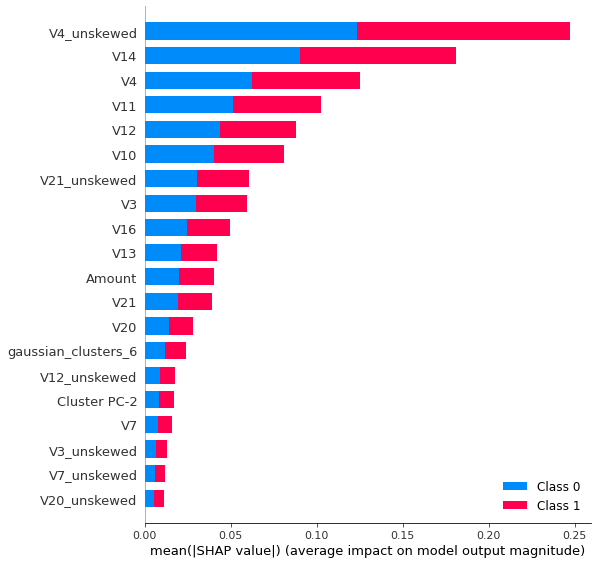

<Figure size 1152x864 with 0 Axes>

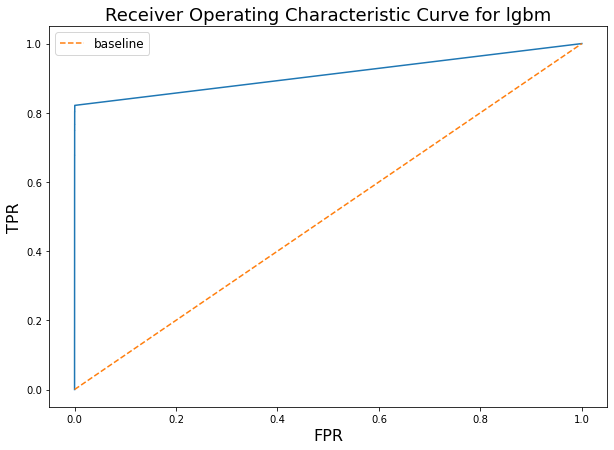

The ROC_AUC score is 0.9502643028892026


The Matthew correlation is 0.8336072110710366
-------------------
The accuracy is 0.9994
The recall is 0.9994
The macro F1 score is 0.9165163961797903
The micro F1 score is 0.9994
The weighted F1 score is 0.9993889089249539
              precision    recall  f1-score   support

         0.0       1.00      1.00      1.00     29944
         1.0       0.87      0.80      0.83        56

    accuracy                           1.00     30000
   macro avg       0.93      0.90      0.92     30000
weighted avg       1.00      1.00      1.00     30000



Started Execute test train split at 08:33:33.
Started Started column type detection and casting at 08:33:33.
Started Checking for duplicate columns at 08:33:33.
Started Reset dataframe index. at 08:33:33.
Started Select best features at 08:33:33.
Started Delete columns with high share of NULLs at 08:33:33.
Started Apply datetime transformation at 08:33:33.
Started Start TFIDF to PCA loop at 08:33:33.
Started Handle rare features at 08:33:33.
Started Remove cardinality at 08:33:33.
Started Holistic NULL filling at 08:33:33.
Started Binarize numeric columns + PCA binarized features at 08:33:33.
Started Onehot + PCA categorical features at 08:33:33.
Started Execute categorical encoding at 08:33:33.
Started Fill nulls at 08:33:33.
Started Handle outliers at 08:33:33.
Started Remove collinearity at 08:33:34.
Started Remove skewness at 08:33:34.
Started Execute clustering as a feature at 08:33:34.
Started Execute clustering as a feature at 08:33:47.
Started Execute clustering as a feature at

[I 2022-01-18 08:36:07,734] A new study created in memory with name: lgbm_focal


              precision    recall  f1-score   support

           0       1.00      1.00      1.00     49935
           1       0.86      0.74      0.79        65

    accuracy                           1.00     50000
   macro avg       0.93      0.87      0.90     50000
weighted avg       1.00      1.00      1.00     50000

Score achieved on holdout dataset is: 0.7953479789874717.
Try to load former experiment data.
End iteration for algorithm lgbm at 1642491367.573633.
+++++++++++++++++++++++++++++++++++++++++++++++++++++++++++
Start iteration for algorithm lgbm_focal at 1642491367.7127159.
Successfully loaded checkpoint last checkpoint.
Started Train LGBM with focal loss model at 08:36:07.


  0%|          | 0/50 [00:00<?, ?it/s]

[LightGBM] [Warning] Unknown parameter: gamma
[I 2022-01-18 08:36:08,676] Trial 0 finished with value: 2.6102294630136314e-07 and parameters: {'learning_rate': 0.023688639503640783, 'num_leaves': 244, 'num_boost_round': 36627, 'alpha': 0.24810409748678125, 'gamma': 16}. Best is trial 0 with value: 2.6102294630136314e-07.
[I 2022-01-18 08:36:08,942] Trial 1 finished with value: 1.2647566205952983e-23 and parameters: {'learning_rate': 0.01432169828911152, 'num_leaves': 16, 'num_boost_round': 43323, 'alpha': 0.2537815508265665, 'gamma': 71}. Best is trial 0 with value: 2.6102294630136314e-07.
[I 2022-01-18 08:36:10,802] Trial 2 finished with value: 3.717306666782389e-09 and parameters: {'learning_rate': 0.010485387725194618, 'num_leaves': 249, 'num_boost_round': 41639, 'alpha': 0.0070689749506246055, 'gamma': 19}. Best is trial 0 with value: 2.6102294630136314e-07.
[I 2022-01-18 08:36:11,074] Trial 3 finished with value: 1.1536504478320467e-11 and parameters: {'learning_rate': 0.015254729

[I 2022-01-18 08:36:28,253] Trial 29 finished with value: -119.94072213385641 and parameters: {'learning_rate': 0.06856031665656741, 'num_leaves': 250, 'num_boost_round': 1671, 'alpha': 4.482658903801731, 'gamma': 22}. Best is trial 25 with value: 0.021477212035863134.
[I 2022-01-18 08:36:28,542] Trial 30 finished with value: -74.46663047521017 and parameters: {'learning_rate': 0.09209860780398567, 'num_leaves': 150, 'num_boost_round': 17615, 'alpha': 7.208150258433598, 'gamma': 6}. Best is trial 25 with value: 0.021477212035863134.
[I 2022-01-18 08:36:30,297] Trial 31 finished with value: 6.553045161463317e-07 and parameters: {'learning_rate': 0.027843455975155147, 'num_leaves': 100, 'num_boost_round': 8102, 'alpha': 0.0017916310215592996, 'gamma': 9}. Best is trial 25 with value: 0.021477212035863134.
[I 2022-01-18 08:36:31,122] Trial 32 finished with value: 0.0008884485657336663 and parameters: {'learning_rate': 0.052454889151195366, 'num_leaves': 5, 'num_boost_round': 23853, 'alpha

[32]	train's focal_loss: 0.00562463	valid's focal_loss: 0.00565393
[33]	train's focal_loss: 0.00510474	valid's focal_loss: 0.00513557
[34]	train's focal_loss: 0.0046344	valid's focal_loss: 0.00466623
[35]	train's focal_loss: 0.00420859	valid's focal_loss: 0.00424125
[36]	train's focal_loss: 0.00382294	valid's focal_loss: 0.00385609
[37]	train's focal_loss: 0.00347358	valid's focal_loss: 0.00350766
[38]	train's focal_loss: 0.00315717	valid's focal_loss: 0.00319243
[39]	train's focal_loss: 0.00287028	valid's focal_loss: 0.00290607
[40]	train's focal_loss: 0.00261047	valid's focal_loss: 0.00264613
[41]	train's focal_loss: 0.00237479	valid's focal_loss: 0.00241062
[42]	train's focal_loss: 0.00216094	valid's focal_loss: 0.00219775
[43]	train's focal_loss: 0.00196681	valid's focal_loss: 0.00200331
[44]	train's focal_loss: 0.00179062	valid's focal_loss: 0.00182761
[45]	train's focal_loss: 0.00163075	valid's focal_loss: 0.00166843
[46]	train's focal_loss: 0.00148554	valid's focal_loss: 0.00152

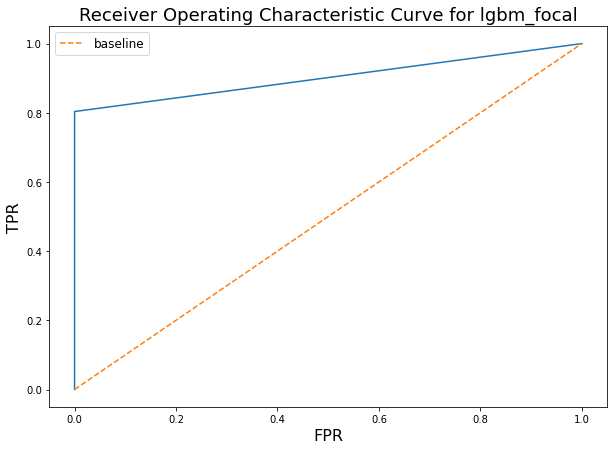

The ROC_AUC score is 0.9367652952177399


The Matthew correlation is 0.8769366396023339
-------------------
The accuracy is 0.9995666666666667
The recall is 0.9995666666666667
The macro F1 score is 0.9367846842581384
The micro F1 score is 0.9995666666666667
The weighted F1 score is 0.9995477671837194
              precision    recall  f1-score   support

         0.0       1.00      1.00      1.00     29944
         1.0       0.96      0.80      0.87        56

    accuracy                           1.00     30000
   macro avg       0.98      0.90      0.94     30000
weighted avg       1.00      1.00      1.00     30000

Started Execute test train split at 08:36:45.
Started Started column type detection and casting at 08:36:45.
Started Checking for duplicate columns at 08:36:45.
Started Reset dataframe index. at 08:36:45.
Started Select best features at 08:36:45.
Started Delete columns with high share of NULLs at 08:36:45.
Started Apply datetime transformation at 08:36:45.
Started Start TFIDF to PCA loop at 08:36:45.
Started H

[I 2022-01-18 08:38:43,452] A new study created in memory with name: ridge


Start iteration for algorithm ridge at 1642491523.4303815.
Successfully loaded checkpoint last checkpoint.
Started Train Ridge classifier model at 08:38:43.


  0%|          | 0/10 [00:00<?, ?it/s]

[I 2022-01-18 08:38:43,849] Trial 0 finished with value: 0.37077747215877194 and parameters: {'solver': 'svd', 'alpha': 157.41890047456639, 'max_iter': 6015, 'tol': 0.006796578090758156, 'normalize': False}. Best is trial 0 with value: 0.37077747215877194.
[I 2022-01-18 08:38:44,255] Trial 1 finished with value: 0.3947090082120235 and parameters: {'solver': 'auto', 'alpha': 0.055895242052179224, 'max_iter': 6123, 'tol': 3.613894271216525e-05, 'normalize': False}. Best is trial 1 with value: 0.3947090082120235.
[I 2022-01-18 08:38:44,734] Trial 2 finished with value: 0.3947090082120235 and parameters: {'solver': 'svd', 'alpha': 0.010547383621352036, 'max_iter': 659, 'tol': 0.06245139574743072, 'normalize': True}. Best is trial 1 with value: 0.3947090082120235.
[I 2022-01-18 08:38:45,061] Trial 3 finished with value: 0.37077747215877194 and parameters: {'solver': 'cholesky', 'alpha': 285.7080075040722, 'max_iter': 2595, 'tol': 0.004467752817973905, 'normalize': False}. Best is trial 1 wi

Started Predict with Ridge classifier at 08:42:33.
08:42:33


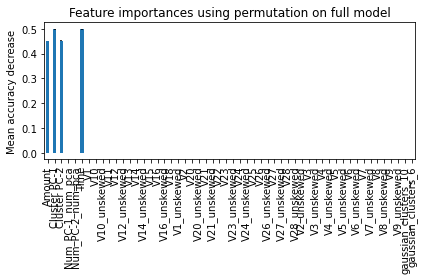

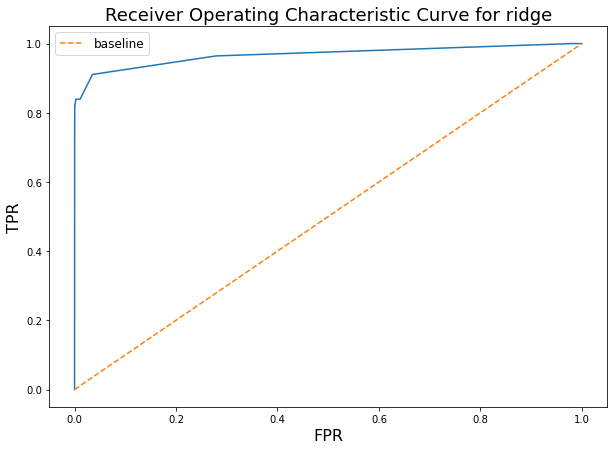

The ROC_AUC score is 0.9705772203351016


The Matthew correlation is 0.8205636997335243
-------------------
The accuracy is 0.9993666666666666
The recall is 0.9993666666666666
The macro F1 score is 0.909365198621397
The micro F1 score is 0.9993666666666666
The weighted F1 score is 0.9993455925647661
              precision    recall  f1-score   support

         0.0       1.00      1.00      1.00     29944
         1.0       0.88      0.77      0.82        56

    accuracy                           1.00     30000
   macro avg       0.94      0.88      0.91     30000
weighted avg       1.00      1.00      1.00     30000



Started Execute test train split at 08:42:44.
Started Started column type detection and casting at 08:42:44.
Started Checking for duplicate columns at 08:42:44.
Started Reset dataframe index. at 08:42:44.
Started Select best features at 08:42:44.
Started Delete columns with high share of NULLs at 08:42:44.
Started Apply datetime transformation at 08:42:44.
Started Start TFIDF to PCA loop at 08:42:44.
Started Handle rare features at 08:42:44.
Started Remove cardinality at 08:42:44.
Started Holistic NULL filling at 08:42:44.
Started Binarize numeric columns + PCA binarized features at 08:42:44.
Started Onehot + PCA categorical features at 08:42:44.
Started Execute categorical encoding at 08:42:44.
Started Fill nulls at 08:42:44.
Started Handle outliers at 08:42:44.
Started Remove collinearity at 08:42:45.
Started Remove skewness at 08:42:45.
Started Execute clustering as a feature at 08:42:45.
Started Execute clustering as a feature at 08:42:58.
Started Execute clustering as a feature at

              precision    recall  f1-score   support

           0       1.00      1.00      1.00     49935
           1       0.92      0.72      0.81        65

    accuracy                           1.00     50000
   macro avg       0.96      0.86      0.91     50000
weighted avg       1.00      1.00      1.00     50000

Score achieved on holdout dataset is: 0.8161070036907323.
Try to load former experiment data.
End iteration for algorithm ridge at 1642491909.276832.
+++++++++++++++++++++++++++++++++++++++++++++++++++++++++++
Start iteration for algorithm logistic_regression at 1642491909.4147272.
Successfully loaded checkpoint last checkpoint.
Started Train logistic regression model at 08:45:09.
Started Predict with Logistic Regression at 08:45:10.
08:45:10


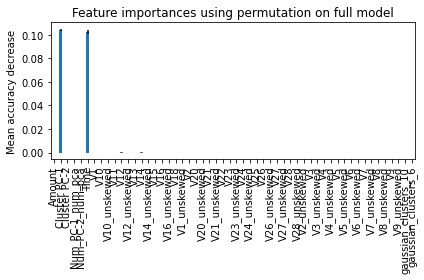

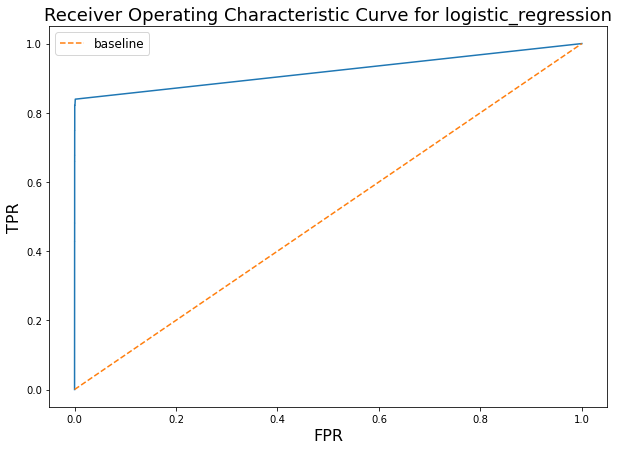

The ROC_AUC score is 0.9697047584061675


The Matthew correlation is 0.8210946147093623
-------------------
The accuracy is 0.9993333333333333
The recall is 0.9993333333333333
The macro F1 score is 0.910547307354681
The micro F1 score is 0.9993333333333333
The weighted F1 score is 0.9993333333333333
              precision    recall  f1-score   support

         0.0       1.00      1.00      1.00     29944
         1.0       0.82      0.82      0.82        56

    accuracy                           1.00     30000
   macro avg       0.91      0.91      0.91     30000
weighted avg       1.00      1.00      1.00     30000



Started Execute test train split at 08:45:13.
Started Started column type detection and casting at 08:45:13.
Started Checking for duplicate columns at 08:45:13.
Started Reset dataframe index. at 08:45:13.
Started Select best features at 08:45:13.
Started Delete columns with high share of NULLs at 08:45:13.
Started Apply datetime transformation at 08:45:13.
Started Start TFIDF to PCA loop at 08:45:13.
Started Handle rare features at 08:45:13.
Started Remove cardinality at 08:45:13.
Started Holistic NULL filling at 08:45:13.
Started Binarize numeric columns + PCA binarized features at 08:45:13.
Started Onehot + PCA categorical features at 08:45:14.
Started Execute categorical encoding at 08:45:14.
Started Fill nulls at 08:45:14.
Started Handle outliers at 08:45:14.
Started Remove collinearity at 08:45:15.
Started Remove skewness at 08:45:15.
Started Execute clustering as a feature at 08:45:15.
Started Execute clustering as a feature at 08:45:28.
Started Execute clustering as a feature at

              precision    recall  f1-score   support

           0       1.00      1.00      1.00     49935
           1       0.65      0.72      0.69        65

    accuracy                           1.00     50000
   macro avg       0.83      0.86      0.84     50000
weighted avg       1.00      1.00      1.00     50000

Score achieved on holdout dataset is: 0.6866012166316534.
Try to load former experiment data.
End iteration for algorithm logistic_regression at 1642492059.0662885.
+++++++++++++++++++++++++++++++++++++++++++++++++++++++++++
Start iteration for algorithm vowpal_wabbit at 1642492059.20517.
Successfully loaded checkpoint last checkpoint.
Started Train Vowpal Wabbit model at 08:47:39.
Started Predict with Vowpal Wabbit at 08:47:46.
08:47:49


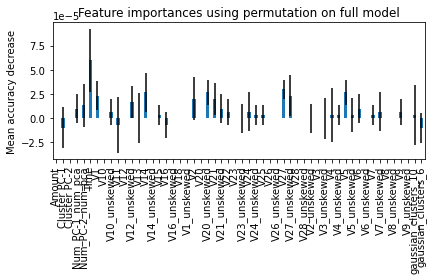

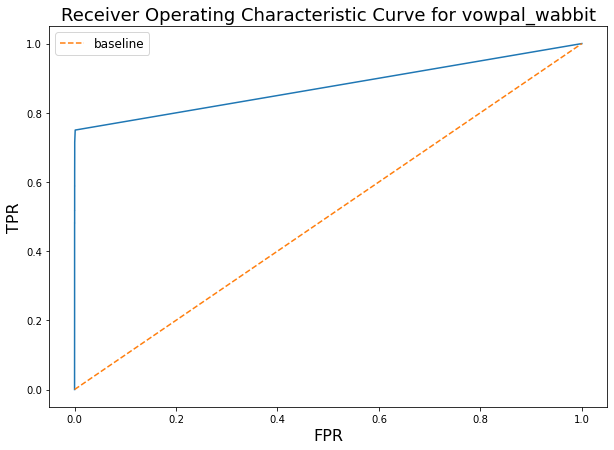

The ROC_AUC score is 0.9448124594481127


The Matthew correlation is 0.7631930345542459
-------------------
The accuracy is 0.9991666666666666
The recall is 0.9991666666666666
The macro F1 score is 0.8807436823965749
The micro F1 score is 0.9991666666666666
The weighted F1 score is 0.9991389375852185
              precision    recall  f1-score   support

         0.0       1.00      1.00      1.00     29944
         1.0       0.82      0.71      0.76        56

    accuracy                           1.00     30000
   macro avg       0.91      0.86      0.88     30000
weighted avg       1.00      1.00      1.00     30000



Started Execute test train split at 08:49:56.
Started Started column type detection and casting at 08:49:56.
Started Checking for duplicate columns at 08:49:56.
Started Reset dataframe index. at 08:49:56.
Started Select best features at 08:49:56.
Started Delete columns with high share of NULLs at 08:49:56.
Started Apply datetime transformation at 08:49:56.
Started Start TFIDF to PCA loop at 08:49:56.
Started Handle rare features at 08:49:56.
Started Remove cardinality at 08:49:56.
Started Holistic NULL filling at 08:49:56.
Started Binarize numeric columns + PCA binarized features at 08:49:56.
Started Onehot + PCA categorical features at 08:49:57.
Started Execute categorical encoding at 08:49:57.
Started Fill nulls at 08:49:57.
Started Handle outliers at 08:49:57.
Started Remove collinearity at 08:49:58.
Started Remove skewness at 08:49:58.
Started Execute clustering as a feature at 08:49:58.
Started Execute clustering as a feature at 08:50:11.
Started Execute clustering as a feature at

              precision    recall  f1-score   support

           0       1.00      1.00      1.00     49935
           1       0.97      0.43      0.60        65

    accuracy                           1.00     50000
   macro avg       0.98      0.72      0.80     50000
weighted avg       1.00      1.00      1.00     50000

Score achieved on holdout dataset is: 0.6446524990148478.
Try to load former experiment data.
End iteration for algorithm vowpal_wabbit at 1642492347.2151647.
+++++++++++++++++++++++++++++++++++++++++++++++++++++++++++
+++++++++++++++++++++++++++++++++++++++++++++++++++++++++++
Start iteration for checkpoint delete_high_null_cols at 1642492347.3535323.
Started Execute numerical binning at 08:52:27.
Started Apply datetime transformation at 08:52:27.
Started Start TFIDF to PCA loop at 08:52:27.
Started Handle rare features at 08:52:27.
Started Remove cardinality at 08:52:28.
Started Holistic NULL filling at 08:52:28.
Started Binarize numeric columns + PCA binarized f

Started Start deleting low variance features at 08:56:56.
Features before low variance deletion: 57
Features before low variance deletion: 55
The following features have been dropped....:
isolation_class
isolation_probs
Started Sort columns alphabetically at 08:56:56.


[I 2022-01-18 08:56:56,908] A new study created in memory with name: lgbm tuning


All algorithms to be tested are: ['lgbm', 'lgbm_focal', 'ridge', 'logistic_regression', 'vowpal_wabbit'].
Start iteration for algorithm lgbm at 1642492616.8816977.
Successfully loaded checkpoint last checkpoint.
Started Train LGBM at 08:56:56.
Started Check LGBM for GPU acceleration. at 08:56:56.
LGBM uses GPU.


  0%|          | 0/10 [00:00<?, ?it/s]

[I 2022-01-18 08:56:56,999] Trial 0 finished with value: 0.03388846282051174 and parameters: {'num_boost_round': 18789, 'lambda_l1': 506157.68887523044, 'lambda_l2': 24658.3294585491, 'num_leaves': 154, 'feature_fraction': 0.4936111842654619, 'feature_fraction_bynode': 0.49359671220172163, 'learning_rate': 1.7073967431528103e-05}. Best is trial 0 with value: 0.03388846282051174.
[I 2022-01-18 08:56:57,194] Trial 1 finished with value: 0.03388846282051174 and parameters: {'num_boost_round': 43323, 'lambda_l1': 4042.8727350273302, 'lambda_l2': 17718.847354806814, 'num_leaves': 7, 'feature_fraction': 0.9819459112971965, 'feature_fraction_bynode': 0.899465584480253, 'learning_rate': 7.068974950624602e-05}. Best is trial 0 with value: 0.03388846282051174.
[I 2022-01-18 08:57:18,650] Trial 2 finished with value: 0.01573450193706713 and parameters: {'num_boost_round': 9173, 'lambda_l1': 12.601639723276797, 'lambda_l2': 66.904211664988, 'num_leaves': 135, 'feature_fraction': 0.6591670111852694

[1]	train's binary_logloss: 0.0128173	valid's binary_logloss: 0.0127204
Training until validation scores don't improve for 10 rounds
[2]	train's binary_logloss: 0.0117216	valid's binary_logloss: 0.0117252
[3]	train's binary_logloss: 0.0111861	valid's binary_logloss: 0.0111248
[4]	train's binary_logloss: 0.0103687	valid's binary_logloss: 0.0103451
[5]	train's binary_logloss: 0.00970294	valid's binary_logloss: 0.00967818
[6]	train's binary_logloss: 0.00928963	valid's binary_logloss: 0.00929864
[7]	train's binary_logloss: 0.00886242	valid's binary_logloss: 0.00888911
[8]	train's binary_logloss: 0.00847099	valid's binary_logloss: 0.00852914
[9]	train's binary_logloss: 0.00812959	valid's binary_logloss: 0.00821643
[10]	train's binary_logloss: 0.00785621	valid's binary_logloss: 0.00796614
[11]	train's binary_logloss: 0.007643	valid's binary_logloss: 0.00775741
[12]	train's binary_logloss: 0.00746198	valid's binary_logloss: 0.00759657
[13]	train's binary_logloss: 0.00730223	valid's binary_log

[207]	train's binary_logloss: 0.0030517	valid's binary_logloss: 0.00387642
[208]	train's binary_logloss: 0.00305094	valid's binary_logloss: 0.00387528
[209]	train's binary_logloss: 0.00305014	valid's binary_logloss: 0.00387434
[210]	train's binary_logloss: 0.00304813	valid's binary_logloss: 0.00387199
[211]	train's binary_logloss: 0.00304637	valid's binary_logloss: 0.00386992
[212]	train's binary_logloss: 0.00304481	valid's binary_logloss: 0.00386838
[213]	train's binary_logloss: 0.00304401	valid's binary_logloss: 0.00386769
[214]	train's binary_logloss: 0.00304267	valid's binary_logloss: 0.00386612
[215]	train's binary_logloss: 0.00304171	valid's binary_logloss: 0.00386498
[216]	train's binary_logloss: 0.00304035	valid's binary_logloss: 0.00386356
[217]	train's binary_logloss: 0.00303961	valid's binary_logloss: 0.00386246
[218]	train's binary_logloss: 0.00303945	valid's binary_logloss: 0.00386225
[219]	train's binary_logloss: 0.00303945	valid's binary_logloss: 0.00386225
[220]	train's

Started Predict with LGBM at 08:58:50.
08:58:50


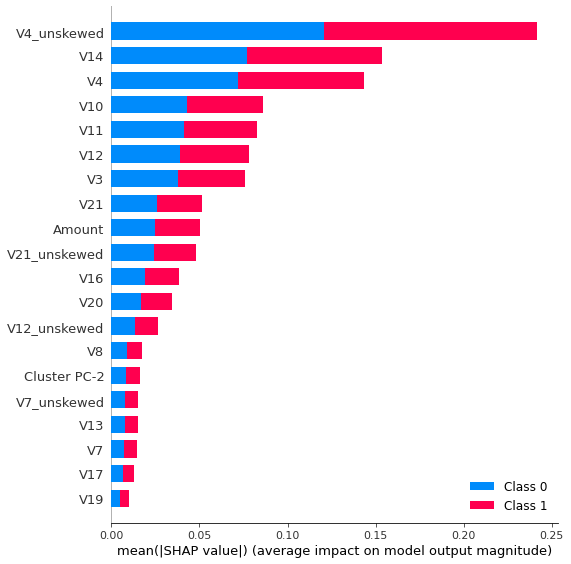

<Figure size 1152x864 with 0 Axes>

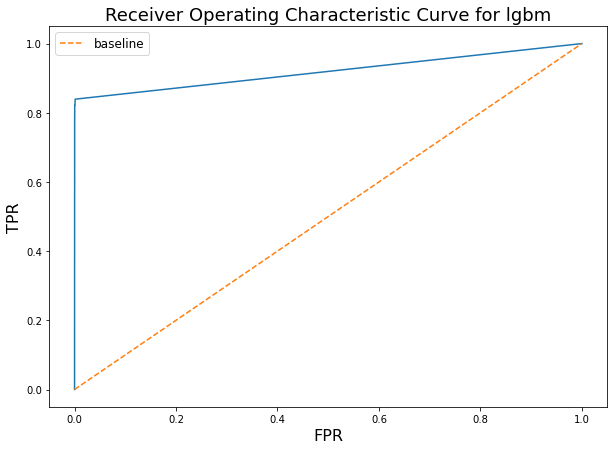

The ROC_AUC score is 0.9471283896606999


The Matthew correlation is 0.8396872547932838
-------------------
The accuracy is 0.9994333333333333
The recall is 0.9994333333333333
The macro F1 score is 0.9189057040296709
The micro F1 score is 0.9994333333333333
The weighted F1 score is 0.9994144775579485
              precision    recall  f1-score   support

         0.0       1.00      1.00      1.00     29944
         1.0       0.90      0.79      0.84        56

    accuracy                           1.00     30000
   macro avg       0.95      0.89      0.92     30000
weighted avg       1.00      1.00      1.00     30000



Started Execute test train split at 08:58:53.
Started Started column type detection and casting at 08:58:53.
Started Checking for duplicate columns at 08:58:53.
Started Reset dataframe index. at 08:58:53.
Started Select best features at 08:58:53.
Started Delete columns with high share of NULLs at 08:58:53.
Started Apply datetime transformation at 08:58:53.
Started Start TFIDF to PCA loop at 08:58:53.
Started Handle rare features at 08:58:53.
Started Remove cardinality at 08:58:53.
Started Holistic NULL filling at 08:58:53.
Started Binarize numeric columns + PCA binarized features at 08:58:53.
Started Onehot + PCA categorical features at 08:58:54.
Started Execute categorical encoding at 08:58:54.
Started Fill nulls at 08:58:54.
Started Handle outliers at 08:58:54.
Started Remove collinearity at 08:58:55.
Started Remove skewness at 08:58:55.
Started Execute clustering as a feature at 08:58:55.
Started Execute clustering as a feature at 08:59:08.
Started Execute clustering as a feature at

[I 2022-01-18 09:00:47,605] A new study created in memory with name: lgbm_focal


              precision    recall  f1-score   support

           0       1.00      1.00      1.00     49935
           1       0.87      0.69      0.77        65

    accuracy                           1.00     50000
   macro avg       0.93      0.85      0.88     50000
weighted avg       1.00      1.00      1.00     50000

Score achieved on holdout dataset is: 0.7737660881938734.
Try to load former experiment data.
End iteration for algorithm lgbm at 1642492847.4447858.
+++++++++++++++++++++++++++++++++++++++++++++++++++++++++++
Start iteration for algorithm lgbm_focal at 1642492847.5826.
Successfully loaded checkpoint last checkpoint.
Started Train LGBM with focal loss model at 09:00:47.


  0%|          | 0/50 [00:00<?, ?it/s]

[LightGBM] [Warning] Unknown parameter: gamma
[I 2022-01-18 09:00:48,680] Trial 0 finished with value: 2.590552273188676e-07 and parameters: {'learning_rate': 0.023688639503640783, 'num_leaves': 244, 'num_boost_round': 36627, 'alpha': 0.24810409748678125, 'gamma': 16}. Best is trial 0 with value: 2.590552273188676e-07.
[I 2022-01-18 09:00:48,950] Trial 1 finished with value: 1.2647566205952983e-23 and parameters: {'learning_rate': 0.01432169828911152, 'num_leaves': 16, 'num_boost_round': 43323, 'alpha': 0.2537815508265665, 'gamma': 71}. Best is trial 0 with value: 2.590552273188676e-07.
[I 2022-01-18 09:00:50,840] Trial 2 finished with value: 3.7204421860632275e-09 and parameters: {'learning_rate': 0.010485387725194618, 'num_leaves': 249, 'num_boost_round': 41639, 'alpha': 0.0070689749506246055, 'gamma': 19}. Best is trial 0 with value: 2.590552273188676e-07.
[I 2022-01-18 09:00:51,119] Trial 3 finished with value: 1.1536504478320467e-11 and parameters: {'learning_rate': 0.015254729458

[I 2022-01-18 09:01:08,396] Trial 29 finished with value: -119.94072213385641 and parameters: {'learning_rate': 0.06856031665656741, 'num_leaves': 250, 'num_boost_round': 1671, 'alpha': 4.482658903801731, 'gamma': 22}. Best is trial 25 with value: 0.021175956554870257.
[I 2022-01-18 09:01:08,687] Trial 30 finished with value: -74.46663047521017 and parameters: {'learning_rate': 0.09209860780398567, 'num_leaves': 150, 'num_boost_round': 17615, 'alpha': 7.208150258433598, 'gamma': 6}. Best is trial 25 with value: 0.021175956554870257.
[I 2022-01-18 09:01:10,112] Trial 31 finished with value: 6.858828440156723e-07 and parameters: {'learning_rate': 0.027843455975155147, 'num_leaves': 100, 'num_boost_round': 8102, 'alpha': 0.0017916310215592996, 'gamma': 9}. Best is trial 25 with value: 0.021175956554870257.
[I 2022-01-18 09:01:10,842] Trial 32 finished with value: 0.0010187328763759805 and parameters: {'learning_rate': 0.052454889151195366, 'num_leaves': 5, 'num_boost_round': 23853, 'alpha

[31]	train's focal_loss: 0.0061956	valid's focal_loss: 0.00623315
[32]	train's focal_loss: 0.00562093	valid's focal_loss: 0.00566015
[33]	train's focal_loss: 0.00510102	valid's focal_loss: 0.00514065
[34]	train's focal_loss: 0.0046308	valid's focal_loss: 0.00467103
[35]	train's focal_loss: 0.00420474	valid's focal_loss: 0.00424571
[36]	train's focal_loss: 0.0038191	valid's focal_loss: 0.00386116
[37]	train's focal_loss: 0.00346977	valid's focal_loss: 0.00351333
[38]	train's focal_loss: 0.00315329	valid's focal_loss: 0.0031969
[39]	train's focal_loss: 0.00286655	valid's focal_loss: 0.00291146
[40]	train's focal_loss: 0.00260636	valid's focal_loss: 0.00265144
[41]	train's focal_loss: 0.00237086	valid's focal_loss: 0.00241675
[42]	train's focal_loss: 0.00215701	valid's focal_loss: 0.00220503
[43]	train's focal_loss: 0.00196302	valid's focal_loss: 0.00201215
[44]	train's focal_loss: 0.00178702	valid's focal_loss: 0.00183812
[45]	train's focal_loss: 0.00162726	valid's focal_loss: 0.00167874

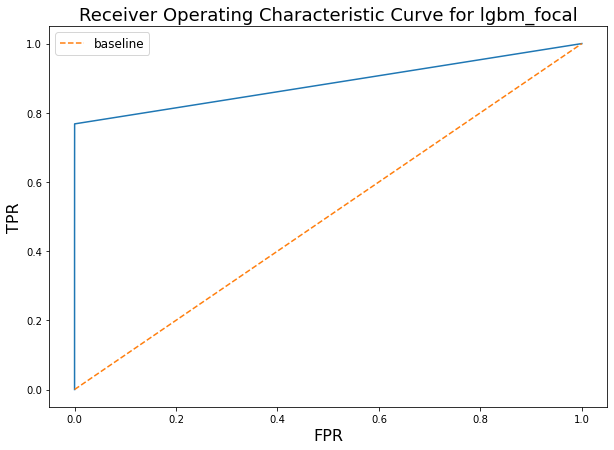

The ROC_AUC score is 0.9222334071218659


The Matthew correlation is 0.8290894042097788
-------------------
The accuracy is 0.9994
The recall is 0.9994
The macro F1 score is 0.9133112780100893
The micro F1 score is 0.9994
The weighted F1 score is 0.9993769631463768
              precision    recall  f1-score   support

         0.0       1.00      1.00      1.00     29944
         1.0       0.90      0.77      0.83        56

    accuracy                           1.00     30000
   macro avg       0.95      0.88      0.91     30000
weighted avg       1.00      1.00      1.00     30000

Started Execute test train split at 09:01:25.
Started Started column type detection and casting at 09:01:25.
Started Checking for duplicate columns at 09:01:25.
Started Reset dataframe index. at 09:01:25.
Started Select best features at 09:01:25.
Started Delete columns with high share of NULLs at 09:01:25.
Started Apply datetime transformation at 09:01:25.
Started Start TFIDF to PCA loop at 09:01:25.
Started Handle rare features at 09:01:25.
Sta

[I 2022-01-18 09:02:46,615] A new study created in memory with name: ridge


Start iteration for algorithm ridge at 1642492966.5890157.
Successfully loaded checkpoint last checkpoint.
Started Train Ridge classifier model at 09:02:46.


  0%|          | 0/10 [00:00<?, ?it/s]

[I 2022-01-18 09:02:47,007] Trial 0 finished with value: 0.43734383792273057 and parameters: {'solver': 'svd', 'alpha': 157.41890047456639, 'max_iter': 6015, 'tol': 0.006796578090758156, 'normalize': False}. Best is trial 0 with value: 0.43734383792273057.
[I 2022-01-18 09:02:47,310] Trial 1 finished with value: 0.43734383792273057 and parameters: {'solver': 'auto', 'alpha': 0.055895242052179224, 'max_iter': 6123, 'tol': 3.613894271216525e-05, 'normalize': False}. Best is trial 0 with value: 0.43734383792273057.
[I 2022-01-18 09:02:47,998] Trial 2 finished with value: 0.43734383792273057 and parameters: {'solver': 'svd', 'alpha': 0.010547383621352036, 'max_iter': 659, 'tol': 0.06245139574743072, 'normalize': True}. Best is trial 0 with value: 0.43734383792273057.
[I 2022-01-18 09:02:48,287] Trial 3 finished with value: 0.43734383792273057 and parameters: {'solver': 'cholesky', 'alpha': 285.7080075040722, 'max_iter': 2595, 'tol': 0.004467752817973905, 'normalize': False}. Best is trial 

Started Predict with Ridge classifier at 09:06:47.
09:06:47


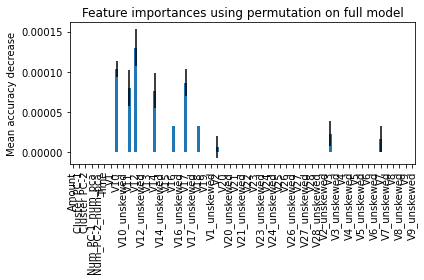

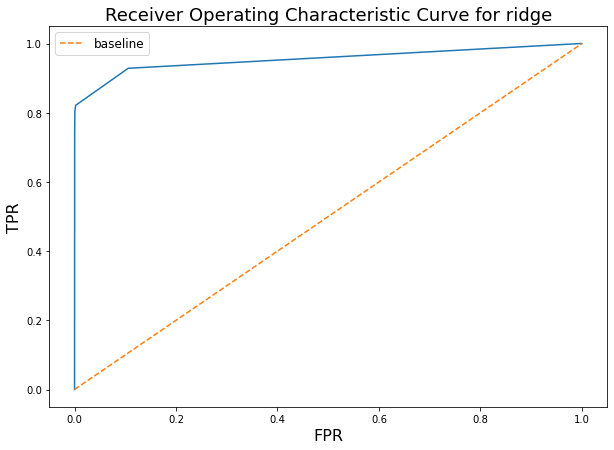

The ROC_AUC score is 0.9667218092820884


The Matthew correlation is 0.8042701770921268
-------------------
The accuracy is 0.9993
The recall is 0.9993
The macro F1 score is 0.9016938462376285
The micro F1 score is 0.9993
The weighted F1 score is 0.9992836740785866
              precision    recall  f1-score   support

         0.0       1.00      1.00      1.00     29944
         1.0       0.84      0.77      0.80        56

    accuracy                           1.00     30000
   macro avg       0.92      0.88      0.90     30000
weighted avg       1.00      1.00      1.00     30000



Started Execute test train split at 09:06:57.
Started Started column type detection and casting at 09:06:57.
Started Checking for duplicate columns at 09:06:58.
Started Reset dataframe index. at 09:06:58.
Started Select best features at 09:06:58.
Started Delete columns with high share of NULLs at 09:06:58.
Started Apply datetime transformation at 09:06:58.
Started Start TFIDF to PCA loop at 09:06:58.
Started Handle rare features at 09:06:58.
Started Remove cardinality at 09:06:58.
Started Holistic NULL filling at 09:06:58.
Started Binarize numeric columns + PCA binarized features at 09:06:58.
Started Onehot + PCA categorical features at 09:06:58.
Started Execute categorical encoding at 09:06:58.
Started Fill nulls at 09:06:58.
Started Handle outliers at 09:06:58.
Started Remove collinearity at 09:06:59.
Started Remove skewness at 09:06:59.
Started Execute clustering as a feature at 09:06:59.
Started Execute clustering as a feature at 09:07:12.
Started Execute clustering as a feature at

              precision    recall  f1-score   support

           0       1.00      1.00      1.00     49935
           1       0.91      0.74      0.81        65

    accuracy                           1.00     50000
   macro avg       0.95      0.87      0.91     50000
weighted avg       1.00      1.00      1.00     50000

Score achieved on holdout dataset is: 0.8175899720485358.
Try to load former experiment data.
End iteration for algorithm ridge at 1642493337.378174.
+++++++++++++++++++++++++++++++++++++++++++++++++++++++++++
Start iteration for algorithm logistic_regression at 1642493337.5174336.
Successfully loaded checkpoint last checkpoint.
Started Train logistic regression model at 09:08:57.
Started Predict with Logistic Regression at 09:08:58.
09:08:58


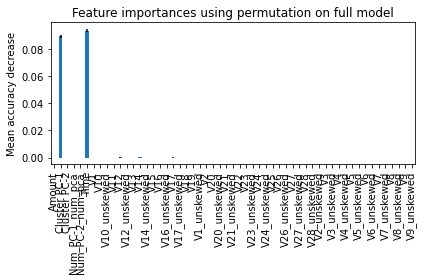

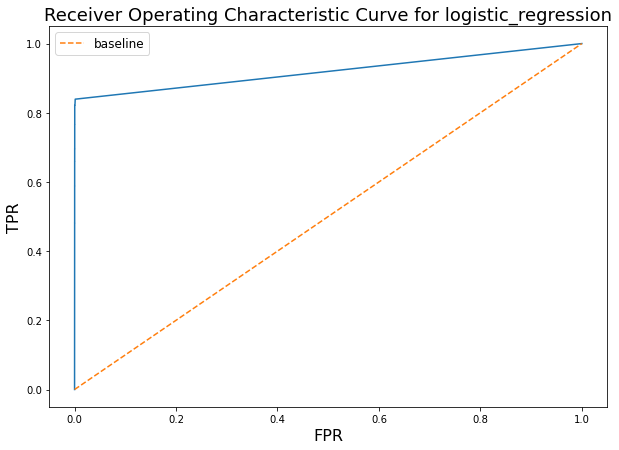

The ROC_AUC score is 0.9691364356322276


The Matthew correlation is 0.8138406479635082
-------------------
The accuracy is 0.9993
The recall is 0.9993
The macro F1 score is 0.9069043158124792
The micro F1 score is 0.9993
The weighted F1 score is 0.9993030915007926
              precision    recall  f1-score   support

         0.0       1.00      1.00      1.00     29944
         1.0       0.81      0.82      0.81        56

    accuracy                           1.00     30000
   macro avg       0.90      0.91      0.91     30000
weighted avg       1.00      1.00      1.00     30000



Started Execute test train split at 09:09:01.
Started Started column type detection and casting at 09:09:01.
Started Checking for duplicate columns at 09:09:01.
Started Reset dataframe index. at 09:09:01.
Started Select best features at 09:09:01.
Started Delete columns with high share of NULLs at 09:09:01.
Started Apply datetime transformation at 09:09:01.
Started Start TFIDF to PCA loop at 09:09:01.
Started Handle rare features at 09:09:01.
Started Remove cardinality at 09:09:01.
Started Holistic NULL filling at 09:09:01.
Started Binarize numeric columns + PCA binarized features at 09:09:01.
Started Onehot + PCA categorical features at 09:09:02.
Started Execute categorical encoding at 09:09:02.
Started Fill nulls at 09:09:02.
Started Handle outliers at 09:09:02.
Started Remove collinearity at 09:09:03.
Started Remove skewness at 09:09:03.
Started Execute clustering as a feature at 09:09:03.
Started Execute clustering as a feature at 09:09:16.
Started Execute clustering as a feature at

              precision    recall  f1-score   support

           0       1.00      1.00      1.00     49935
           1       0.72      0.71      0.71        65

    accuracy                           1.00     50000
   macro avg       0.86      0.85      0.86     50000
weighted avg       1.00      1.00      1.00     50000

Score achieved on holdout dataset is: 0.7128293124970295.
Try to load former experiment data.
End iteration for algorithm logistic_regression at 1642493499.3211133.
+++++++++++++++++++++++++++++++++++++++++++++++++++++++++++
Start iteration for algorithm vowpal_wabbit at 1642493499.481123.
Successfully loaded checkpoint last checkpoint.
Started Train Vowpal Wabbit model at 09:11:39.
Started Predict with Vowpal Wabbit at 09:11:47.
09:11:50


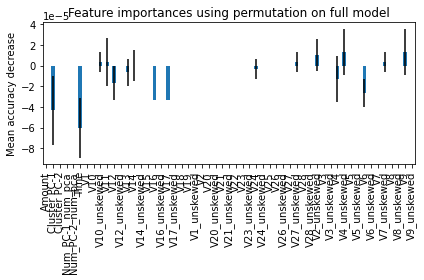

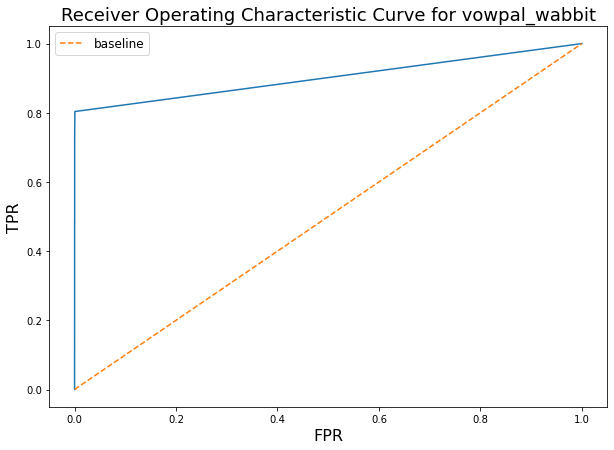

The ROC_AUC score is 0.9586627180260294


The Matthew correlation is 0.8014401446737648
-------------------
The accuracy is 0.9993
The recall is 0.9993
The macro F1 score is 0.899824693213123
The micro F1 score is 0.9993
The weighted F1 score is 0.9992767075715836
              precision    recall  f1-score   support

         0.0       1.00      1.00      1.00     29944
         1.0       0.86      0.75      0.80        56

    accuracy                           1.00     30000
   macro avg       0.93      0.87      0.90     30000
weighted avg       1.00      1.00      1.00     30000



Started Execute test train split at 09:14:03.
Started Started column type detection and casting at 09:14:03.
Started Checking for duplicate columns at 09:14:03.
Started Reset dataframe index. at 09:14:03.
Started Select best features at 09:14:03.
Started Delete columns with high share of NULLs at 09:14:03.
Started Apply datetime transformation at 09:14:03.
Started Start TFIDF to PCA loop at 09:14:03.
Started Handle rare features at 09:14:03.
Started Remove cardinality at 09:14:03.
Started Holistic NULL filling at 09:14:03.
Started Binarize numeric columns + PCA binarized features at 09:14:03.
Started Onehot + PCA categorical features at 09:14:04.
Started Execute categorical encoding at 09:14:04.
Started Fill nulls at 09:14:04.
Started Handle outliers at 09:14:04.
Started Remove collinearity at 09:14:05.
Started Remove skewness at 09:14:05.
Started Execute clustering as a feature at 09:14:05.
Started Execute clustering as a feature at 09:14:18.
Started Execute clustering as a feature at

              precision    recall  f1-score   support

           0       1.00      1.00      1.00     49935
           1       0.97      0.57      0.72        65

    accuracy                           1.00     50000
   macro avg       0.99      0.78      0.86     50000
weighted avg       1.00      1.00      1.00     50000

Score achieved on holdout dataset is: 0.7442529896858046.
Try to load former experiment data.
End iteration for algorithm vowpal_wabbit at 1642493755.0175064.
+++++++++++++++++++++++++++++++++++++++++++++++++++++++++++
+++++++++++++++++++++++++++++++++++++++++++++++++++++++++++
Start iteration for checkpoint early_numeric_only_feature_selection at 1642493755.1617074.
Started Delete columns with high share of NULLs at 09:15:55.
Started Apply datetime transformation at 09:15:55.
Started Handle rare features at 09:15:55.
Started Remove cardinality at 09:15:55.
Started Holistic NULL filling at 09:15:56.
Started Binarize numeric columns + PCA binarized features at 09:15

[I 2022-01-18 09:16:05,816] A new study created in memory with name: automated_feature_transformation


Started Automated feature transformation at 09:16:05.


  0%|          | 0/20 [00:00<?, ?it/s]

[I 2022-01-18 09:16:09,274] Trial 0 finished with value: 28.684833577622832 and parameters: {'transformer': 'maxabs', 'n_quantiles': 605.1038616257767}. Best is trial 0 with value: 28.684833577622832.
[I 2022-01-18 09:16:13,036] Trial 1 finished with value: 35.26563413147099 and parameters: {'transformer': 'robust', 'n_quantiles': 529.5088673159155}. Best is trial 1 with value: 35.26563413147099.
[I 2022-01-18 09:16:16,461] Trial 2 finished with value: 29.957916573968436 and parameters: {'transformer': 'no_scaling', 'n_quantiles': 207.67704433677613}. Best is trial 1 with value: 35.26563413147099.
[I 2022-01-18 09:16:19,969] Trial 3 finished with value: 31.41090629823503 and parameters: {'transformer': 'no_scaling', 'n_quantiles': 810.3133746352966}. Best is trial 1 with value: 35.26563413147099.
[I 2022-01-18 09:16:23,522] Trial 4 finished with value: 34.4829848890046 and parameters: {'transformer': 'no_scaling', 'n_quantiles': 266.1921817840167}. Best is trial 1 with value: 35.265634

Started Execute clustering as a feature at 09:17:20.


KeyboardInterrupt: 

In [15]:
results = timetravel.timewalk_auto_exploration(class_instance=automl_pipeline,
                                   holdout_df=holdout_df,
                                   holdout_target=hold_df_target,
                                   is_imbalanced=True,
                                    preprocess_checkpoints=["default", 
                                                            "delete_high_null_cols",
                                                            "early_numeric_only_feature_selection",
                                                            "fill_infinite_values"],
                                   algs_to_test=["lgbm", "lgbm_focal", "ridge", "logistic_regression", "vowpal_wabbit"],
                                   name_of_exist_experiment="timewalk_creditcard_fraud.pkl",
                                   experiment_name="timewalk_creditcard_fraud.pkl")

After the delete_high_null_cols step we would run into the same issues as every following step would use feature transformation as well.
Here we could cose to run this npart with a smaller sample size, but LGBM focal seems to be the winner anyway.

In [16]:
results = pd.read_pickle("timewalk_creditcard_fraud.pkl")

In [17]:
results.sort_values(by=["Matthews"], ascending=[False]).head(30).drop_duplicates(subset=['Trial number', 'Algorithm', 'Matthews'], keep='last')

,Trial number,Algorithm,Matthews,Accuracy,Recall,Preprocessing applied,ML model runtime in seconds,experiment_comment,preprocessing_runtime_sec,Total runtime
2,3,lgbm_focal,0.841268,0.99962,0.99962,"{'automatic_type_detection_casting': True, 'remove_duplicate_column_names': True, 'reset_dataframe_index': True, 'fill_infinite_values': True, 'early_numeric_only_feature_selection': True, 'delete_high_null_cols': True, 'data_binning': False, 'regex_clean_text_data': False, 'handle_target_skewness': False, 'datetime_converter': True, 'pos_tagging_pca': False, 'append_text_sentiment_score': False, 'tfidf_vectorizer_to_pca': True, 'tfidf_vectorizer': False, 'rare_feature_processing': True, 'cardinality_remover': True, 'categorical_column_embeddings': False, 'holistic_null_filling': True, 'numeric_binarizer_pca': True, 'onehot_pca': True, 'category_encoding': True, 'fill_nulls_static': True, 'outlier_care': True, 'delete_outliers': False, 'remove_collinearity': True, 'skewness_removal': True, 'automated_feature_transformation': False, 'random_trees_embedding': False, 'clustering_as_a_feature_dbscan': True, 'clustering_as_a_feature_kmeans_loop': True, 'clustering_as_a_feature_gaussian_mixture_loop': True, 'pca_clustering_results': True, 'svm_outlier_detection_loop': False, 'autotuned_clustering': True, 'reduce_memory_footprint': False, 'scale_data': True, 'smote': False, 'automated_feature_selection': True, 'bruteforce_random_feature_selection': False, 'autoencoder_based_oversampling': False, 'synthetic_data_augmentation': False, 'final_pca_dimensionality_reduction': False, 'final_kernel_pca_dimensionality_reduction': False, 'delete_low_variance_features': True, 'shap_based_feature_selection': True, 'delete_unpredictable_training_rows': False, 'sort_columns_alphabetically': True}",200.511471,Experiment run at 2022-01-17 13:36:44,81.920764,282.432235
1,2,lgbm_focal,0.821225,0.99956,0.99956,"{'automatic_type_detection_casting': True, 'remove_duplicate_column_names': True, 'reset_dataframe_index': True, 'fill_infinite_values': True, 'early_numeric_only_feature_selection': True, 'delete_high_null_cols': True, 'data_binning': False, 'regex_clean_text_data': False, 'handle_target_skewness': False, 'datetime_converter': True, 'pos_tagging_pca': False, 'append_text_sentiment_score': False, 'tfidf_vectorizer_to_pca': True, 'tfidf_vectorizer': False, 'rare_feature_processing': True, 'cardinality_remover': True, 'categorical_column_embeddings': False, 'holistic_null_filling': True, 'numeric_binarizer_pca': True, 'onehot_pca': True, 'category_encoding': True, 'fill_nulls_static': True, 'outlier_care': True, 'delete_outliers': False, 'remove_collinearity': True, 'skewness_removal': True, 'automated_feature_transformation': False, 'random_trees_embedding': False, 'clustering_as_a_feature_dbscan': True, 'clustering_as_a_feature_kmeans_loop': True, 'clustering_as_a_feature_gaussian_mixture_loop': True, 'pca_clustering_results': True, 'svm_outlier_detection_loop': False, 'autotuned_clustering': True, 'reduce_memory_footprint': False, 'scale_data': True, 'smote': False, 'automated_feature_selection': True, 'bruteforce_random_feature_selection': False, 'autoencoder_based_oversampling': False, 'synthetic_data_augmentation': False, 'final_pca_dimensionality_reduction': False, 'final_kernel_pca_dimensionality_reduction': False, 'delete_low_variance_features': True, 'shap_based_feature_selection': True, 'delete_unpredictable_training_rows': False, 'sort_columns_alphabetically': True}",142.214287,Experiment run at 2022-01-18 06:59:28,1682.999385,1825.213673
0,1,lgbm,0.819305,0.99956,0.99956,"{'automatic_type_detection_casting': True, 'remove_duplicate_column_names': True, 'reset_dataframe_index': True, 'fill_infinite_values': True, 'early_numeric_only_feature_selection': True, 'delete_high_null_cols': True, 'data_binning': False, 'regex_clean_text_data': False, 'handle_target_skewness': False, 'datetime_converter': True, 'pos_tagging_pca': False, 'append_text

In [18]:
import plotly.express as px
fig = px.line(
            results,
            x="Total runtime",
            y="Matthews",
            color="Algorithm",
            text="Trial number",
            title='Performance vs runtime comparison of algorithms'
        )
fig.update_traces(textposition="bottom right")
fig.show()

LGBM focal is has been fast and superior. This makes sense as focal loss is most suitable for imbalanced data (binary and multiclass).

# Creating the final pipeline
We:
- restart the notebook
- reimport libraries
- reload the data, but this time use 230k rows for training instead of 100k
- load in the results from Timnewalk
- instantiate a ClassificationBlueprint class
- take the winning parameters from results and overwrite the class default preprocessing steps
- run the lgbm_focal_loss pipeline
- run the function agsin (from here it is in prediction mode and will predict on new data)
- do a final evaluation

Let's see, if more data can help improving the score. It could also hurt performance, if we sudeenly have more bad data points in the set. 

In [2]:
target = 'Class'
creditcard = pd.read_csv('creditcard.csv')
creditcard = creditcard.sort_values(by=["Time"], ascending=[True])
train_df = creditcard.head(230000)
train_df = train_df.sample(230000, random_state=1000)
train_df_target = train_df[target]
# actual holdout
holdout_df = creditcard.tail(50000)
hold_df_target = holdout_df[target]
del holdout_df[target]
del creditcard
_ = gc.collect()

In [4]:
results = pd.read_pickle("timewalk_creditcard_fraud.pkl")
results.sort_values(by=["Matthews"], ascending=[False]).head(30).drop_duplicates(subset=['Trial number', 'Algorithm', 'Matthews'], keep='last')

,Trial number,Algorithm,Matthews,Accuracy,Recall,Preprocessing applied,ML model runtime in seconds,experiment_comment,preprocessing_runtime_sec,Total runtime
2,3,lgbm_focal,0.841268,0.99962,0.99962,"{'automatic_type_detection_casting': True, 'remove_duplicate_column_names': True, 'reset_dataframe_index': True, 'fill_infinite_values': True, 'early_numeric_only_feature_selection': True, 'delete_high_null_cols': True, 'data_binning': False, 'regex_clean_text_data': False, 'handle_target_skewness': False, 'datetime_converter': True, 'pos_tagging_pca': False, 'append_text_sentiment_score': False, 'tfidf_vectorizer_to_pca': True, 'tfidf_vectorizer': False, 'rare_feature_processing': True, 'cardinality_remover': True, 'categorical_column_embeddings': False, 'holistic_null_filling': True, 'numeric_binarizer_pca': True, 'onehot_pca': True, 'category_encoding': True, 'fill_nulls_static': True, 'outlier_care': True, 'delete_outliers': False, 'remove_collinearity': True, 'skewness_removal': True, 'automated_feature_transformation': False, 'random_trees_embedding': False, 'clustering_as_a_feature_dbscan': True, 'clustering_as_a_feature_kmeans_loop': True, 'clustering_as_a_feature_gaussian_mixture_loop': True, 'pca_clustering_results': True, 'svm_outlier_detection_loop': False, 'autotuned_clustering': True, 'reduce_memory_footprint': False, 'scale_data': True, 'smote': False, 'automated_feature_selection': True, 'bruteforce_random_feature_selection': False, 'autoencoder_based_oversampling': False, 'synthetic_data_augmentation': False, 'final_pca_dimensionality_reduction': False, 'final_kernel_pca_dimensionality_reduction': False, 'delete_low_variance_features': True, 'shap_based_feature_selection': True, 'delete_unpredictable_training_rows': False, 'sort_columns_alphabetically': True}",200.511471,Experiment run at 2022-01-17 13:36:44,81.920764,282.432235
1,2,lgbm_focal,0.821225,0.99956,0.99956,"{'automatic_type_detection_casting': True, 'remove_duplicate_column_names': True, 'reset_dataframe_index': True, 'fill_infinite_values': True, 'early_numeric_only_feature_selection': True, 'delete_high_null_cols': True, 'data_binning': False, 'regex_clean_text_data': False, 'handle_target_skewness': False, 'datetime_converter': True, 'pos_tagging_pca': False, 'append_text_sentiment_score': False, 'tfidf_vectorizer_to_pca': True, 'tfidf_vectorizer': False, 'rare_feature_processing': True, 'cardinality_remover': True, 'categorical_column_embeddings': False, 'holistic_null_filling': True, 'numeric_binarizer_pca': True, 'onehot_pca': True, 'category_encoding': True, 'fill_nulls_static': True, 'outlier_care': True, 'delete_outliers': False, 'remove_collinearity': True, 'skewness_removal': True, 'automated_feature_transformation': False, 'random_trees_embedding': False, 'clustering_as_a_feature_dbscan': True, 'clustering_as_a_feature_kmeans_loop': True, 'clustering_as_a_feature_gaussian_mixture_loop': True, 'pca_clustering_results': True, 'svm_outlier_detection_loop': False, 'autotuned_clustering': True, 'reduce_memory_footprint': False, 'scale_data': True, 'smote': False, 'automated_feature_selection': True, 'bruteforce_random_feature_selection': False, 'autoencoder_based_oversampling': False, 'synthetic_data_augmentation': False, 'final_pca_dimensionality_reduction': False, 'final_kernel_pca_dimensionality_reduction': False, 'delete_low_variance_features': True, 'shap_based_feature_selection': True, 'delete_unpredictable_training_rows': False, 'sort_columns_alphabetically': True}",142.214287,Experiment run at 2022-01-18 06:59:28,1682.999385,1825.213673
0,1,lgbm,0.819305,0.99956,0.99956,"{'automatic_type_detection_casting': True, 'remove_duplicate_column_names': True, 'reset_dataframe_index': True, 'fill_infinite_values': True, 'early_numeric_only_feature_selection': True, 'delete_high_null_cols': True, 'data_binning': False, 'regex_clean_text_data': False, 'handle_target_skewness': False, 'datetime_converter': True, 'pos_tagging_pca': False, 'append_text

In [5]:
winner_set = results[(results["Accuracy"].isna() == False)].sort_values(by=["Matthews"], ascending=[False]).head(1)
winner_set

,Trial number,Algorithm,Matthews,Accuracy,Recall,Preprocessing applied,ML model runtime in seconds,experiment_comment,preprocessing_runtime_sec,Total runtime
2,3,lgbm_focal,0.841268,0.99962,0.99962,"{'automatic_type_detection_casting': True, 'remove_duplicate_column_names': True, 'reset_dataframe_index': True, 'fill_infinite_values': True, 'early_numeric_only_feature_selection': True, 'delete_high_null_cols': True, 'data_binning': False, 'regex_clean_text_data': False, 'handle_target_skewness': False, 'datetime_converter': True, 'pos_tagging_pca': False, 'append_text_sentiment_score': False, 'tfidf_vectorizer_to_pca': True, 'tfidf_vectorizer': False, 'rare_feature_processing': True, 'cardinality_remover': True, 'categorical_column_embeddings': False, 'holistic_null_filling': True, 'numeric_binarizer_pca': True, 'onehot_pca': True, 'category_encoding': True, 'fill_nulls_static': True, 'outlier_care': True, 'delete_outliers': False, 'remove_collinearity': True, 'skewness_removal': True, 'automated_feature_transformation': False, 'random_trees_embedding': False, 'clustering_as_a_feature_dbscan': True, 'clustering_as_a_feature_kmeans_loop': True, 'clustering_as_a_feature_gaussian_mixture_loop': True, 'pca_clustering_results': True, 'svm_outlier_detection_loop': False, 'autotuned_clustering': True, 'reduce_memory_footprint': False, 'scale_data': True, 'smote': False, 'automated_feature_selection': True, 'bruteforce_random_feature_selection': False, 'autoencoder_based_oversampling': False, 'synthetic_data_augmentation': False, 'final_pca_dimensionality_reduction': False, 'final_kernel_pca_dimensionality_reduction': False, 'delete_low_variance_features': True, 'shap_based_feature_selection': True, 'delete_unpredictable_training_rows': False, 'sort_columns_alphabetically': True}",200.511471,Experiment run at 2022-01-17 13:36:44,81.920764,282.432235


In [6]:
automl_pipeline = cb.ClassificationBluePrint(datasource=train_df,
                                       target_variable=target,
                                       preferred_training_mode='cpu',
                                       tune_mode='accurate',
                                       ml_task='binary',
                                       rapids_acceleration=False
                                        )

Ml task is binary

            CPU mode has been chosen. Installing e2eml into an environment where LGBM and Xgboost have been installed with GPU acceleration
            is recommended to be able to use preferred_training_mode='gpu'. This will speed up model training and feature importance
            via SHAP.
            


In [7]:
# showing the preprocessing steps of our best iteration and model
best_params = winner_set["Preprocessing applied"].values.tolist()[0]

# use best prarams from timewalk
for key, value in best_params.items():
    automl_pipeline.blueprint_step_selection_non_nlp[key] = value

Started Execute test train split at 09:30:30.
Started Started column type detection and casting at 09:30:30.
Started Checking for duplicate columns at 09:30:30.
Started Reset dataframe index. at 09:30:31.
Started Select best features at 09:30:31.
Features before selection are...V24
Features before selection are...V3
Features before selection are...V13
Features before selection are...V25
Features before selection are...Amount
Features before selection are...V7
Features before selection are...V6
Features before selection are...V4
Features before selection are...V12
Features before selection are...V27
Features before selection are...V23
Features before selection are...V15
Features before selection are...V26
Features before selection are...V9
Features before selection are...V20
Features before selection are...V5
Features before selection are...V2
Features before selection are...V16
Features before selection are...V1
Features before selection are...V10
Features before selection are...V21
Fe

  0%|          | 0/50 [00:00<?, ?it/s]

Started Scale data at 09:59:30.
Started Select best features at 09:59:30.
Features before selection are...Time
Features before selection are...V1
Features before selection are...V2
Features before selection are...V3
Features before selection are...V4
Features before selection are...V5
Features before selection are...V6
Features before selection are...V7
Features before selection are...V8
Features before selection are...V9
Features before selection are...V10
Features before selection are...V11
Features before selection are...V12
Features before selection are...V13
Features before selection are...V14
Features before selection are...V15
Features before selection are...V16
Features before selection are...V17
Features before selection are...V18
Features before selection are...V19
Features before selection are...V20
Features before selection are...V21
Features before selection are...V22
Features before selection are...V23
Features before selection are...V24
Features before selection are...V2

[I 2022-01-18 10:00:04,766] A new study created in memory with name: lgbm_focal


Started Train LGBM with focal loss model at 10:00:04.


  0%|          | 0/50 [00:00<?, ?it/s]

[LightGBM] [Warning] Unknown parameter: gamma
[I 2022-01-18 10:00:06,121] Trial 0 finished with value: 1.4256354186790853e-07 and parameters: {'learning_rate': 0.023688639503640783, 'num_leaves': 244, 'num_boost_round': 36627, 'alpha': 0.24810409748678125, 'gamma': 16}. Best is trial 0 with value: 1.4256354186790853e-07.
[I 2022-01-18 10:00:06,389] Trial 1 finished with value: 1.068198413598511e-23 and parameters: {'learning_rate': 0.01432169828911152, 'num_leaves': 16, 'num_boost_round': 43323, 'alpha': 0.2537815508265665, 'gamma': 71}. Best is trial 0 with value: 1.4256354186790853e-07.
[I 2022-01-18 10:00:07,486] Trial 2 finished with value: 3.2858718298150888e-09 and parameters: {'learning_rate': 0.010485387725194618, 'num_leaves': 249, 'num_boost_round': 41639, 'alpha': 0.0070689749506246055, 'gamma': 19}. Best is trial 0 with value: 1.4256354186790853e-07.
[I 2022-01-18 10:00:07,760] Trial 3 finished with value: 9.5996253783564e-12 and parameters: {'learning_rate': 0.015254729458

[I 2022-01-18 10:00:24,425] Trial 29 finished with value: -120.03695378334703 and parameters: {'learning_rate': 0.06856031665656741, 'num_leaves': 250, 'num_boost_round': 1671, 'alpha': 4.482658903801731, 'gamma': 22}. Best is trial 25 with value: 0.015155251306002671.
[I 2022-01-18 10:00:24,712] Trial 30 finished with value: -88.45882052825532 and parameters: {'learning_rate': 0.09209860780398567, 'num_leaves': 150, 'num_boost_round': 17615, 'alpha': 7.208150258433598, 'gamma': 6}. Best is trial 25 with value: 0.015155251306002671.
[I 2022-01-18 10:00:26,199] Trial 31 finished with value: 3.677387529660196e-07 and parameters: {'learning_rate': 0.027843455975155147, 'num_leaves': 100, 'num_boost_round': 8102, 'alpha': 0.0017916310215592996, 'gamma': 9}. Best is trial 25 with value: 0.015155251306002671.
[I 2022-01-18 10:00:26,877] Trial 32 finished with value: 0.0007236549847213623 and parameters: {'learning_rate': 0.052454889151195366, 'num_leaves': 5, 'num_boost_round': 23853, 'alpha

[33]	train's focal_loss: 0.00509714	valid's focal_loss: 0.0051141
[34]	train's focal_loss: 0.0046267	valid's focal_loss: 0.00464428
[35]	train's focal_loss: 0.00420071	valid's focal_loss: 0.00421874
[36]	train's focal_loss: 0.00381515	valid's focal_loss: 0.00383409
[37]	train's focal_loss: 0.00346579	valid's focal_loss: 0.00348488
[38]	train's focal_loss: 0.00314941	valid's focal_loss: 0.00316842
[39]	train's focal_loss: 0.00286266	valid's focal_loss: 0.00288209
[40]	train's focal_loss: 0.00260271	valid's focal_loss: 0.00262292
[41]	train's focal_loss: 0.00236689	valid's focal_loss: 0.00238779
[42]	train's focal_loss: 0.00215314	valid's focal_loss: 0.00217475
[43]	train's focal_loss: 0.00195901	valid's focal_loss: 0.00198143
[44]	train's focal_loss: 0.00178312	valid's focal_loss: 0.00180582
[45]	train's focal_loss: 0.00162333	valid's focal_loss: 0.00164662
[46]	train's focal_loss: 0.00147839	valid's focal_loss: 0.00150227
[47]	train's focal_loss: 0.0013465	valid's focal_loss: 0.0013703

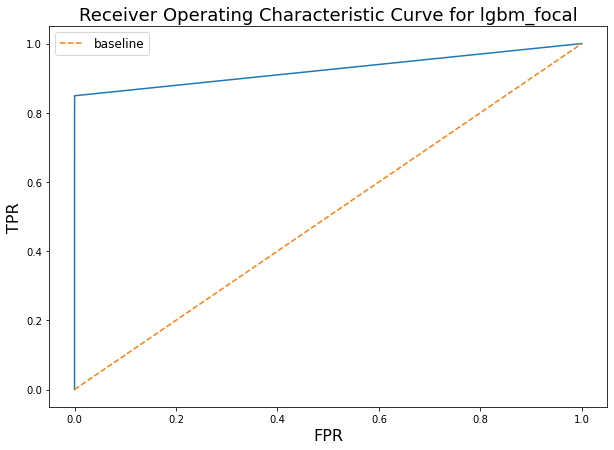

The ROC_AUC score is 0.9532404699448866


The Matthew correlation is 0.895191592548565
-------------------
The accuracy is 0.9996376811594203
The recall is 0.9996376811594203
The macro F1 score is 0.9453241168917765
The micro F1 score is 0.9996376811594203
The weighted F1 score is 0.9996195163518974
              precision    recall  f1-score   support

         0.0       1.00      1.00      1.00     68874
         1.0       0.99      0.81      0.89       126

    accuracy                           1.00     69000
   macro avg       0.99      0.90      0.95     69000
weighted avg       1.00      1.00      1.00     69000



In [8]:
automl_pipeline.ml_bp14_multiclass_full_processing_lgbm_focal()

In [9]:
automl_pipeline.ml_bp14_multiclass_full_processing_lgbm_focal(holdout_df)

Started Execute test train split at 10:00:45.
Started Started column type detection and casting at 10:00:45.
Started Checking for duplicate columns at 10:00:45.
Started Reset dataframe index. at 10:00:45.
Started Select best features at 10:00:45.
Started Delete columns with high share of NULLs at 10:00:45.
Started Apply datetime transformation at 10:00:45.
Started Start TFIDF to PCA loop at 10:00:45.
Started Handle rare features at 10:00:45.
Started Remove cardinality at 10:00:45.
Started Holistic NULL filling at 10:00:45.
Started Binarize numeric columns + PCA binarized features at 10:00:45.
Started Onehot + PCA categorical features at 10:00:45.
Started Execute categorical encoding at 10:00:45.
Started Fill nulls at 10:00:45.
Started Handle outliers at 10:00:45.
Started Remove collinearity at 10:00:46.
Started Remove skewness at 10:00:46.
Started Execute clustering as a feature at 10:00:46.
Started Execute clustering as a feature at 10:00:59.
Started Execute clustering as a feature at

In [10]:
algorithms = ["lgbm_focal"]

def get_matthews(algorithm):
    # Assess prediction quality on holdout data
    print(classification_report(hold_df_target, automl_pipeline.predicted_classes[algorithm]))
    try:
        matthews = matthews_corrcoef(hold_df_target, automl_pipeline.predicted_classes[algorithm])
    except Exception:
        print("Matthew failed.")
        matthews = 0
    print(matthews)
    
for i in algorithms:
    print(f"---------Start evaluating {i}----------")
    get_matthews(i)

---------Start evaluating lgbm_focal----------
              precision    recall  f1-score   support

           0       1.00      1.00      1.00     49935
           1       0.96      0.68      0.79        65

    accuracy                           1.00     50000
   macro avg       0.98      0.84      0.90     50000
weighted avg       1.00      1.00      1.00     50000

0.8044680077316066


More data did not improve our model.

# Summary

It seems like we created a good model here. However some notes:
- Accuracy is not a good metric for imbalanced data. Matthews correlation is a lot better as a general metric
- Our model could still fail on production! The training data might be from a wrong season or just too old and would suffer a lot seeing new patterns in production. So monitoring ongoing performance of your model is extremely important.
- Does automl replace data scientists? No, it empowers them. Instead of building stuff from scratch, data scientists can focus on finding better features. Also it needs expertise to properly evaluate a model. Automl cannot replace domain knowledge at all.

I hope you enjoyed the notebook. Upvotes are very welcome :-) 